In [1]:
library(RColorBrewer)
library(reshape2)
#library("gplots")
library(readxl)
library(tidyverse)
library("pheatmap")


── Attaching packages ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.6     ✔ purrr   0.3.4
✔ tibble  3.1.7     ✔ dplyr   1.0.8
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

── Conflicts ─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()



In [2]:
library(WGCNA);

Loading required package: dynamicTreeCut

Loading required package: fastcluster


Attaching package: ‘fastcluster’


The following object is masked from ‘package:stats’:

    hclust





Attaching package: ‘WGCNA’


The following object is masked from ‘package:stats’:

    cor




In [198]:
library(goseq)

Loading required package: BiasedUrn

Loading required package: geneLenDataBase



In [3]:
options(repr.plot.width = 10, repr.plot.height = 10, repr.plot.res = 300)

In [384]:
PRO_COLOR = 'MediumSeaGreen'
ALT_COLOR = 'Gold'
HCOLOR = '#E26A2C'
HCOLOR_light = '#FDA65D'
PCOLOR = '#99cc99'
PCOLOR_light = '#aad5aa'

tpal = brewer.pal(5, "Purples")
gpal = brewer.pal(4, 'Dark2')
ann_colors = list(
   MMtype = c(Anticorrelated='#bbd4ce', Correlated='#679186'),
   Timepoint=c(C1='#5b7ff7', C2='#4059ad', C3='#9059f7', C4='#59edf7', C5='#3ea6ad'),
    
    Group = c(A = HCOLOR, P = PRO_COLOR),
    treatment = c(ref = gpal[2], long.term=gpal[4])
)
#forder = ['med4 (AX)', 'med4 (CC)', '1A3 (CC)', '1A3 (AX)']
#fpal = [PCOLOR_light, PRO_COLOR, HCOLOR, HCOLOR_light,  ]


In [4]:
# Allow multi-threading within WGCNA. This helps speed up certain calculations.
# At present this call is necessary for the code to work.
# Any error here may be ignored but you may want to update WGCNA if you see one.
# Caution: skip this line if you run RStudio or other third-party R environments.
# See note above.
enableWGCNAThreads()

Allowing parallel execution with up to 11 working processes.


In [5]:
# The following setting is important, do not omit.
options(stringsAsFactors = FALSE);

In [6]:
genome= 'MED4'
vsd_p = read.csv(file.path('DE_results',paste0(genome, '_DE_DESEQ_vsd.csv')))
genome= 'HOT1A3'
vsd_a = read.csv(file.path('DE_results',paste0(genome, '_DE_DESEQ_vsd.csv')))


In [7]:
head(vsd_p)
head(vsd_a)

,X,C1A,C1B,C1C,C2A,C2B_1,C2C_1,C3A_1,C3B,C3C_1,⋯,C4C,C5A,C5B,C5C,P1A,P1B,P1C,P2A,P2B,P2C
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,TX50_RS00020,10.199306,10.138608,11.552435,10.233089,10.846940,10.968598,10.277762,10.708205,10.925488,⋯,10.673880,10.903510,10.828046,10.566447,10.145981,10.133392,9.980252,11.671632,12.075326,12.089237
2,TX50_RS00025,7.201485,7.403180,8.070099,7.613555,7.034628,7.294078,6.716129,6.561249,6.098862,⋯,6.833144,7.123598,6.415651,7.179944,7.415239,6.965448,7.480714,7.102511,7.573653,7.703449
3,TX50_RS00030,8.599562,8.771120,10.002316,8.897714,8.846223,9.168677,9.715876,9.518070,9.788721,⋯,10.293683,9.577001,9.988663,10.011130,8.774283,8.959921,8.768441,11.021224,11.593740,11.775872
4,TX50_RS00035,8.466332,8.538664,8.319138,8.517611,8.372679,8.572956,8.523269,8.581421,8.191762,⋯,8.794819,8.502947,8.517462,8.733940,8.441880,8.775660,8.489322,9.186228,9.908075,10.219909
5,TX50_RS00040,9.316846,9.542356,10.613334,9.655292,10.014346,9.940660,9.331278,9.159758,9.212120,⋯,9.543625,9.515104,9.410598,9.472152,9.356303,9.506277,9.259842,10.600202,10.181465,10.279694
6,TX50_RS00045,7.051232,6.830920,8.314047,7.850284,7.113894,7.198608,6.205762,7.496614,7.157745,⋯,6.630732,7.045868,6.858691,6.946624,6.840204,6.424365,6.866480,8.181493,8.883846,8.507696


,X,A1A,A1B,A1C,A2A,A2B,A2C,A3A,A3B,A3C,⋯,C2C_1,C3A_1,C3B,C3C_1,C4A,C4B,C4C,C5A,C5B,C5C
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,ACZ81_RS00005,12.035737,12.102729,11.472358,12.776884,12.754134,12.735312,12.15189,12.274427,12.512251,⋯,11.043903,12.150962,11.445453,11.548006,11.973985,11.814041,11.612920,12.075403,12.356593,12.387602
2,ACZ81_RS00010,11.307088,11.008179,10.704058,11.205750,11.374013,11.449131,10.74761,10.876169,11.163231,⋯,10.929858,10.895282,10.712611,10.821710,10.815516,10.691372,9.943032,10.882863,10.968845,10.801642
3,ACZ81_RS00015,9.178986,9.096837,8.788536,9.783085,9.228974,9.358364,9.04267,9.024149,8.593321,⋯,9.258439,9.275920,9.675008,8.877139,8.956153,8.688787,9.534751,9.042451,9.126516,8.695815
4,ACZ81_RS00020,11.876262,11.372041,10.994029,11.709146,11.815244,12.073582,11.11910,11.043776,11.090413,⋯,11.382472,11.853378,10.863081,11.525479,11.260750,11.190040,10.160145,11.317098,11.642085,11.762470
5,ACZ81_RS00025,7.062180,6.463501,7.195475,7.886672,7.574581,7.624635,7.73927,7.435742,7.854094,⋯,7.571645,7.164411,7.675693,7.672656,7.119061,7.454824,7.629618,7.075055,7.393293,6.884139
6,ACZ81_RS00030,11.123200,11.226629,10.104044,11.144800,11.354652,11.569688,10.68983,11.108290,11.502083,⋯,11.015108,12.059220,10.570787,11.589816,11.523336,11.589693,10.141048,11.766331,11.780767,12.077343


In [20]:
dput(names(vsd_p))
collist = c("X", "C1A", "C1B", "C1C", "C2A", "C2B_1", "C2C_1", "C3A_1", 
"C3B", "C3C_1", "C4A", "C4B", "C4C", "C5A", "C5B", "C5C")

cvsd_p = vsd_p %>% select(all_of(collist)) 
cvsd_a = vsd_a %>% select(all_of(collist)) 


c("X", "C1A", "C1B", "C1C", "C2A", "C2B_1", "C2C_1", "C3A_1", 
"C3B", "C3C_1", "C4A", "C4B", "C4C", "C5A", "C5B", "C5C", "P1A", 
"P1B", "P1C", "P2A", "P2B", "P2C")


In [22]:
vsd_p_df = as.data.frame(t(cvsd_p[,-1]))
names(vsd_p_df) = cvsd_p$X
head(vsd_p_df)

,TX50_RS00020,TX50_RS00025,TX50_RS00030,TX50_RS00035,TX50_RS00040,TX50_RS00045,TX50_RS00050,TX50_RS00055,TX50_RS00060,TX50_RS00065,⋯,TX50_RS09845,TX50_RS09850,TX50_RS09855,TX50_RS09860,TX50_RS09865,TX50_RS09870,TX50_RS09875,TX50_RS09880,TX50_RS09885,TX50_RS09890
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
C1A,10.19931,7.201485,8.599562,8.466332,9.316846,7.051232,7.290374,10.874508,7.511811,8.300663,⋯,5.788068,7.834031,6.192959,6.233735,4.411381,5.078642,6.539743,6.750083,7.095792,8.247498
C1B,10.13861,7.403180,8.771120,8.538664,9.542356,6.830920,7.180581,10.269712,7.768824,8.011588,⋯,5.111385,6.916956,5.882875,5.799490,5.090753,5.643684,6.614270,7.099616,7.109382,8.111916
C1C,11.55244,8.070099,10.002316,8.319138,10.613334,8.314047,9.022826,11.462462,8.475512,7.499263,⋯,5.331495,6.920759,5.997830,7.322643,4.547031,5.432440,7.011923,7.485724,7.382338,7.127035
C2A,10.23309,7.613555,8.897714,8.517611,9.655292,7.850284,8.155148,9.692929,7.627780,7.599188,⋯,5.377760,6.680207,4.765749,5.377760,4.647671,5.742717,5.445812,7.813436,7.364428,6.375582
C2B_1,10.84694,7.034628,8.846223,8.372679,10.014346,7.113894,8.027323,11.111961,7.475503,7.608964,⋯,5.114549,7.874248,5.736837,6.022871,4.920237,5.667025,5.781488,7.172649,6.911782,7.130928
C2C_1,10.96860,7.294078,9.168677,8.572956,9.940660,7.198608,8.286385,11.334858,7.946936,7.401745,⋯,5.581551,7.672267,4.996523,6.351700,4.141028,5.581551,7.004143,6.609096,7.214111,7.698185


In [23]:
vsd_a_df = as.data.frame(t(cvsd_a[,-1]))
names(vsd_a_df) = cvsd_a$X
head(vsd_a_df)

,ACZ81_RS00005,ACZ81_RS00010,ACZ81_RS00015,ACZ81_RS00020,ACZ81_RS00025,ACZ81_RS00030,ACZ81_RS00035,ACZ81_RS00040,ACZ81_RS00045,ACZ81_RS00050,⋯,ACZ81_RS21645,ACZ81_RS21650,ACZ81_RS21655,ACZ81_RS21660,ACZ81_RS21665,ACZ81_RS21670,ACZ81_RS21675,ACZ81_RS21680,ACZ81_RS21685,ACZ81_RS21705
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
C1A,12.11292,10.92358,9.412552,11.93653,7.190529,11.33467,10.045807,8.141033,10.364434,10.043329,⋯,10.164584,5.675743,4.837732,5.178371,9.824095,7.899175,12.39341,11.29252,6.000191,6.394825
C1B,12.16878,11.04075,8.065217,11.84795,7.448532,11.69983,9.976514,8.602247,10.584672,9.686218,⋯,10.199667,4.904645,5.427107,4.769674,9.840636,8.243522,12.36521,11.58404,6.299282,5.241801
C1C,13.39918,11.80107,9.625870,12.64864,7.042551,11.69211,10.396421,7.843315,10.202363,10.399169,⋯,9.119414,4.462154,5.449581,5.534007,9.929478,8.904077,12.19348,11.49167,6.371208,5.760154
C2A,11.96121,11.39568,9.178995,12.33534,7.794184,12.77968,11.556171,7.593929,9.318594,9.893802,⋯,8.654454,4.795071,5.096693,5.393010,10.582242,8.434342,11.86629,10.88825,6.510418,5.489336
C2B_1,11.42464,10.98138,9.160334,11.64743,7.780312,11.84146,10.854470,7.942839,9.474575,9.505004,⋯,9.347527,4.954743,5.650302,5.873675,10.349727,7.986656,12.88599,11.84092,6.338420,5.588370
C2C_1,11.04390,10.92986,9.258439,11.38247,7.571645,11.01511,10.485922,8.301512,9.800393,9.196645,⋯,9.652895,5.687672,5.198378,6.276766,10.105793,8.414432,11.44359,10.60961,6.150932,6.117645


In [24]:
vsd_cc_df = bind_cols(vsd_a_df, vsd_p_df)
vsd_cc_df

,ACZ81_RS00005,ACZ81_RS00010,ACZ81_RS00015,ACZ81_RS00020,ACZ81_RS00025,ACZ81_RS00030,ACZ81_RS00035,ACZ81_RS00040,ACZ81_RS00045,ACZ81_RS00050,⋯,TX50_RS09845,TX50_RS09850,TX50_RS09855,TX50_RS09860,TX50_RS09865,TX50_RS09870,TX50_RS09875,TX50_RS09880,TX50_RS09885,TX50_RS09890
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
C1A,12.11292,10.923575,9.412552,11.93653,7.190529,11.33467,10.045807,8.141033,10.364434,10.043329,⋯,5.788068,7.834031,6.192959,6.233735,4.411381,5.078642,6.539743,6.750083,7.095792,8.247498
C1B,12.16878,11.040747,8.065217,11.84795,7.448532,11.69983,9.976514,8.602247,10.584672,9.686218,⋯,5.111385,6.916956,5.882875,5.799490,5.090753,5.643684,6.614270,7.099616,7.109382,8.111916
C1C,13.39918,11.801072,9.625870,12.64864,7.042551,11.69211,10.396421,7.843315,10.202363,10.399169,⋯,5.331495,6.920759,5.997830,7.322643,4.547031,5.432440,7.011923,7.485724,7.382338,7.127035
C2A,11.96121,11.395682,9.178995,12.33534,7.794184,12.77968,11.556171,7.593929,9.318594,9.893802,⋯,5.377760,6.680207,4.765749,5.377760,4.647671,5.742717,5.445812,7.813436,7.364428,6.375582
C2B_1,11.42464,10.981379,9.160334,11.64743,7.780312,11.84146,10.854470,7.942839,9.474575,9.505004,⋯,5.114549,7.874248,5.736837,6.022871,4.920237,5.667025,5.781488,7.172649,6.911782,7.130928
C2C_1,11.04390,10.929858,9.258439,11.38247,7.571645,11.01511,10.485922,8.301512,9.800393,9.196645,⋯,5.581551,7.672267,4.996523,6.351700,4.141028,5.581551,7.004143,6.609096,7.214111,7.698185
C3A_1,12.15096,10.895282,9.275920,11.85338,7.164411,12.05922,11.452776,7.835460,9.516463,9.756193,⋯,6.336100,6.617506,5.395399,5.123967,2.999353,5.902069,5.902069,7.015866,6.565509,7.230702
C3B,11.44545,10.712611,9.675008,10.86308,7.675693,10.57079,10.606668,8.254440,10.234101,9.051375,⋯,6.120215,7.670825,5.065664,5.785006,4.135909,4.959050,6.268949,6.478489,6.976748,7.298329
C3C_1,11.54801,10.821710,8.877139,11.52548,7.672656,11.58982,10.898135,8.063509,9.224086,10.124045,⋯,6.845734,7.212749,5.329868,5.259150,4.727246,6.350454,6.283030,7.020545,6.774245,6.999827


In [459]:
kegg_path_fname = '/home/oweissberg/work/CC1A3/genomes/kegg_pathways.csv'
kegg_path_df = read.csv(a_path_fname)
head(kegg_path_df)

,X,protein_id,path_id,main,sub,path,ecpath
,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,0,WP_004588585.1,,,,,
2,1,WP_006991848.1,,,,,
3,2,WP_010179497.1,K02946,09120 Genetic Information Processing,09122 Translation,03010 Ribosome [PATH:ko03010],"K02946 RP-S10, MRPS10, rpsJ; small subunit ribosomal protein S10"
4,3,WP_010179497.1,K02946,09180 Brite Hierarchies,09182 Protein families: genetic information processing,03011 Ribosome [BR:ko03011],"K02946 RP-S10, MRPS10, rpsJ; small subunit ribosomal protein S10"
5,4,WP_012516526.1,K02338,09120 Genetic Information Processing,09124 Replication and repair,03030 DNA replication [PATH:ko03030],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]
6,5,WP_012516526.1,K02338,09120 Genetic Information Processing,09124 Replication and repair,03430 Mismatch repair [PATH:ko03430],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]


In [155]:
a_path_fname = '/home/oweissberg/work/CC1A3/genomes/HOT1A3/HOT1A3_pathways.csv'
a_path_df = read.csv(a_path_fname)
a_fname_counts = 'HOT1A3_counts_combined.txt'
a_cdf = read.csv(a_fname_counts, sep='\t' )
a_genes = a_cdf[,c(1,2,3,4,5)]
a_genes = head(a_genes, -5)
a_path_df = left_join(a_genes, a_path_df, by='protein_id')
# remove last 5 lines that are not genes
a_path_df = subset(a_path_df, select=-c(old_locus_tag,X))


In [157]:
p_path_fname = '/home/oweissberg/work/CC1A3/genomes/MED4/MED4_pathways.csv'
p_path_df = read.csv(p_path_fname)
p_fname_counts = 'MED4_counts_combined.txt'
p_cdf = read.csv(p_fname_counts, sep='\t' )
p_genes = p_cdf[,c(1,2,3,4,5)]
p_genes = head(p_genes, -5)
p_path_df = left_join(p_genes, p_path_df, by='protein_id')
# remove last 5 lines that are not genes
p_path_df = subset(p_path_df, select=-c(old_locus_tag,X))


In [151]:
a_gtf_fpath = file.path('/fast_data/Osnat/CC1A3/genomes/HOT1A3', 'genomic.gtf')
SAF <- Rsubread::flattenGTF(a_gtf_fpath, GTF.featureType = "CDS")
a_GeneLength <- rowsum(SAF$End-SAF$Start+1, SAF$GeneID)
a_GeneLength = data.frame(Length = a_GeneLength)
a_GeneLength$gene_id = rownames(a_GeneLength)
#res_df = left_join(res_df, GeneLength, by = 'gene_id')


Flattening GTF file: /fast_data/Osnat/CC1A3/genomes/HOT1A3/genomic.gtf
Output SAF file: ./.Rsubread_flattenGTF_pid1373646

Looking for 'CDS' features... (grouped by 'gene_id')

Finished.



In [159]:
p_gtf_fpath = file.path('/fast_data/Osnat/CC1A3/genomes/MED4', 'genomic.gtf')
SAF <- Rsubread::flattenGTF(p_gtf_fpath, GTF.featureType = "CDS")
p_GeneLength <- rowsum(SAF$End-SAF$Start+1, SAF$GeneID)
p_GeneLength = data.frame(Length = p_GeneLength)
p_GeneLength$gene_id = rownames(p_GeneLength)
#res_df = left_join(res_df, GeneLength, by = 'gene_id')


Flattening GTF file: /fast_data/Osnat/CC1A3/genomes/MED4/genomic.gtf
Output SAF file: ./.Rsubread_flattenGTF_pid1373646

Looking for 'CDS' features... (grouped by 'gene_id')

Finished.



In [25]:
gsg = goodSamplesGenes(vsd_cc_df, verbose = 3);
gsg$allOK

 Flagging genes and samples with too many missing values...
  ..step 1


[1] TRUE

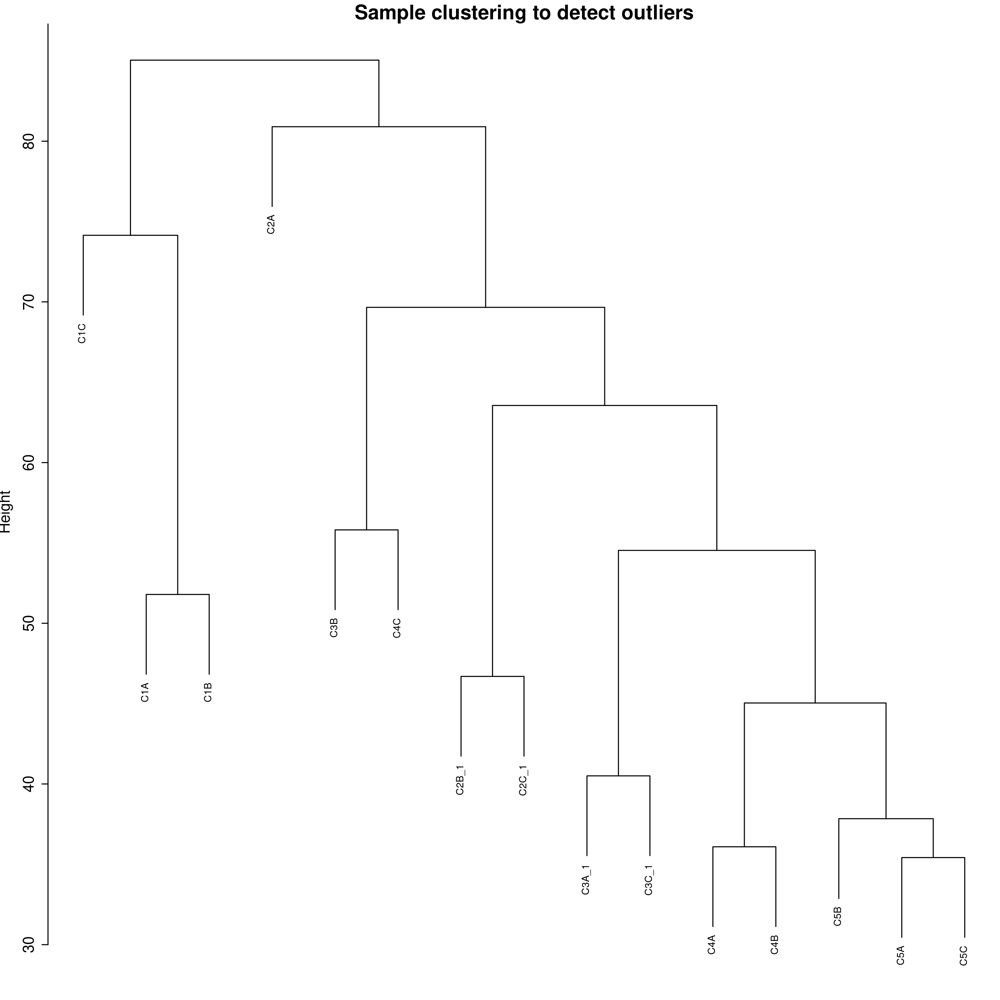

In [26]:
sampleTree = hclust(dist(vsd_cc_df), method = "average");
# Plot the sample tree: Open a graphic output window of size 12 by 9 inches
# The user should change the dimensions if the window is too large or too small.
#sizeGrWindow(12,9)
#pdf(file = "Plots/sampleClustering.pdf", width = 12, height = 9);
par(cex = 0.6);
par(mar = c(0,4,2,0))
plot(sampleTree, main = "Sample clustering to detect outliers", sub="", xlab="", cex.lab = 1.5,
cex.axis = 1.5, cex.main = 2)

pickSoftThreshold: will use block size 5870.
 pickSoftThreshold: calculating connectivity for given powers...
   ..working on genes 1 through 5870 of 5870
   Power SFT.R.sq   slope truncated.R.sq  mean.k. median.k.  max.k.
1      1  0.19300  1.7200          0.942 1650.000  1.66e+03 2280.00
2      2  0.00191  0.0809          0.921  685.000  6.75e+02 1200.00
3      3  0.14600 -0.5850          0.909  344.000  3.28e+02  738.00
4      4  0.39600 -0.9800          0.918  194.000  1.77e+02  497.00
5      5  0.53600 -1.2100          0.922  119.000  1.03e+02  355.00
6      6  0.63200 -1.3800          0.934   77.100  6.37e+01  264.00
7      7  0.69700 -1.4800          0.947   52.400  4.09e+01  203.00
8      8  0.75000 -1.5300          0.961   36.900  2.73e+01  159.00
9      9  0.78300 -1.5700          0.967   26.800  1.87e+01  128.00
10    10  0.81400 -1.6000          0.973   19.900  1.32e+01  104.00
11    12  0.83800 -1.6500          0.975   11.700  6.99e+00   71.90
12    14  0.84800 -1.7300    

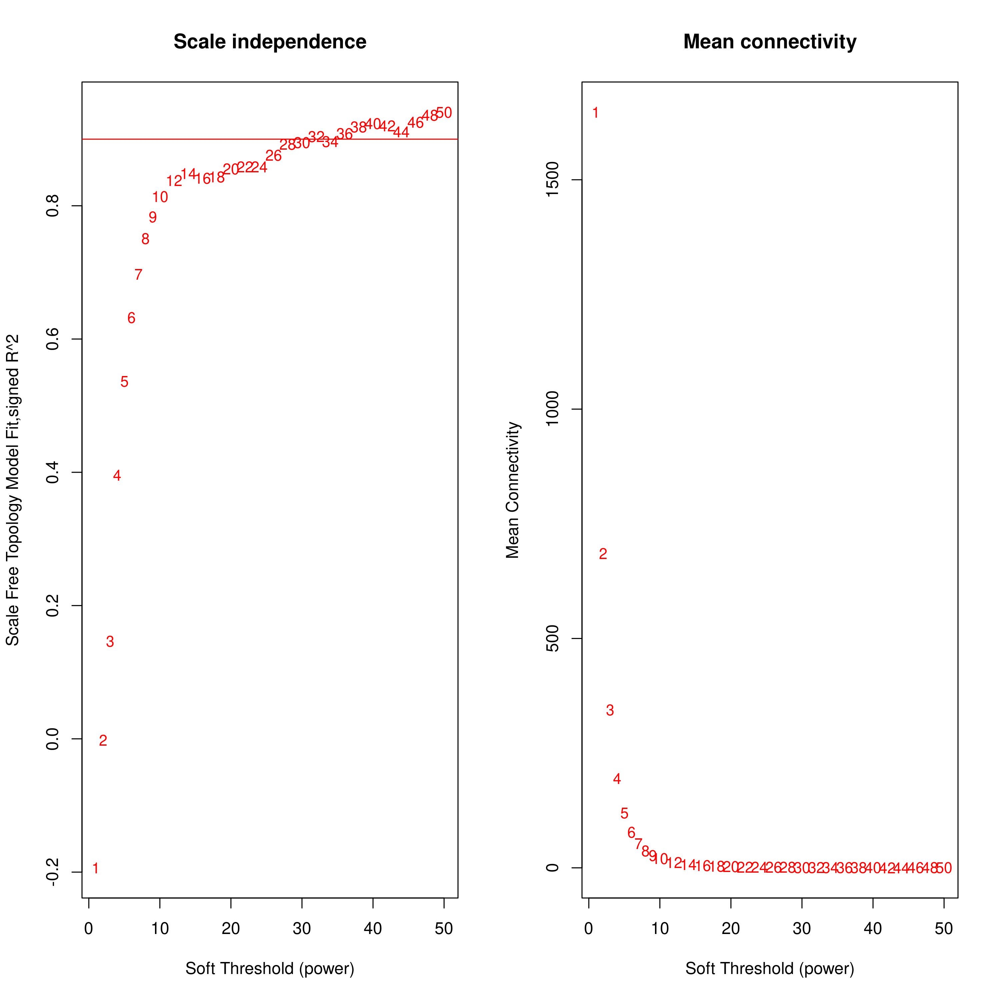

In [38]:
# Choose a set of soft-thresholding powers
powers = c(c(1:10), seq(from = 12, to=50, by=2))
# Call the network topology analysis function
sft = pickSoftThreshold(vsd_cc_df, powerVector = powers, verbose = 5, corFnc = bicor, networkType = 'unsigned')

# Plot the results:
#sizeGrWindow(9, 5)
par(mfrow = c(1,2));
cex1 = 0.9;
# Scale-free topology fit index as a function of the soft-thresholding power
plot(sft$fitIndices[,1], -sign(sft$fitIndices[,3])*sft$fitIndices[,2],
xlab="Soft Threshold (power)",ylab="Scale Free Topology Model Fit,signed R^2",type="n",
main = paste("Scale independence"));
text(sft$fitIndices[,1], -sign(sft$fitIndices[,3])*sft$fitIndices[,2],
labels=powers,cex=cex1,col="red");
# this line corresponds to using an R^2 cut-off of h
abline(h=0.90,col="red")
# Mean connectivity as a function of the soft-thresholding power
plot(sft$fitIndices[,1], sft$fitIndices[,5],
xlab="Soft Threshold (power)",ylab="Mean Connectivity", type="n",
main = paste("Mean connectivity"))
text(sft$fitIndices[,1], sft$fitIndices[,5], labels=powers, cex=cex1,col="red")

In [99]:
c_net = blockwiseModules(vsd_cc_df, power = 14, corType = 'bicor', networkType = 'unsigned', maxPOutliers = 0.1,
TOMType = "unsigned", minModuleSize = 50,
reassignThreshold = 0, mergeCutHeight = 0.5,
numericLabels = TRUE, pamRespectsDendro = FALSE,
saveTOMs = TRUE,
saveTOMFileBase = "AltTOM",
verbose = 3,
maxBlockSize=10000)

 Calculating module eigengenes block-wise from all genes
   Flagging genes and samples with too many missing values...
    ..step 1
 ..Working on block 1 .
    TOM calculation: adjacency..
    ..will use 11 parallel threads.
     Fraction of slow calculations: 0.000000
    ..connectivity..
    ..matrix multiplication (system BLAS)..
    ..normalization..
    ..done.
   ..saving TOM for block 1 into file AltTOM-block.1.RData
 ....clustering..
 ....detecting modules..
 ....calculating module eigengenes..
 ....checking kME in modules..
     ..removing 1 genes from module 2 because their KME is too low.
     ..removing 2 genes from module 3 because their KME is too low.
     ..removing 1 genes from module 4 because their KME is too low.


Warning message in bicor(structure(c(7.82024106420714, 7.40630218201467, 8.67826444166195, :
“bicor: zero MAD in variable 'x'. Pearson correlation was used for individual columns with zero (or missing) MAD.”
Warning message in bicor(structure(c(8.41096110873187, 7.54897992123961, 8.24906044163392, :
“bicor: zero MAD in variable 'x'. Pearson correlation was used for individual columns with zero (or missing) MAD.”
Warning message in bicor(structure(c(8.06483751649176, 7.44853176705212, 8.27324410246532, :
“bicor: zero MAD in variable 'x'. Pearson correlation was used for individual columns with zero (or missing) MAD.”


     ..removing 1 genes from module 14 because their KME is too low.
     ..removing 1 genes from module 15 because their KME is too low.
     ..removing 1 genes from module 24 because their KME is too low.


Warning message in (function (x, y = NULL, robustX = TRUE, robustY = TRUE, use = "all.obs", :
“bicor: zero MAD in variable 'x'. Pearson correlation was used for individual columns with zero (or missing) MAD.”


 ..merging modules that are too close..
     mergeCloseModules: Merging modules whose distance is less than 0.5
       Calculating new MEs...


In [100]:
table(c_net$colors)



   0    1    2    3    4    5    6    7 
 953 1102 1021  992  952  490  223  137 

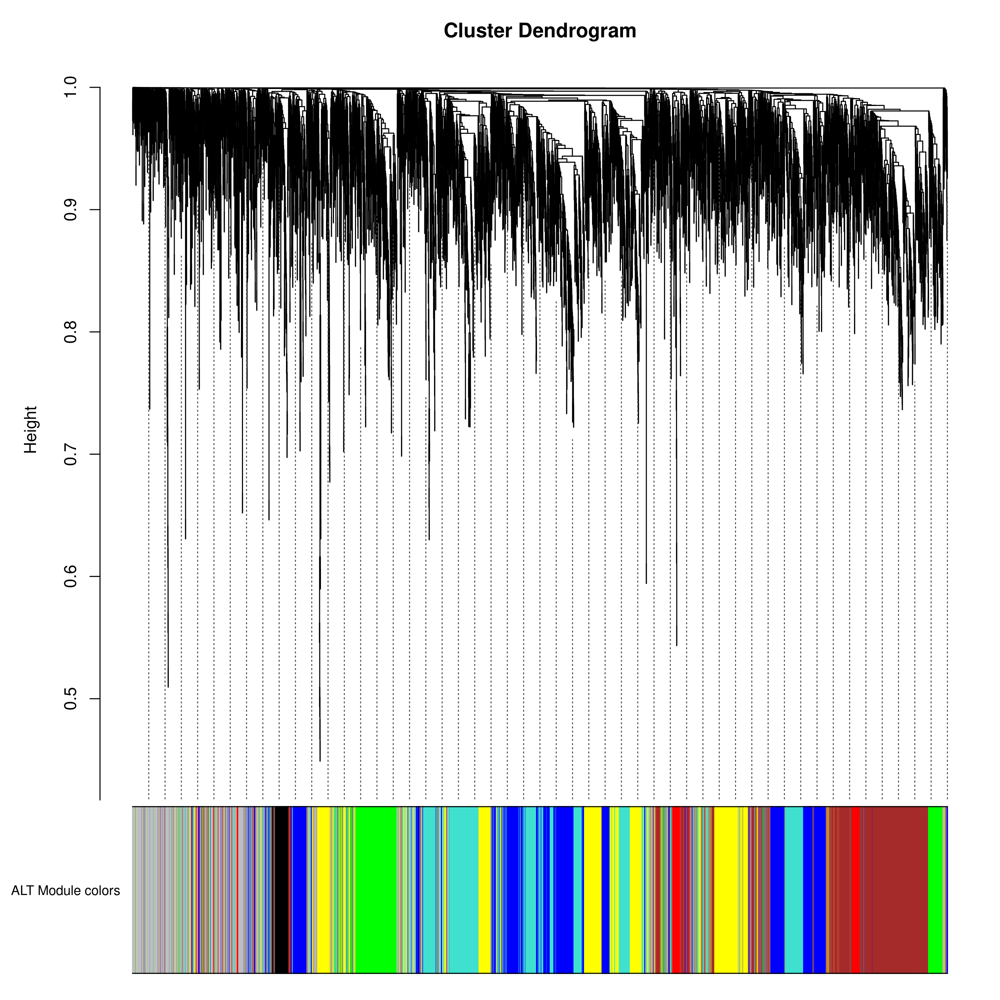

In [101]:
# Convert labels to colors for plotting
mergedColors = labels2colors(c_net$colors)
# Plot the dendrogram and the module colors underneath
plotDendroAndColors(c_net$dendrograms[[1]], mergedColors[c_net$blockGenes[[1]]],
"ALT Module colors",
dendroLabels = FALSE, hang = 0.03,
addGuide = TRUE, guideHang = 0.05)

In [193]:
cluster_df = data.frame(cluster_id = c_net$colors)
cluster_df$gene_id = rownames(cluster_df)
cluster_df = cluster_df %>% 
   mutate(Group = c(AC = 'A', TX = 'P')[substr(gene_id, 1,2)]) %>%
   left_join(a_GeneLength, by='gene_id') %>%
   left_join(p_GeneLength, by='gene_id', suffix = c('', '_p')) %>%
   mutate(Length = ifelse(is.na(Length), Length_p, Length)) %>%
   select(-Length_p)



In [203]:
MEs0 = moduleEigengenes(vsd_cc_df, c_net$colors)$eigengenes
MEs = orderMEs(MEs0)


In [241]:
nSamples = nrow(vsd_cc_df);
geneModuleMembership = as.data.frame(cor(vsd_cc_df, MEs, use = "p"));
MMPvalue = as.data.frame(corPvalueStudent(as.matrix(geneModuleMembership), nSamples));
names(geneModuleMembership) = as.numeric(substr(names(geneModuleMembership), 3, 11))
geneModuleMembership$gene_id = rownames(geneModuleMembership)

names(MMPvalue) = as.numeric(substr(names(MMPvalue), 3, 11))
MMPvalue$gene_id = rownames(MMPvalue)

In [242]:
KMM_df = left_join(geneModuleMembership, cluster_df, by = 'gene_id') %>% 
   pivot_longer(cols = c(0:8), names_to = 'ME_cluster_id', values_to = 'MM') %>%
   filter(cluster_id == ME_cluster_id) %>%
   mutate(MMtype = ifelse(MM > 0, 'Correlated', 'Anticorrelated')) 

In [243]:
KMMtmp_df = left_join(MMPvalue, cluster_df, by = 'gene_id') %>% 
   pivot_longer(cols = c(0:8), names_to = 'ME_cluster_id', values_to = 'MM_pval') %>%
   filter(cluster_id == ME_cluster_id) 

KMM_df = left_join(KMM_df, KMMtmp_df)


Joining, by = c("gene_id", "cluster_id", "Group", "Length", "ME_cluster_id")


In [249]:
cluster_df = KMM_df
head(cluster_df)

gene_id,cluster_id,Group,Length,ME_cluster_id,MM,MMtype,MM_pval
<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
ACZ81_RS00005,4,A,1653,4,-0.6017591,Anticorrelated,1.762750e-02
ACZ81_RS00010,1,A,1098,1,0.6188549,Correlated,1.390503e-02
ACZ81_RS00015,0,A,1086,0,0.4373525,Correlated,1.030481e-01
ACZ81_RS00020,1,A,2418,1,0.7092986,Correlated,3.063363e-03
ACZ81_RS00025,7,A,441,7,0.6970450,Correlated,3.876176e-03
ACZ81_RS00030,3,A,2076,3,-0.8475265,Anticorrelated,6.626758e-05


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.



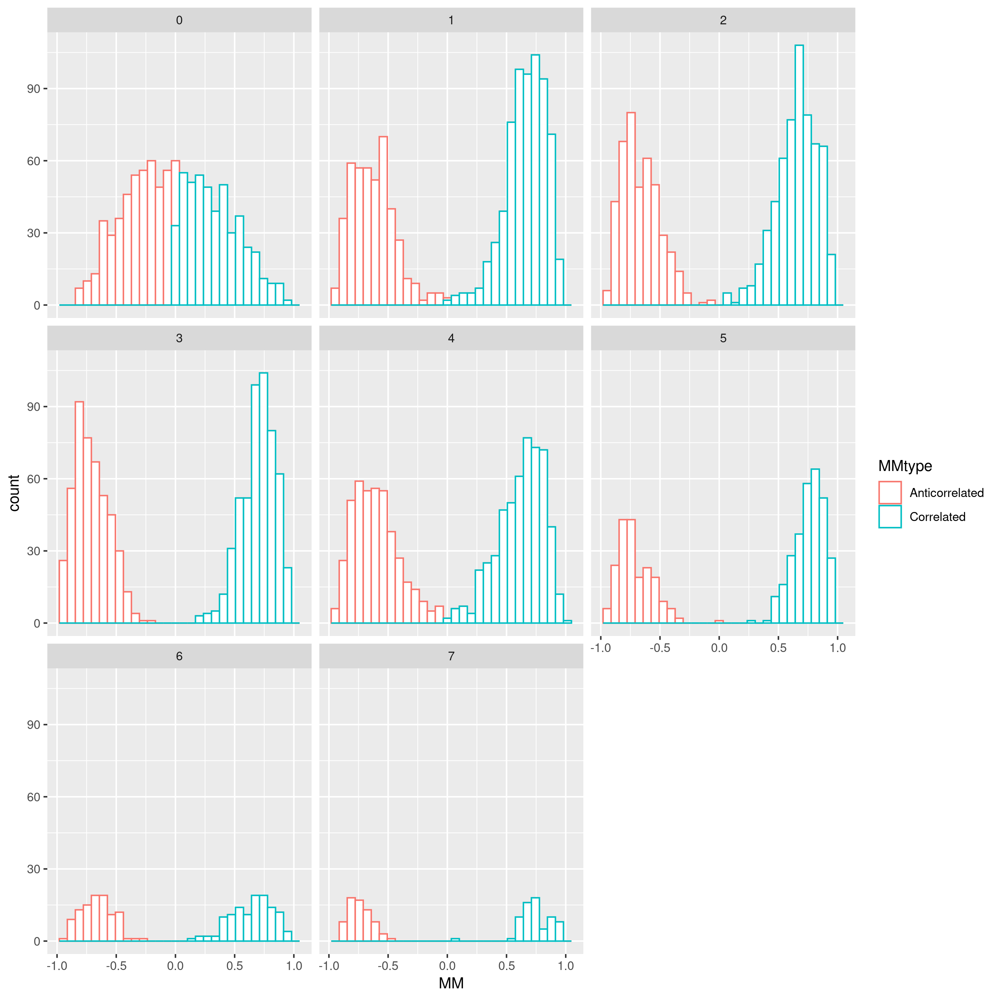

In [248]:
ggplot(KMM_df, aes(x=MM, color=MMtype)) +
   geom_histogram(fill='white') + facet_wrap(~cluster_id)

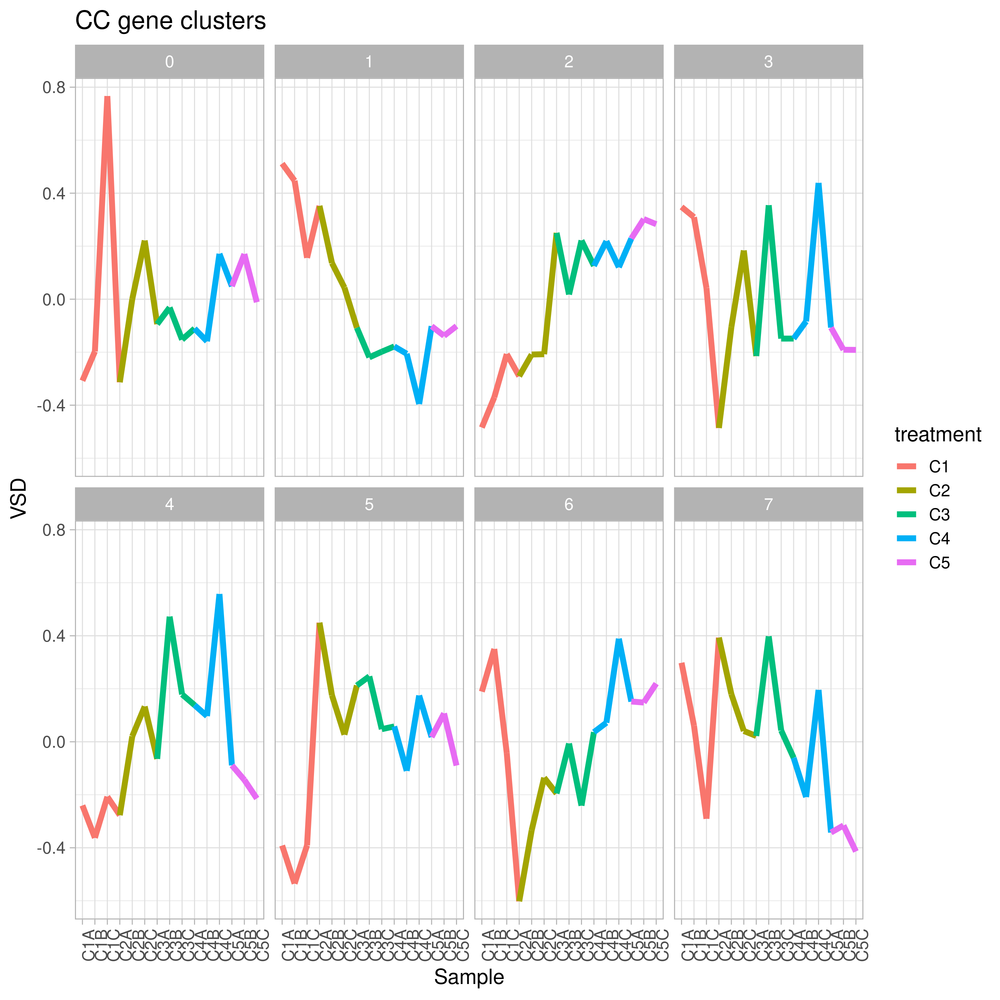

In [130]:
sample_order = c("C1A", "C1B", "C1C", "C2A", "C2B", "C2C", "C3A", "C3B", 
"C3C", "C4A", "C4B", "C4C", "C5A", "C5B", "C5C")

MEs = moduleEigengenes(vsd_cc_df, c_net$colors)$eigengenes
MEs$Sample = rownames(MEs)
#MEs =
melt(MEs, id.vars = 'Sample', value.name = 'VSD') %>% 
  mutate(cluster_id = as.numeric(substr(variable, 3,10))) %>%
   mutate(treatment = substr(Sample, 1,2)) %>% 
   mutate(Sample = substr(Sample, 1,3)) %>% 
   mutate(Sample = factor(Sample, levels = sample_order)) %>% 
   #filter(cluster_id <= 12, cluster_id >0) %>%
   ggplot(aes(x=Sample, y=VSD, color=treatment)) +
   geom_line(aes(group=cluster_id), size=2) + 
   #geom_smooth(aes(group=1)) +
   facet_wrap(~cluster_id, ncol=4) +
   theme_light(base_size = 15) +
   theme(axis.text.x = element_text(angle = 90)) +
   ggtitle('CC gene clusters')

In [353]:
library(ggnewscale)


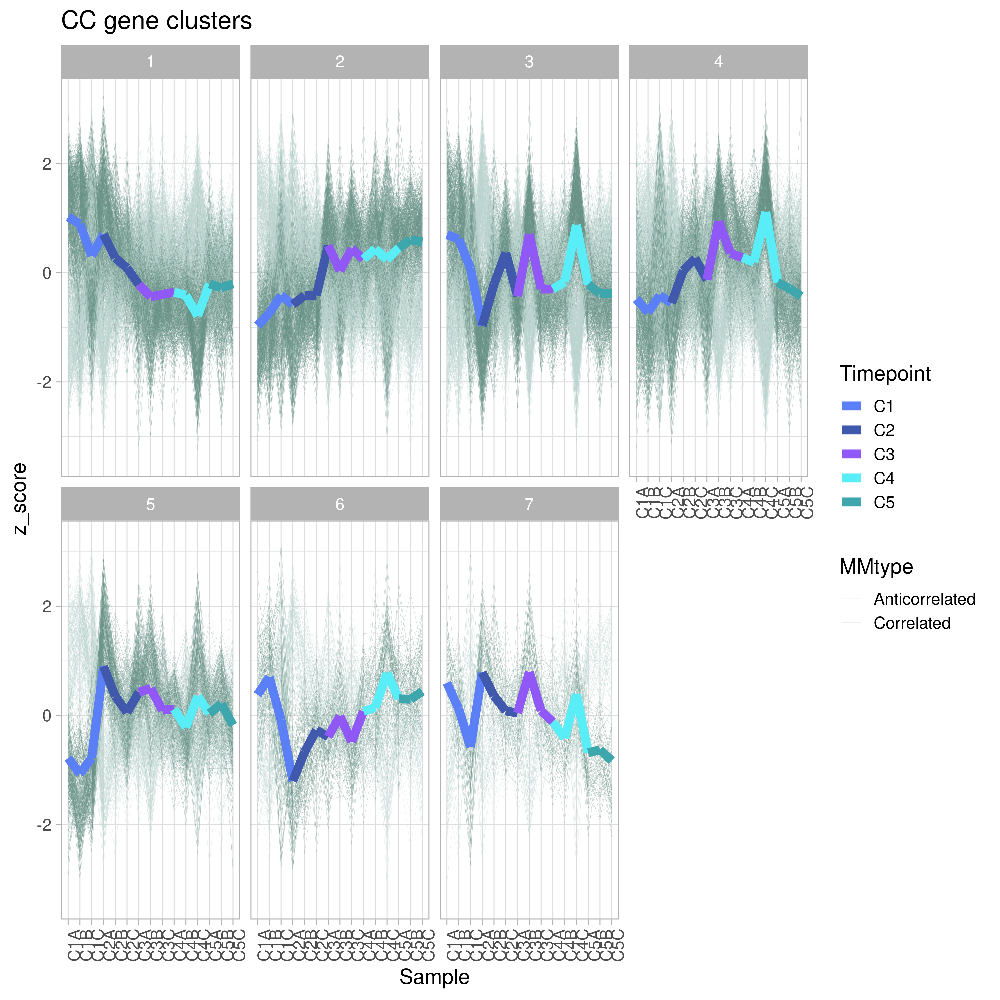

In [358]:

sample_order = c("C1A", "C1B", "C1C", "C2A", "C2B", "C2C", "C3A", "C3B", 
"C3C", "C4A", "C4B", "C4C", "C5A", "C5B", "C5C")

pal= list(
       MMtype = c(Anticorrelated='#bbd4ce', Correlated='#679186'),
       Timepoint=c(C1='#5b7ff7', C2='#4059ad', C3='#9059f7', C4='#59edf7', C5='#3ea6ad')
   )

MEs = moduleEigengenes(vsd_cc_df, c_net$colors)$eigengenes
MEs$Sample = rownames(MEs)
#MEs =
c_MEs = melt(MEs, id.vars = 'Sample', value.name = 'VSD') %>% 
  mutate(cluster_id = as.numeric(substr(variable, 3,10))) %>%
   mutate(Timepoint = substr(Sample, 1,2)) %>% 
   mutate(Sample = substr(Sample, 1,3)) %>% 
   mutate(Sample = factor(Sample, levels = sample_order)) %>% 
   filter(cluster_id <= 12, cluster_id >0) 



ctmp_df = as.data.frame(t(vsd_cc_df)) %>% 
  #mutate(cluster_id = c_net$col) %>%
  rownames_to_column() %>%
  rename('gene_id' = rowname) %>%
  left_join(cluster_df, by = 'gene_id') %>%
  pivot_longer(cols=rownames(vsd_cc_df), values_to = 'VSD', names_to = 'Sample') %>%
  group_by(gene_id) %>% 
   mutate(z_score = scale(VSD)) %>% 
   mutate(Timepoint = substr(Sample, 1,2)) %>% 
   mutate(Sample = substr(Sample, 1,3)) %>% 
   mutate(Sample = factor(Sample, levels = sample_order)) %>% 
   filter(cluster_id <= 12, cluster_id >0) 


   ggplot() +
   geom_line(data=ctmp_df, aes(group=gene_id, x=Sample, y=z_score, color=MMtype), size=0.05, alpha=0.6) + 
   scale_color_manual(values=pal$MMtype) +
   new_scale_color() +   # same as `new_scale("color")`
  # geom_line(data=p_MEs, aes(group=cluster_id, x=Sample, y=VSD), color='white', size=4) + 
   #geom_line(data=p_MEs, aes(group=cluster_id, x=Sample, y=VSD, color=treatment), size=3) + 
   geom_line(data=c_MEs, aes(group=cluster_id, x=Sample, y=VSD*2, color=Timepoint), size=3) + 
   #scale_color_manual(values = c(Anticorrelated='green', Corrlated='orange')) +
   scale_color_manual(values=pal$Timepoint) +

#geom_smooth(aes(group=1)) +
   facet_wrap(~cluster_id, ncol=4) +
   theme_light(base_size = 15) +
   theme(axis.text.x = element_text(angle = 90)) +
   ggtitle('CC gene clusters')

In [106]:
str(c_net)

List of 10
 $ colors        : Named num [1:5870] 4 1 0 1 7 3 5 3 3 3 ...
  ..- attr(*, "names")= chr [1:5870] "ACZ81_RS00005" "ACZ81_RS00010" "ACZ81_RS00015" "ACZ81_RS00020" ...
 $ unmergedColors: Named num [1:5870] 18 22 0 10 16 7 15 5 3 7 ...
  ..- attr(*, "names")= chr [1:5870] "ACZ81_RS00005" "ACZ81_RS00010" "ACZ81_RS00015" "ACZ81_RS00020" ...
 $ MEs           :'data.frame':	15 obs. of  8 variables:
  ..$ ME2: num [1:15] -0.485 -0.37 -0.207 -0.291 -0.209 ...
  ..$ ME4: num [1:15] -0.2402 -0.3623 -0.2072 -0.277 0.0207 ...
  ..$ ME5: num [1:15] -0.391 -0.535 -0.391 0.45 0.176 ...
  ..$ ME3: num [1:15] 0.348 0.3095 0.0425 -0.4862 -0.1054 ...
  ..$ ME6: num [1:15] 0.1891 0.3503 -0.0422 -0.6021 -0.3342 ...
  ..$ ME1: num [1:15] 0.512 0.447 0.156 0.352 0.137 ...
  ..$ ME7: num [1:15] 0.298 0.061 -0.29 0.393 0.18 ...
  ..$ ME0: num [1:15] -0.307811 -0.197262 0.766472 -0.313507 0.000166 ...
 $ goodSamples   : logi [1:15] TRUE TRUE TRUE TRUE TRUE TRUE ...
 $ goodGenes     : logi [1:5870] TR

In [74]:
min(vsd_a_df)

[1] 2.804966

In [365]:
cluster_df

gene_id,cluster_id,Group,Length,ME_cluster_id,MM,MMtype,MM_pval
<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
ACZ81_RS00005,4,A,1653,4,-0.6017591,Anticorrelated,1.762750e-02
ACZ81_RS00010,1,A,1098,1,0.6188549,Correlated,1.390503e-02
ACZ81_RS00015,0,A,1086,0,0.4373525,Correlated,1.030481e-01
ACZ81_RS00020,1,A,2418,1,0.7092986,Correlated,3.063363e-03
ACZ81_RS00025,7,A,441,7,0.6970450,Correlated,3.876176e-03
ACZ81_RS00030,3,A,2076,3,-0.8475265,Anticorrelated,6.626758e-05
ACZ81_RS00035,5,A,903,5,0.7849931,Correlated,5.268676e-04
ACZ81_RS00040,3,A,606,3,0.6737111,Correlated,5.892927e-03
ACZ81_RS00045,3,A,459,3,0.8012900,Correlated,3.292691e-04


In [369]:

cluster_id = 3
cluster_df[cluster_df$cluster_id == cluster_id, c('Group', 'MMtype')]


Group,MMtype
<chr>,<chr>
A,Anticorrelated
A,Correlated
A,Correlated
A,Anticorrelated
A,Anticorrelated
A,Anticorrelated
A,Anticorrelated
A,Anticorrelated
A,Anticorrelated


In [382]:
ann_colors

$Timepoint
        1         2         3         4         5 
"#F2F0F7" "#CBC9E2" "#9E9AC8" "#756BB1" "#54278F" 

$Group
               A                P 
       "#E26A2C" "MediumSeaGreen" 

$treatment
      ref long.term 
"#D95F02" "#E7298A"

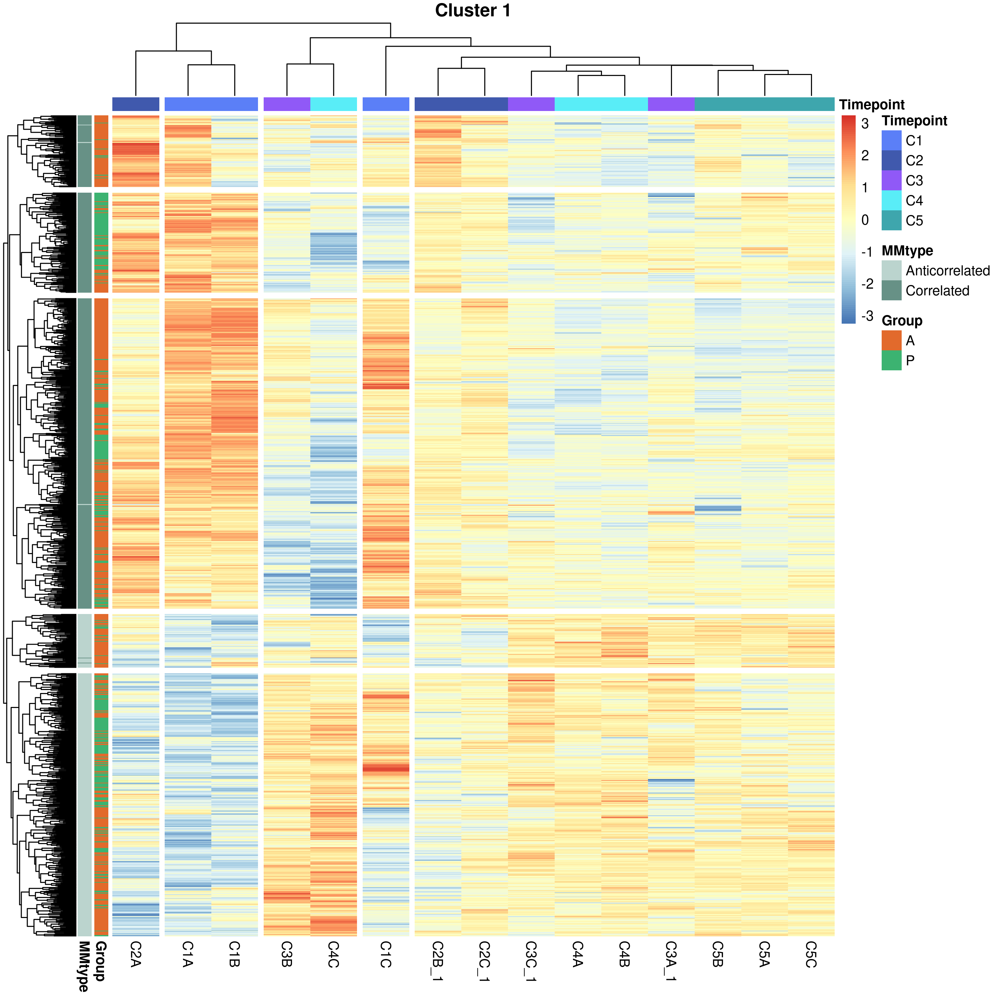

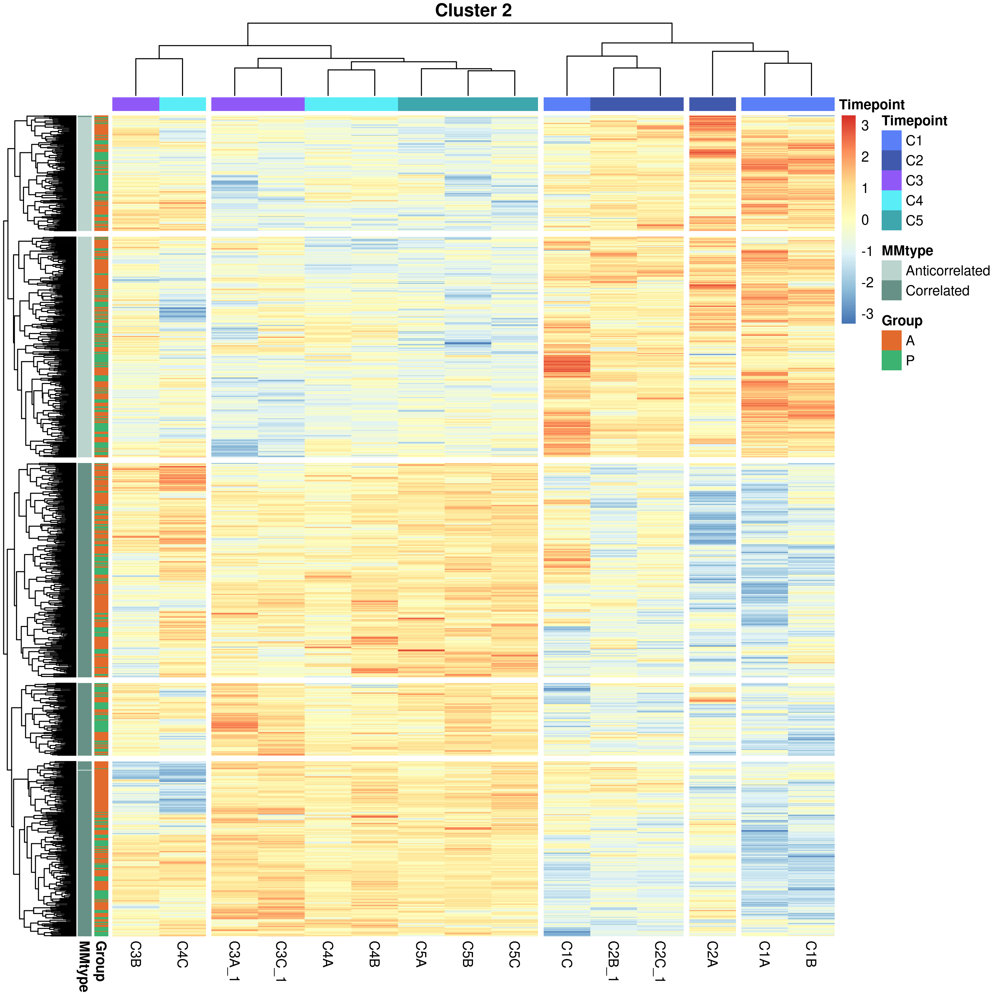

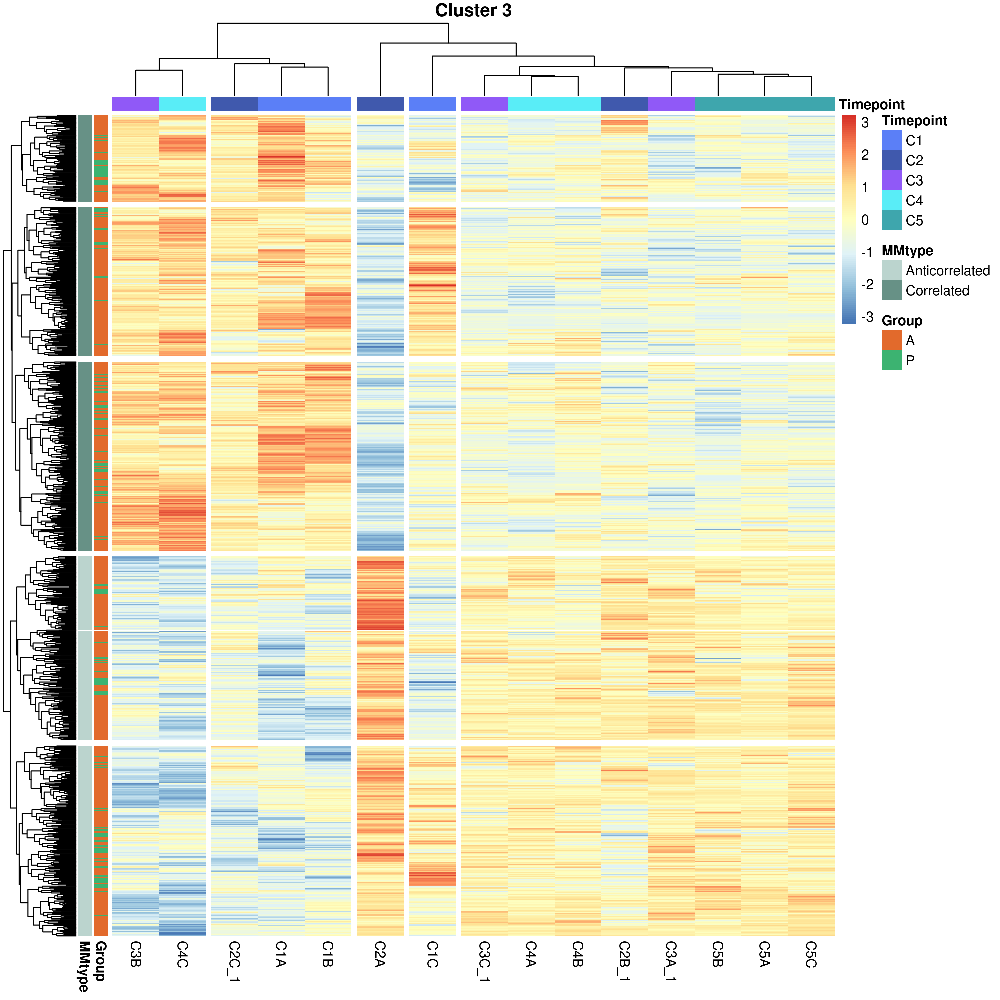

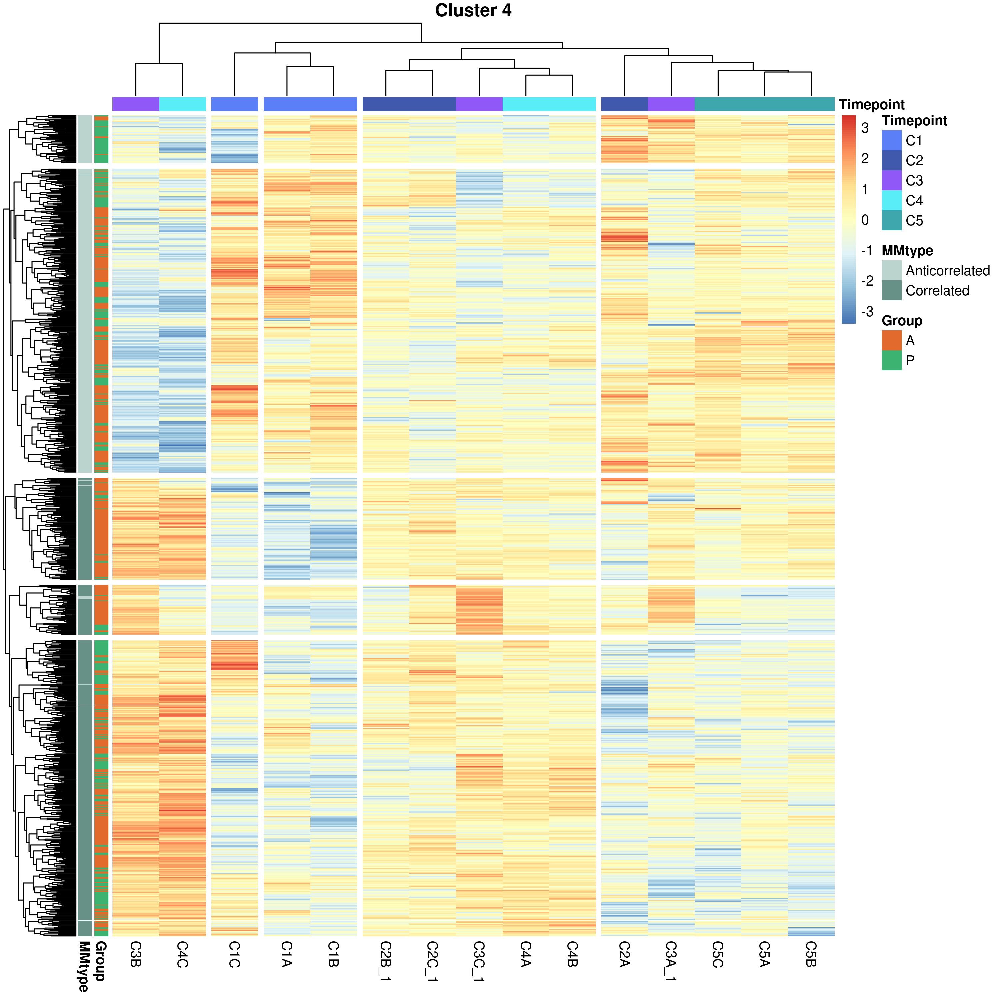

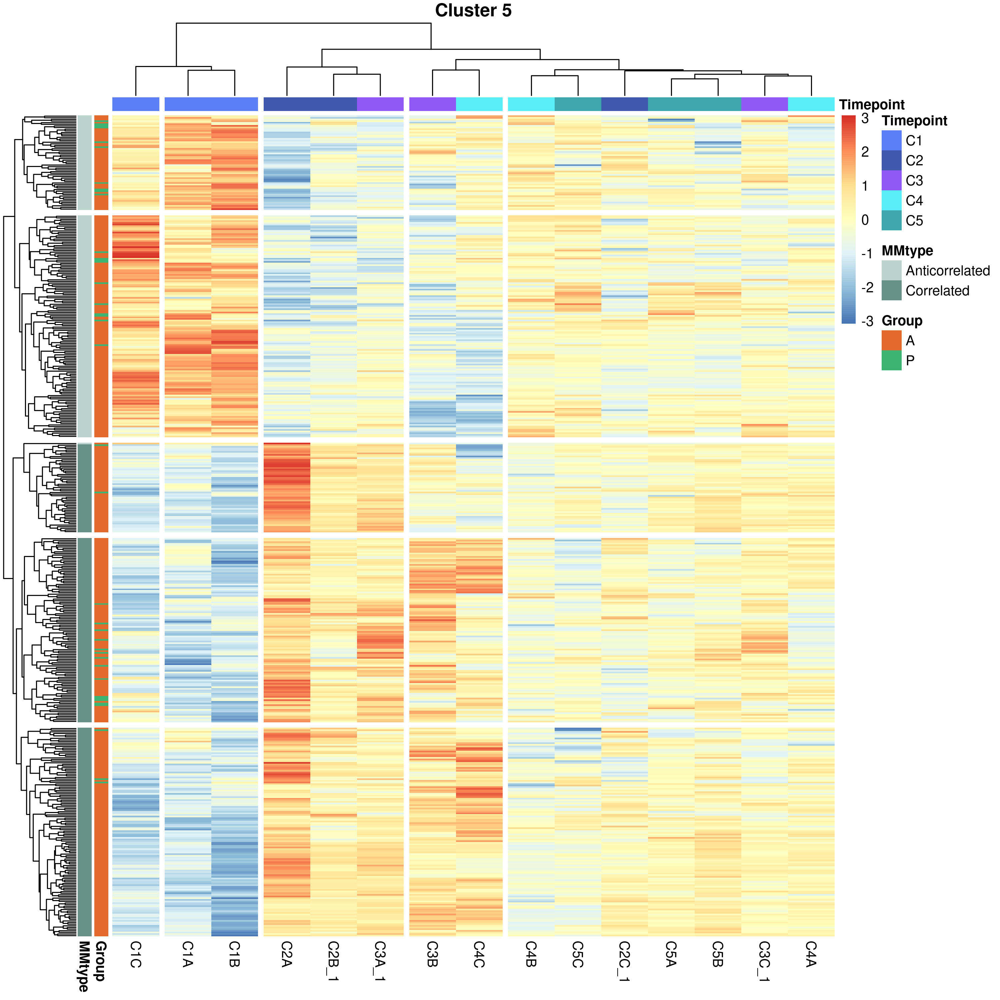

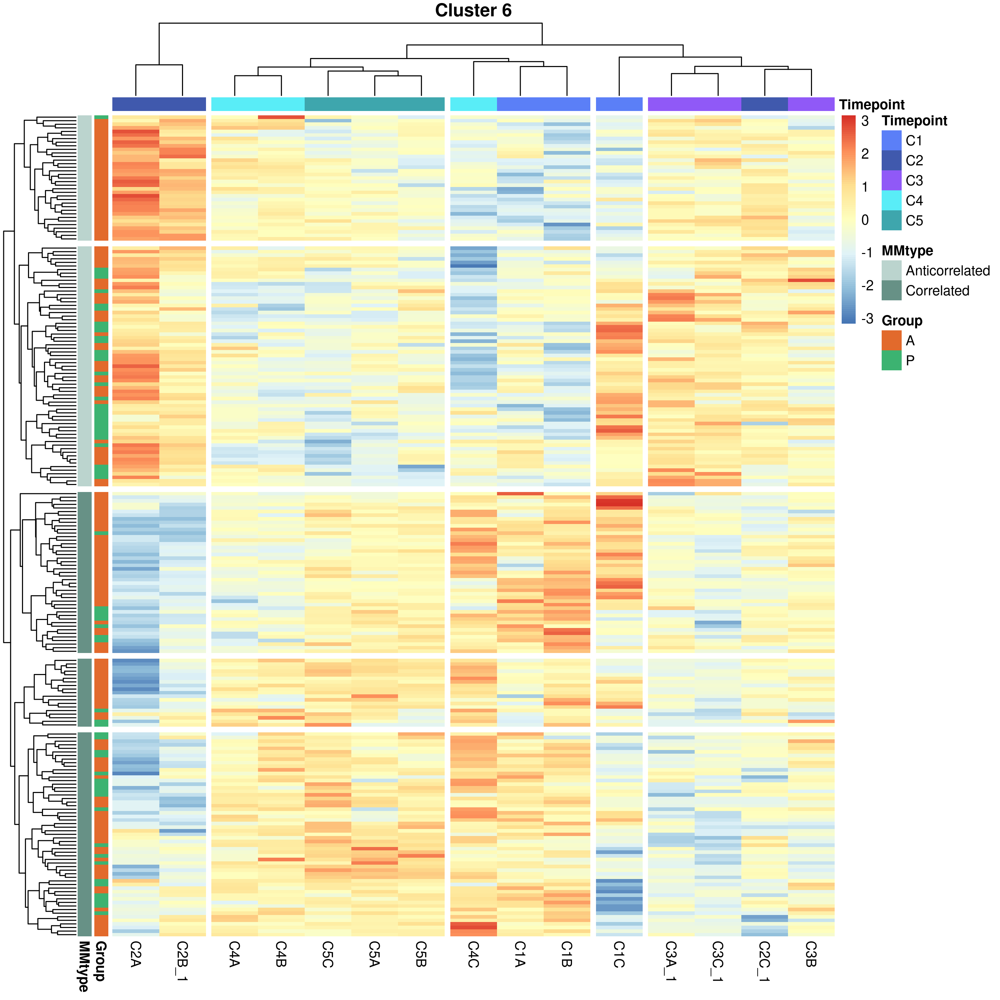

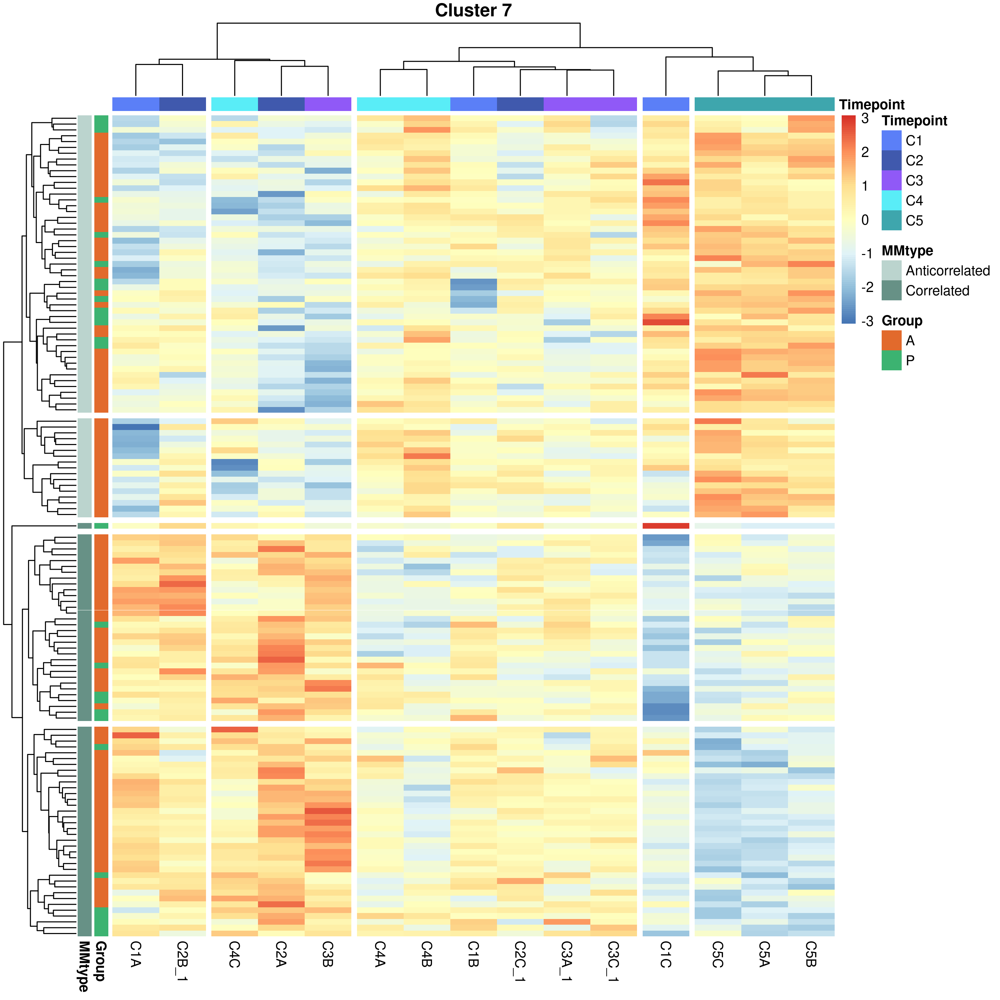

In [399]:
for (cid in c(1:max_cluster)) {
    df = t(vsd_cc_df)[cluster_df$cluster_id == cid, ]
    annotation_row = cluster_df %>% filter(cluster_id == cid) %>%
       select(c('Group', 'MMtype')) %>%
      mutate(Group = factor(Group, levels=c('A', 'P'))) %>%
      mutate(MMtype = factor(MMtype, levels=c('Correlated', 'Anticorrelated'))) 
    annotation_row = as.data.frame(annotation_row)
    annotation_col = data.frame(Timepoint = substr(colnames(df), 1,2))
    rownames(annotation_col) = colnames(df)
    
    rownames(annotation_row) = rownames(df)
    pheatmap(df, scale = 'row', 
             #clustering_distance_rows = "correlation", 
             annotation_row = annotation_row,
             annotation_col = annotation_col,
             annotation_colors = ann_colors,
            cutree_col = 5, cutree_row = 5, 
             show_rownames = FALSE,
             main = paste0("Cluster ", cid)
            )
    }

In [390]:
annotation_col

Timepoint
<chr>


In [181]:
path_df = data.frame(cluster_id = c_net$colors)
path_df$gene_id = rownames(path_df)
path_df$Group = c(AC = 'A', TX = 'P')[substr(path_df$gene_id, 1,2)]
path_df = left_join(path_df, a_path_df, by = 'gene_id', suffix = c('', '_a'))
path_df = left_join(path_df, p_path_df, by = 'gene_id', suffix = c('', '_p'))

In [182]:
commonNames <- names(a_path_df)
commonNames <- commonNames[commonNames != "gene_id"]
for(i in commonNames){
  right <- paste0(i, "_p")
  path_df[is.na(path_df[i]),i] <- path_df[is.na(path_df[i]),right]
}
path_df = select(path_df, -paste0(commonNames, '_p'))
path_df

cluster_id,gene_id,Group,gene,product,protein_id,path_id,main,sub,path,ecpath
<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
4,ACZ81_RS00005,A,dnaA,chromosomal replication initiator protein DnaA,WP_232375975.1,K02313,09130 Environmental Information Processing,09132 Signal transduction,02020 Two-component system [PATH:ko02020],K02313 dnaA; chromosomal replication initiator protein
4,ACZ81_RS00005,A,dnaA,chromosomal replication initiator protein DnaA,WP_232375975.1,K02313,09140 Cellular Processes,09143 Cell growth and death,04112 Cell cycle - Caulobacter [PATH:ko04112],K02313 dnaA; chromosomal replication initiator protein
4,ACZ81_RS00005,A,dnaA,chromosomal replication initiator protein DnaA,WP_232375975.1,K02313,09180 Brite Hierarchies,09182 Protein families: genetic information processing,03032 DNA replication proteins [BR:ko03032],K02313 dnaA; chromosomal replication initiator protein
4,ACZ81_RS00005,A,dnaA,chromosomal replication initiator protein DnaA,WP_232375975.1,K02313,09180 Brite Hierarchies,09182 Protein families: genetic information processing,03036 Chromosome and associated proteins [BR:ko03036],K02313 dnaA; chromosomal replication initiator protein
1,ACZ81_RS00010,A,dnaN,DNA polymerase III subunit beta,WP_012516526.1,K02338,09120 Genetic Information Processing,09124 Replication and repair,03030 DNA replication [PATH:ko03030],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]
1,ACZ81_RS00010,A,dnaN,DNA polymerase III subunit beta,WP_012516526.1,K02338,09120 Genetic Information Processing,09124 Replication and repair,03430 Mismatch repair [PATH:ko03430],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]
1,ACZ81_RS00010,A,dnaN,DNA polymerase III subunit beta,WP_012516526.1,K02338,09120 Genetic Information Processing,09124 Replication and repair,03440 Homologous recombination [PATH:ko03440],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]
1,ACZ81_RS00010,A,dnaN,DNA polymerase III subunit beta,WP_012516526.1,K02338,09180 Brite Hierarchies,09182 Protein families: genetic information processing,03032 DNA replication proteins [BR:ko03032],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]
1,ACZ81_RS00010,A,dnaN,DNA polymerase III subunit beta,WP_012516526.1,K02338,09180 Brite Hierarchies,09182 Protein families: genetic information processing,03400 DNA repair and recombination proteins [BR:ko03400],K02338 dnaN; DNA polymerase III subunit beta [EC:2.7.7.7]


In [297]:
run_enrichment <- function(encolname, mmtype, group, cluster_id) {
    mpath_df = path_df %>%
       filter(main != '')  %>%
       pivot_longer(cols = all_of(encolname), values_to = 'PATH') %>%
       mutate(PATH = word(PATH)) %>%
       distinct(PATH, gene_id, .keep_all= TRUE) %>%
       select(gene_id, PATH)
    path_names = path_df %>%
       filter(main != '')  %>%
       pivot_longer(cols = all_of(encolname), values_to = 'PATH') %>%
       mutate(category = word(PATH)) %>%
       distinct(category, .keep_all= TRUE) %>%
       select(category, PATH)
    if (group != 'All') {
        test_df = filter(cluster_df, Group %in% group)
    } else {
        test_df = cluster_df        
    }

    DEgenes = (test_df$cluster_id == cluster_id) 
    if (mmtype != 'All') {
        DEgenes = (test_df$cluster_id == cluster_id) & (test_df$MMtype %in% mmtype)
    }
    names(DEgenes) = test_df$gene_id
    table(DEgenes)
    LENgenes = test_df$Length
    names(LENgenes) = test_df$gene_id
    pwf = nullp(DEgenes, bias.data=LENgenes)
    goseq_res = goseq(pwf, gene2cat = as.data.frame(mpath_df))
    goseq_res = left_join(goseq_res, path_names)
    goseq_res$padj = p.adjust(goseq_res$over_represented_pvalue, method="BH")
    goseq_res = goseq_res %>%
       relocate(padj, .after = over_represented_pvalue) %>%
       relocate(PATH, .after = category) 
    goseq_res$cluster_id = cluster_id
    goseq_res$enrich = encolname
    goseq_res$Group = group
    goseq_res$MMtype = mmtype

    
    #goseq_res$Group = 'HOT1A3'
    #return(mpath_df)
    return (goseq_res)
}

In [298]:
head(cluster_df)

gene_id,cluster_id,Group,Length,ME_cluster_id,MM,MMtype,MM_pval
<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<dbl>
ACZ81_RS00005,4,A,1653,4,-0.6017591,Anticorrelated,1.762750e-02
ACZ81_RS00010,1,A,1098,1,0.6188549,Correlated,1.390503e-02
ACZ81_RS00015,0,A,1086,0,0.4373525,Correlated,1.030481e-01
ACZ81_RS00020,1,A,2418,1,0.7092986,Correlated,3.063363e-03
ACZ81_RS00025,7,A,441,7,0.6970450,Correlated,3.876176e-03
ACZ81_RS00030,3,A,2076,3,-0.8475265,Anticorrelated,6.626758e-05


Warning message in pcls(G):
“initial point very close to some inequality constraints”
Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


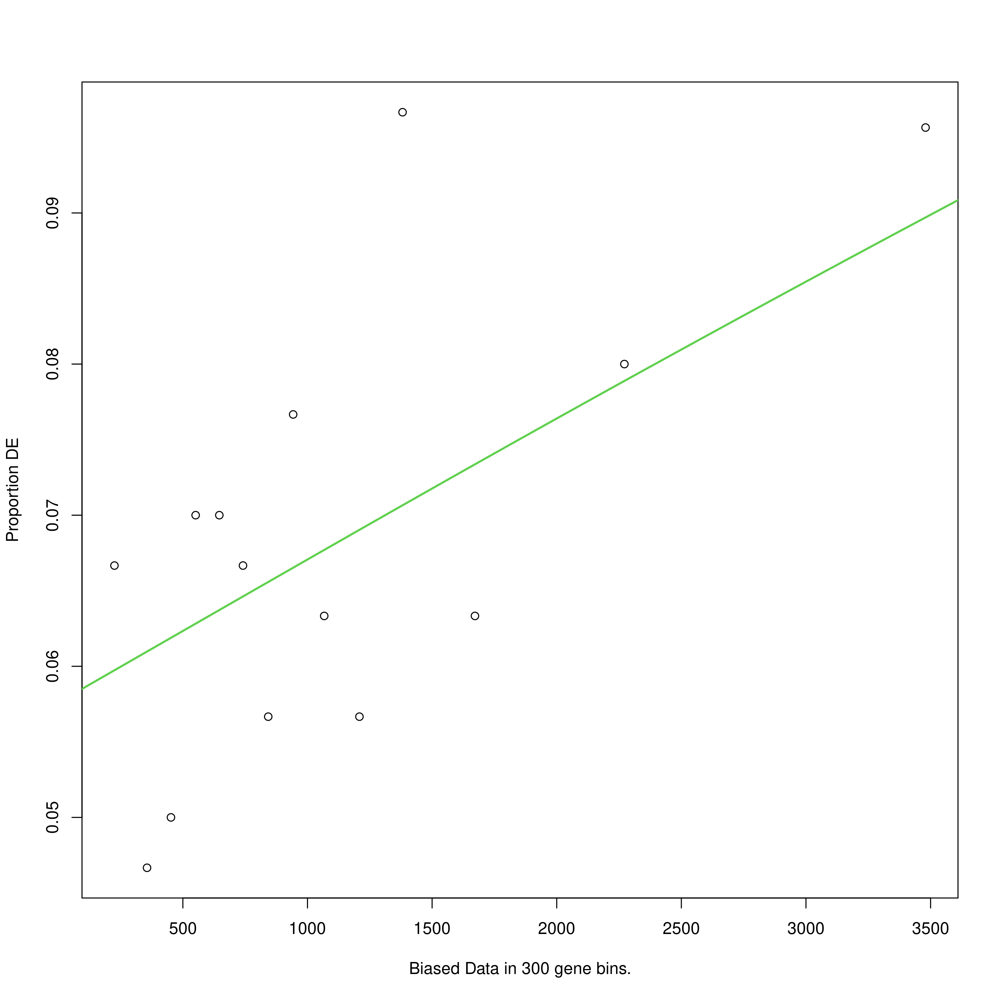

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


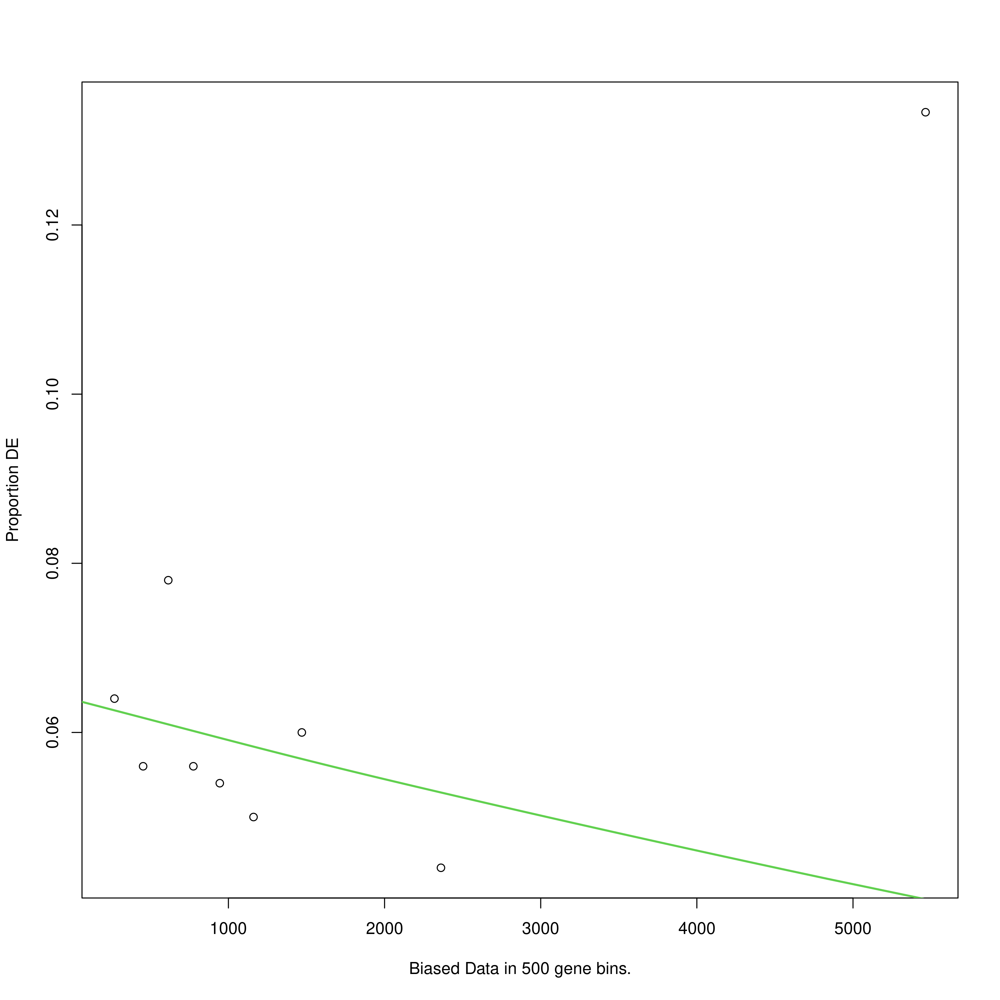

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


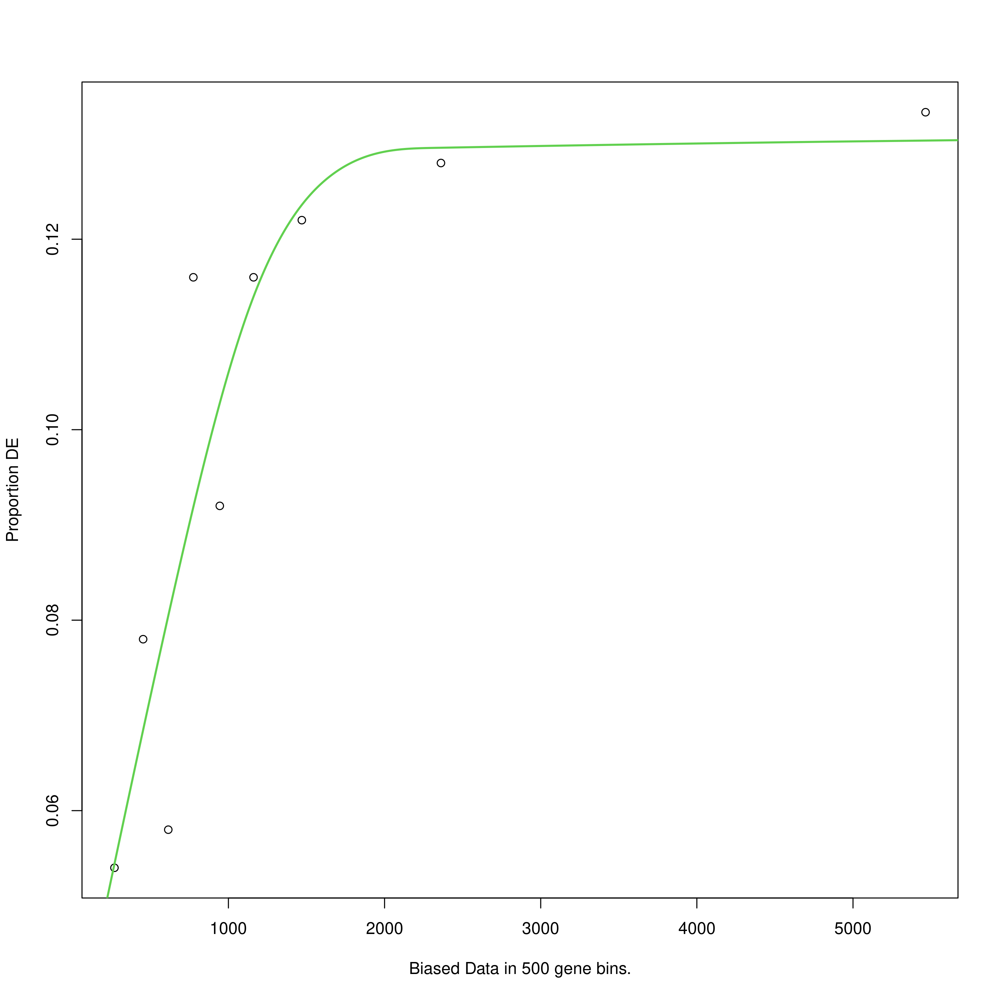

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


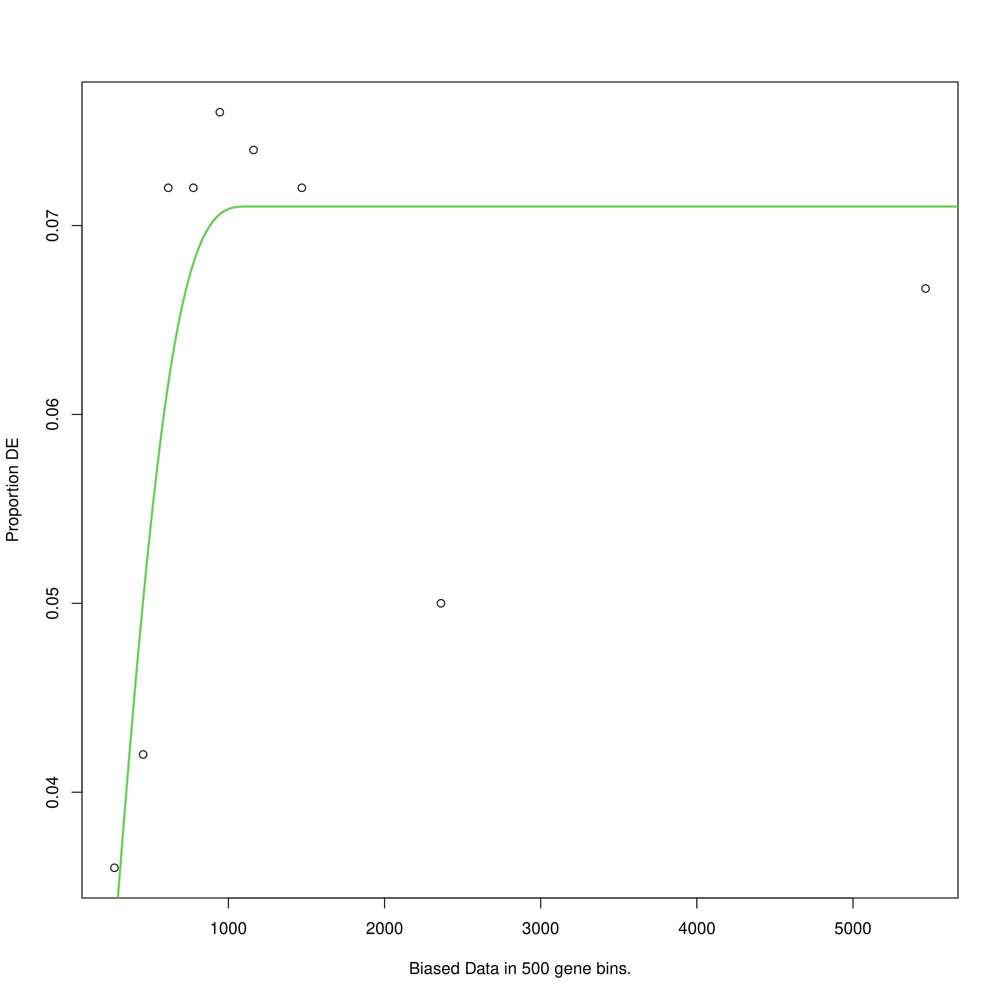

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


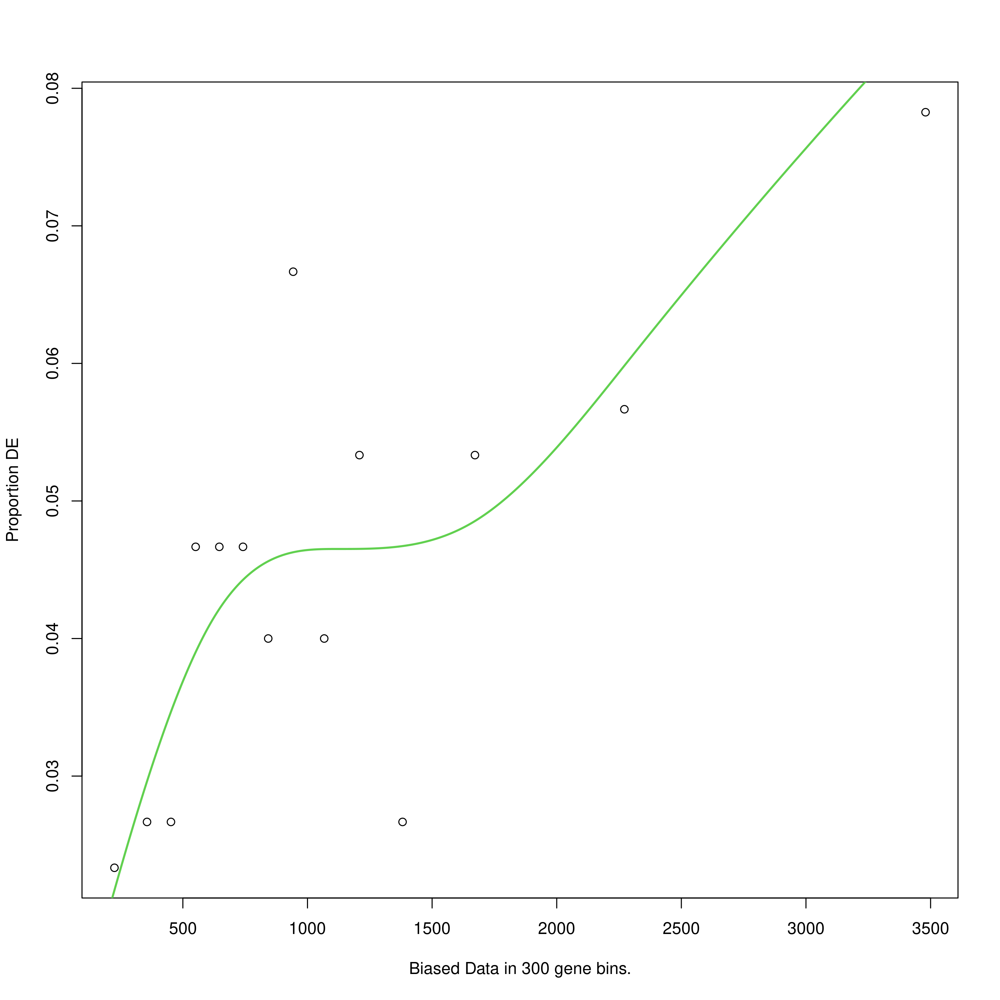

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


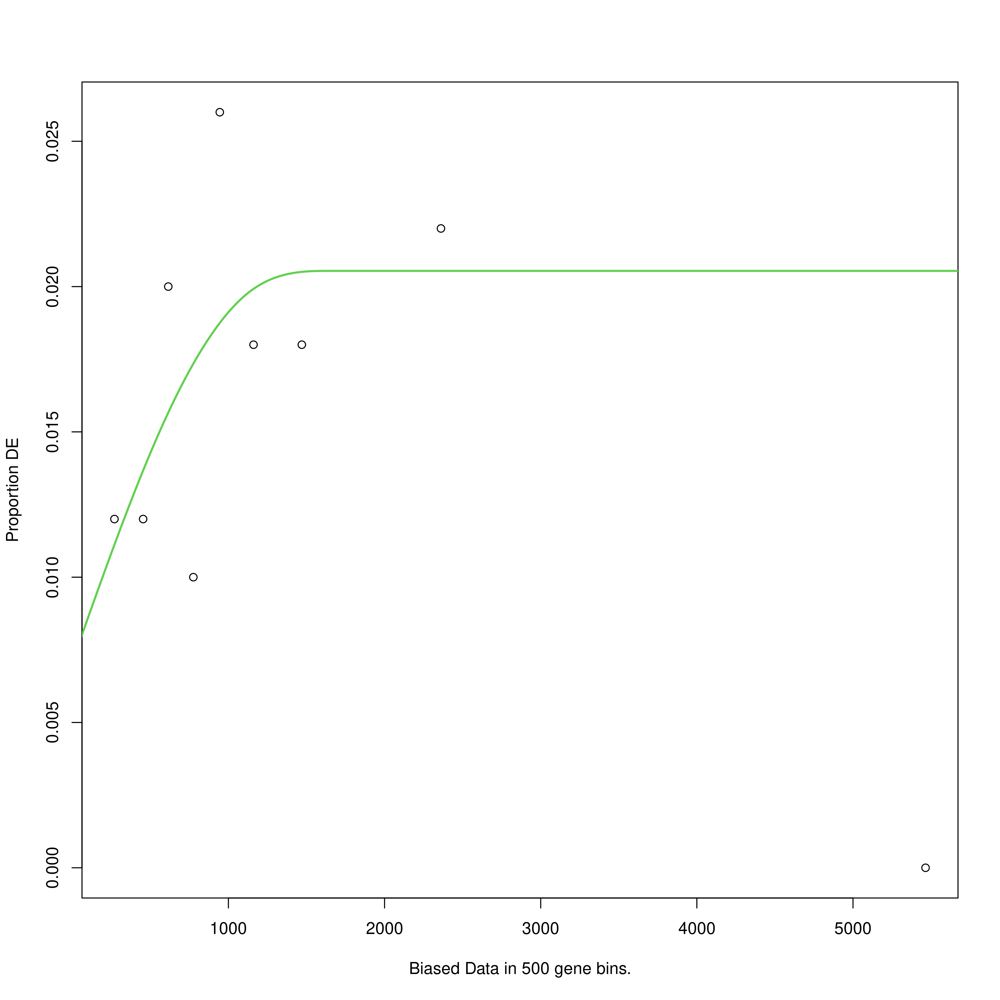

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


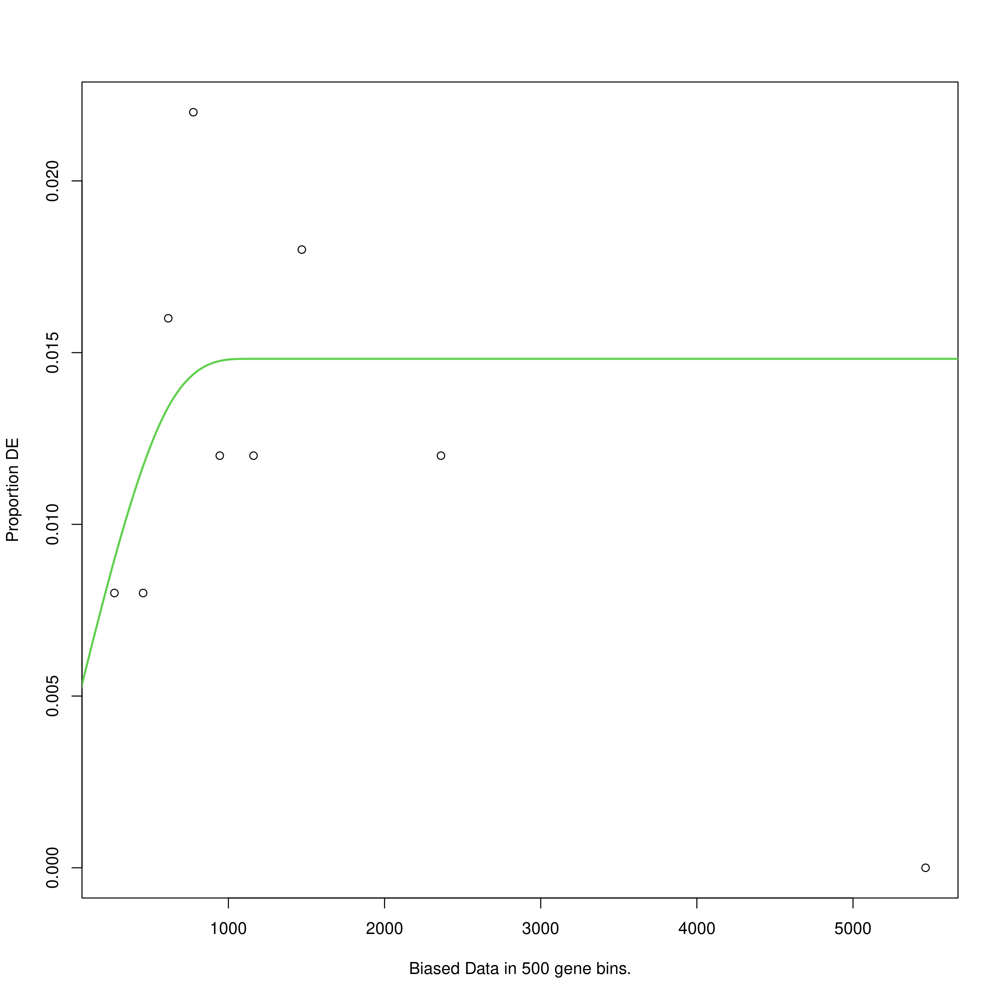

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


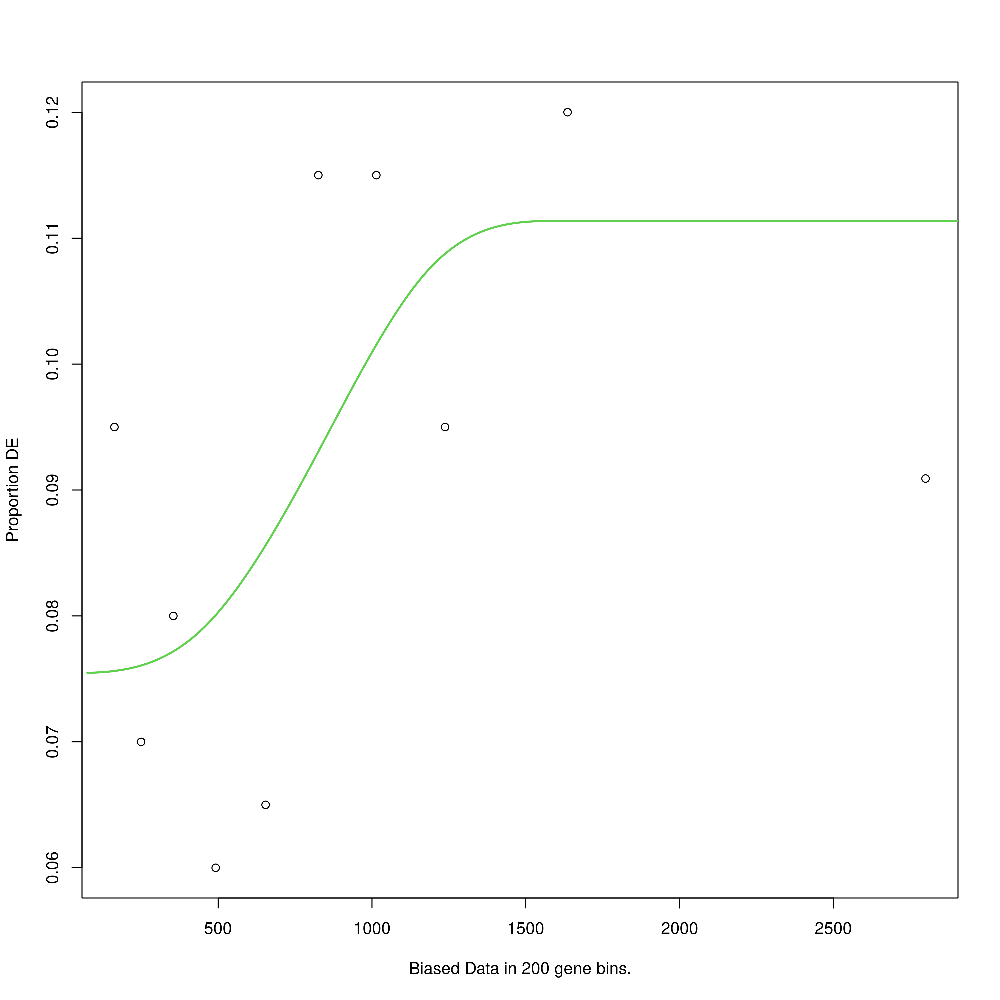

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


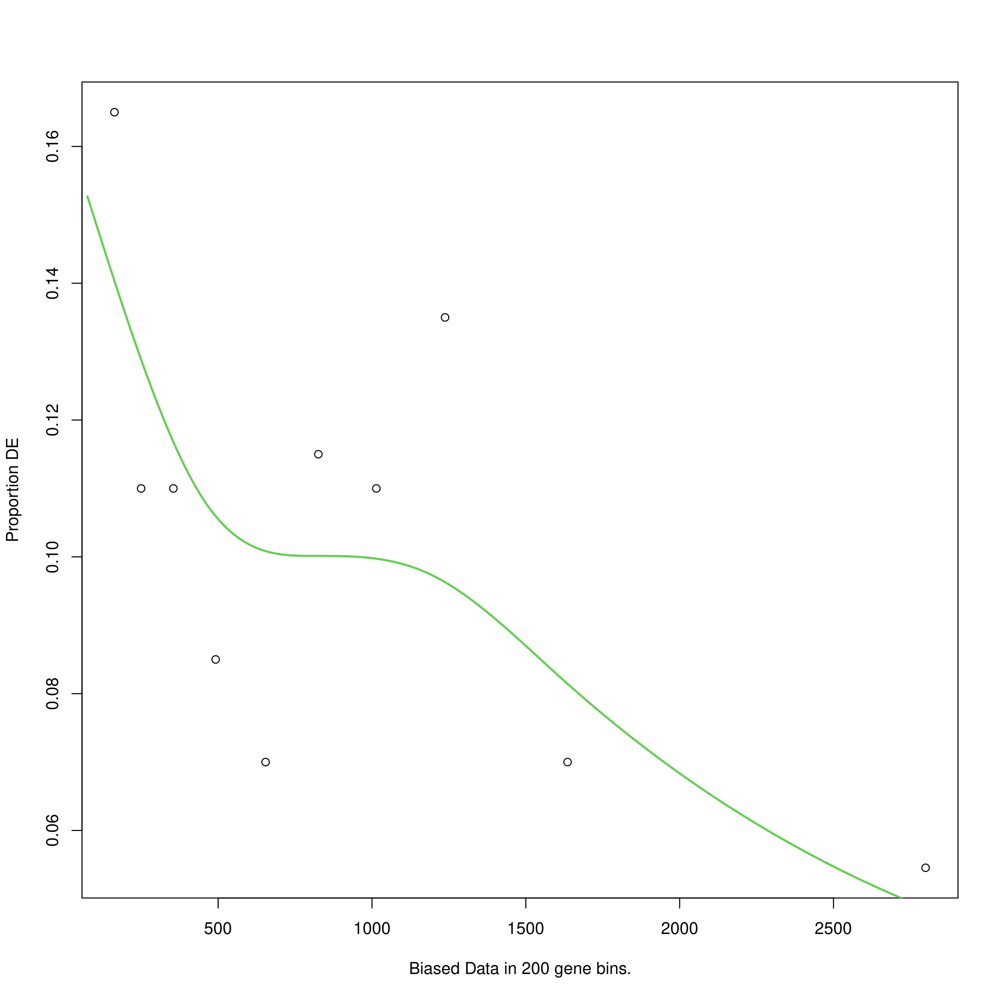

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


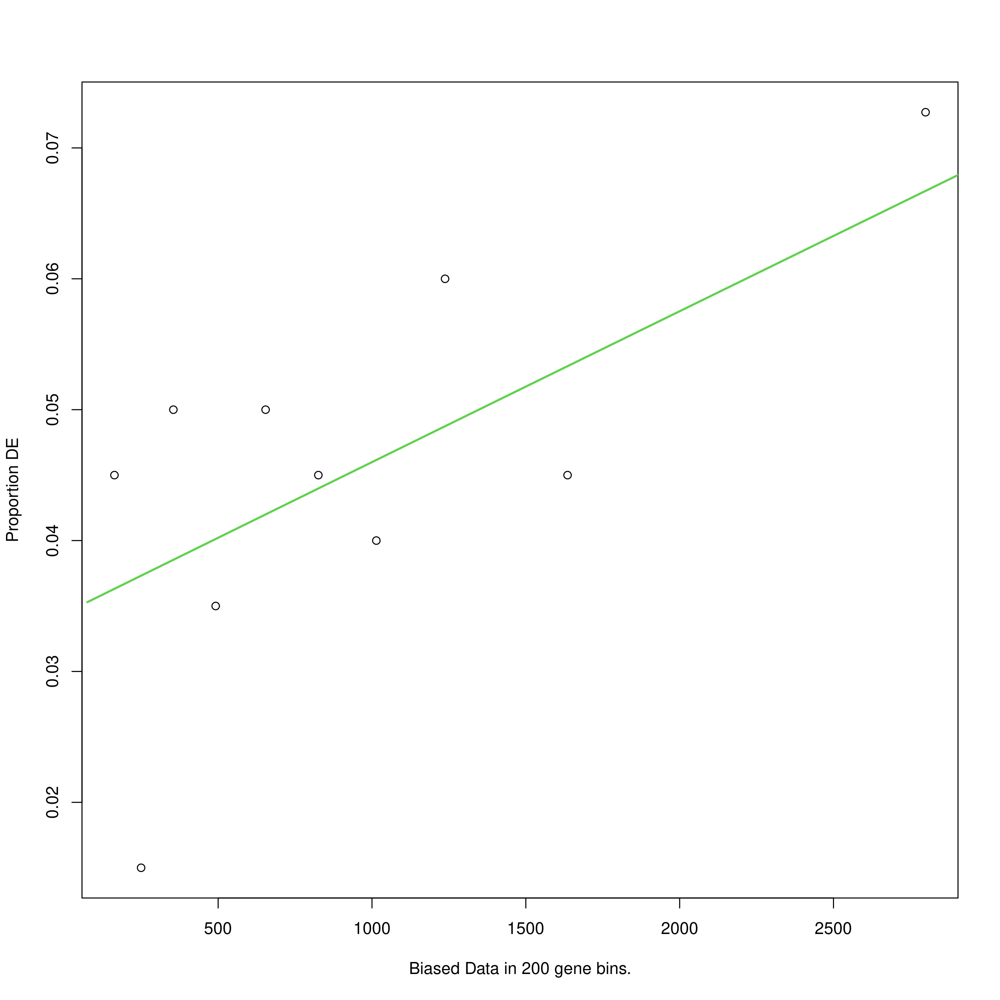

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


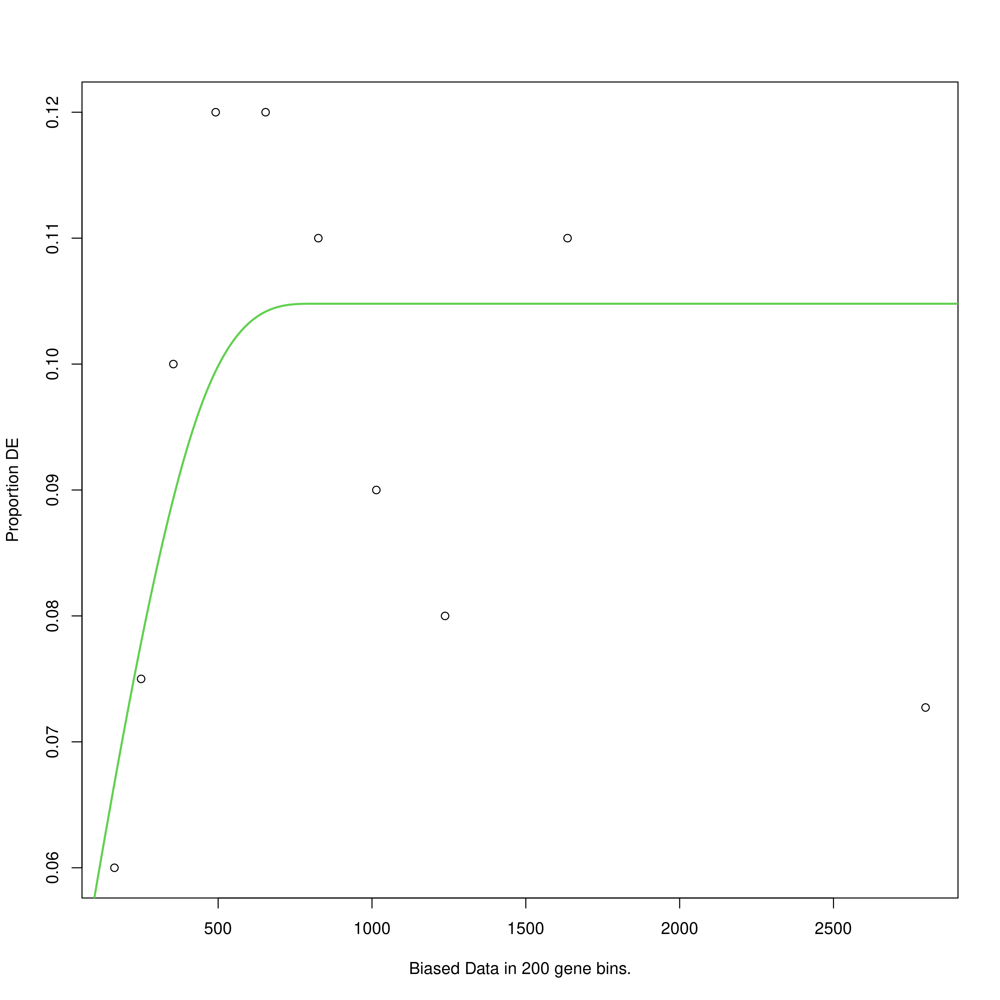

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


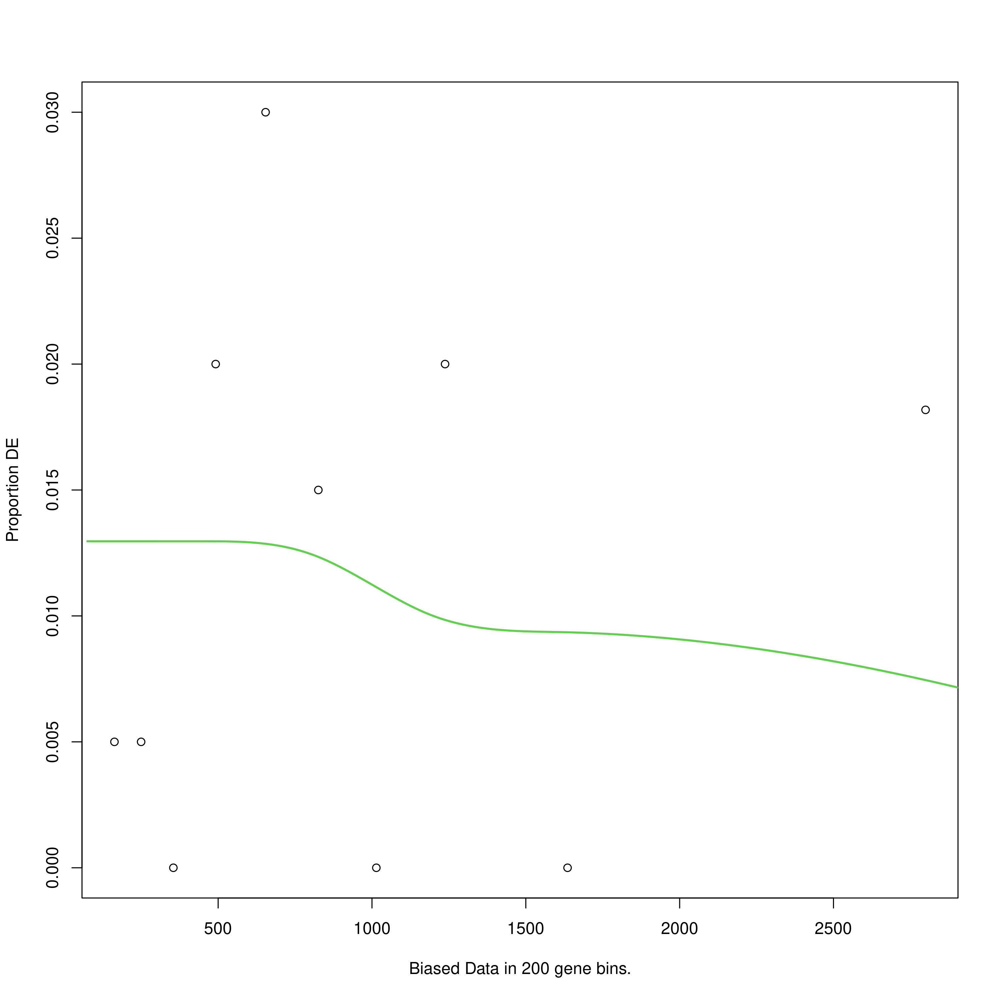

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


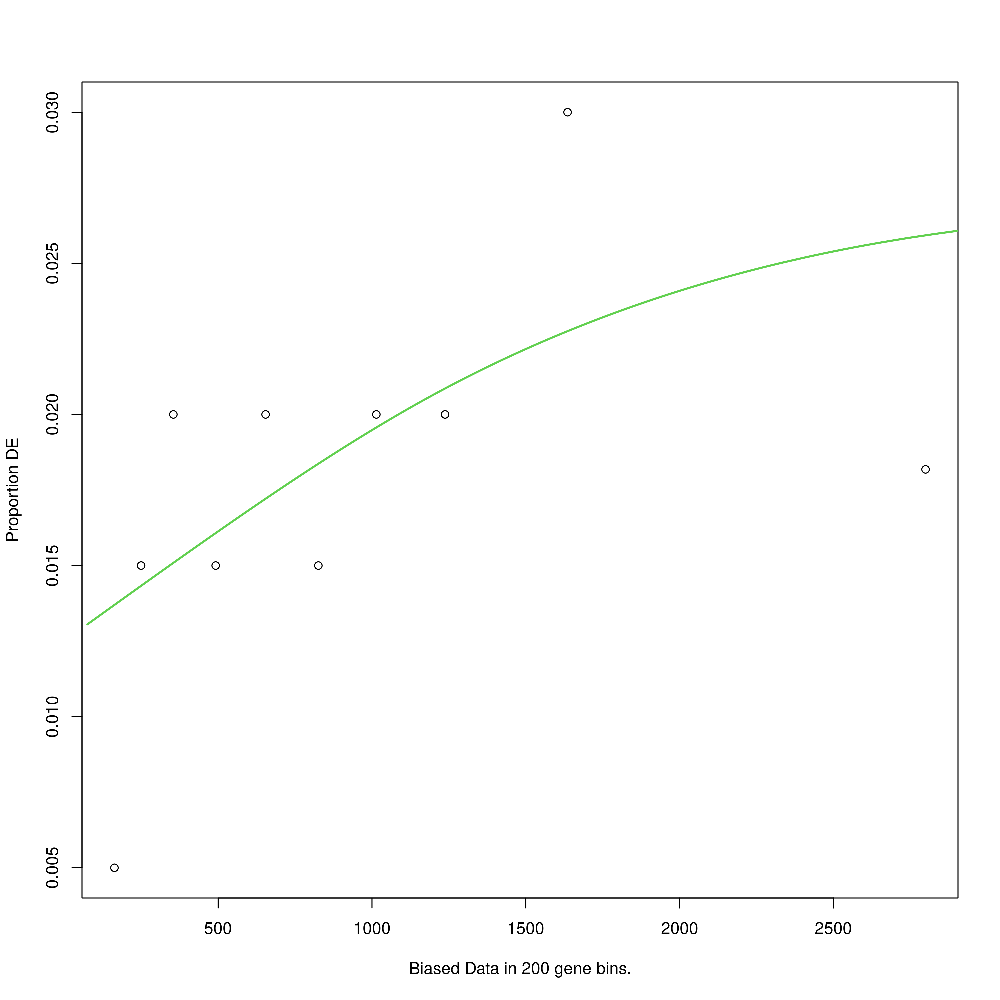

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


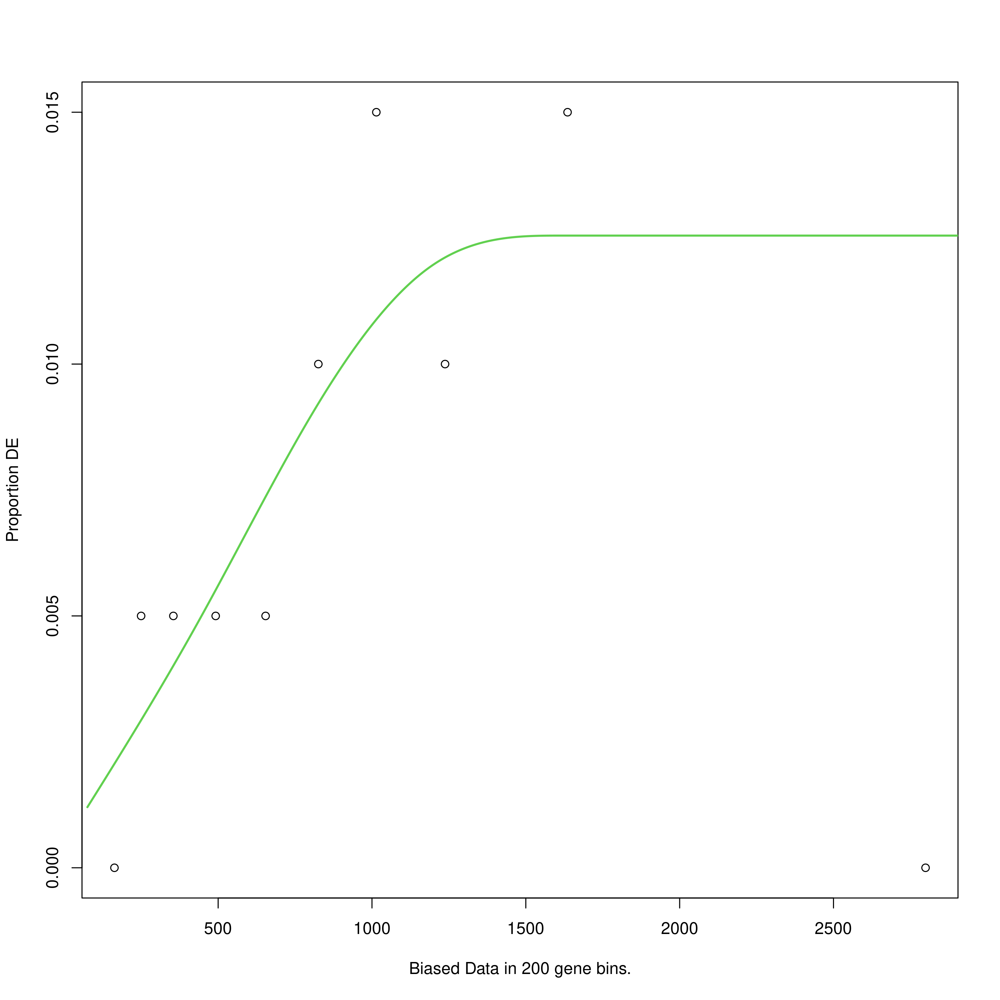

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


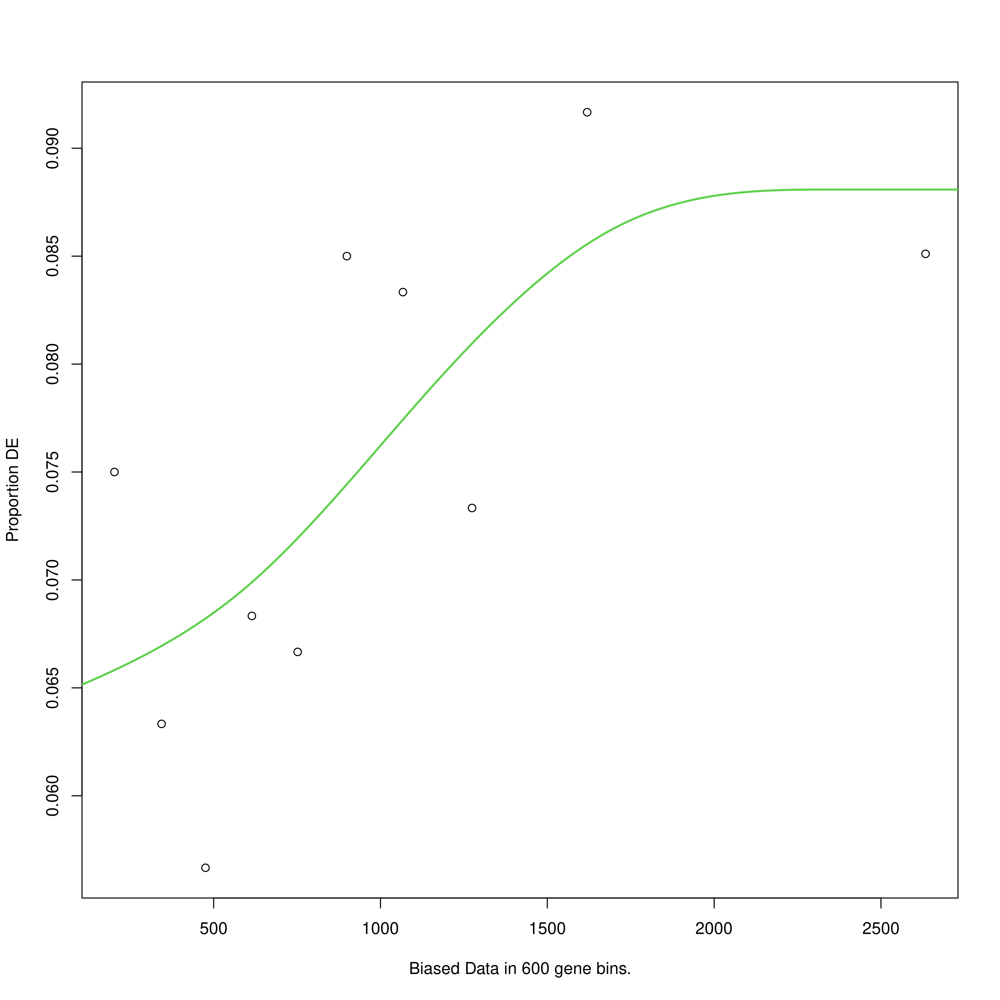

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


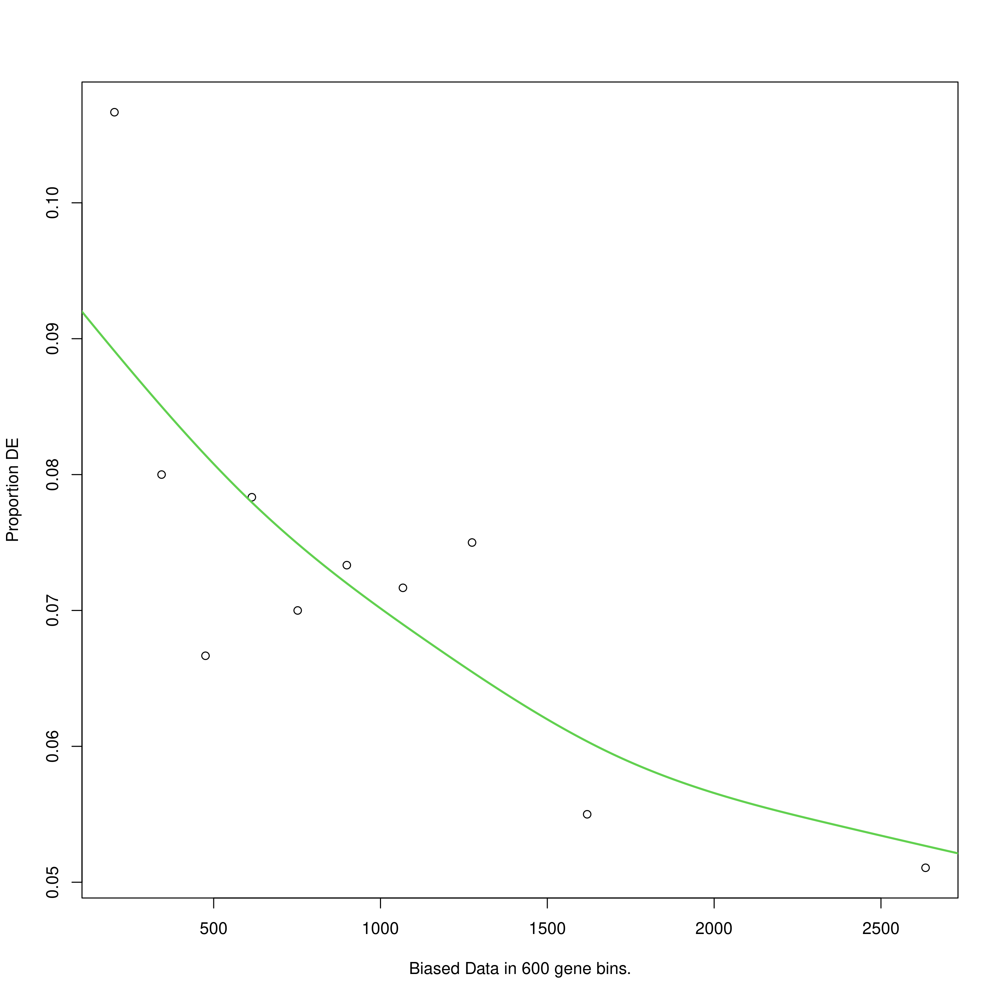

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


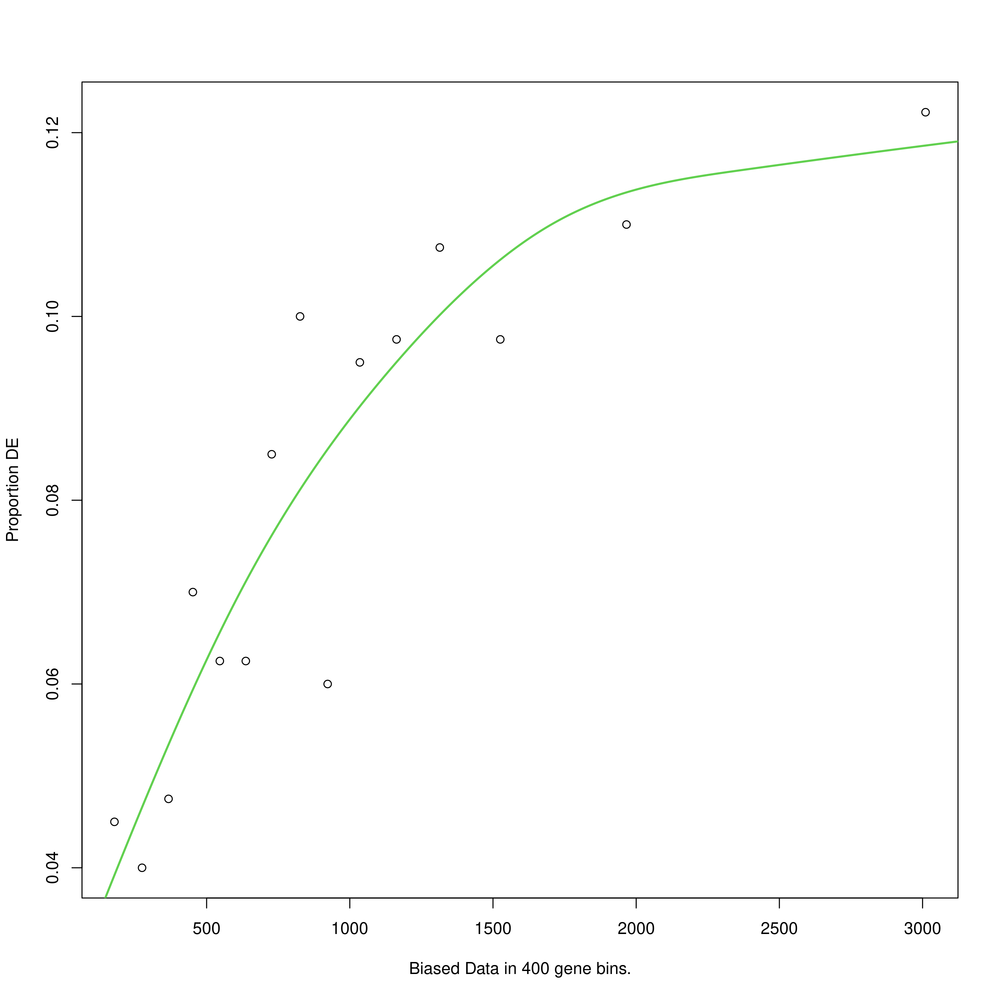

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


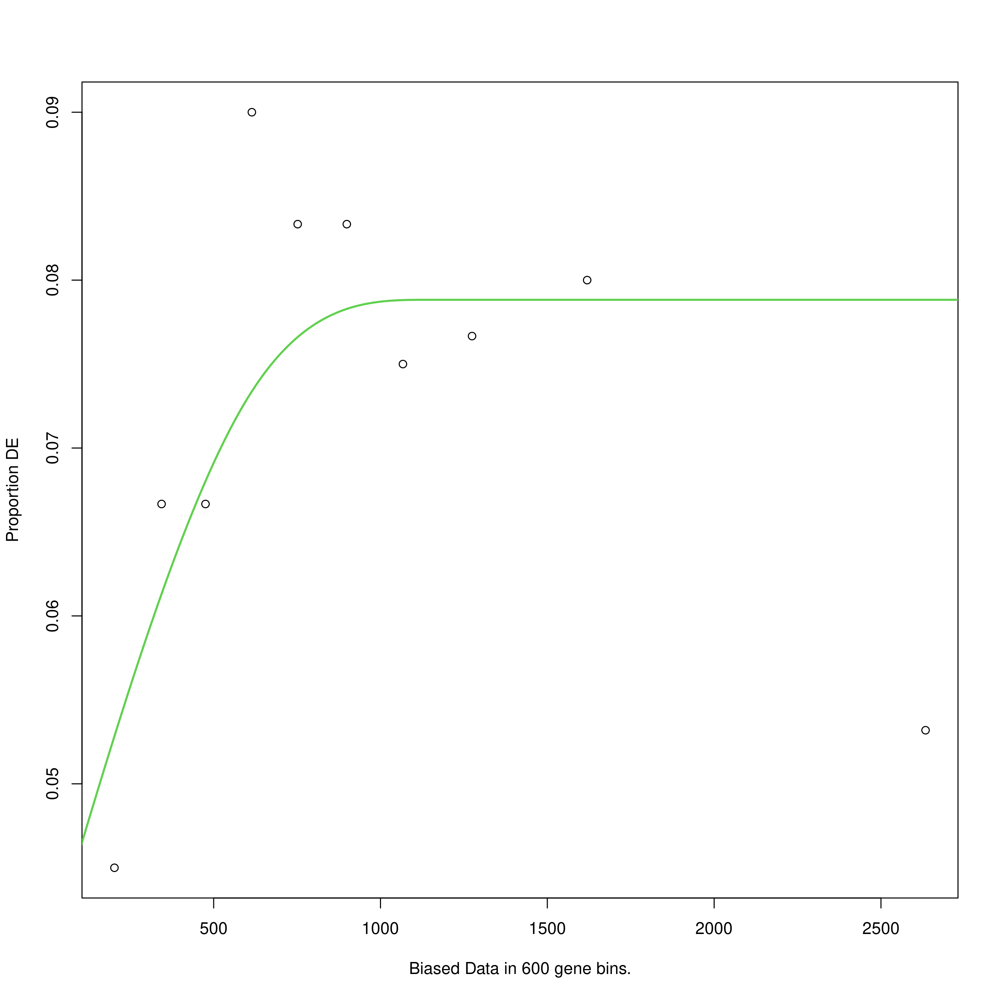

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


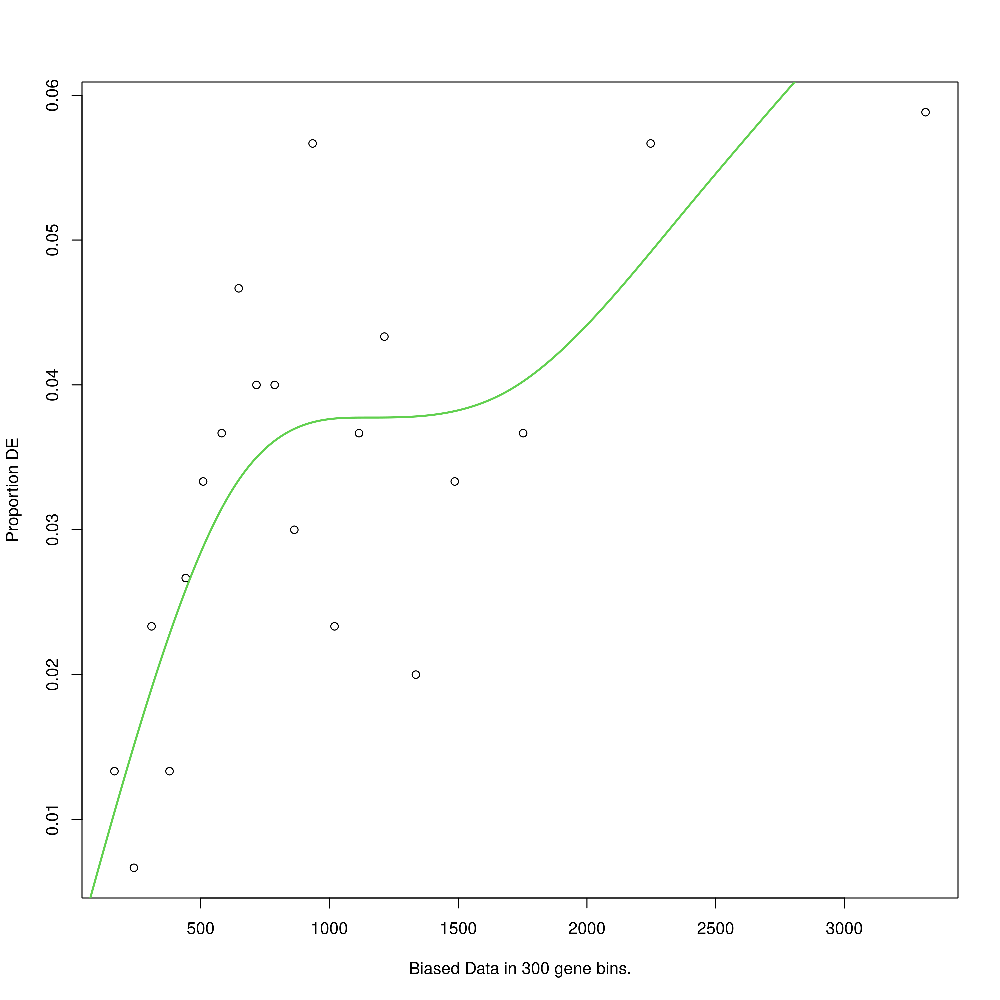

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


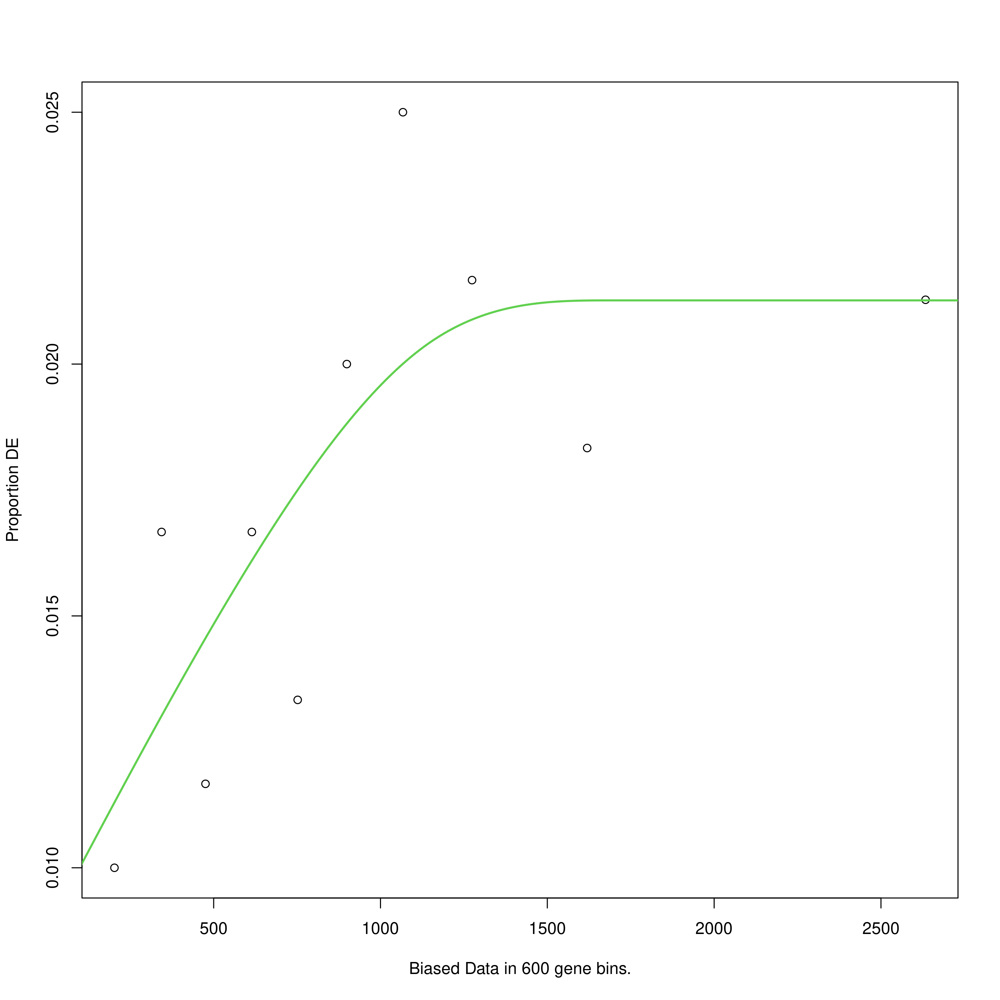

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


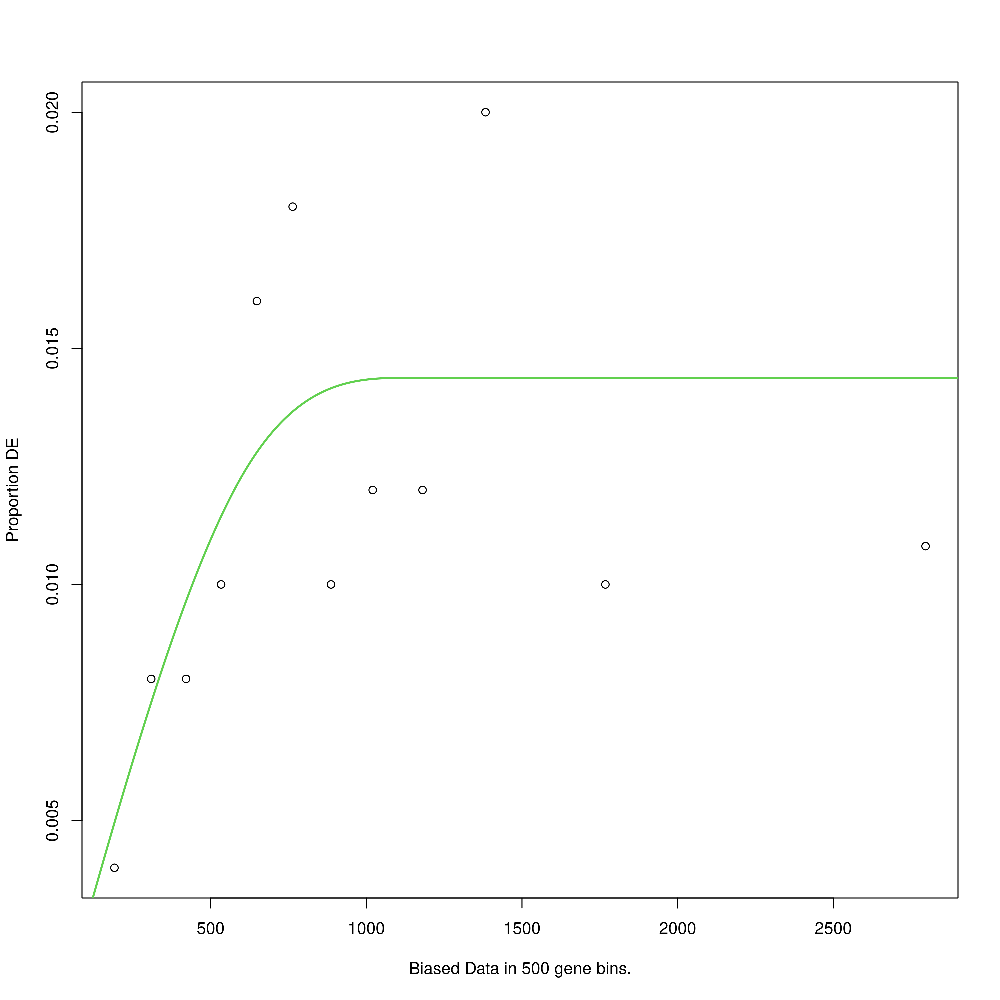

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


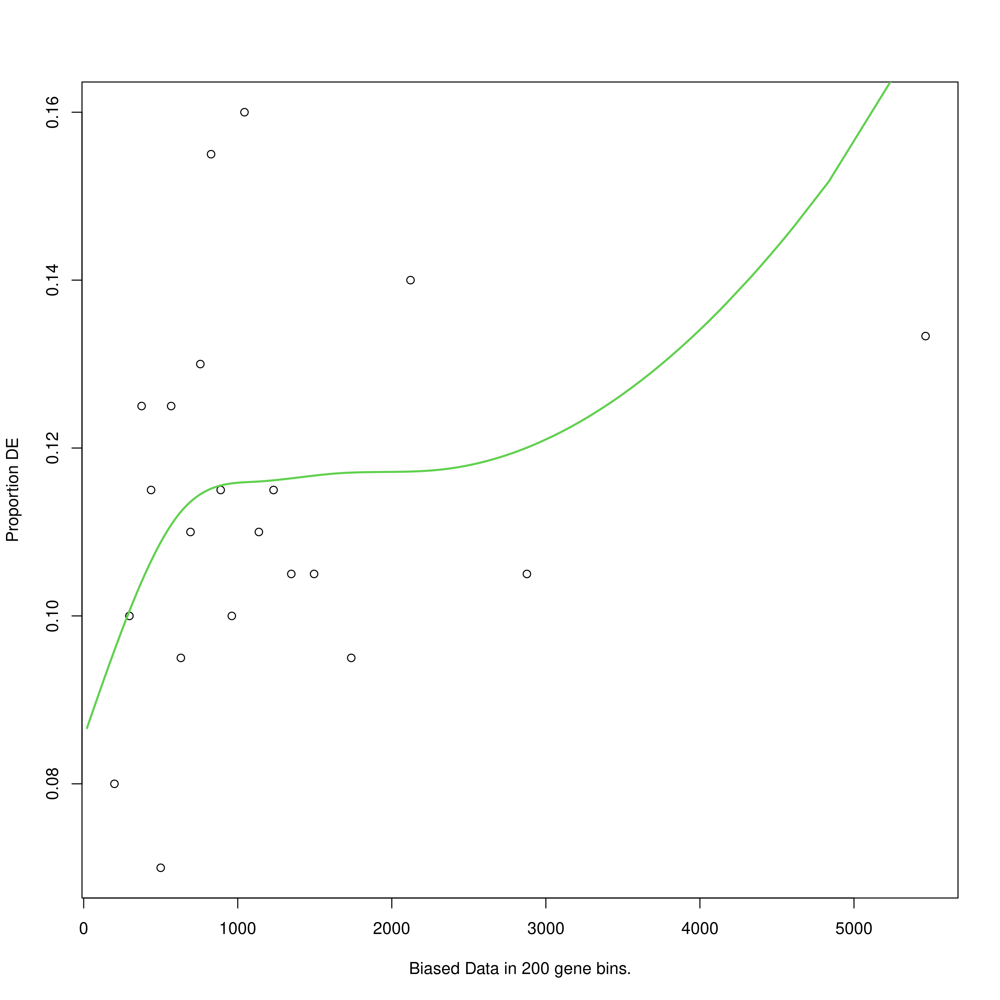

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


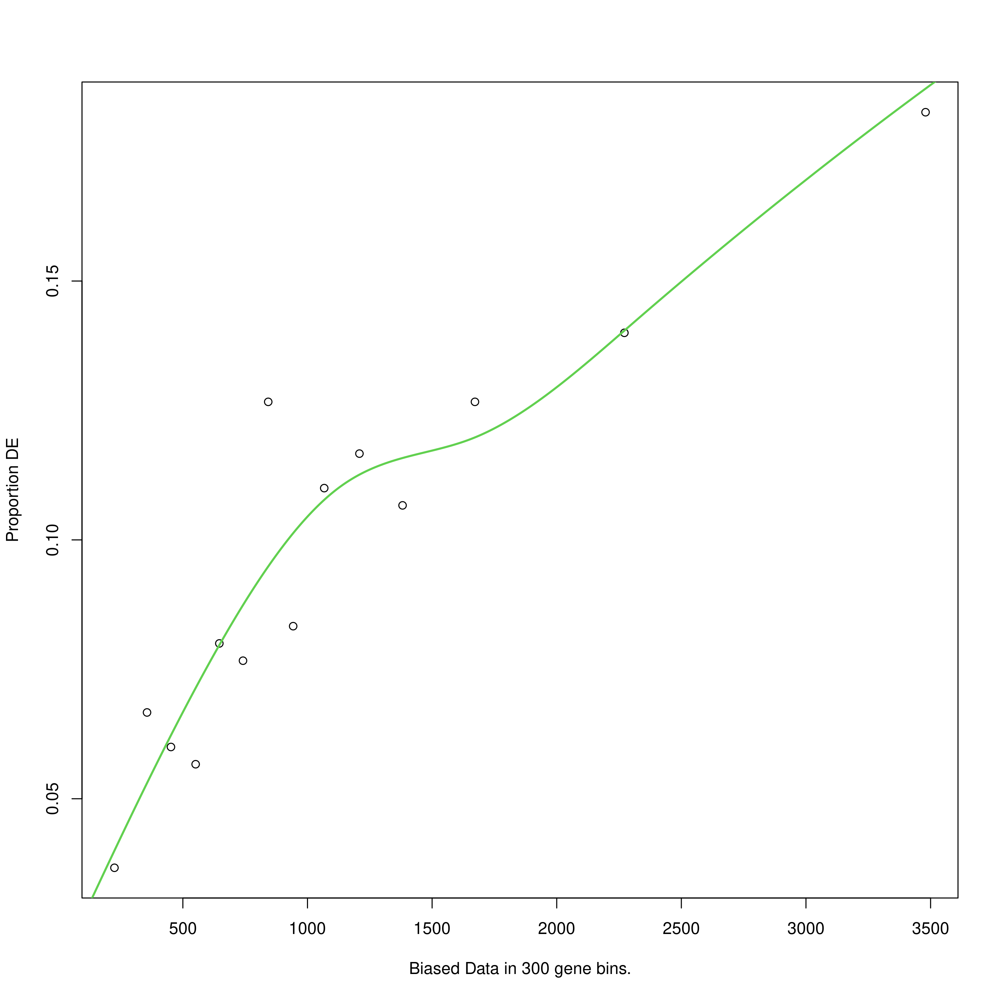

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


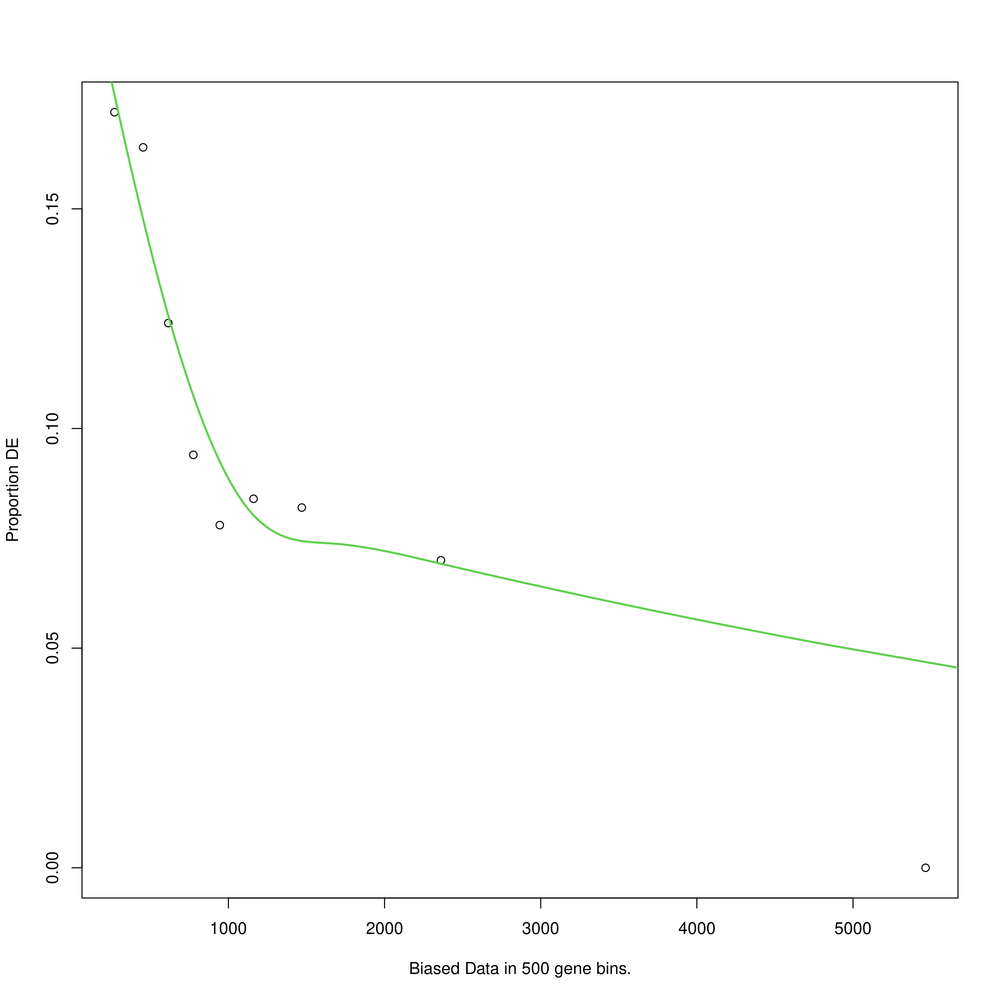

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


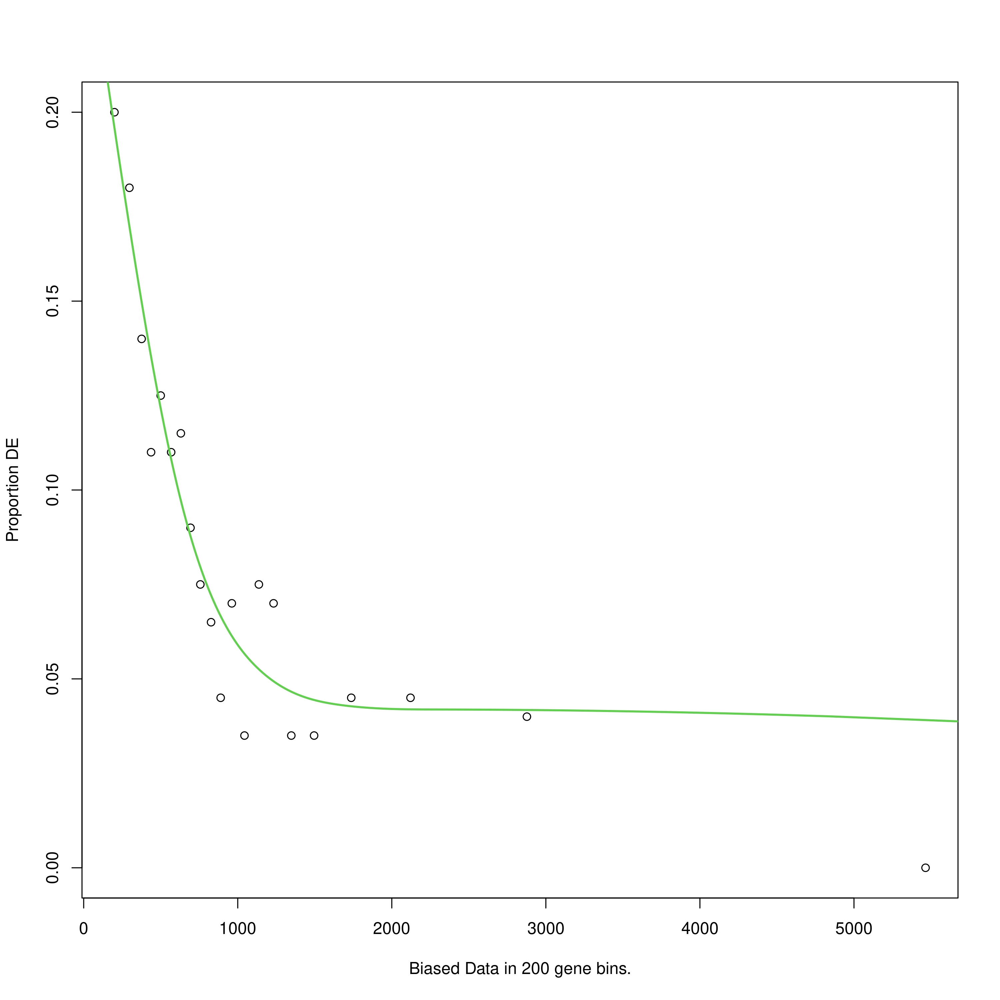

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


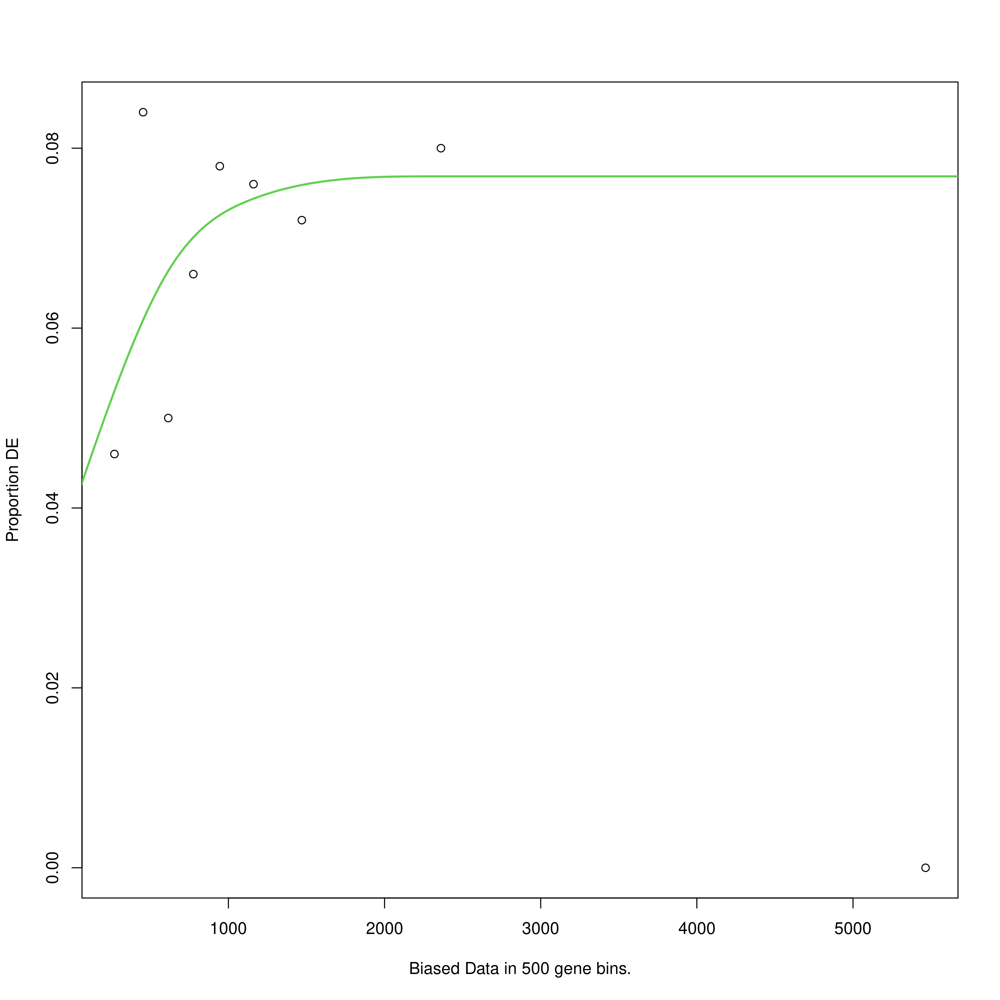

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


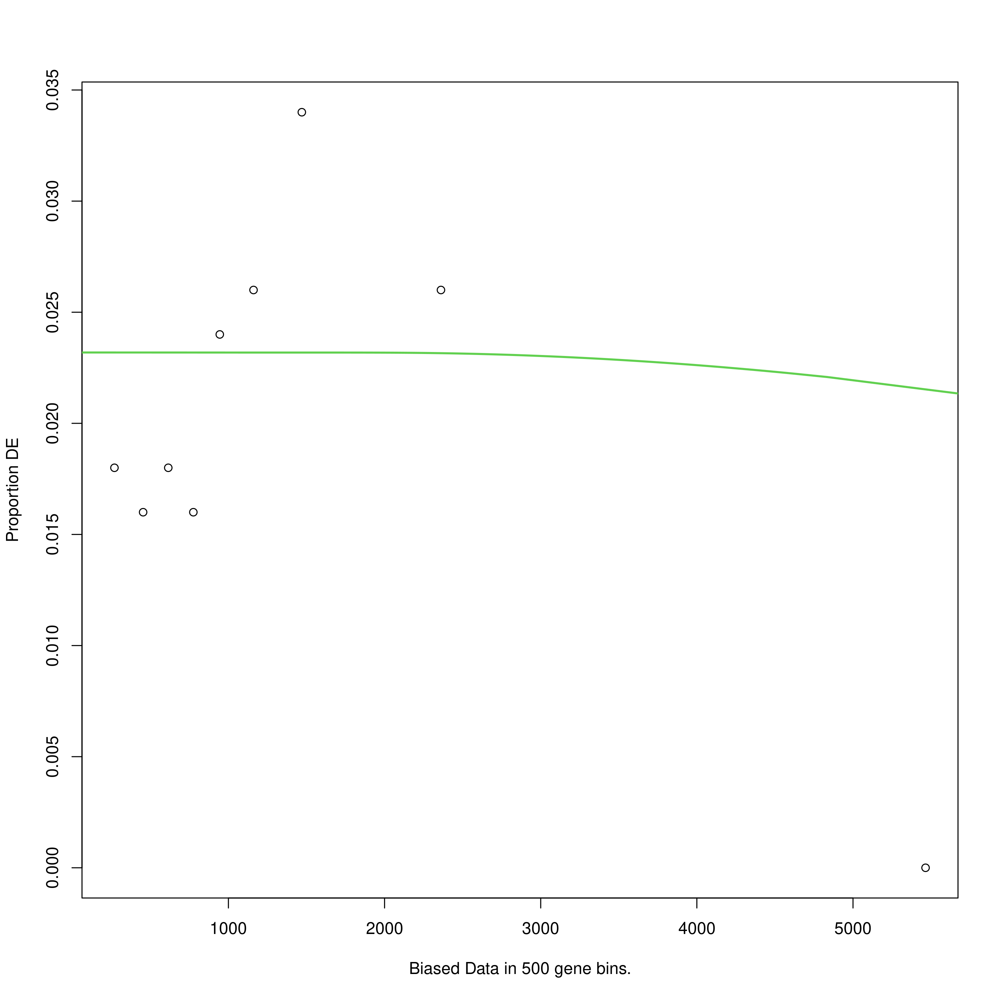

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


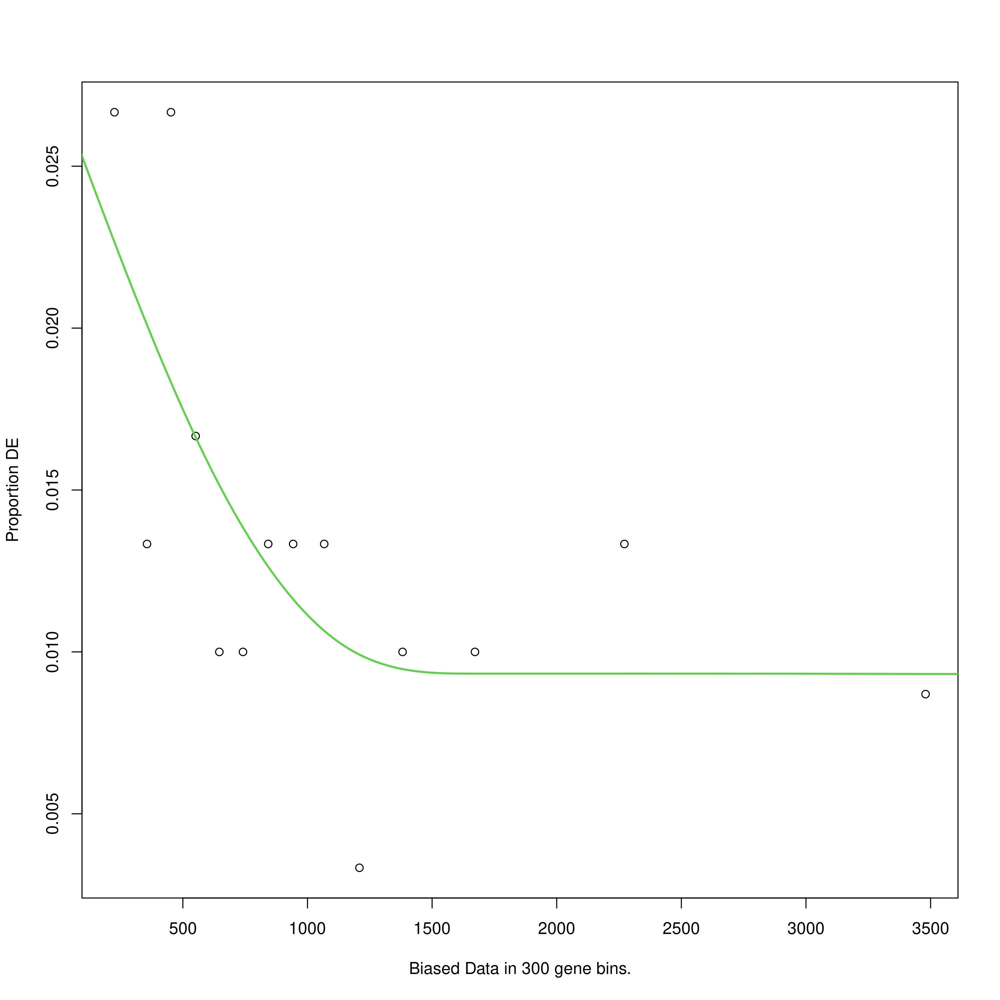

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


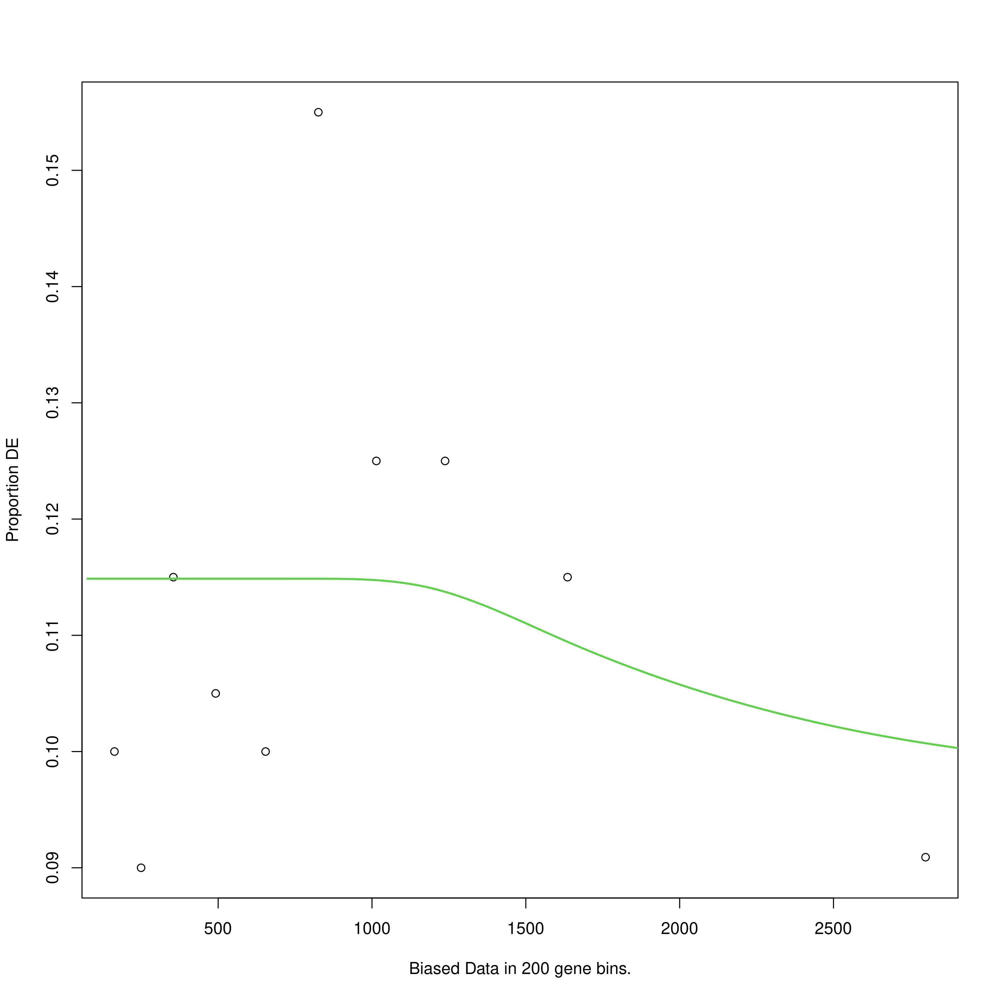

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


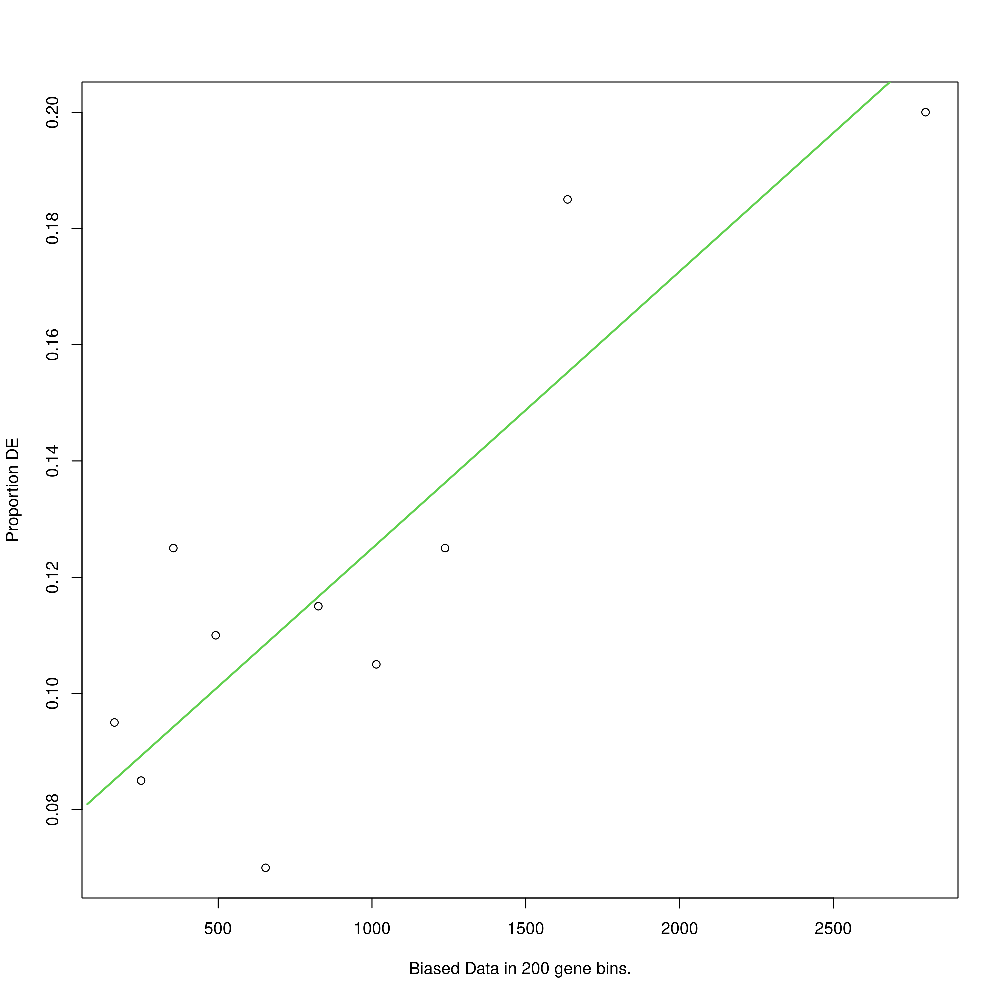

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


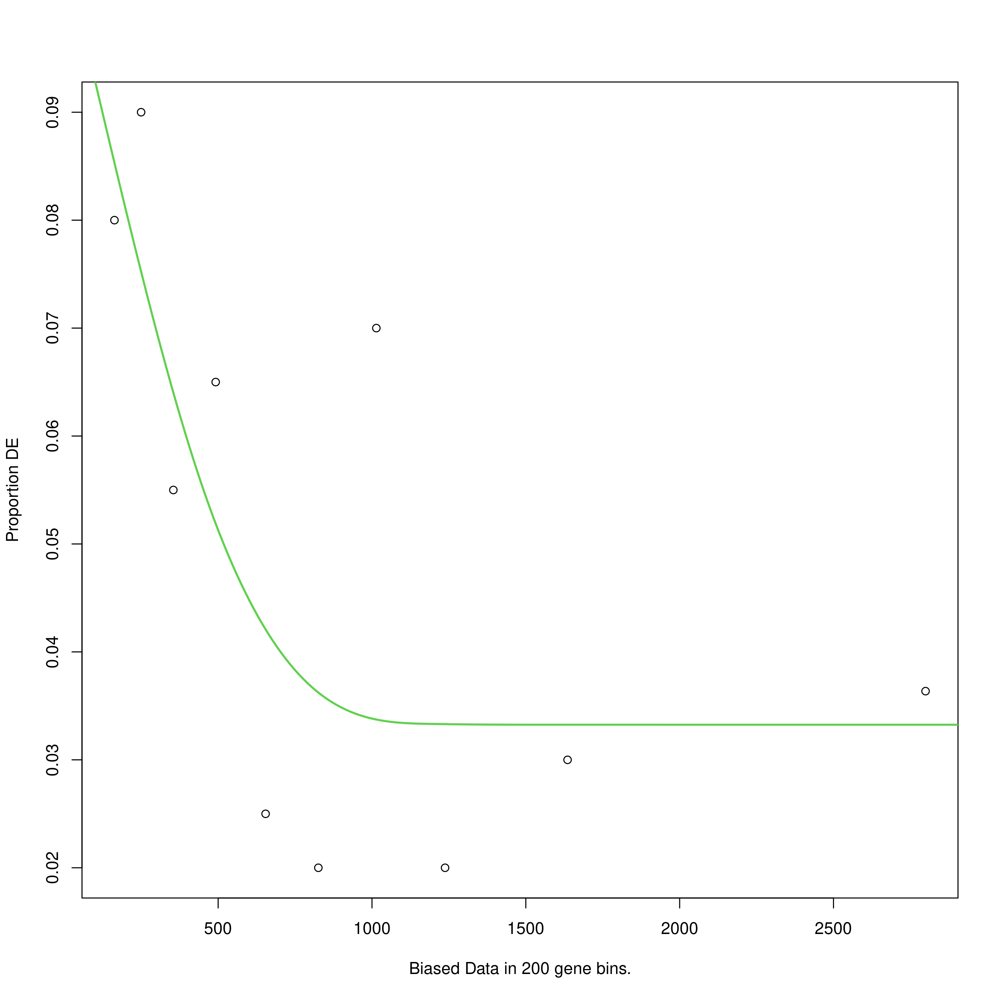

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


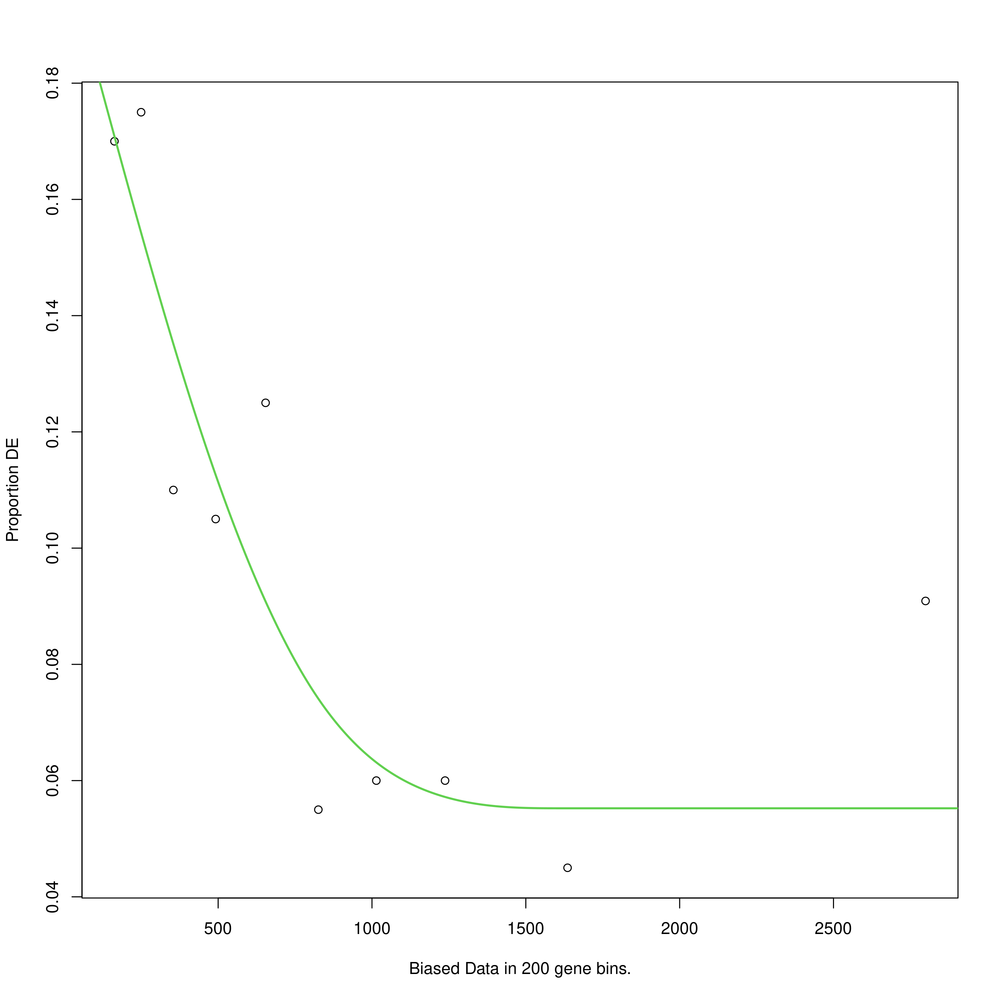

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


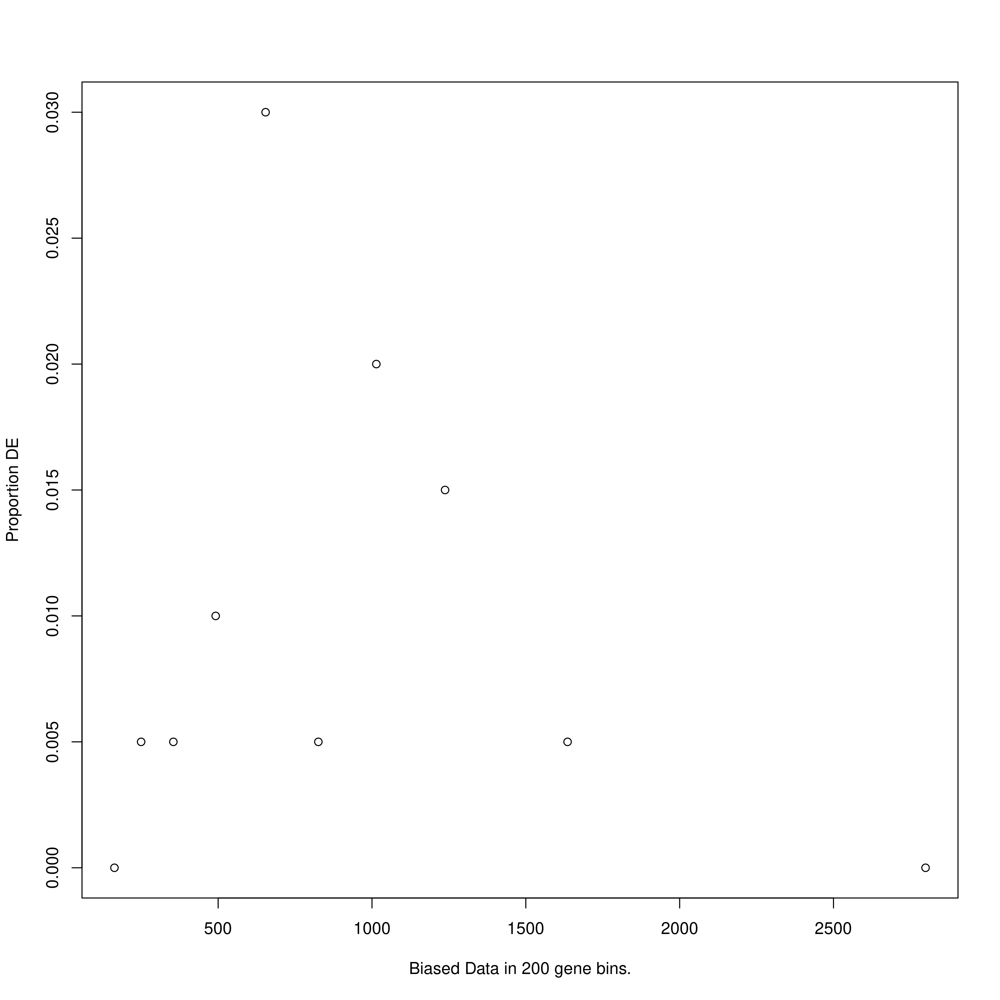

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


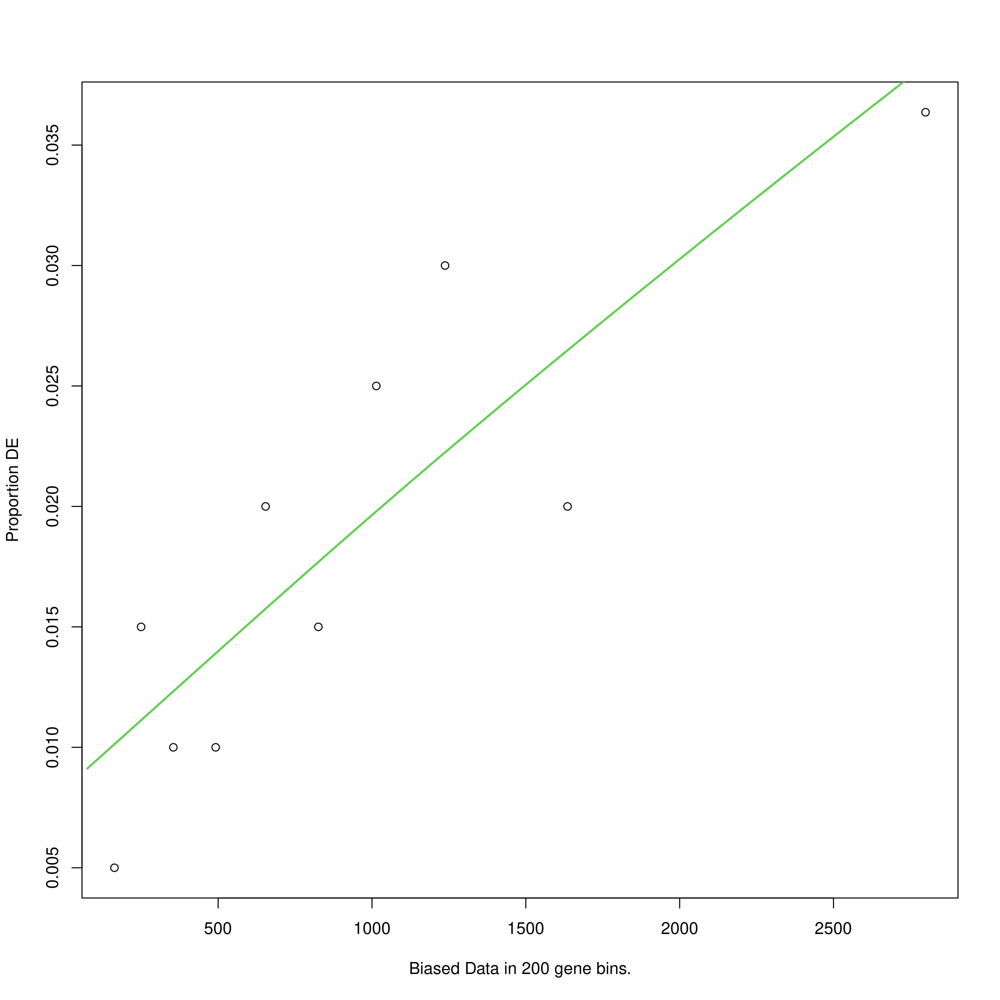

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


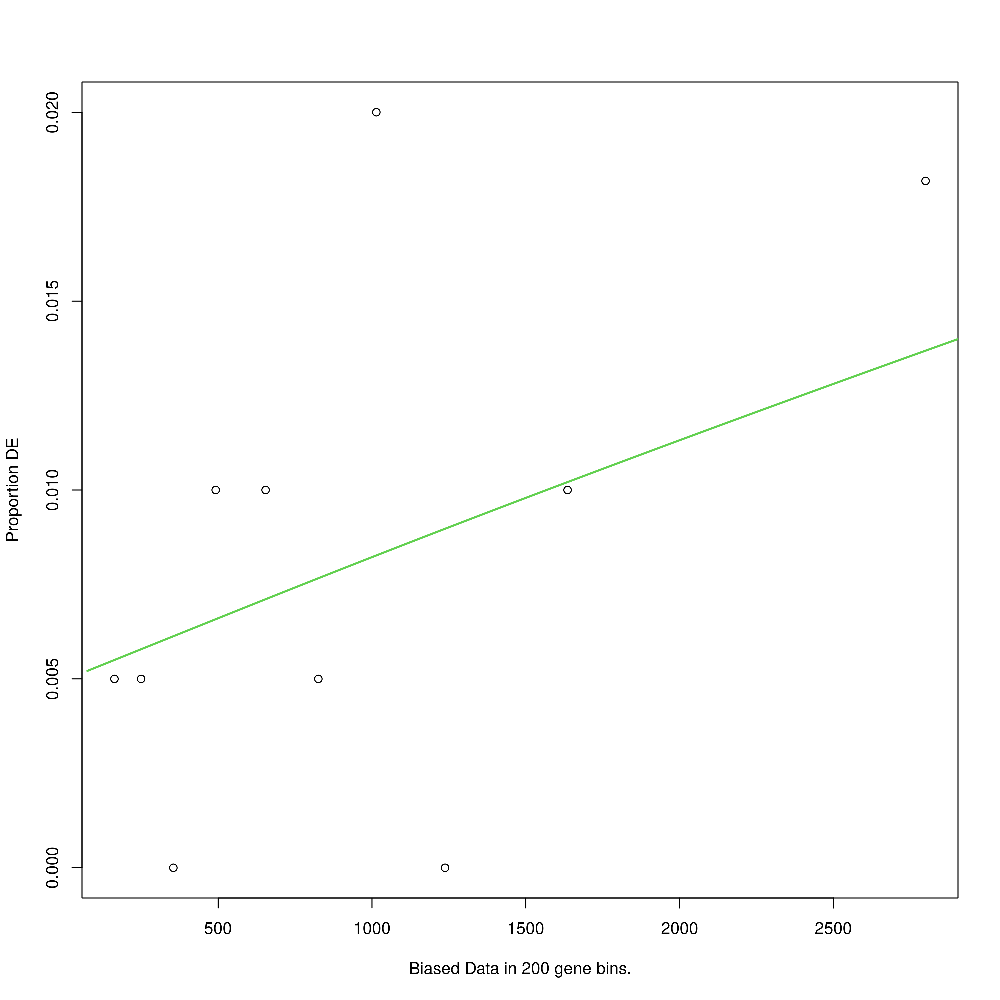

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


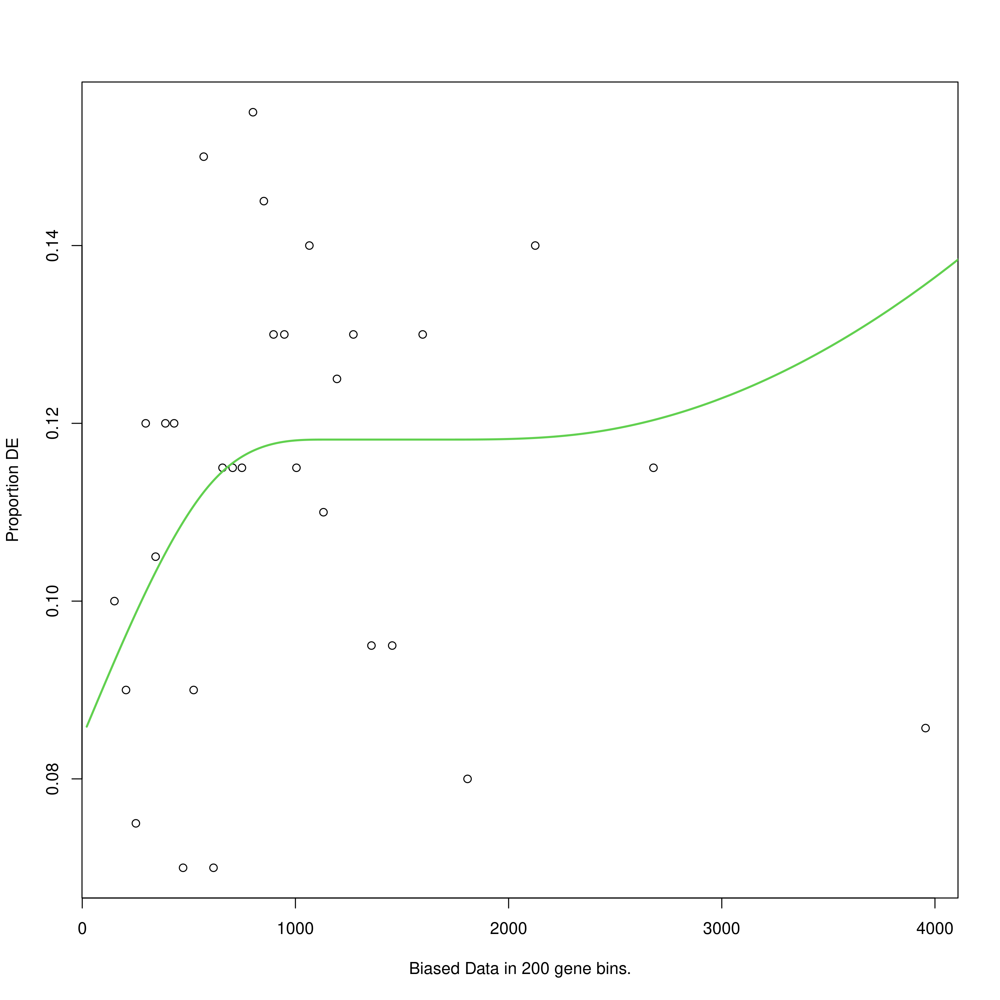

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


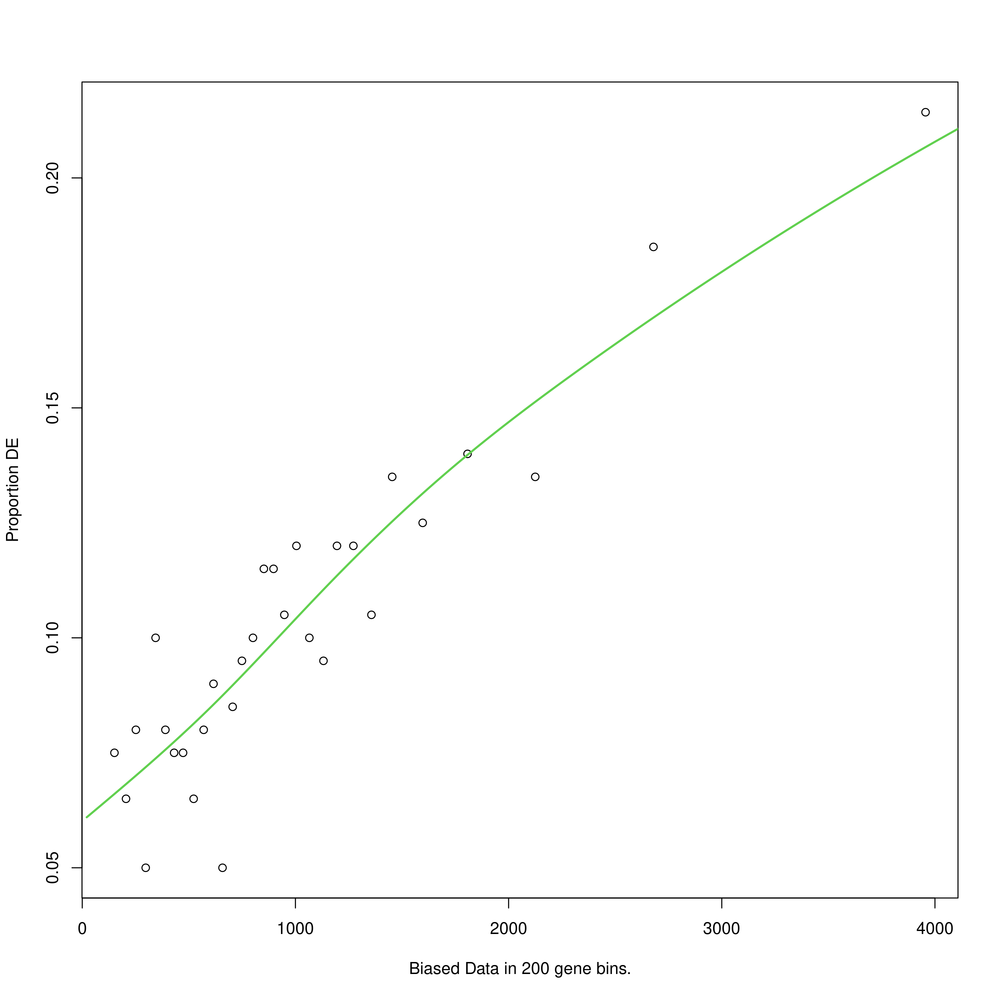

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


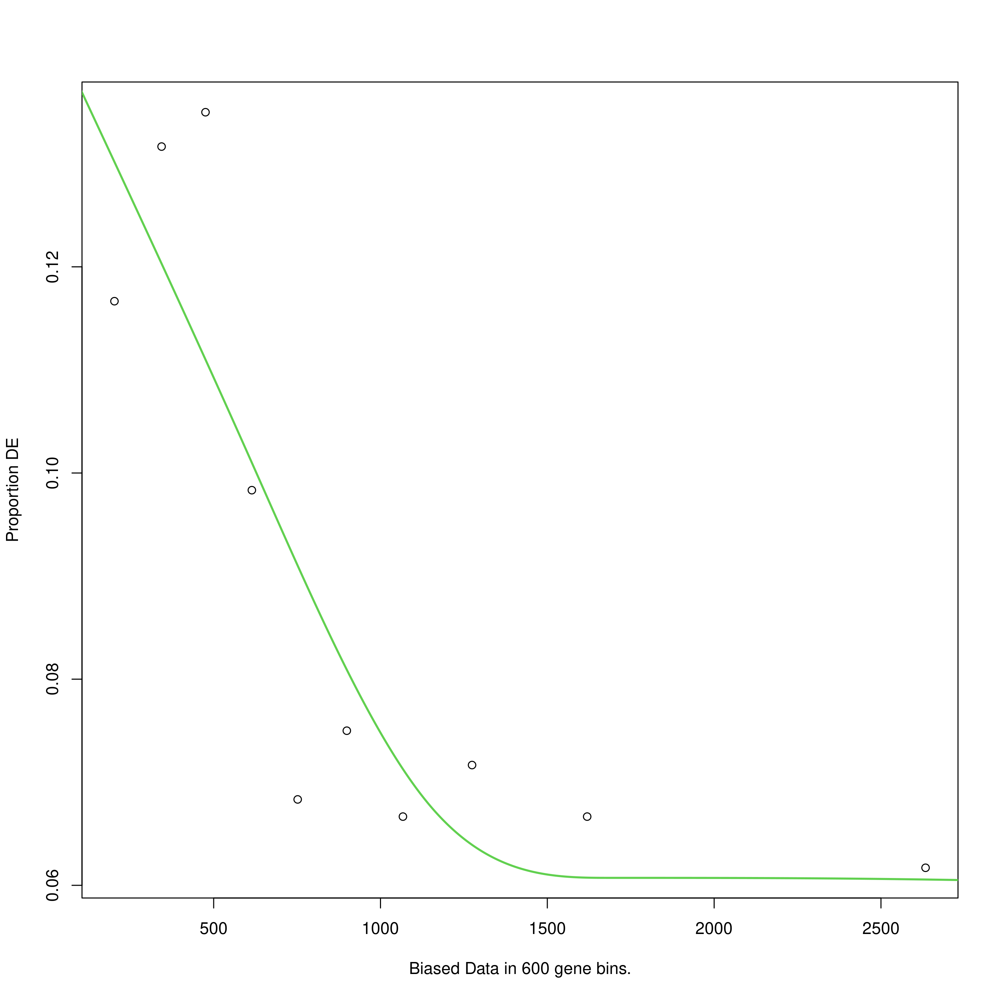

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


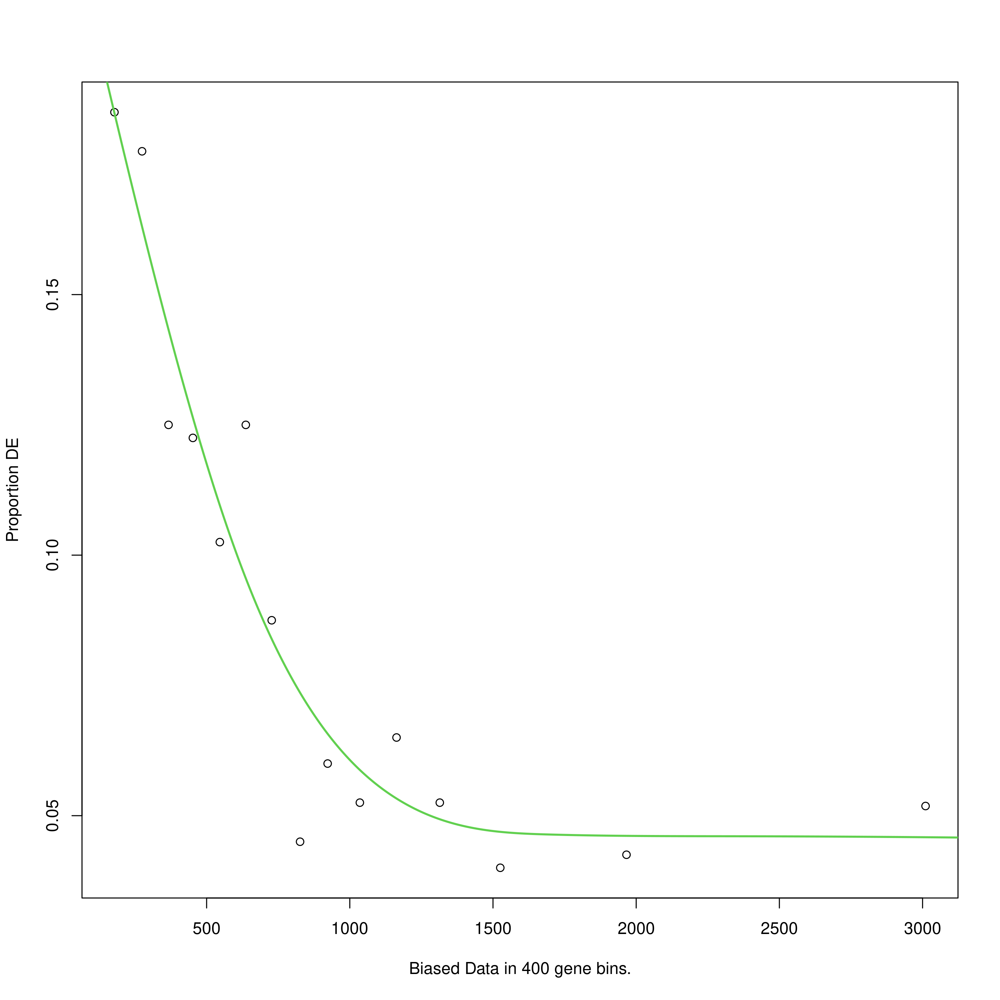

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


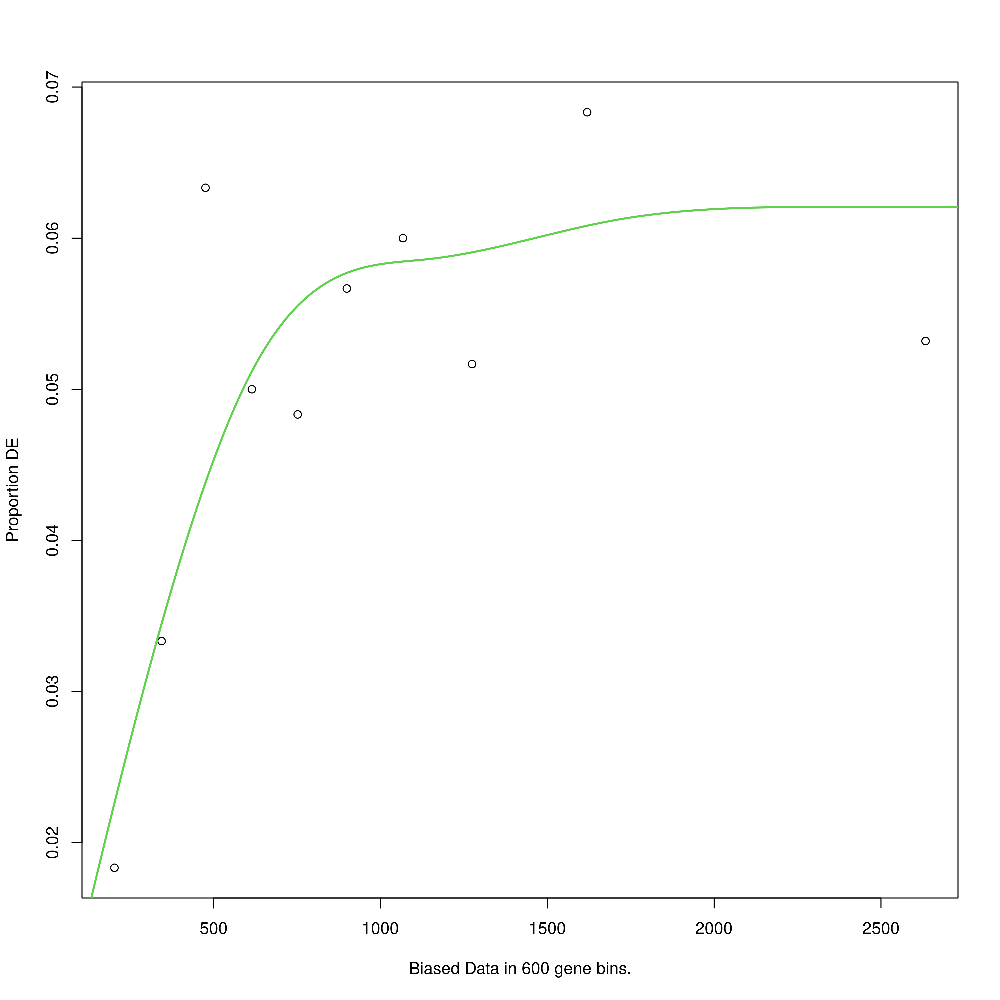

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


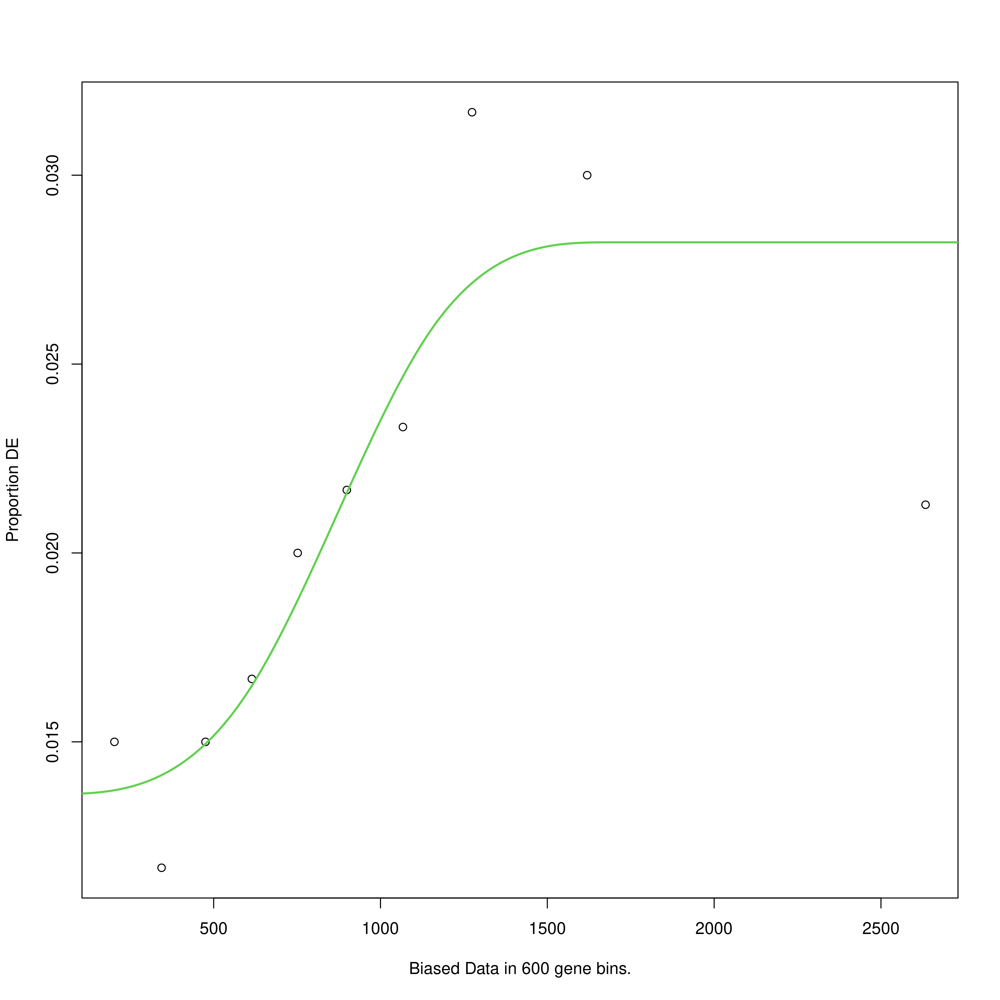

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


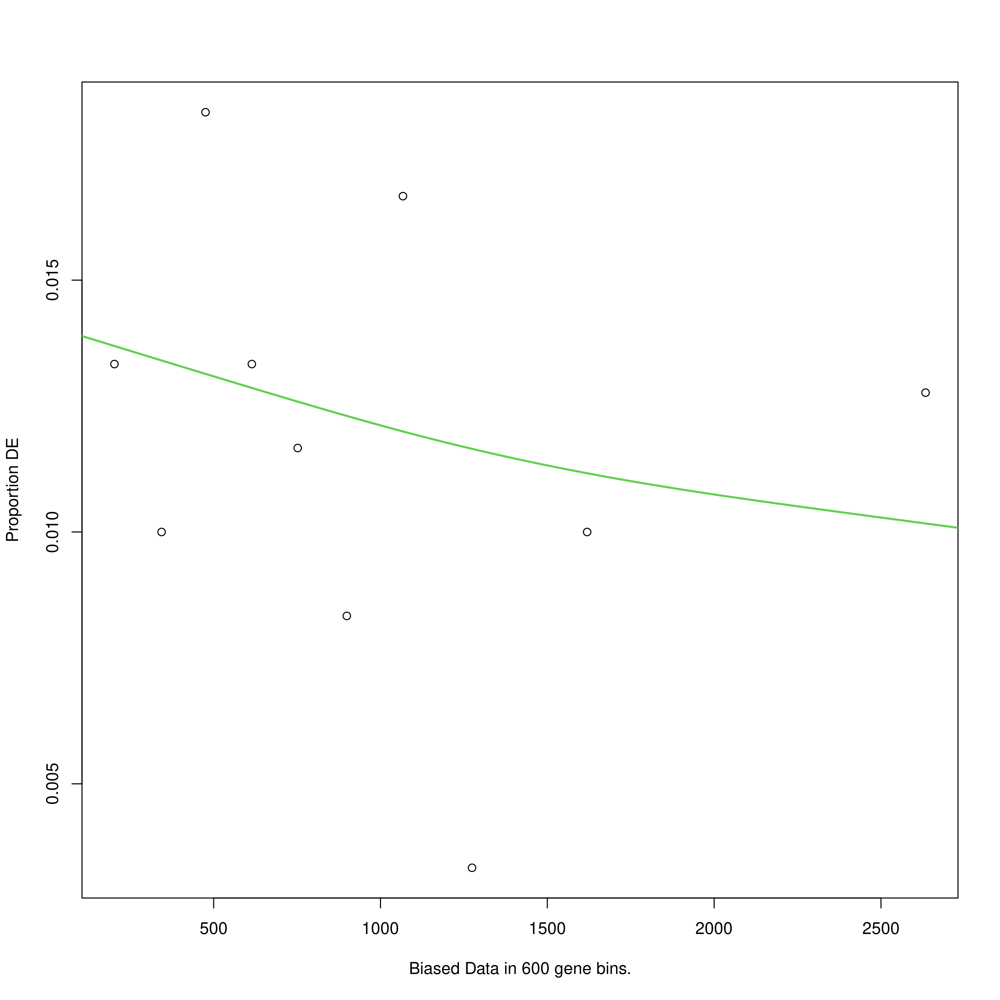

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


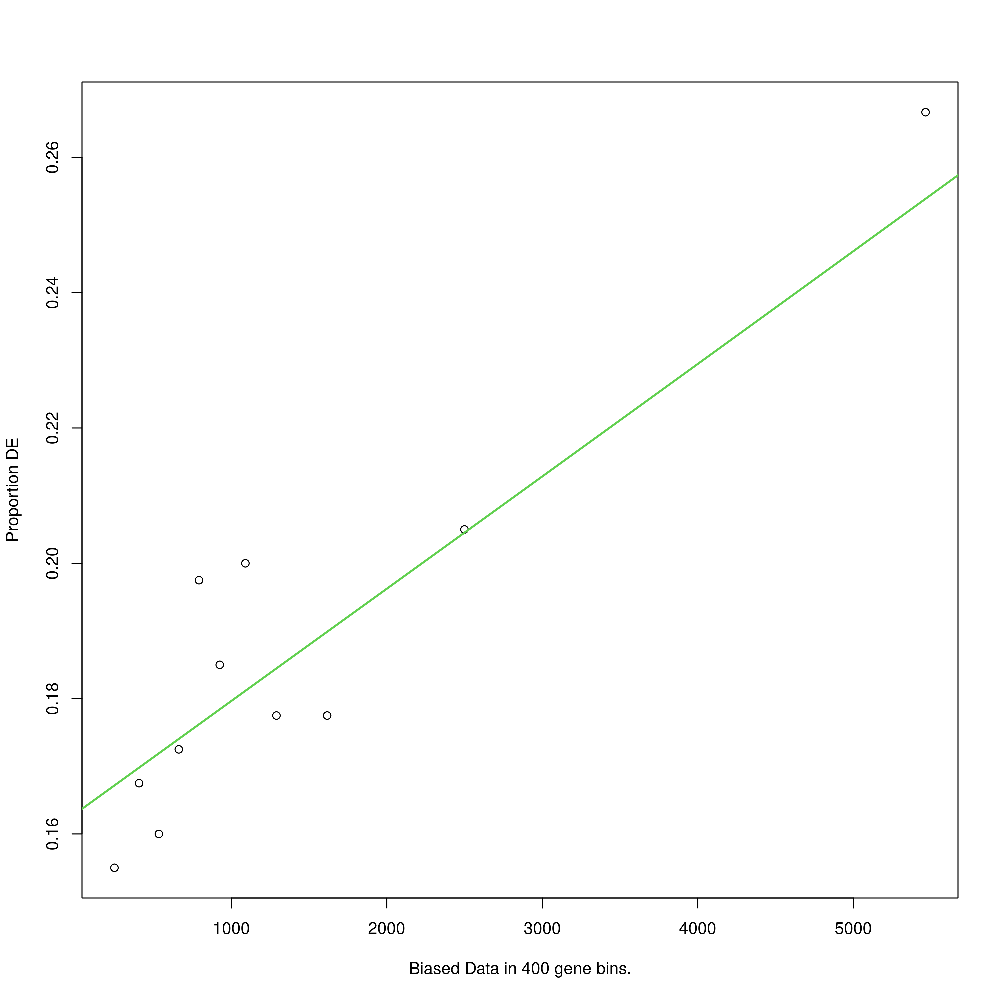

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


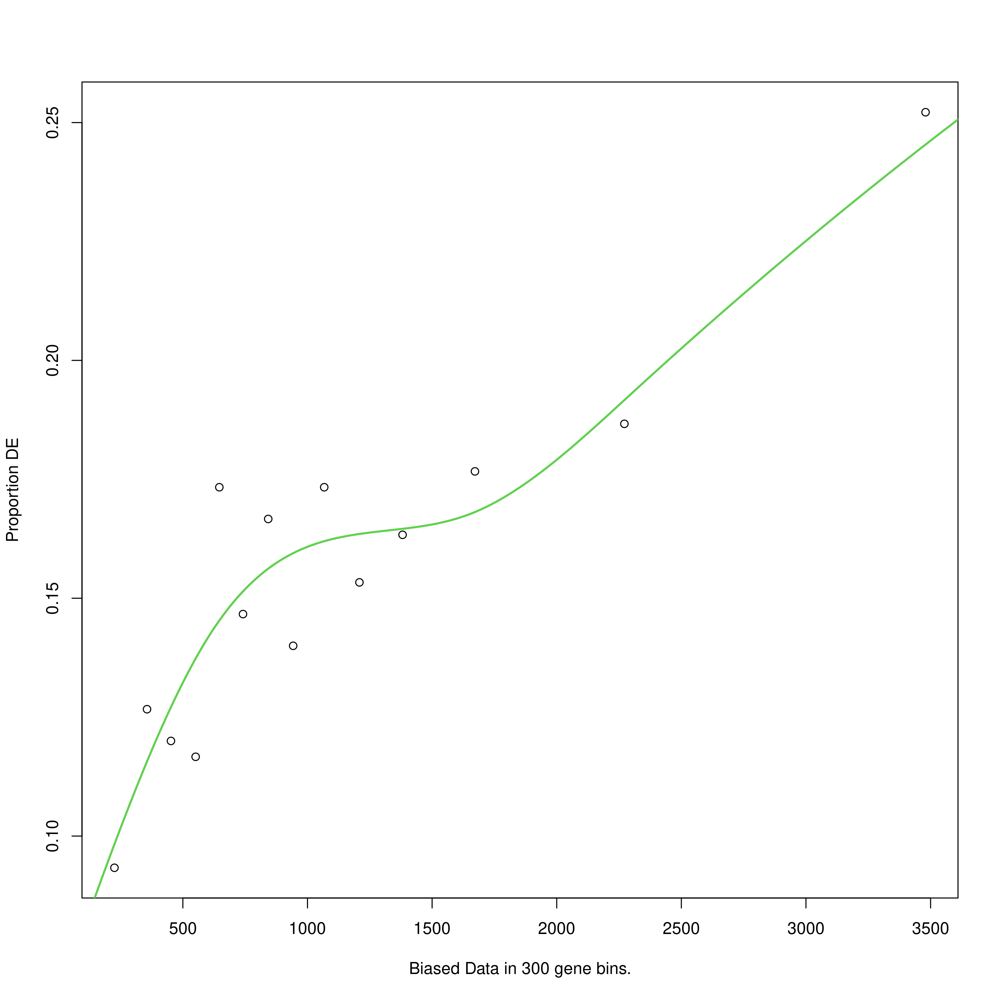

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


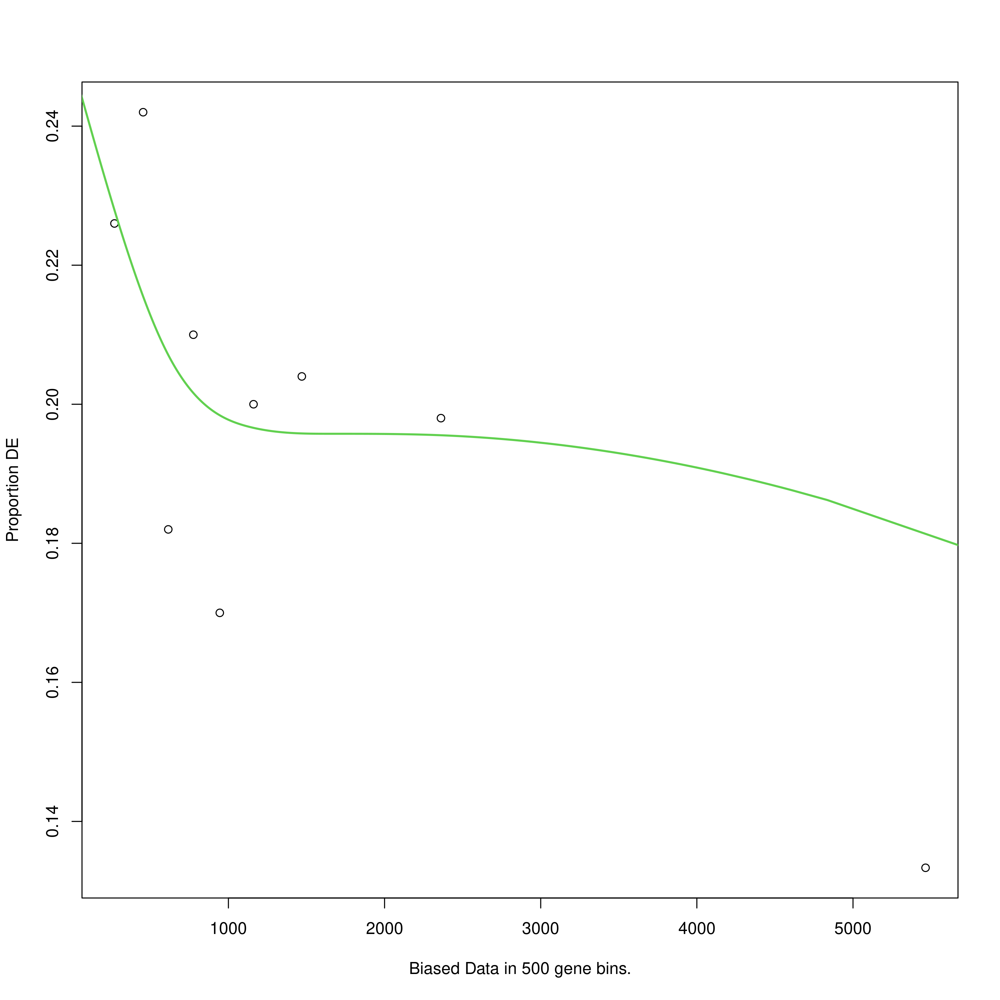

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


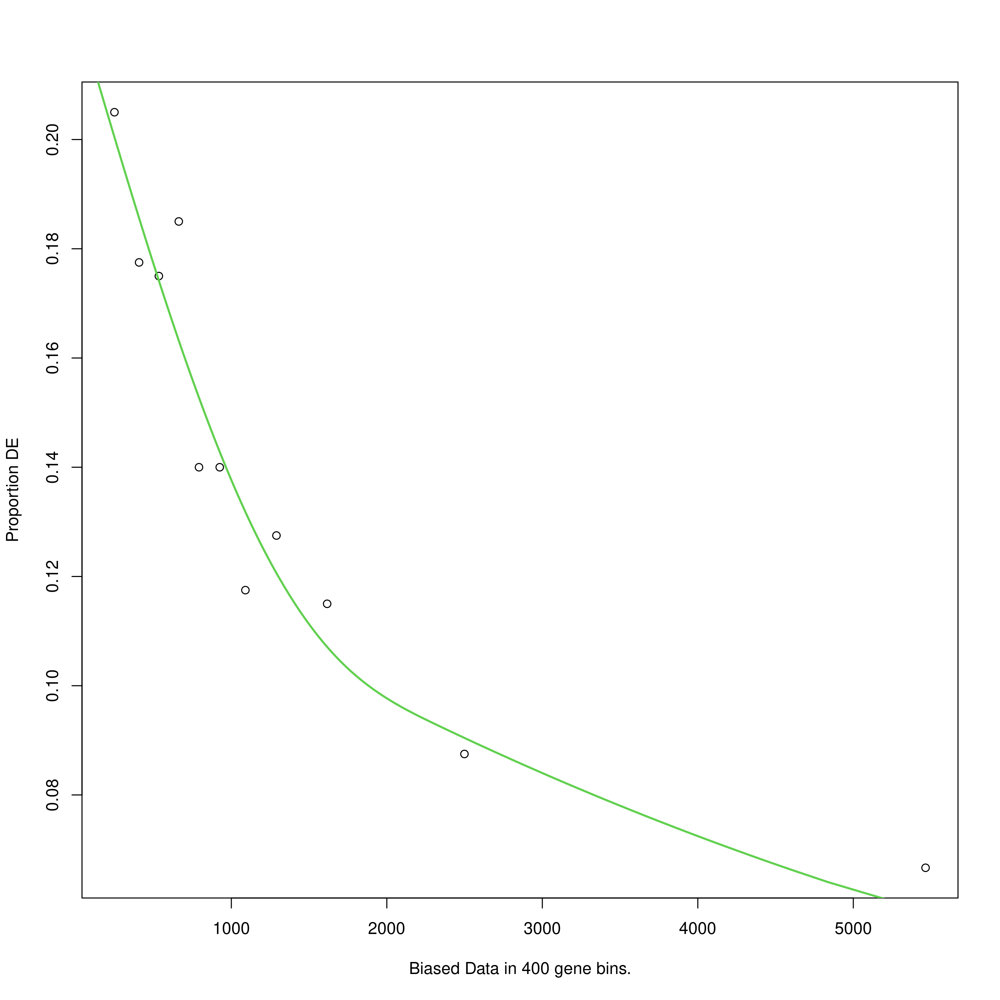

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


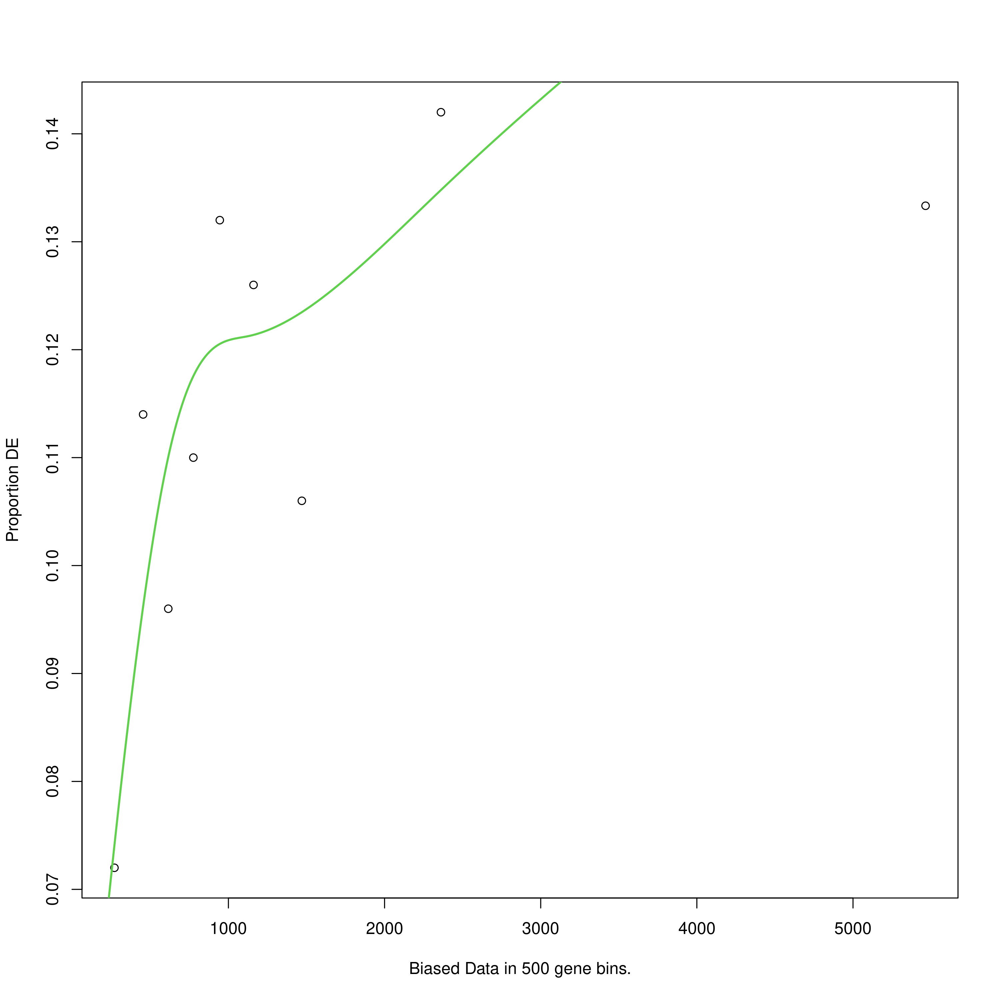

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


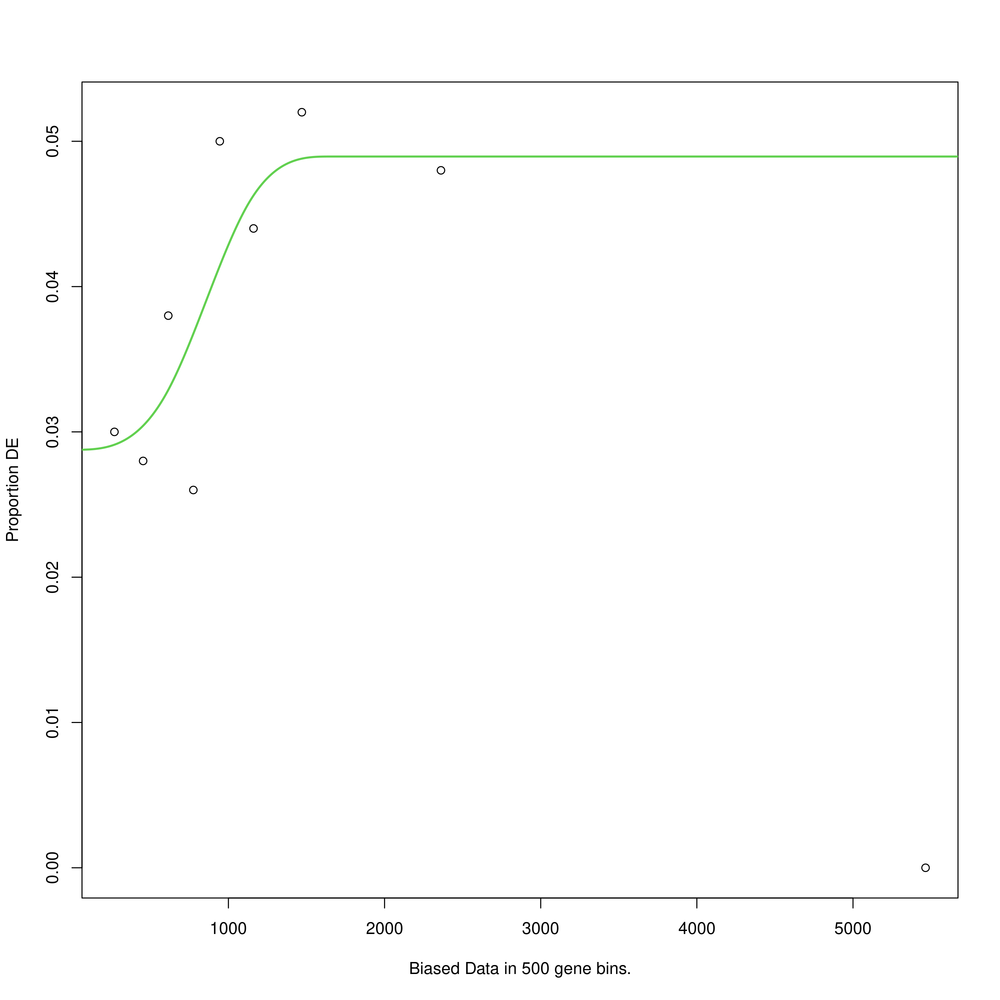

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


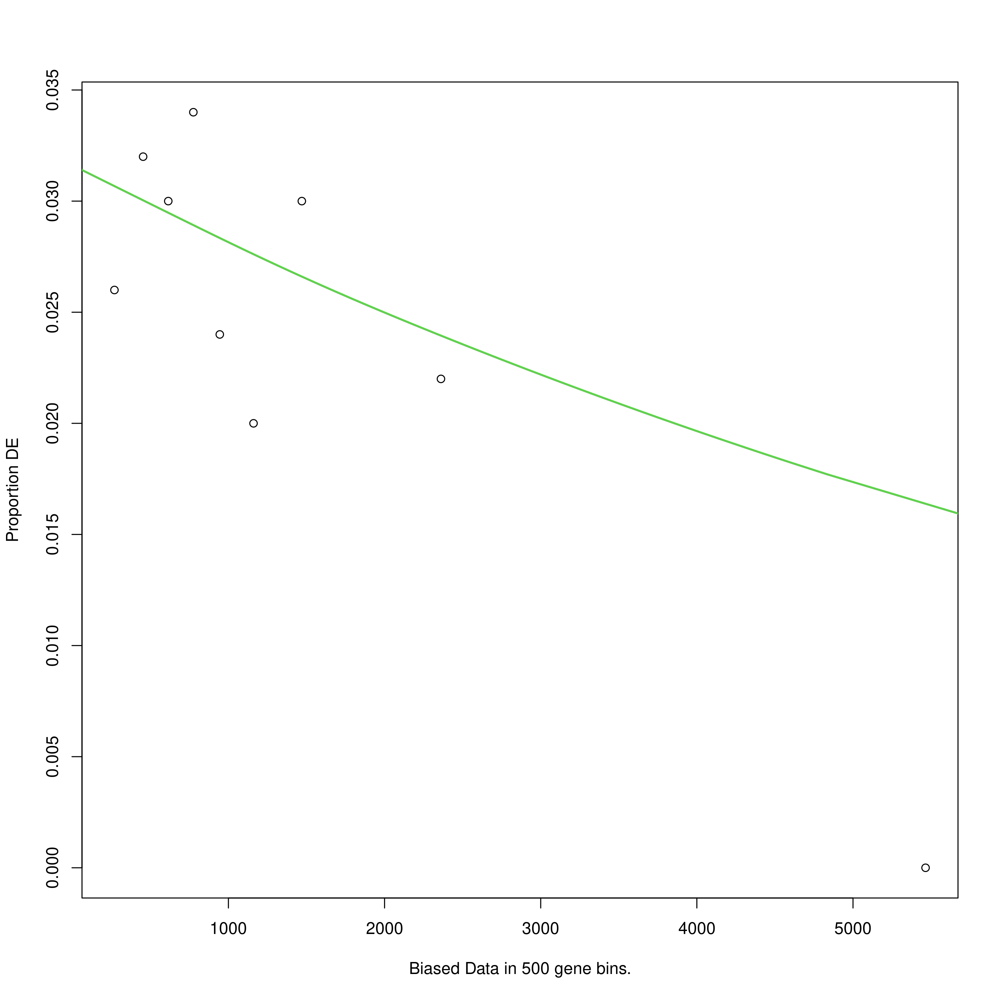

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


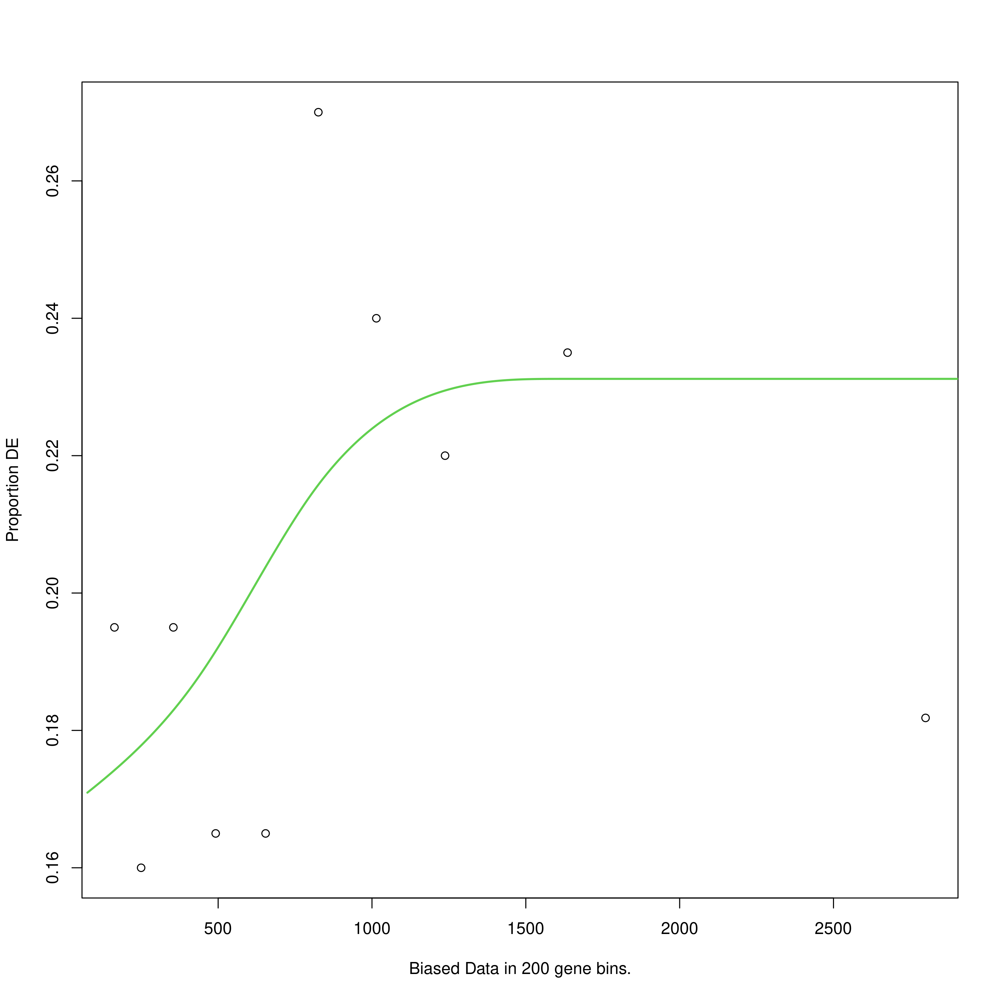

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


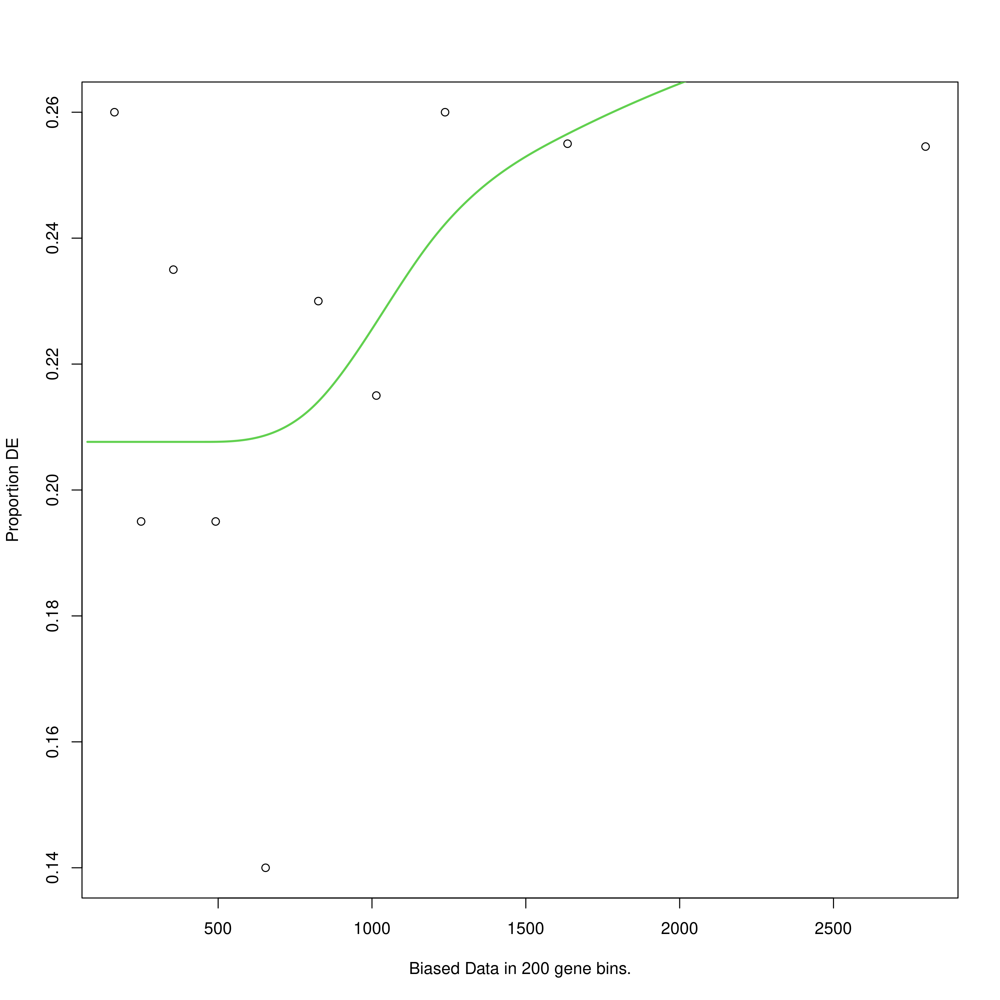

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


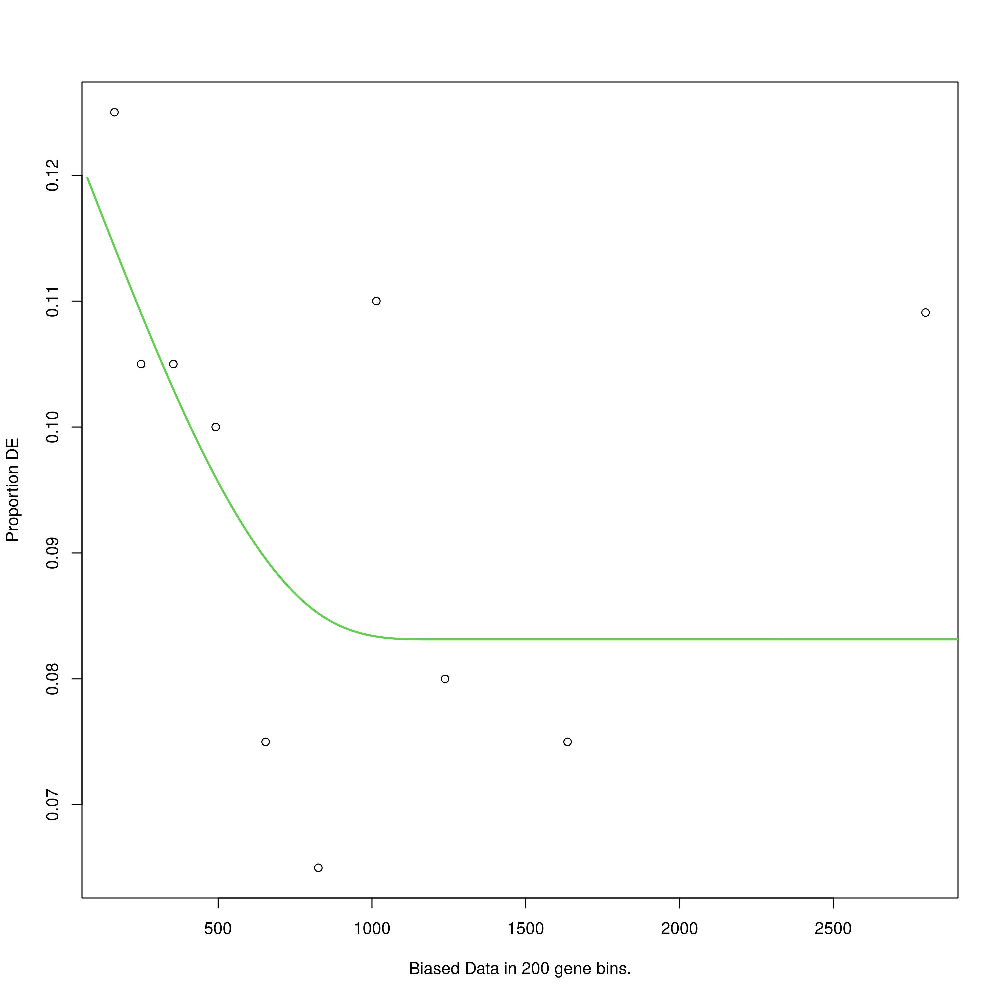

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


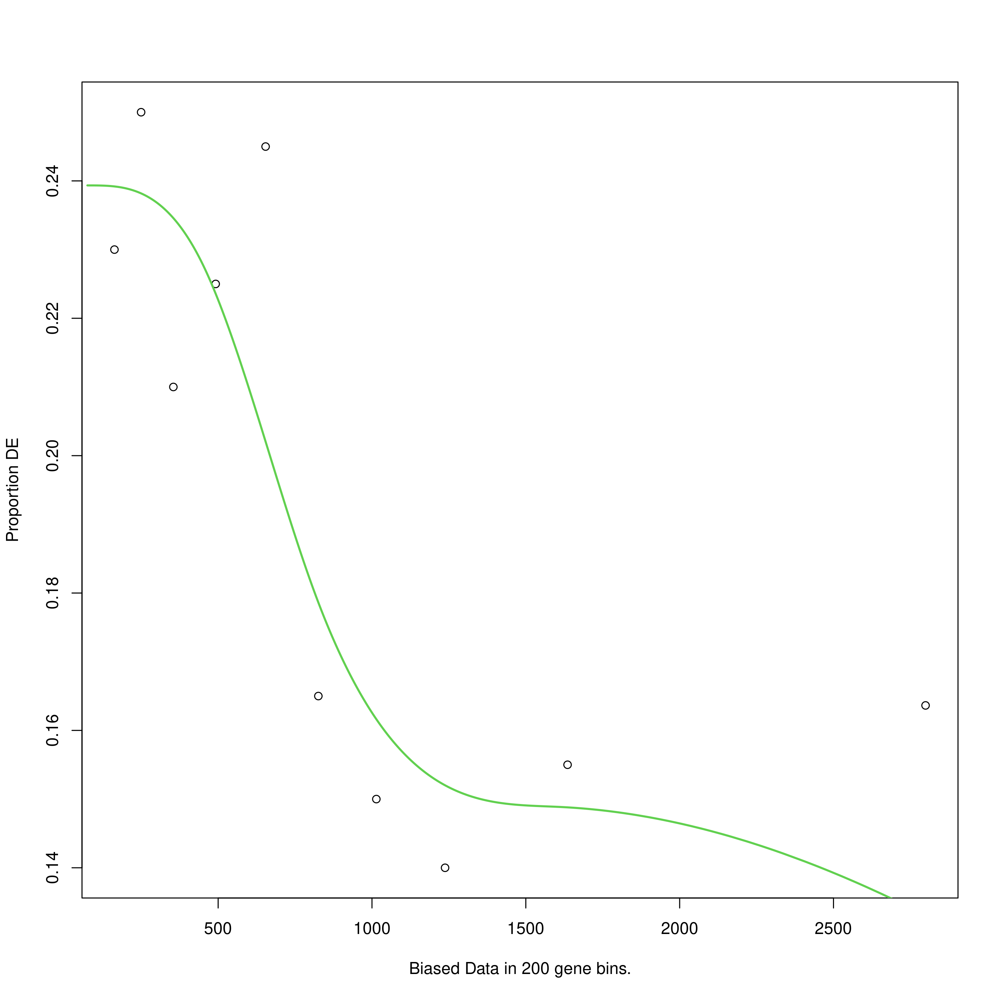

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


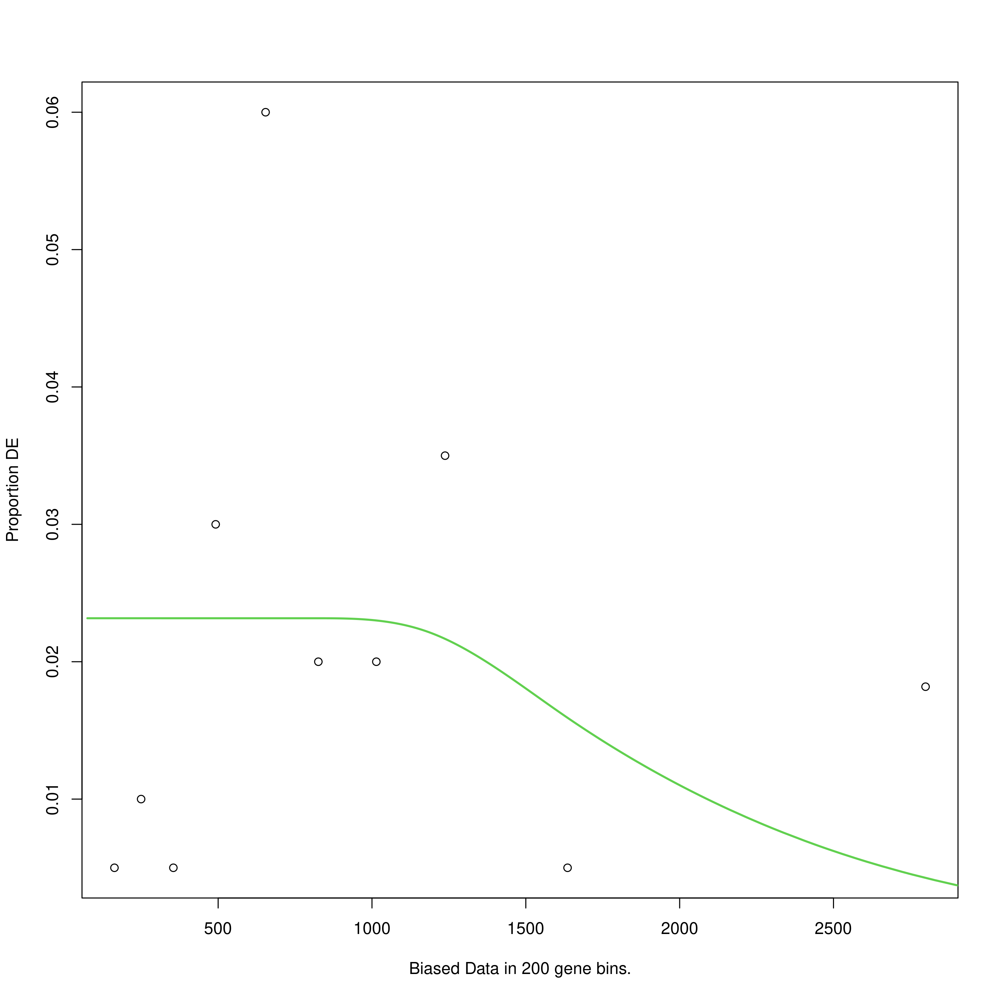

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


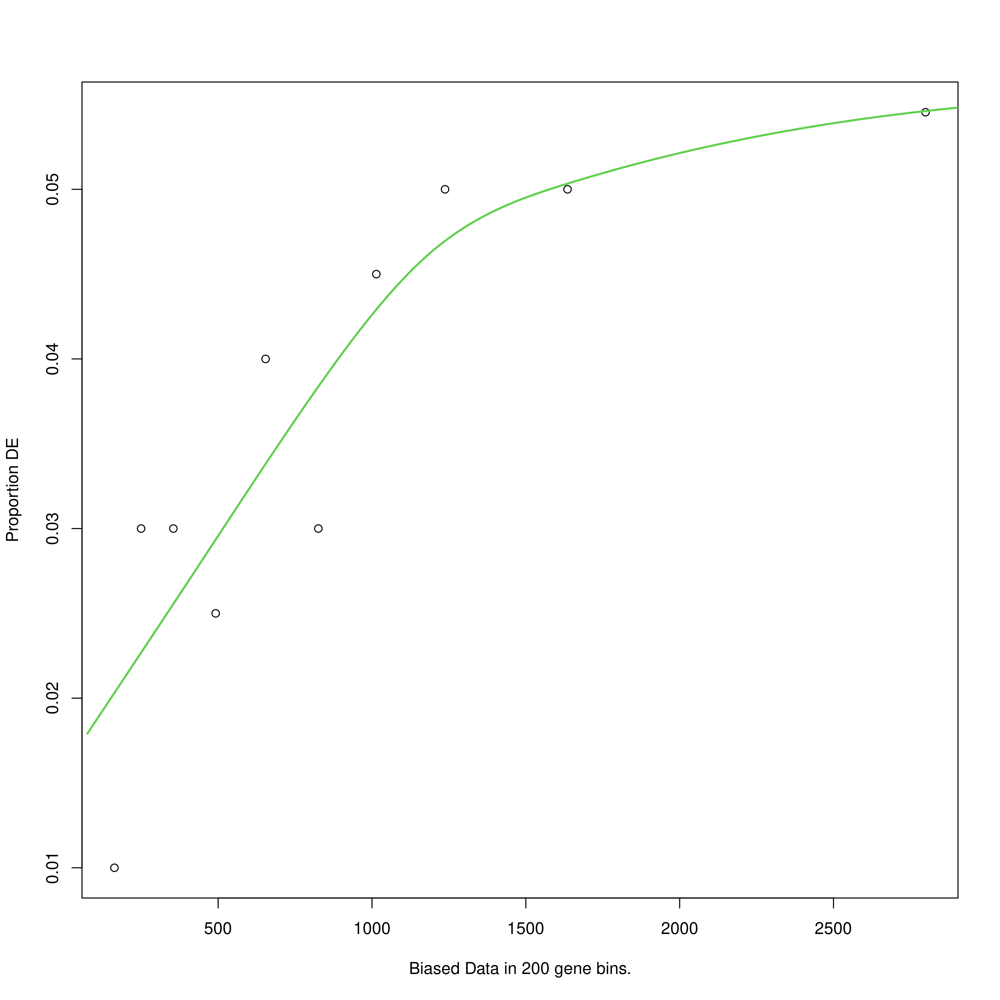

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


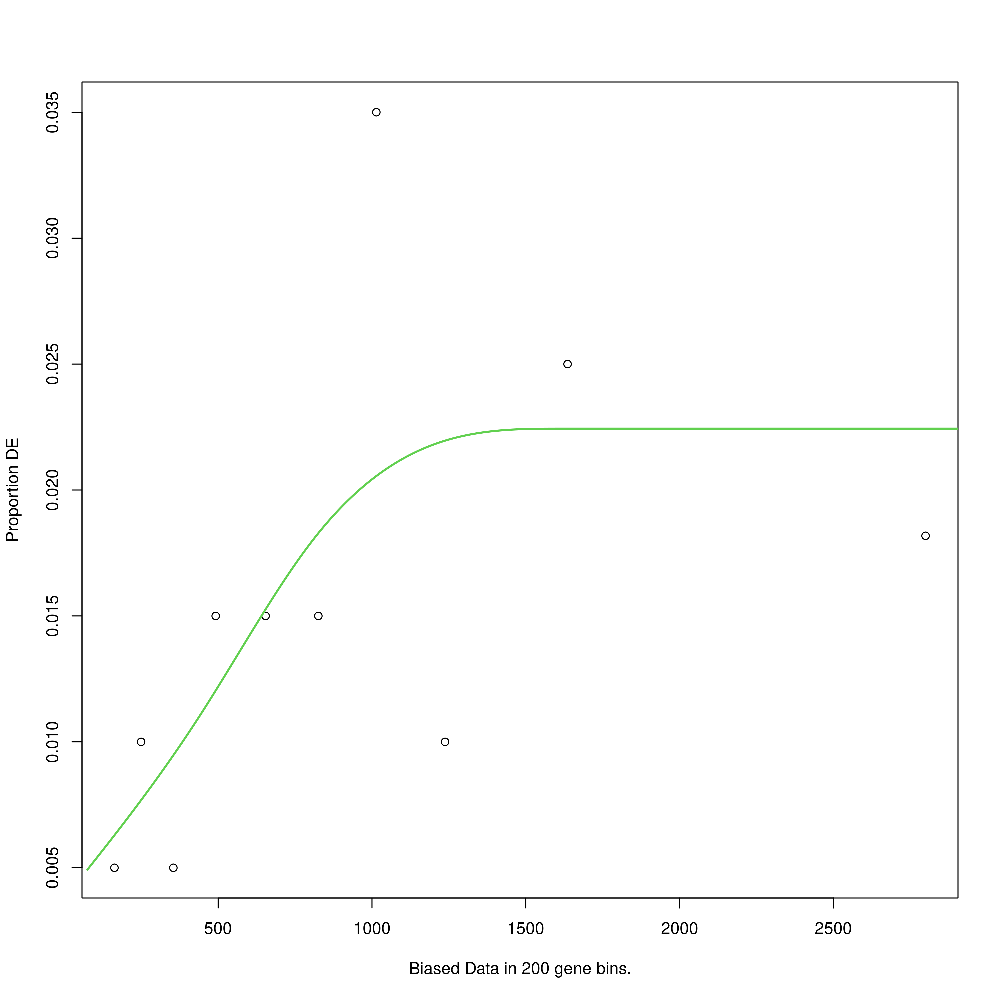

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


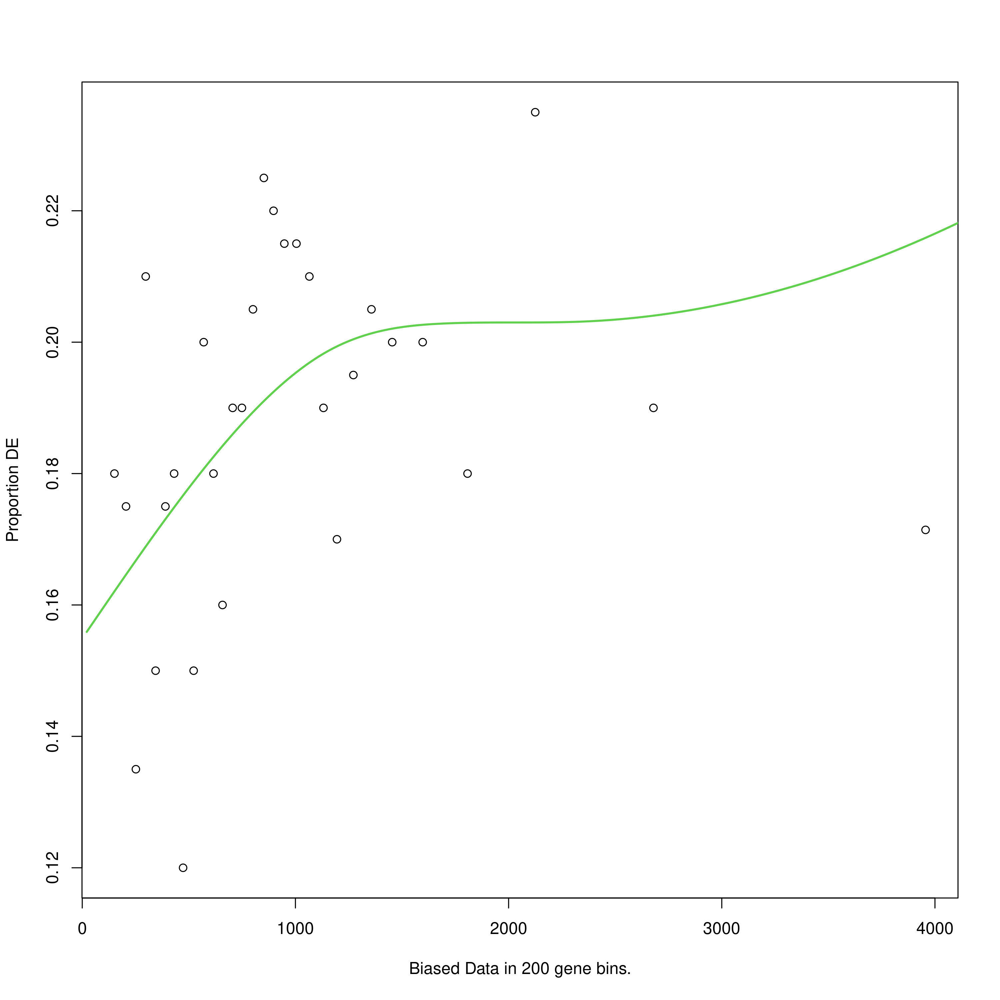

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


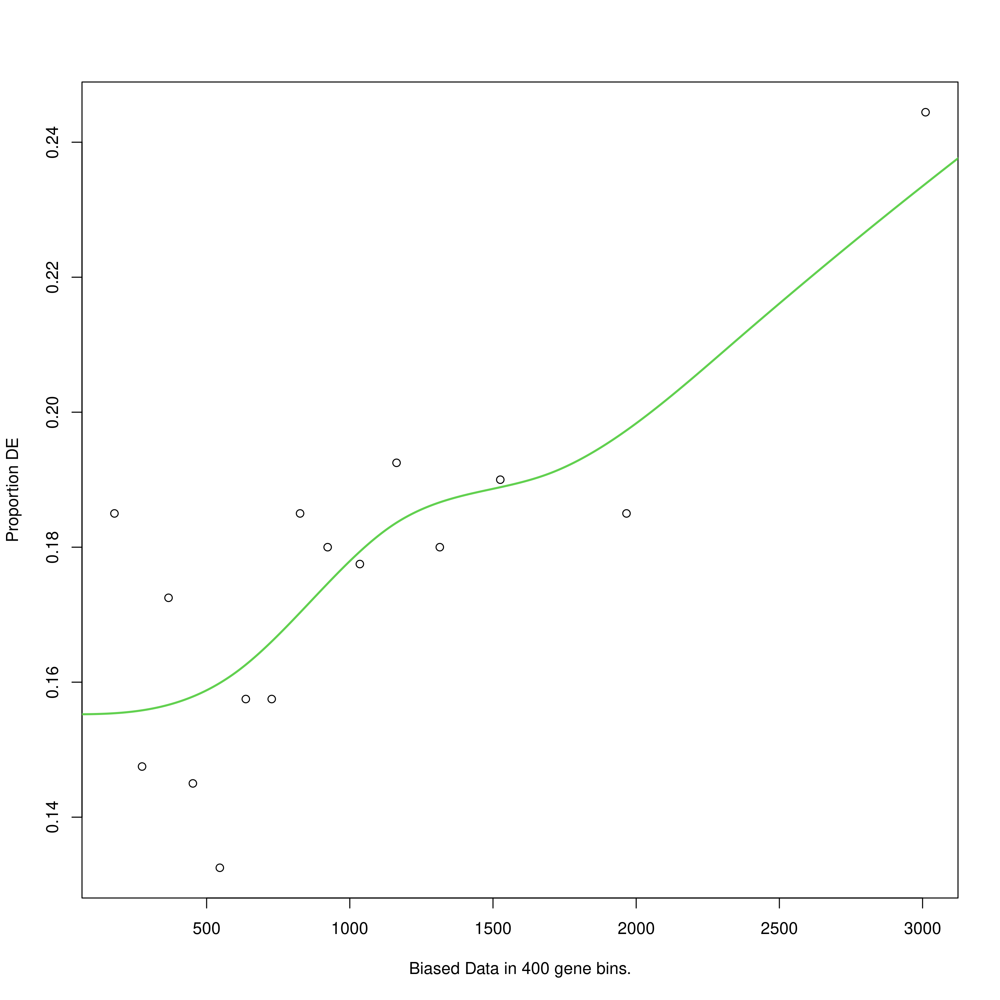

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


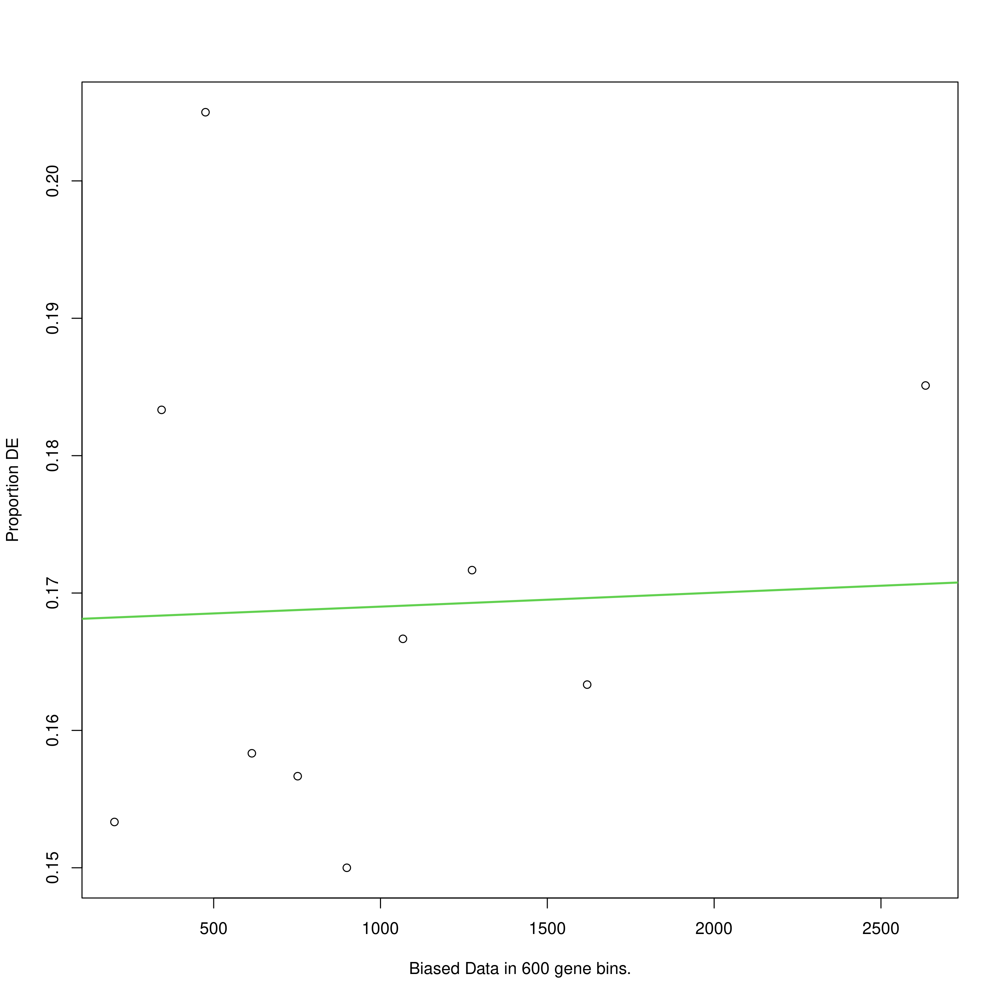

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


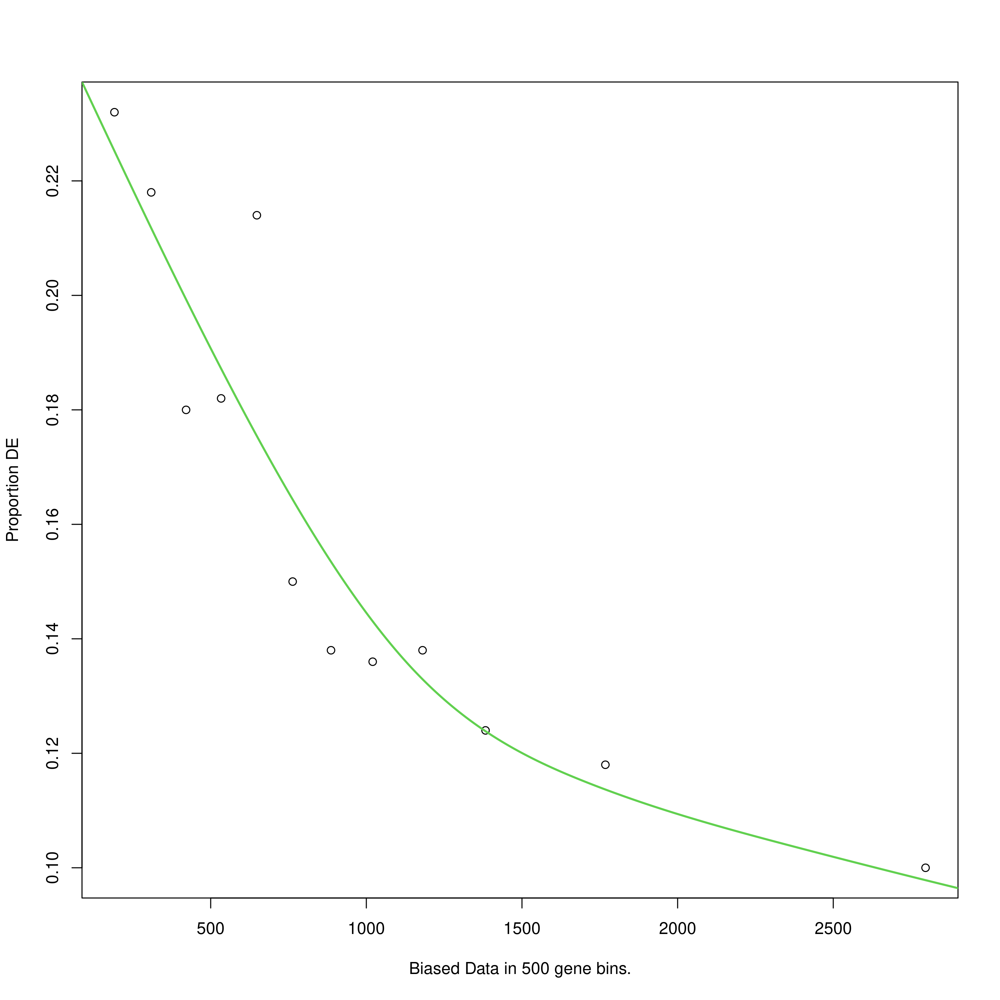

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


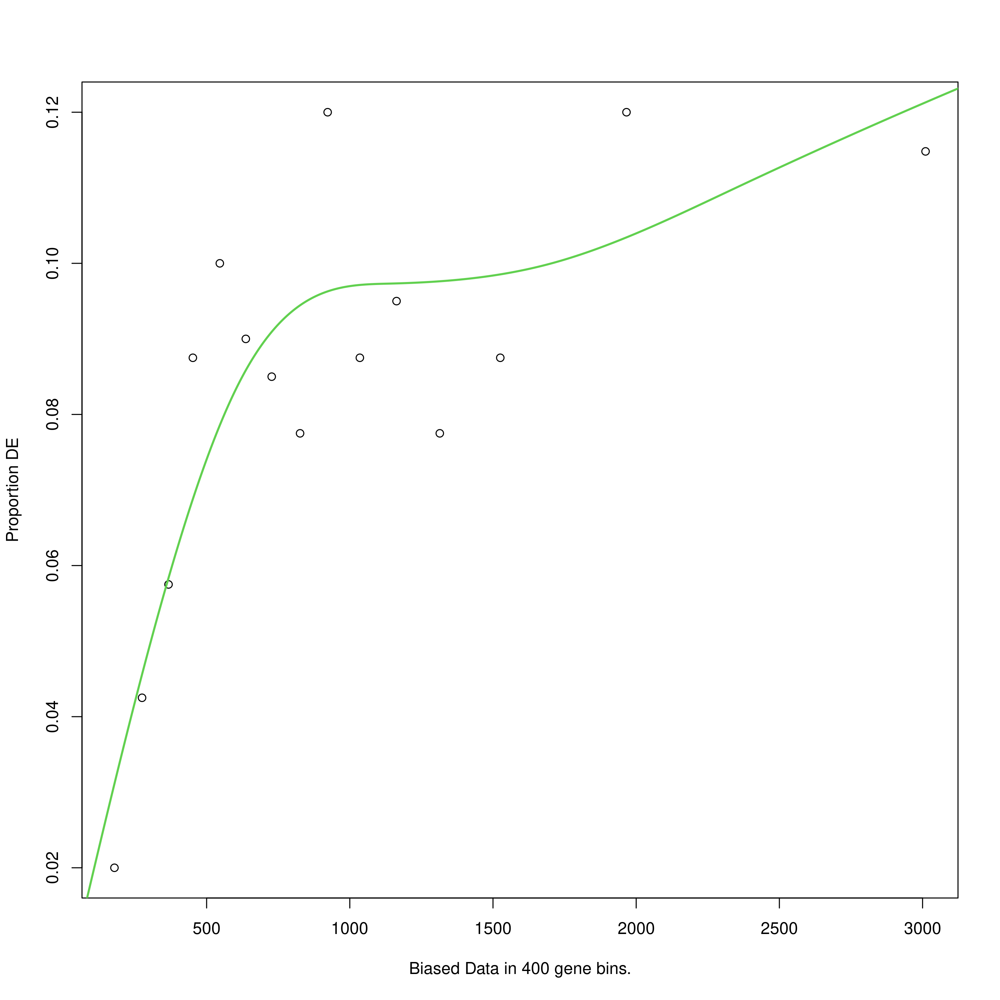

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


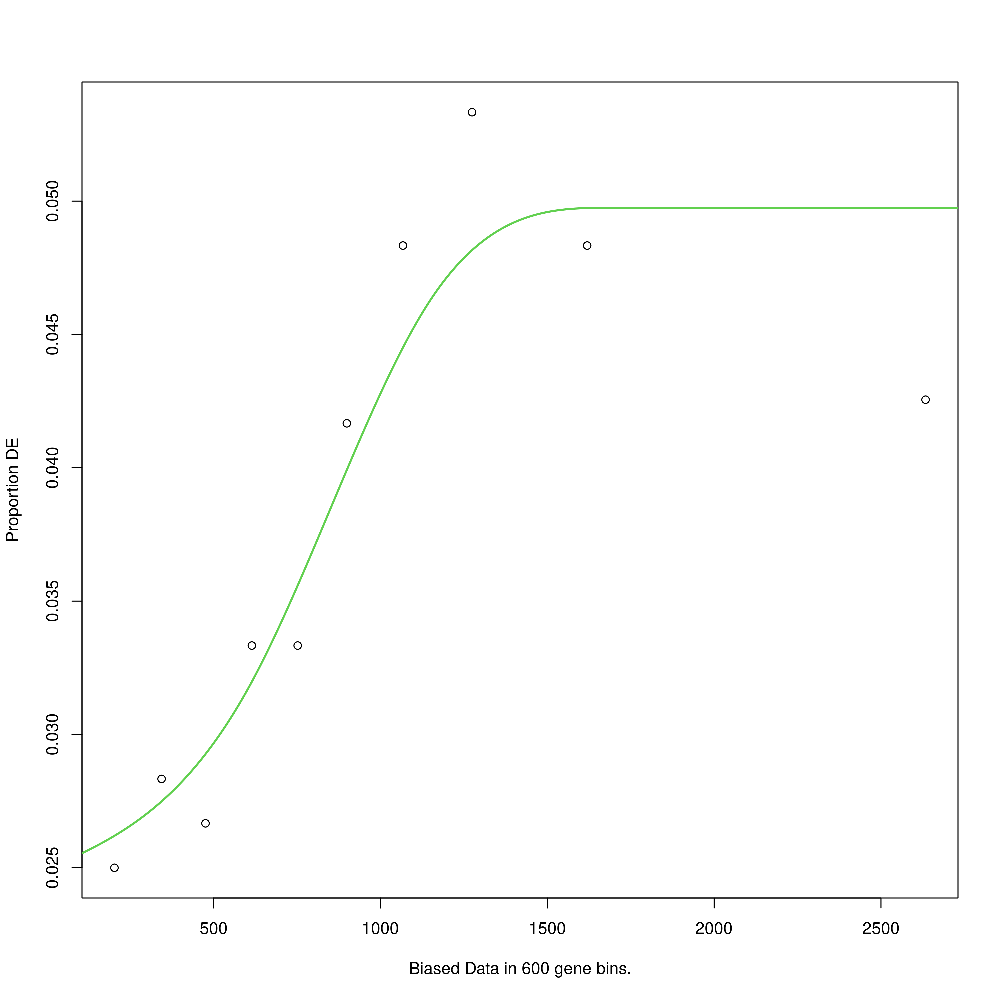

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


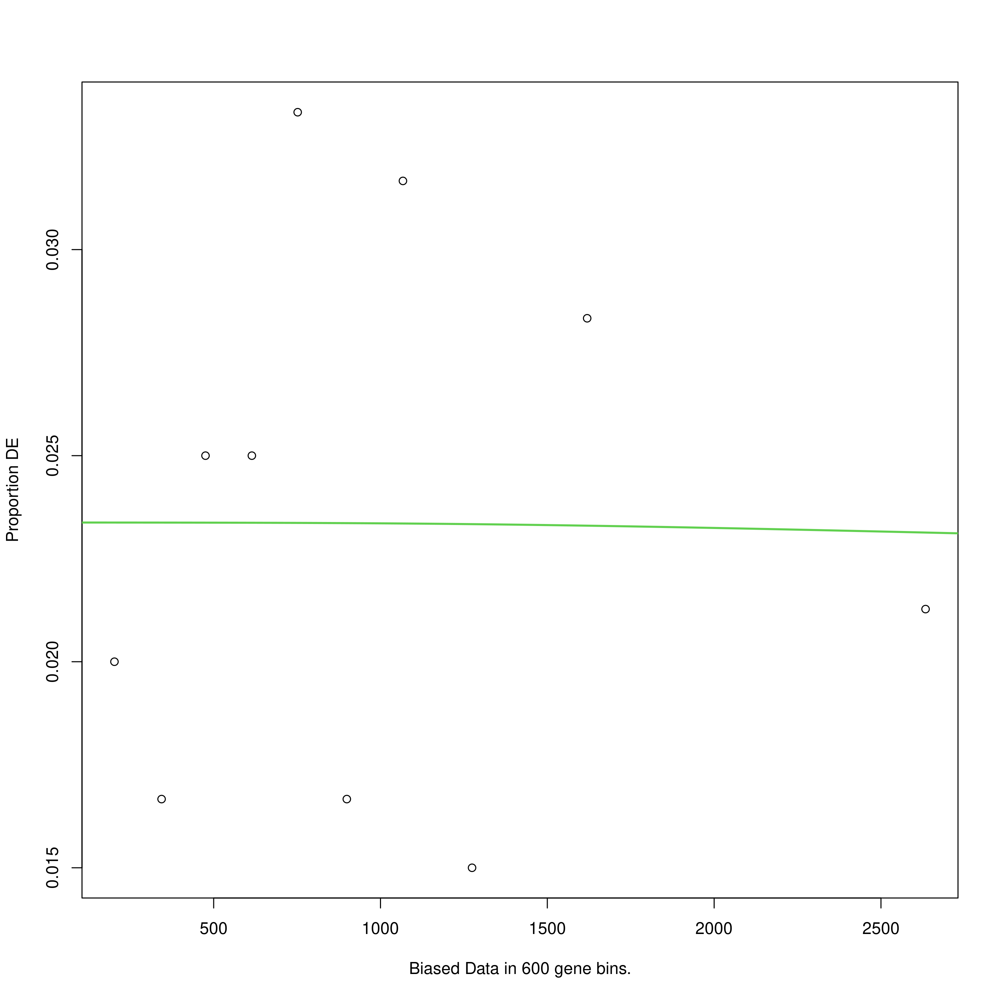

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


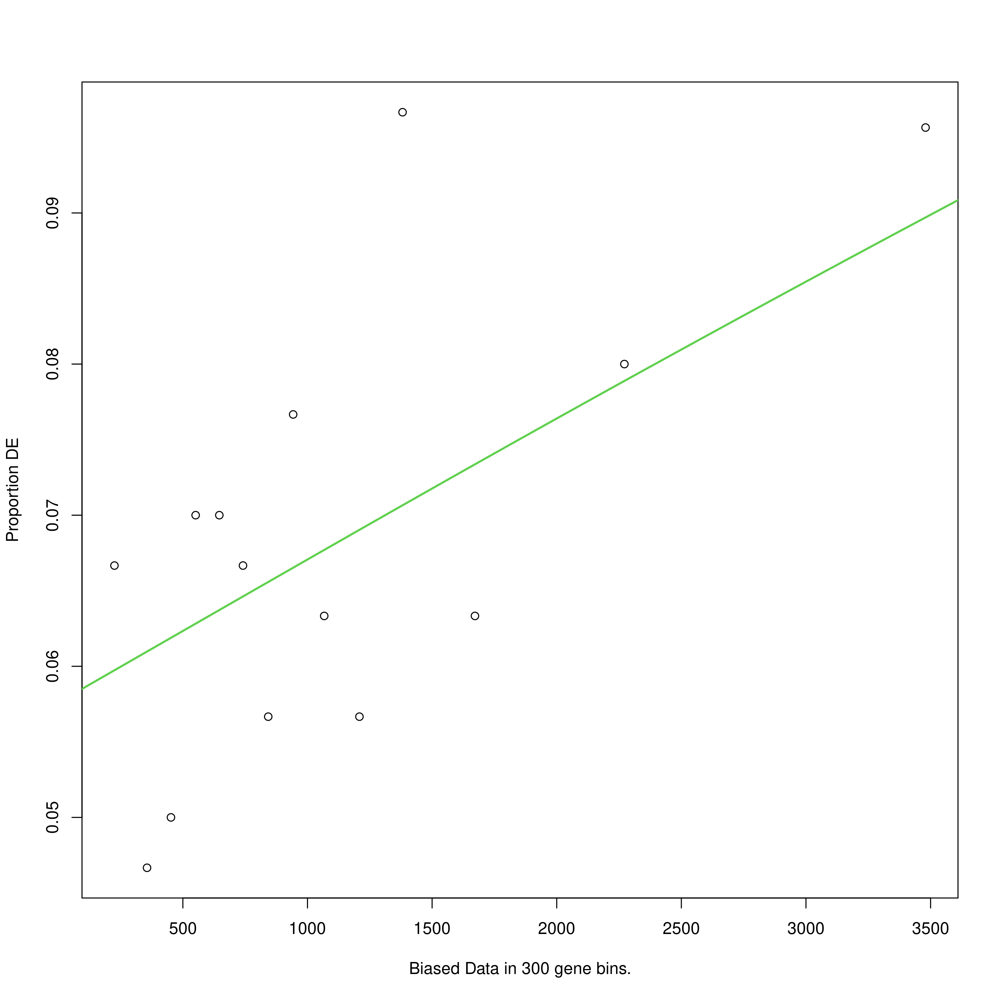

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


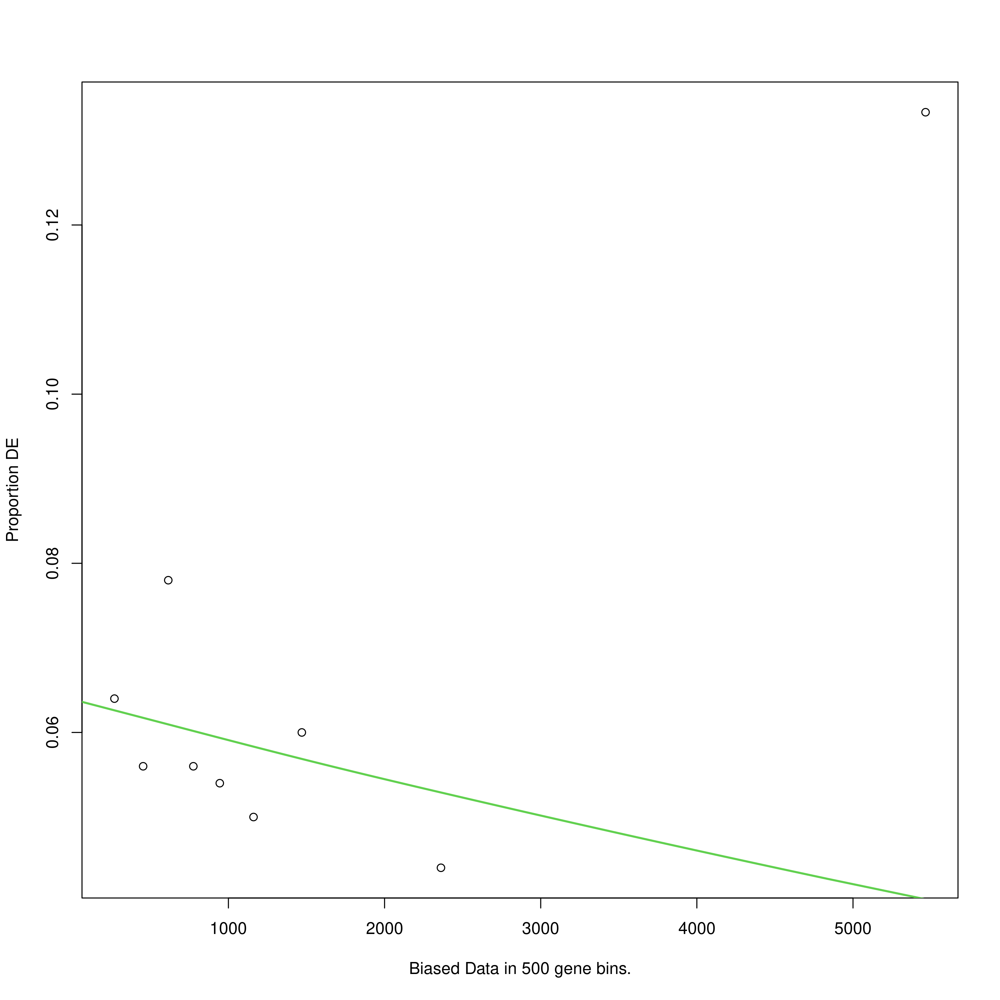

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


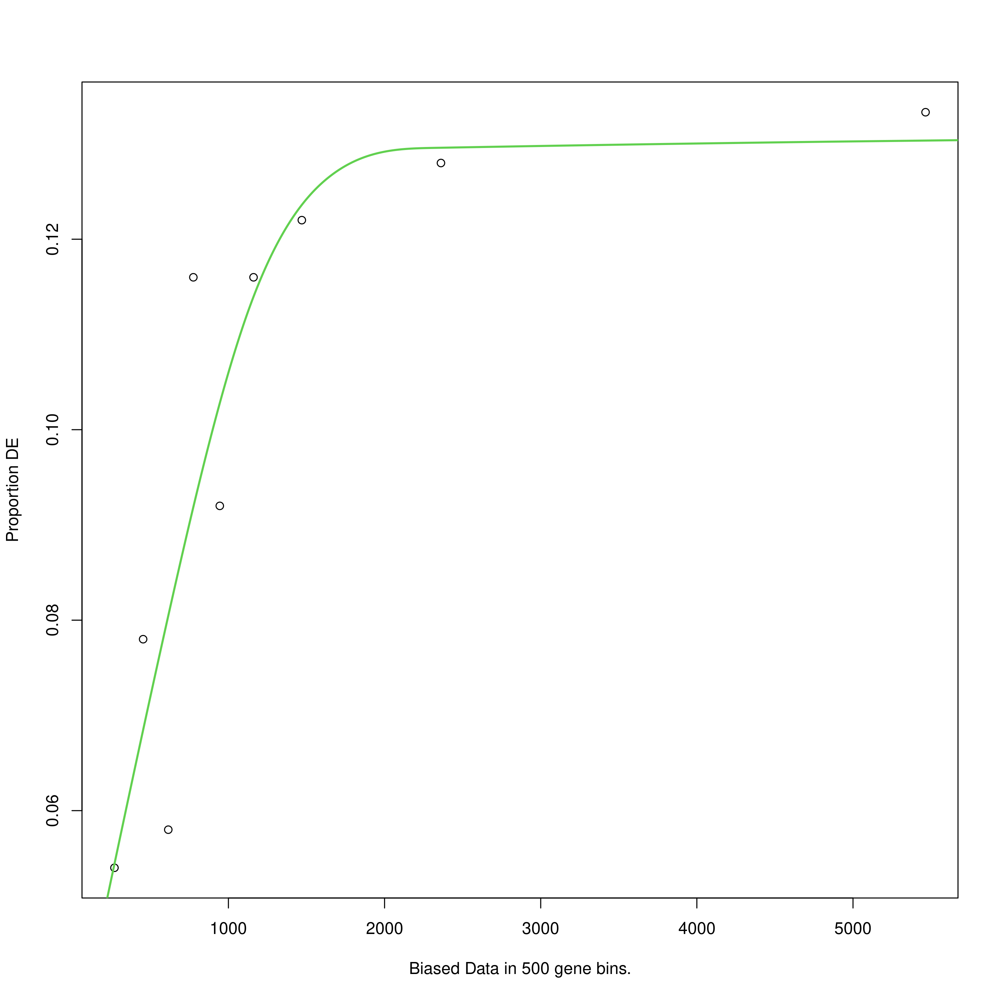

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


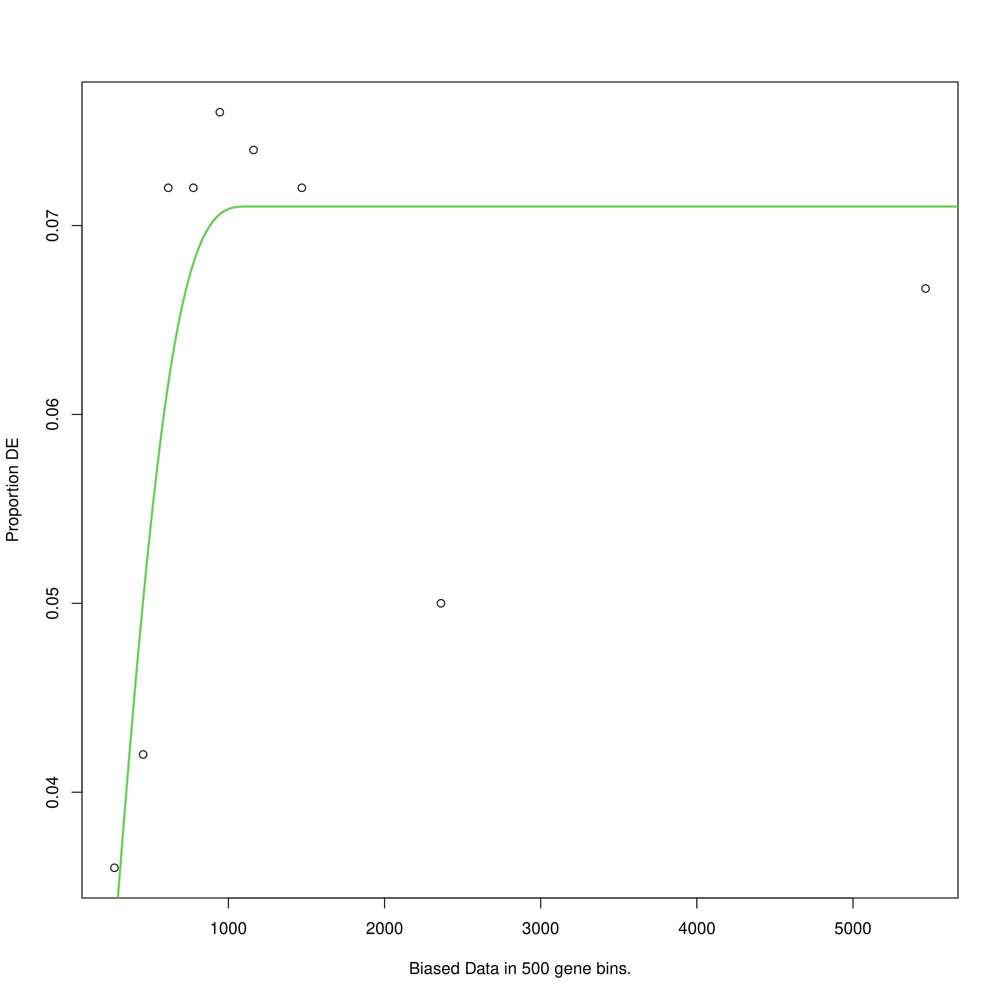

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


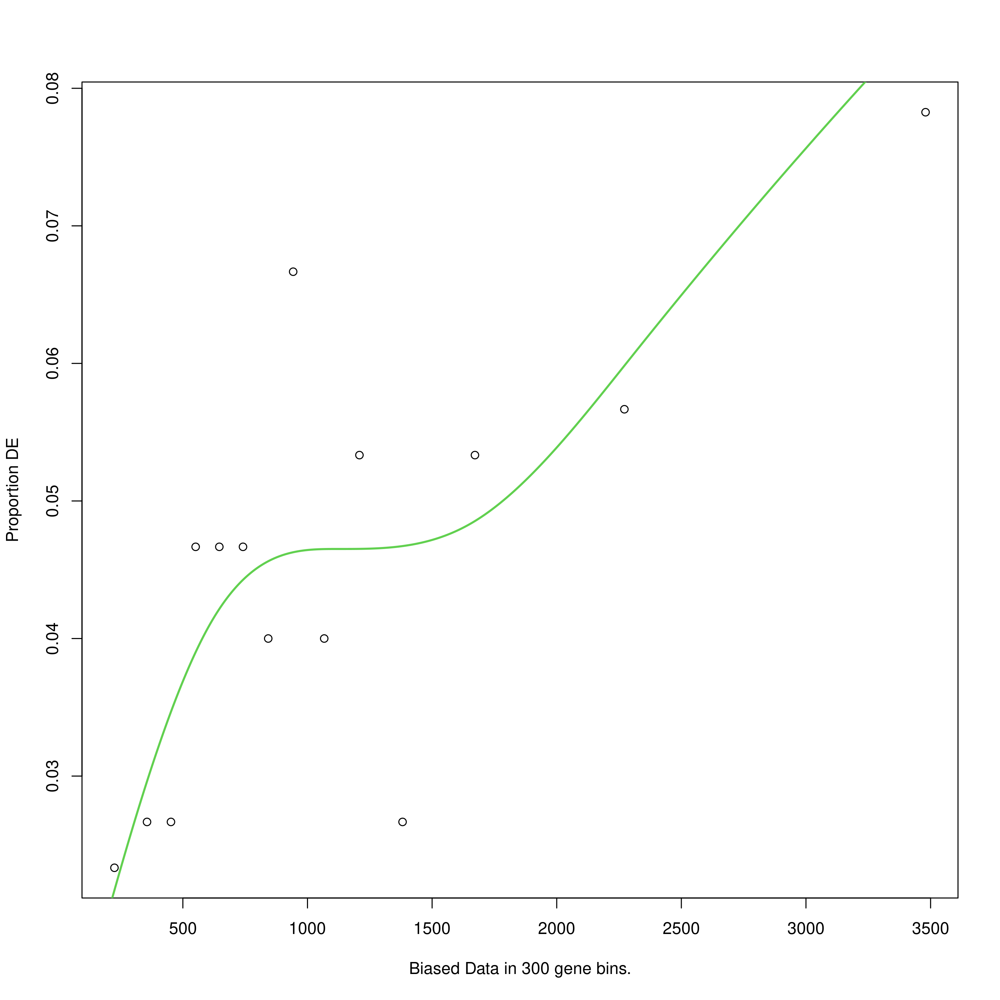

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


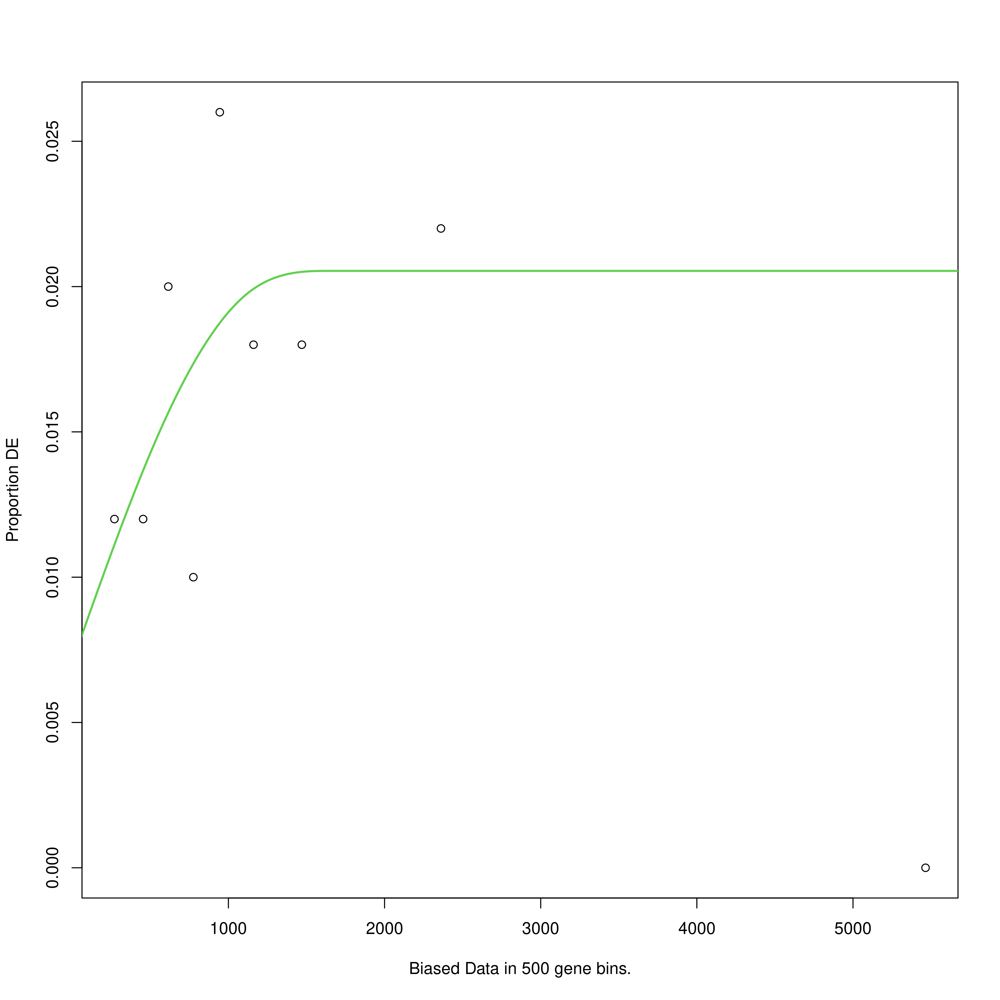

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


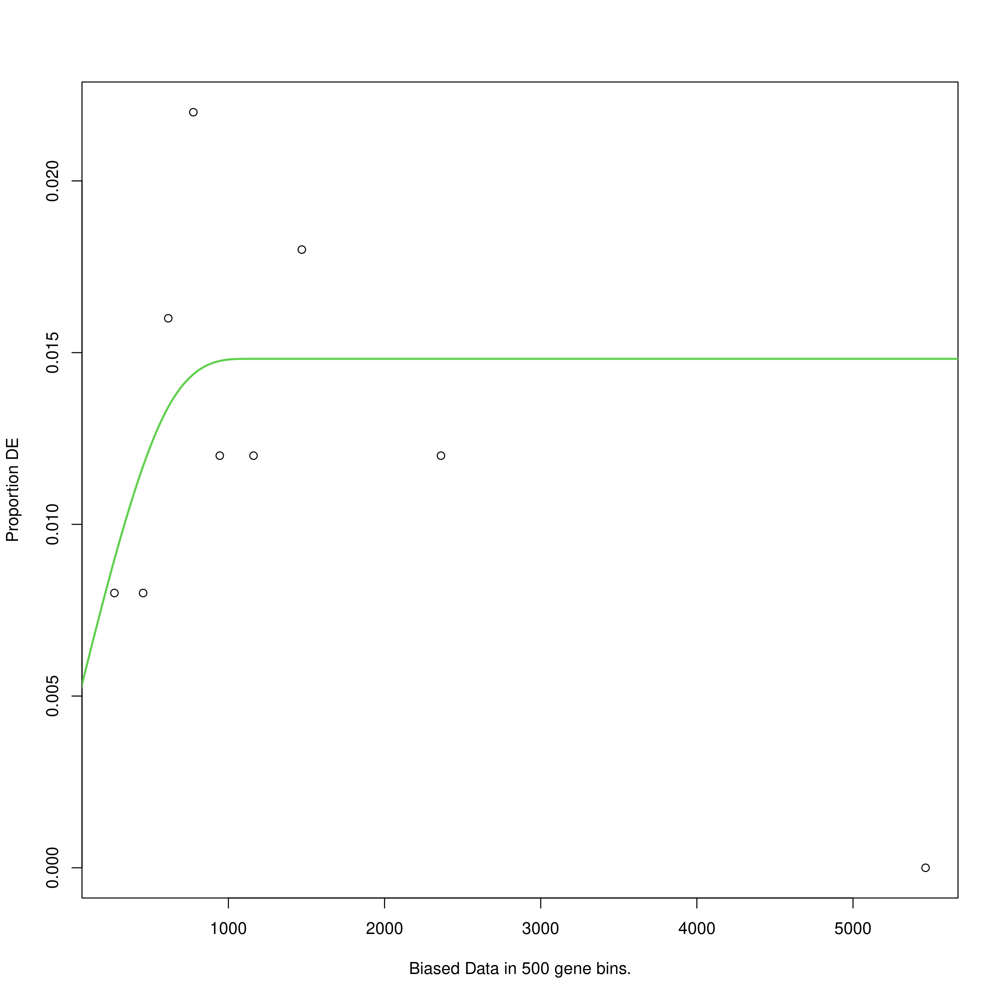

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


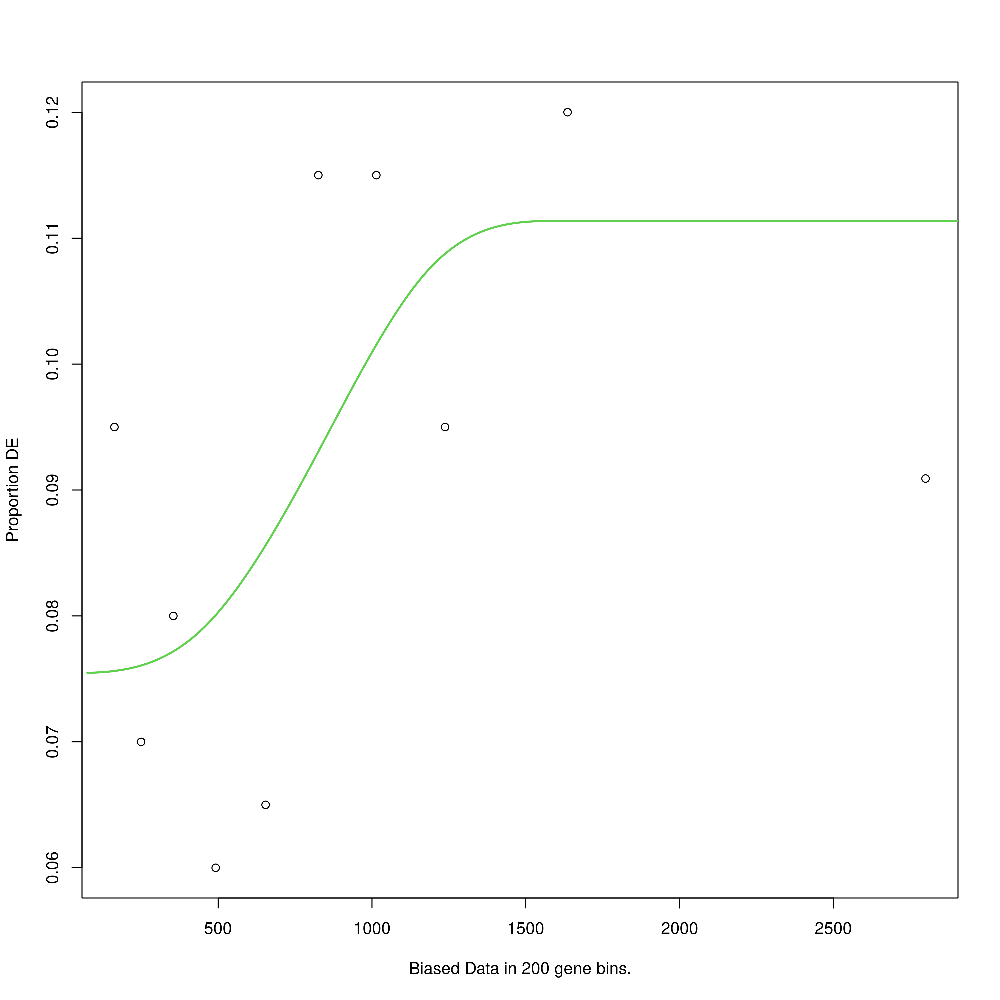

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


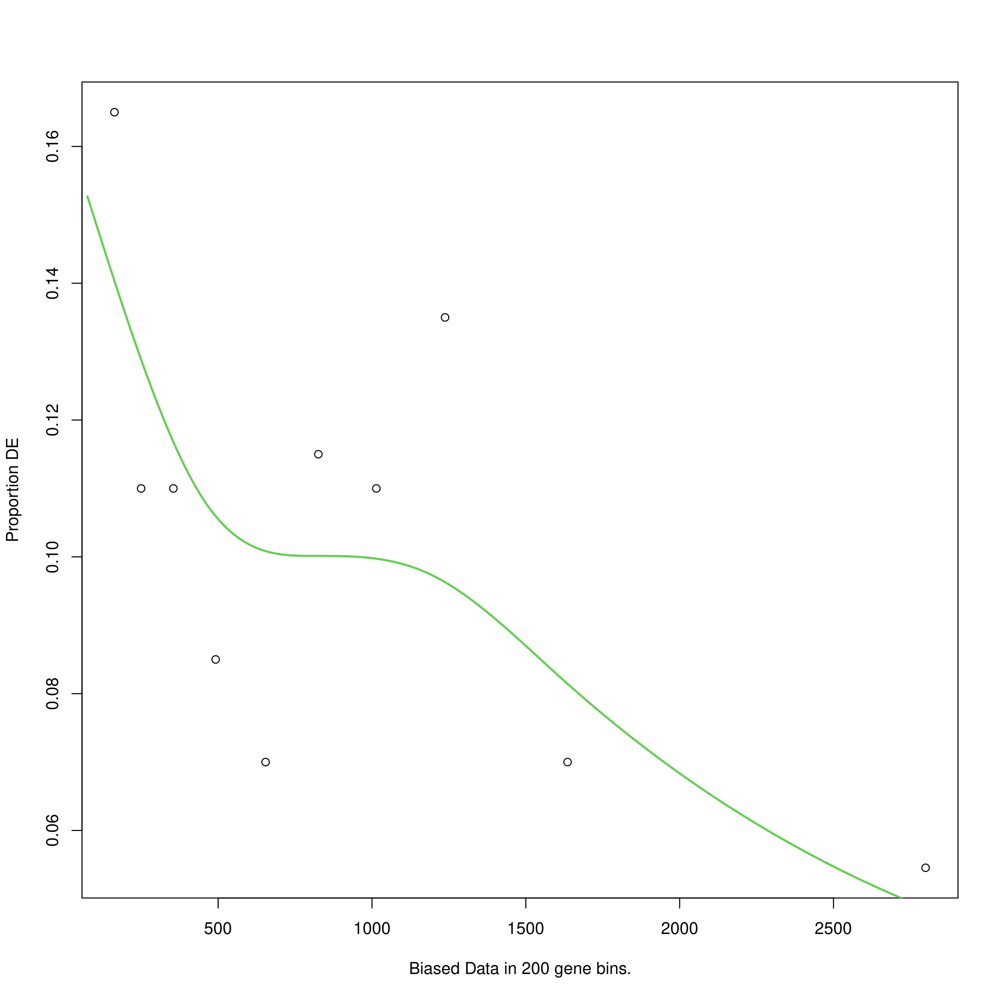

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


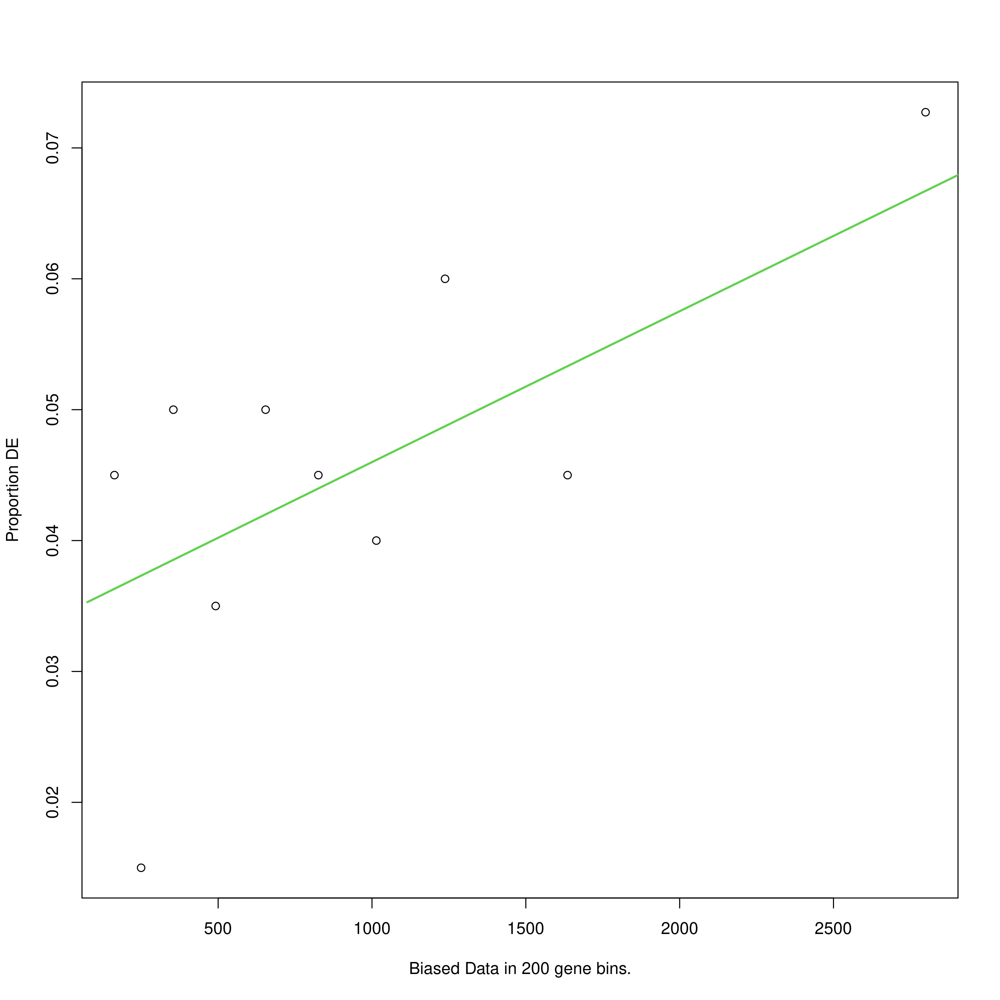

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


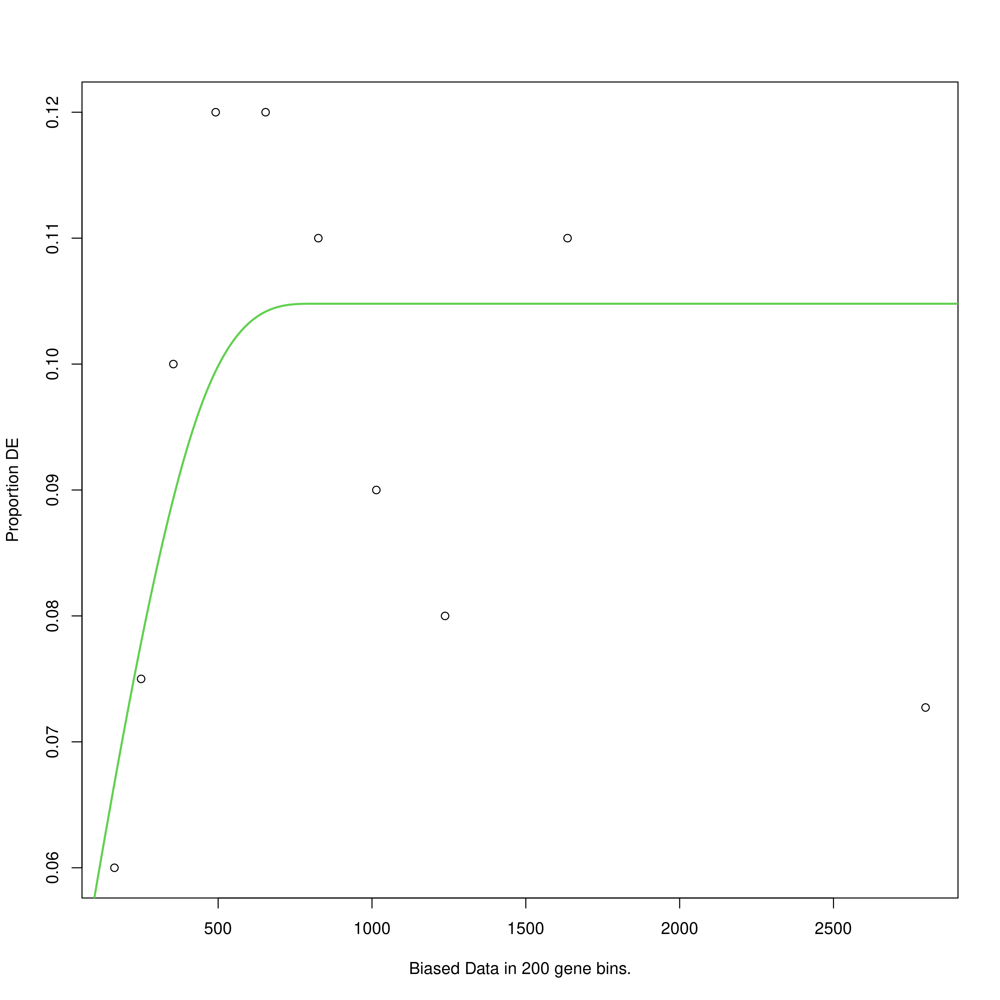

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


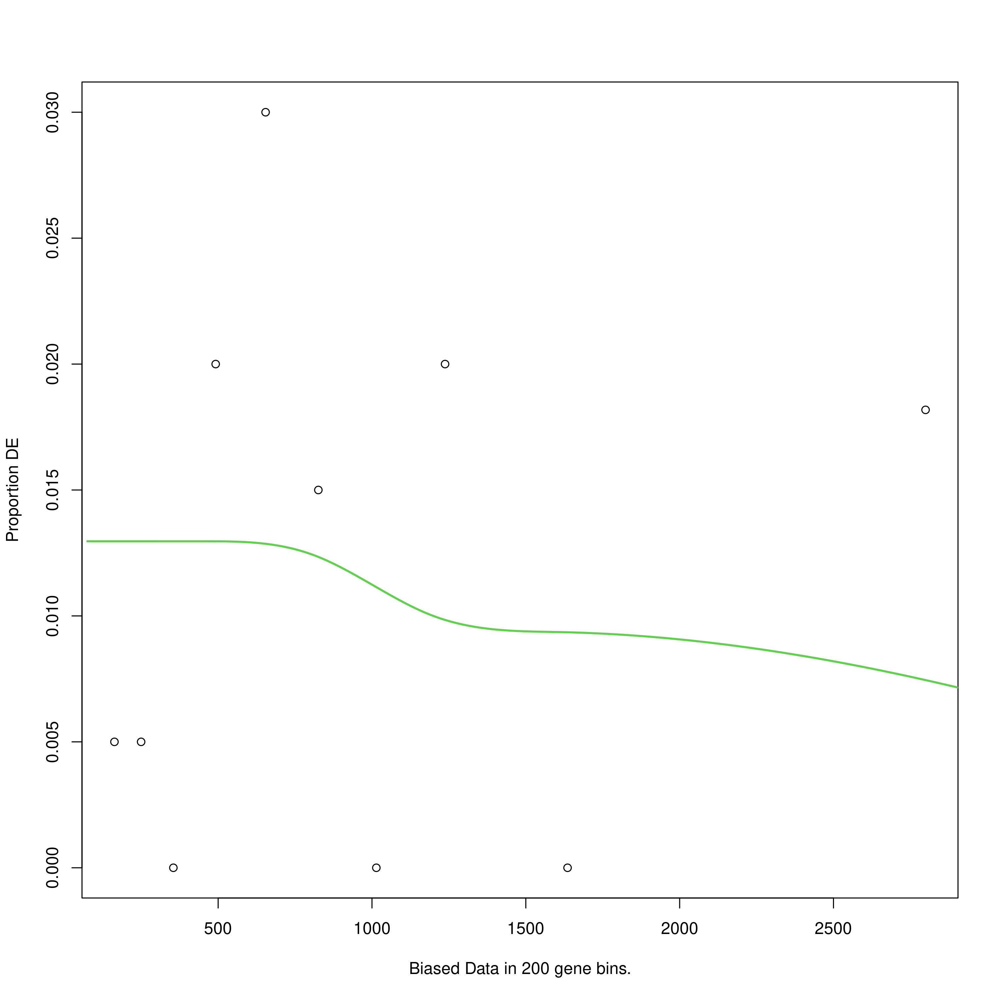

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


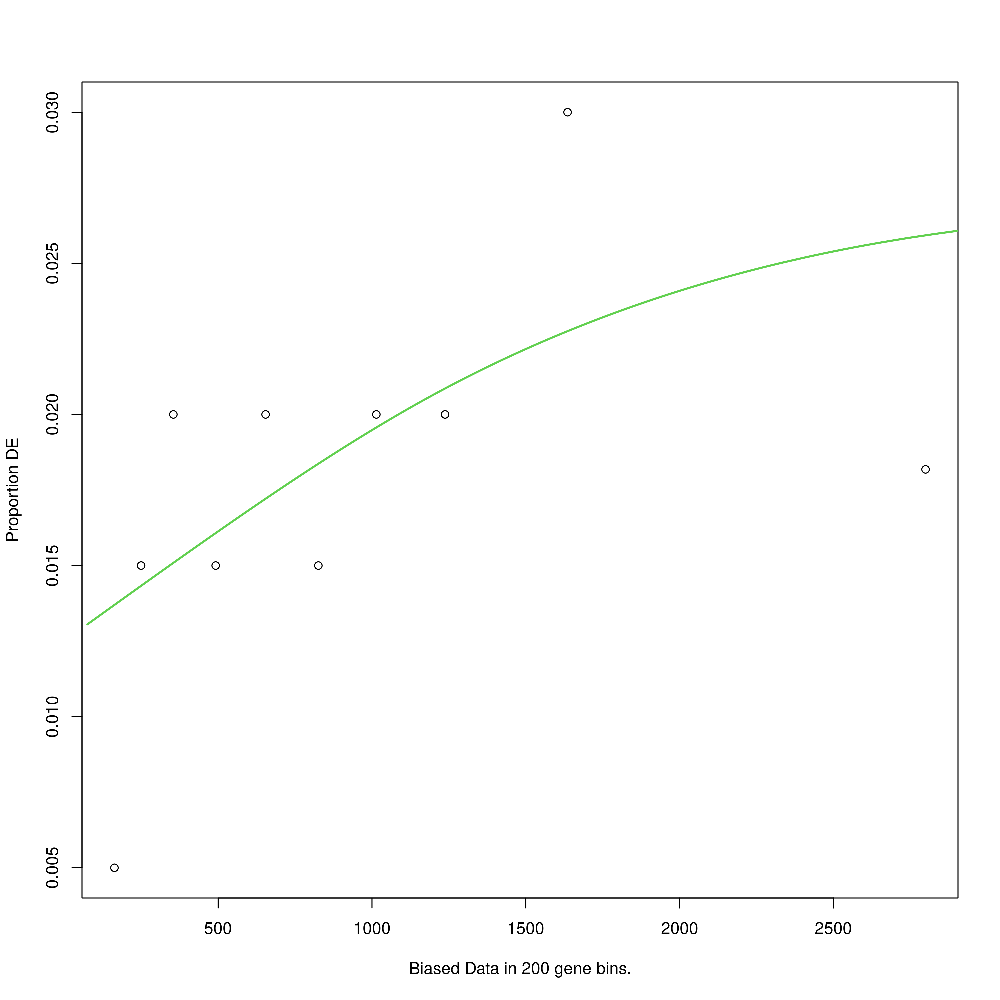

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


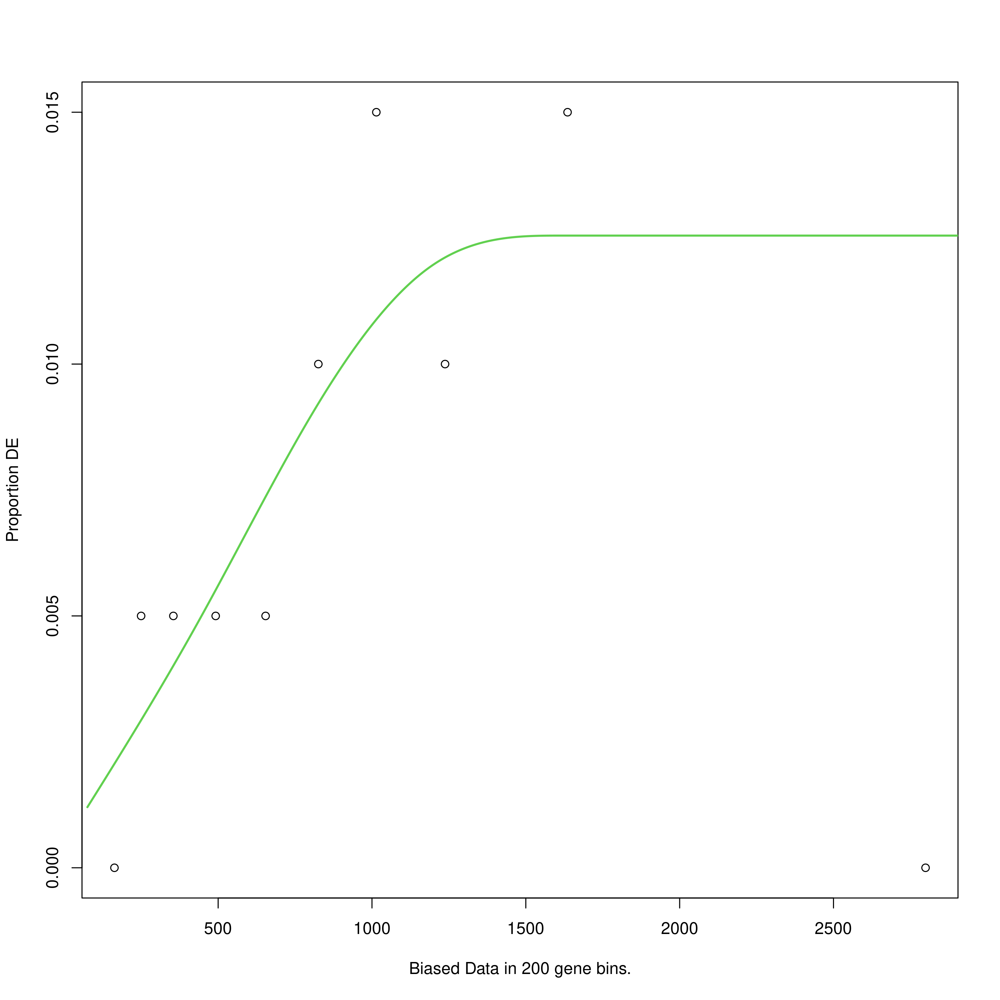

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


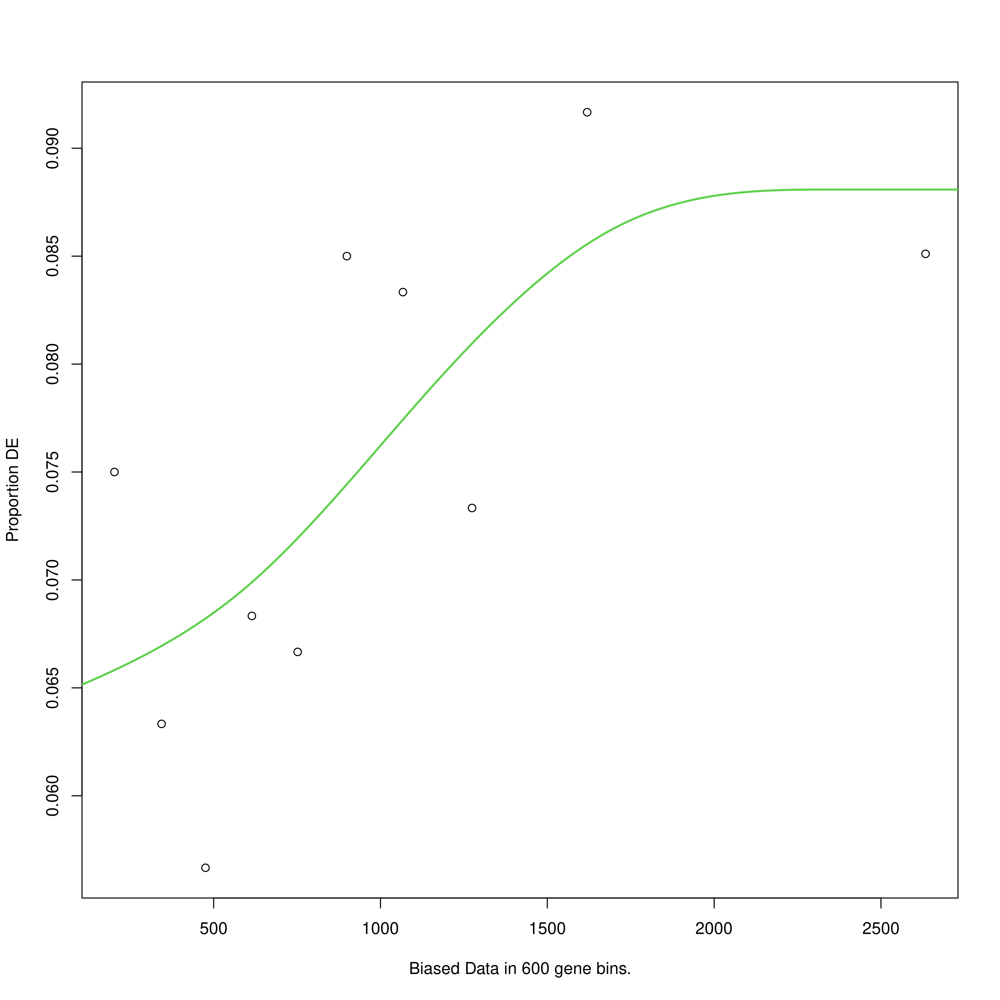

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


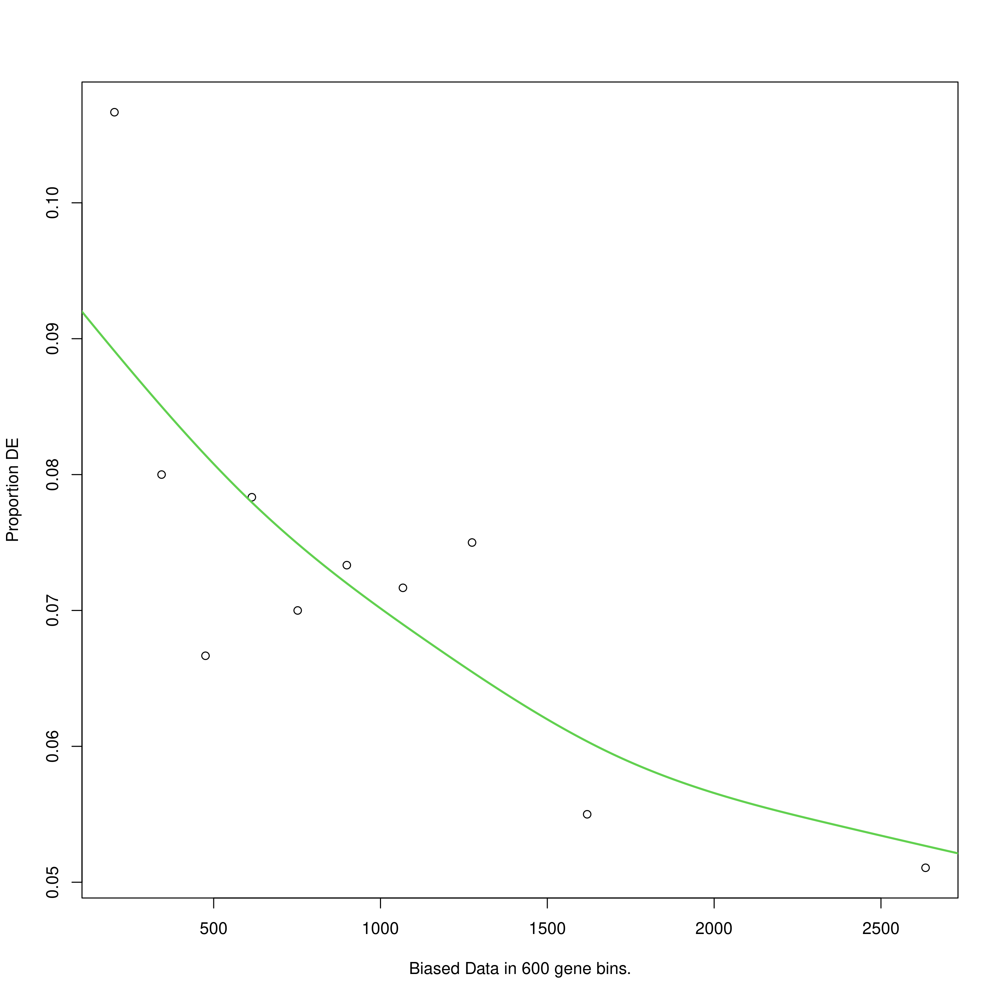

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


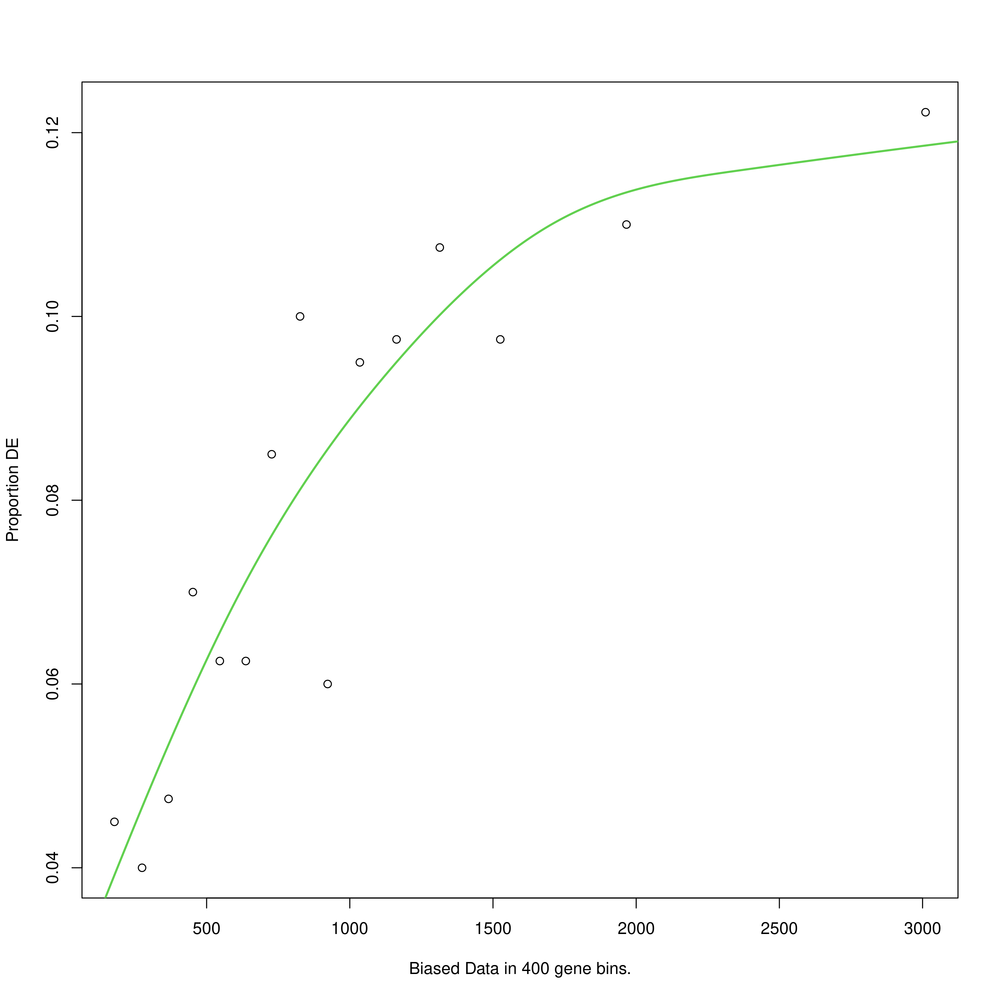

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


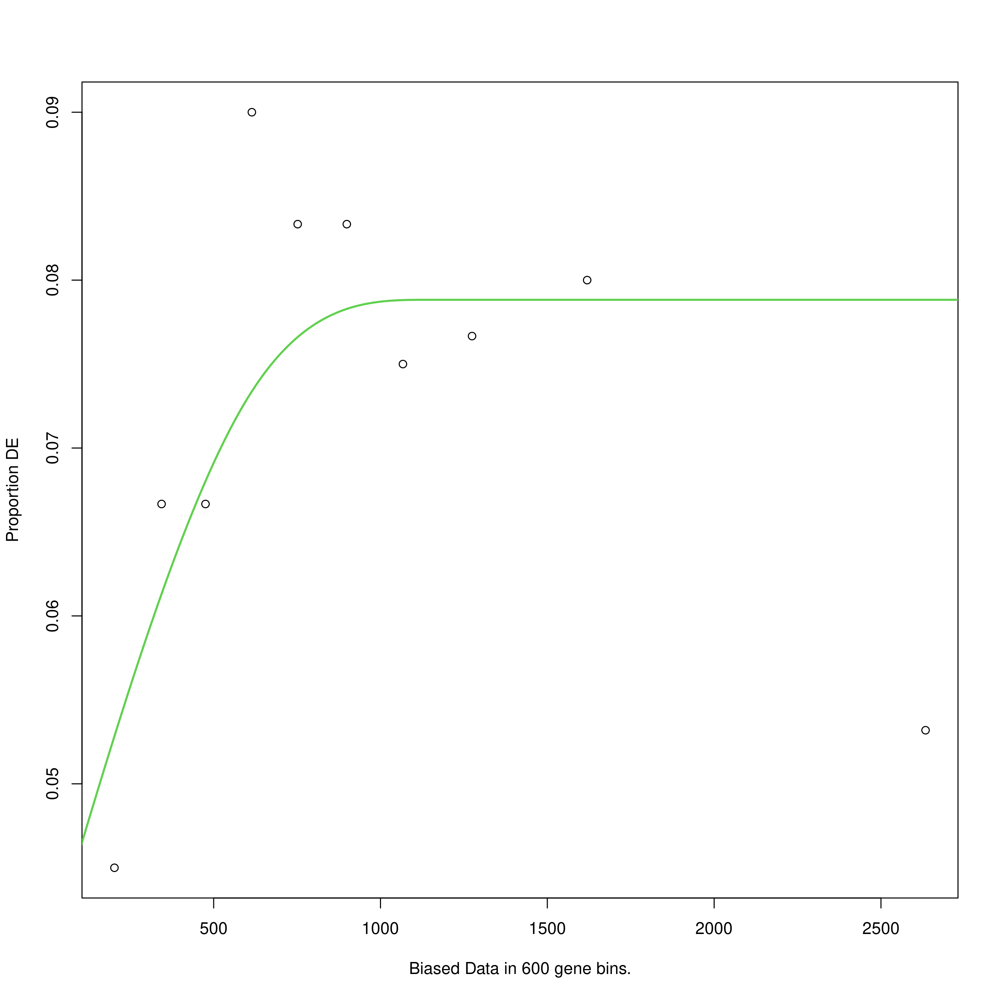

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


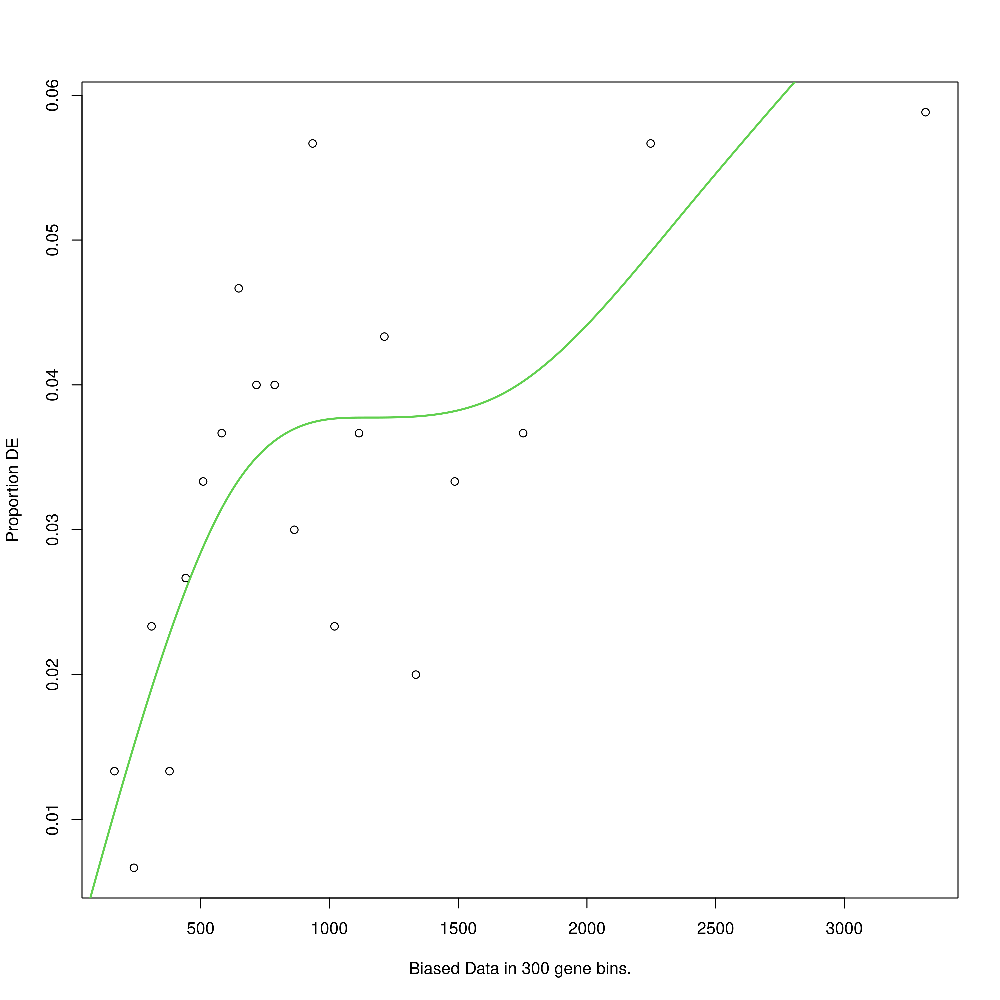

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


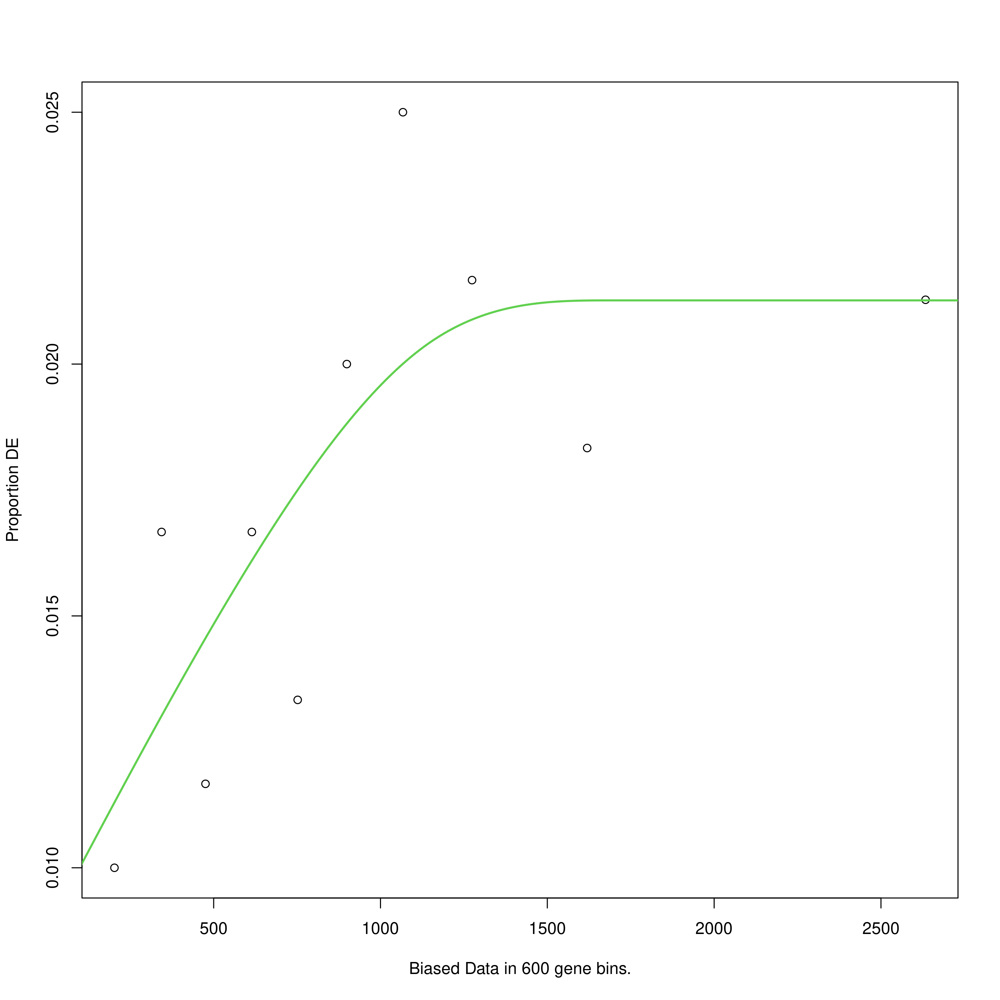

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


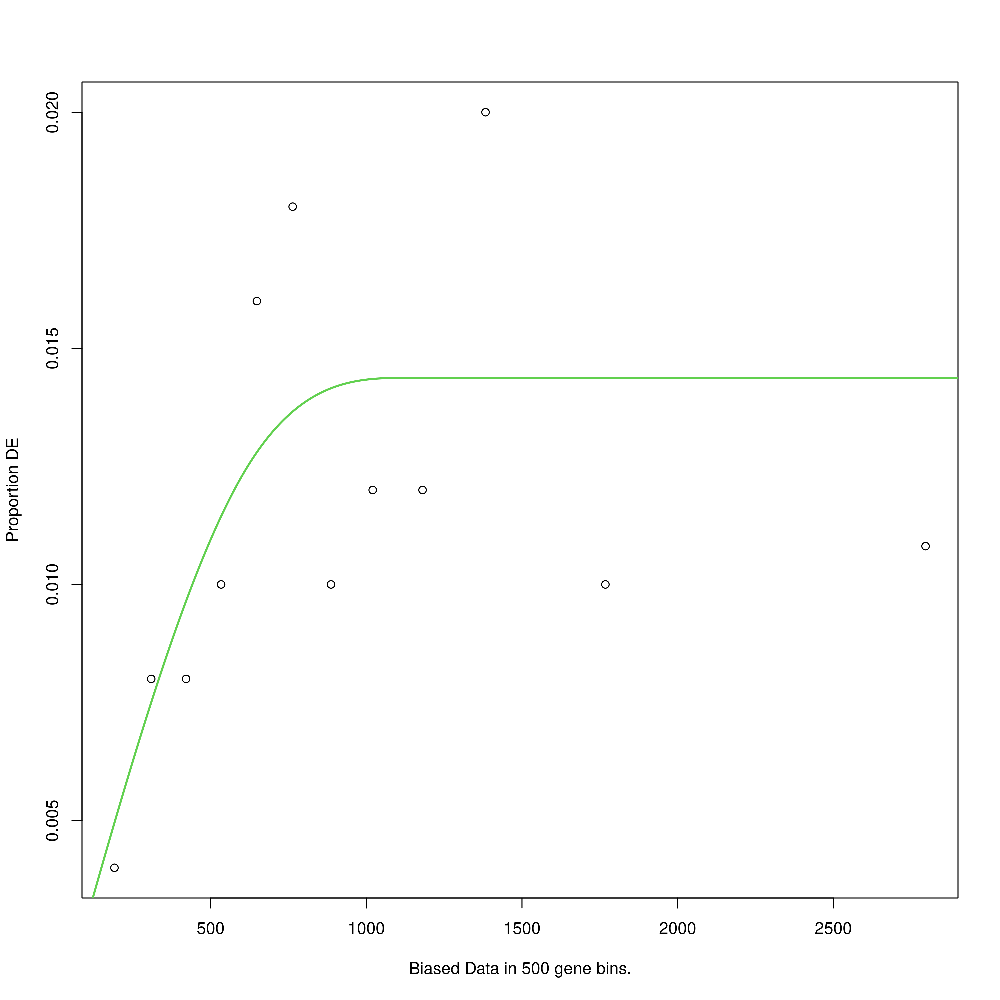

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


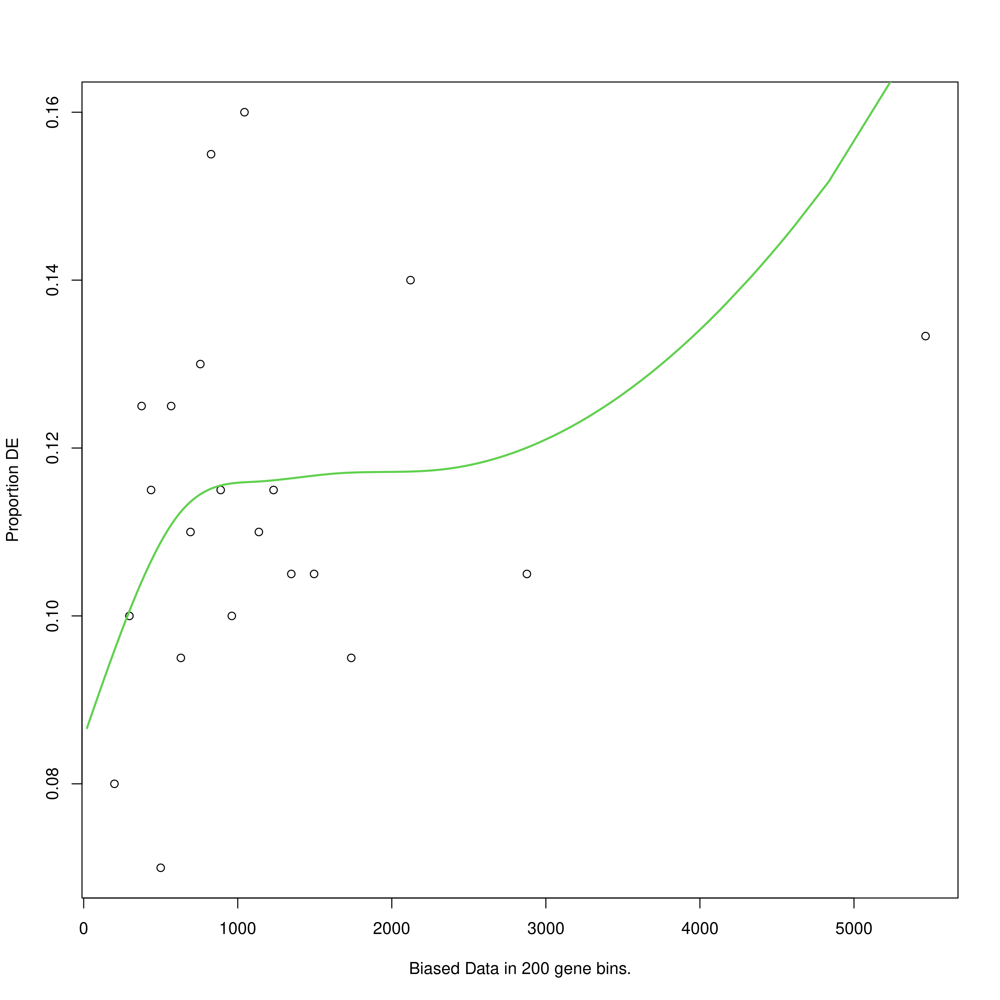

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


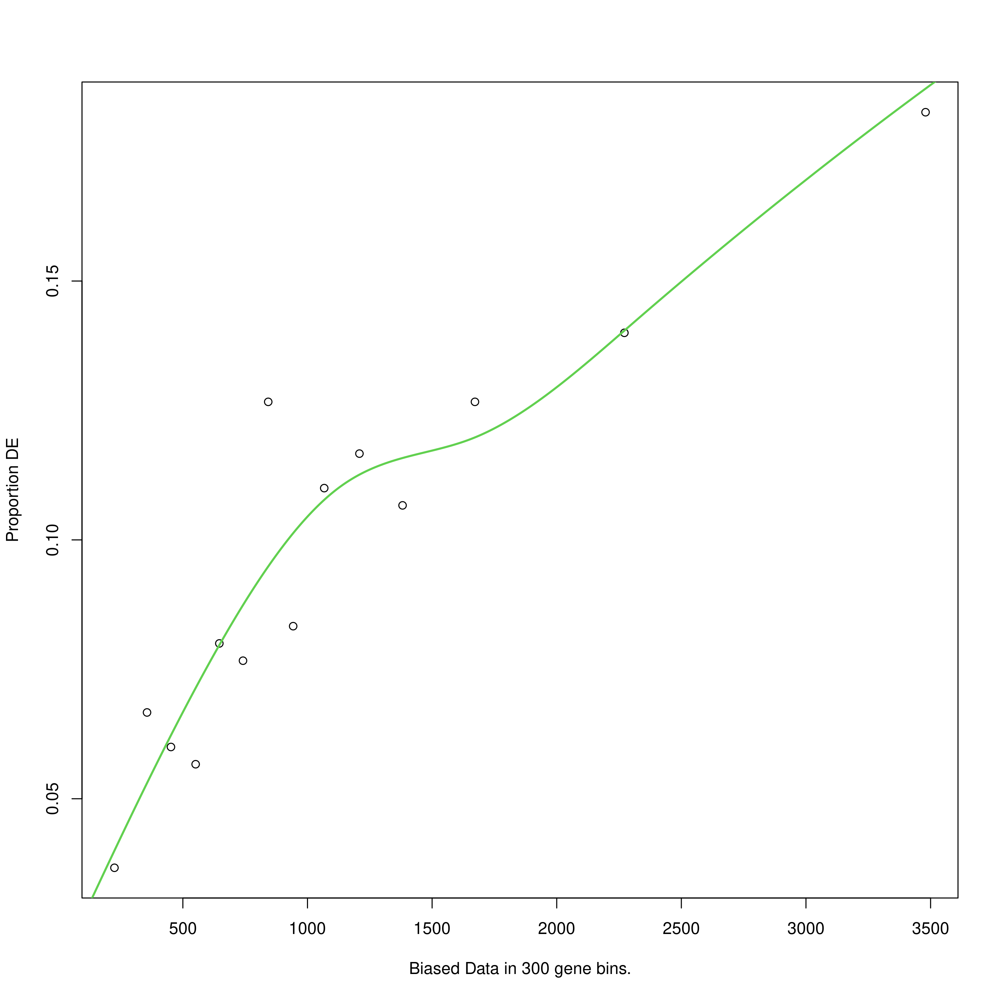

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


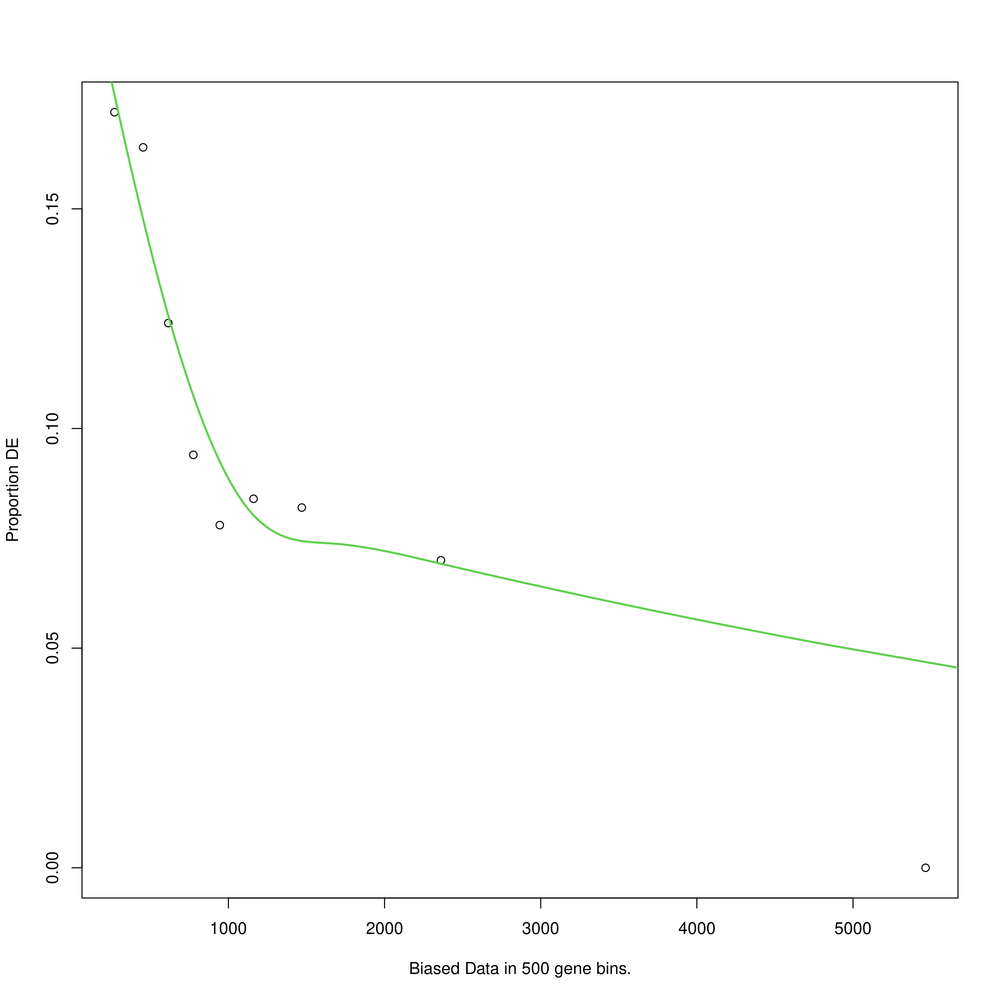

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


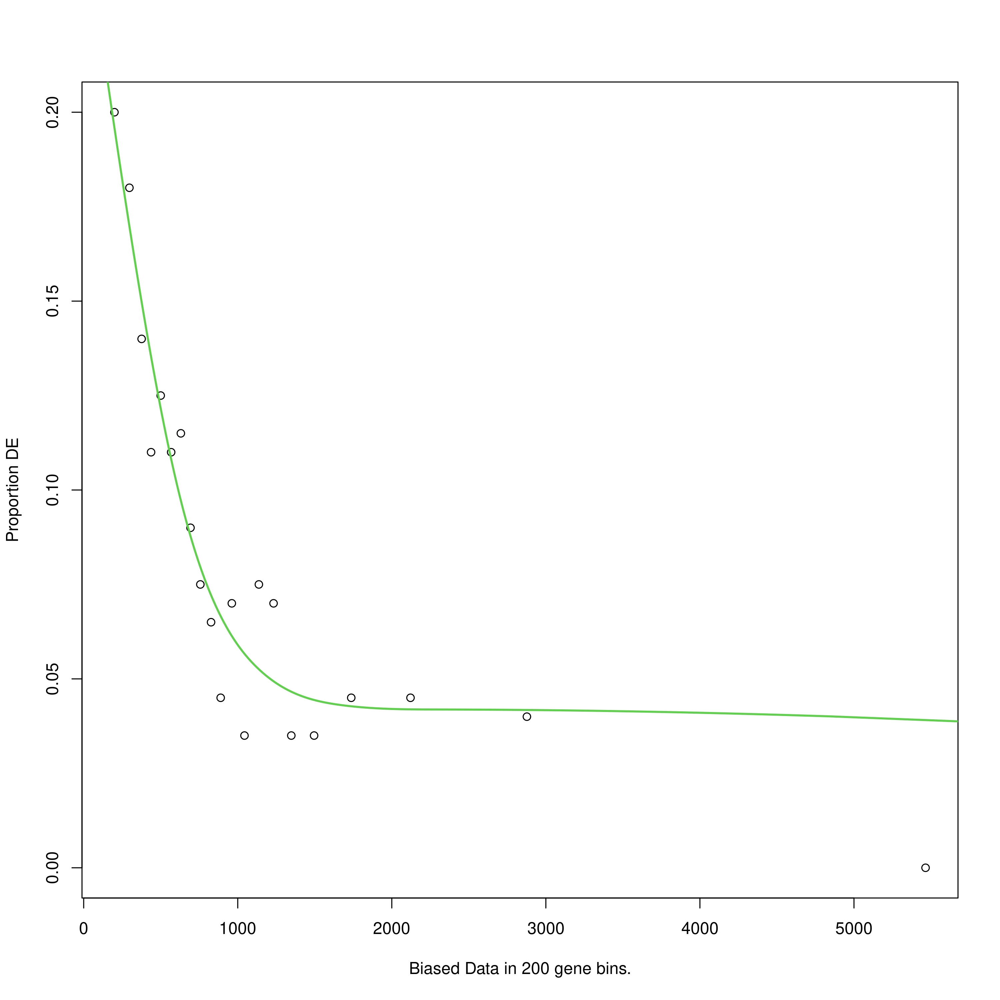

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


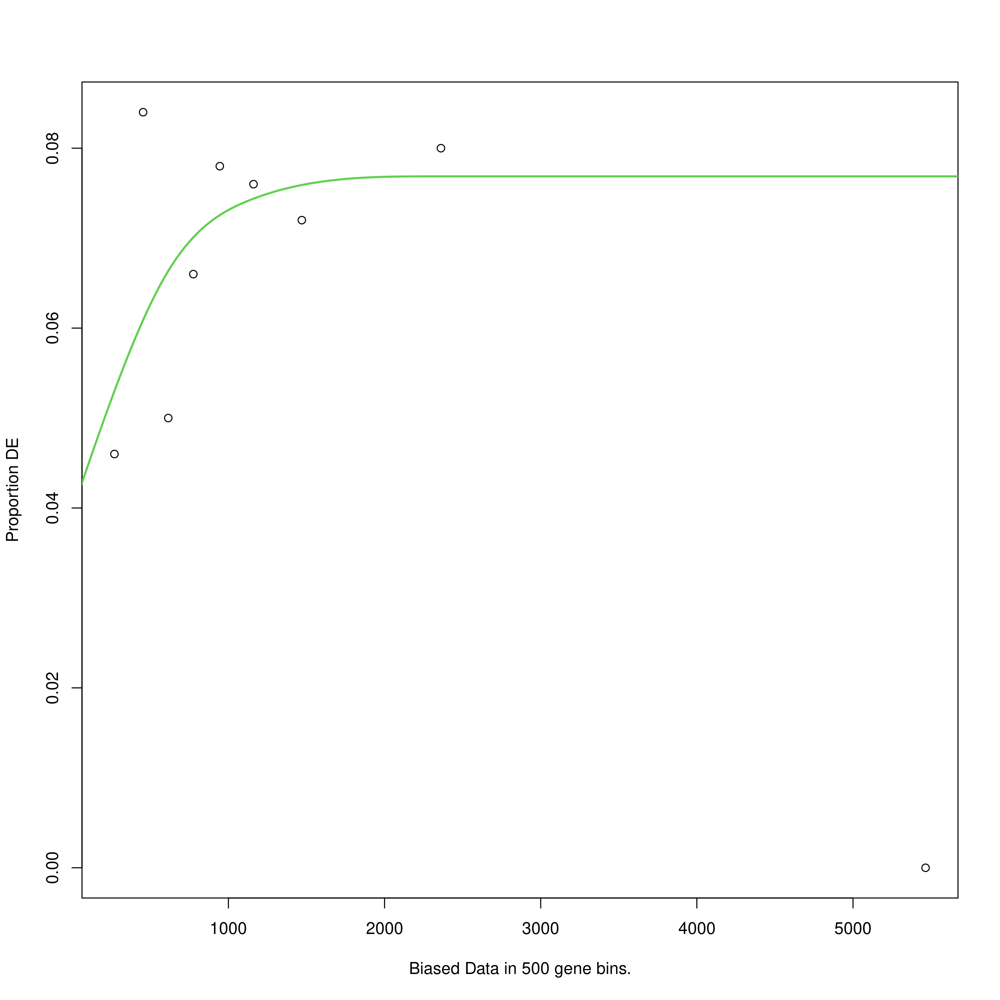

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


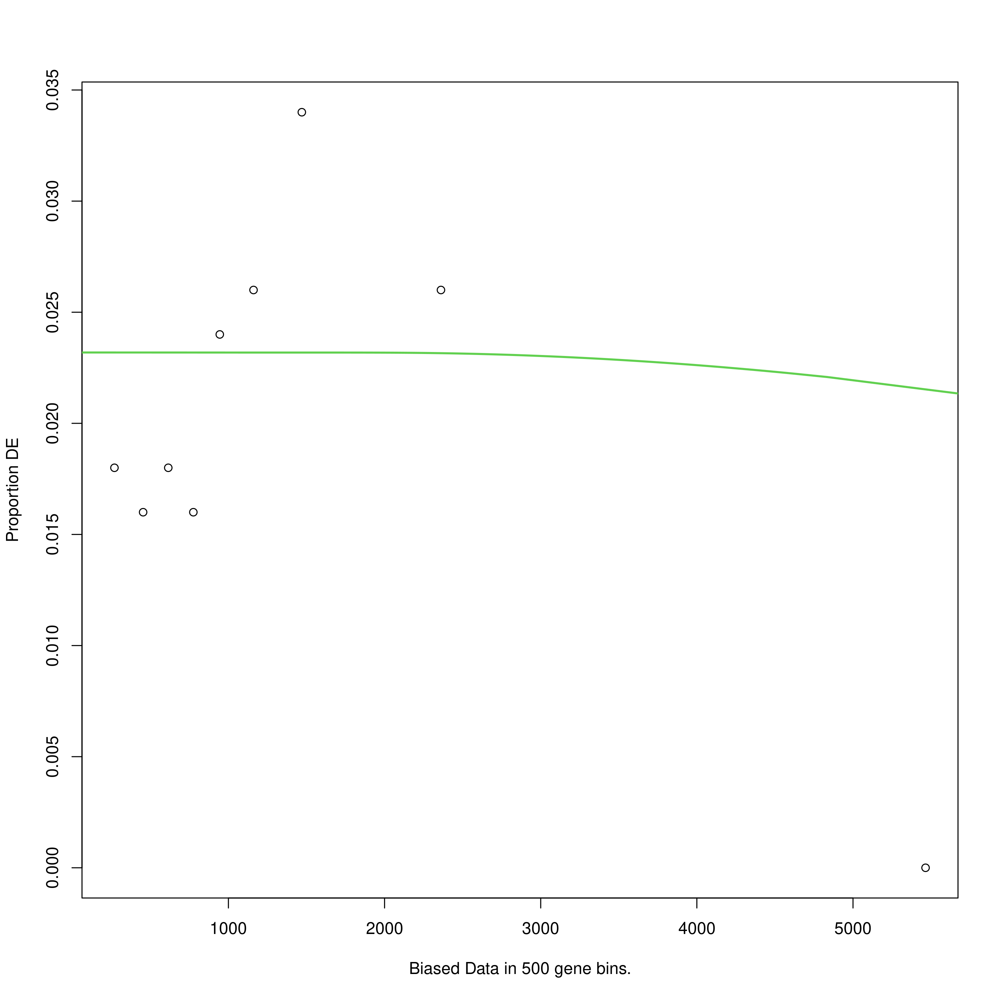

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


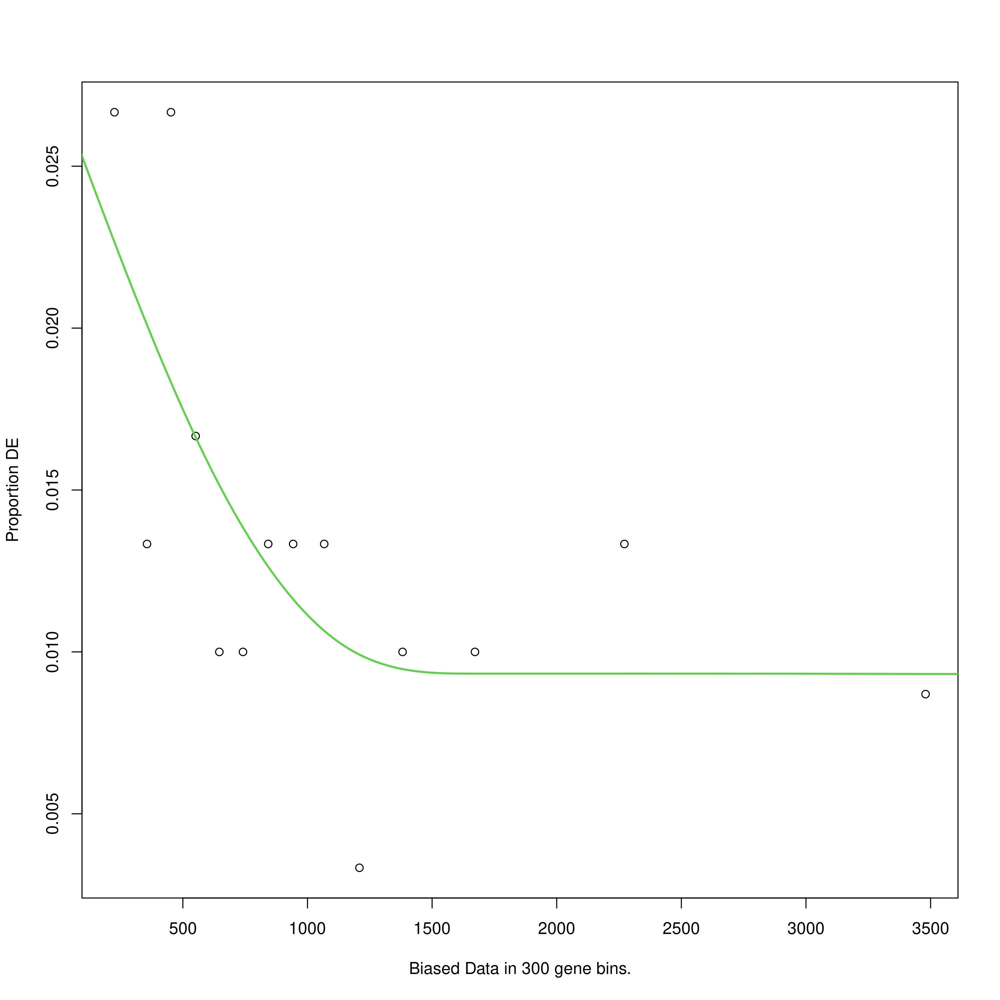

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


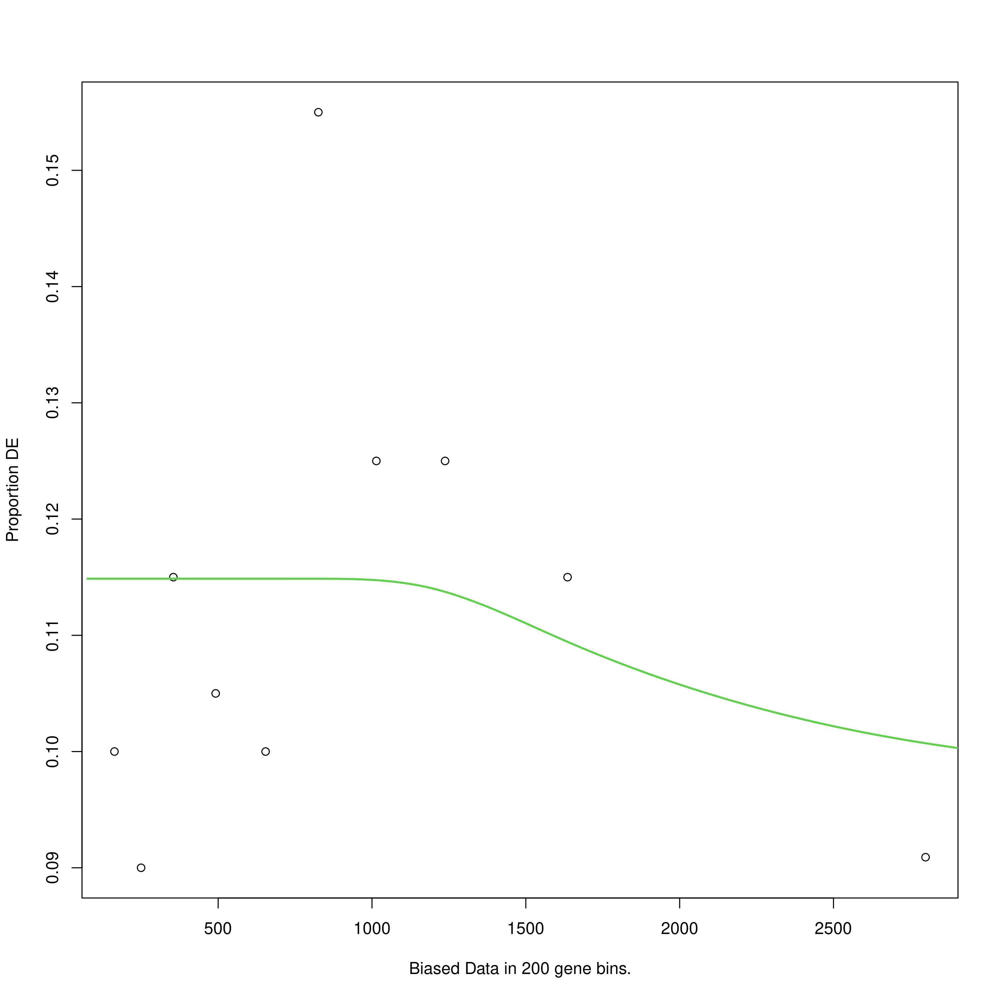

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


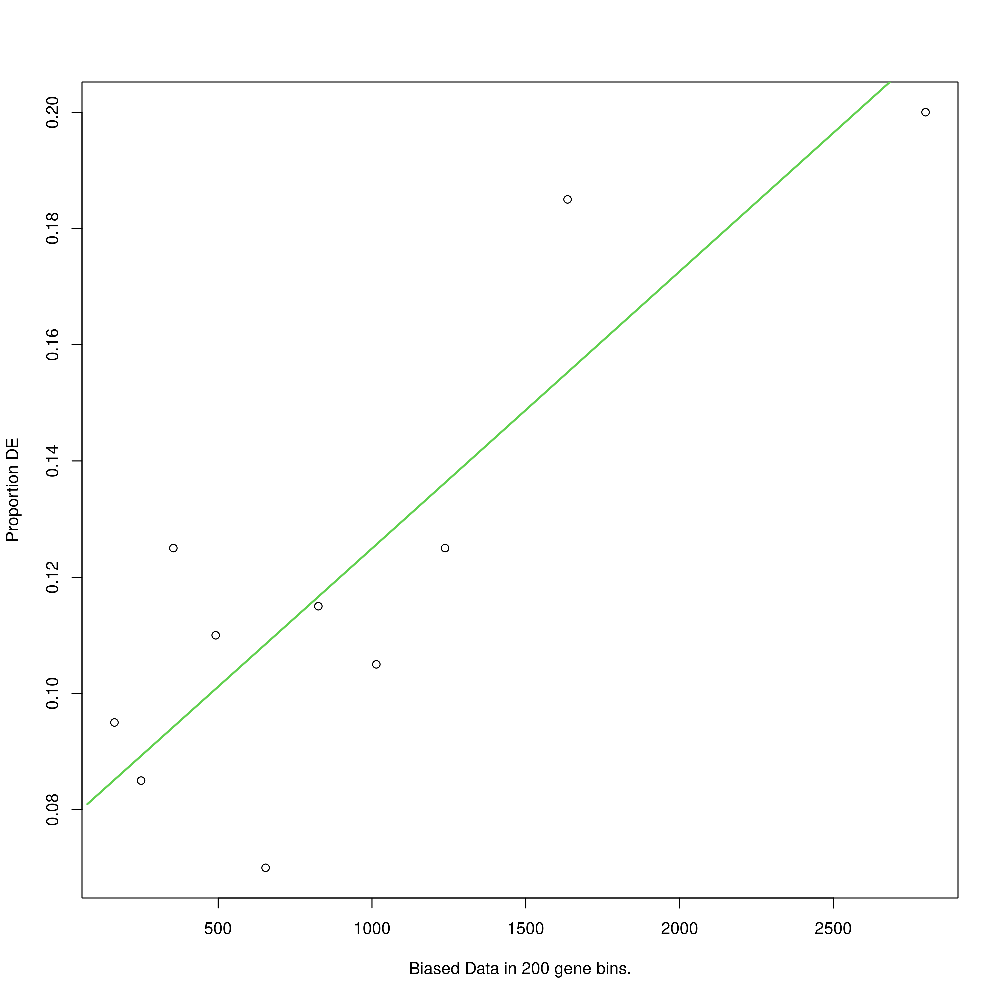

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


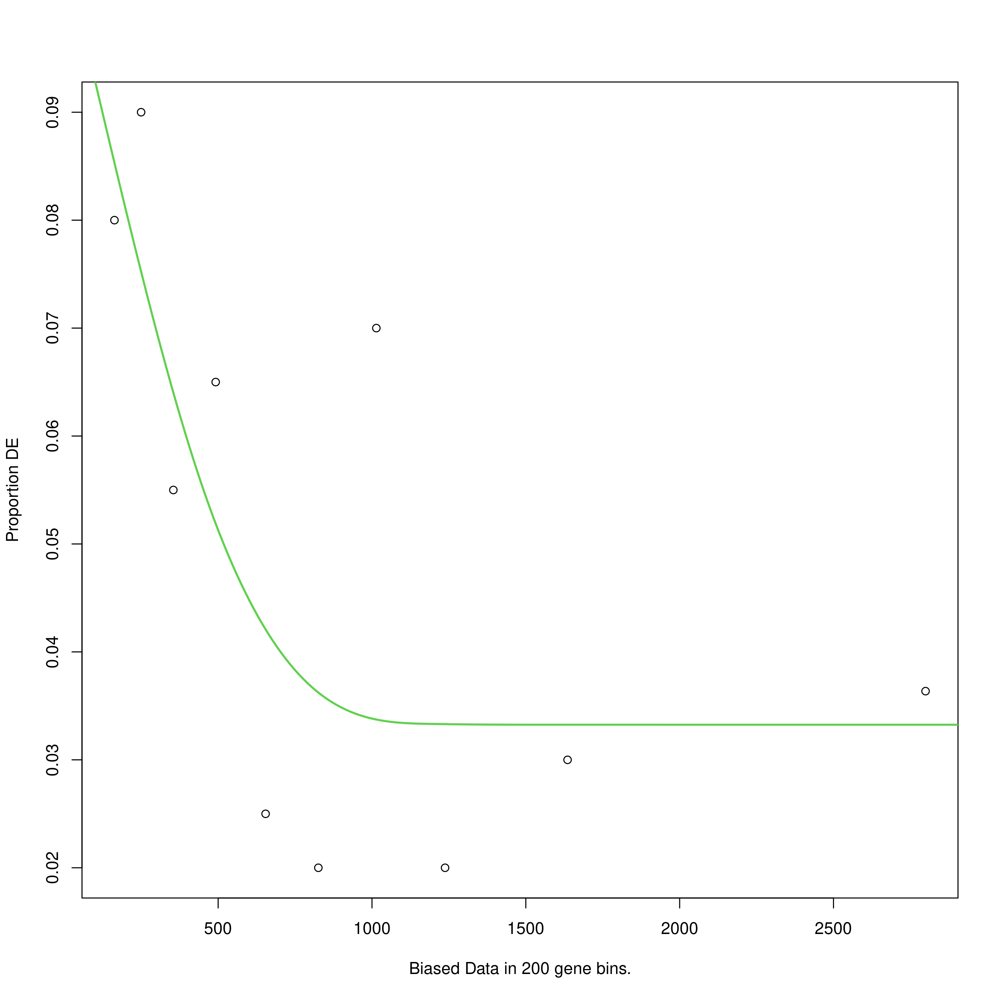

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


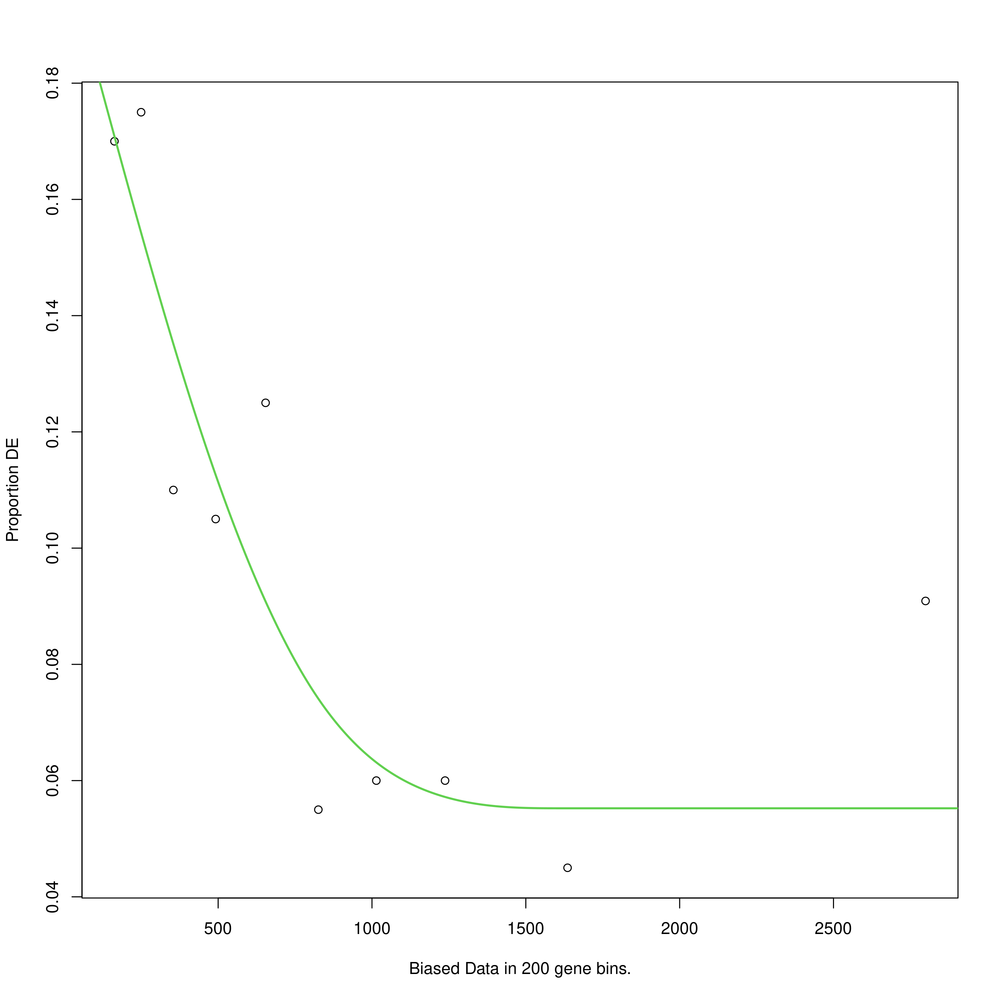

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


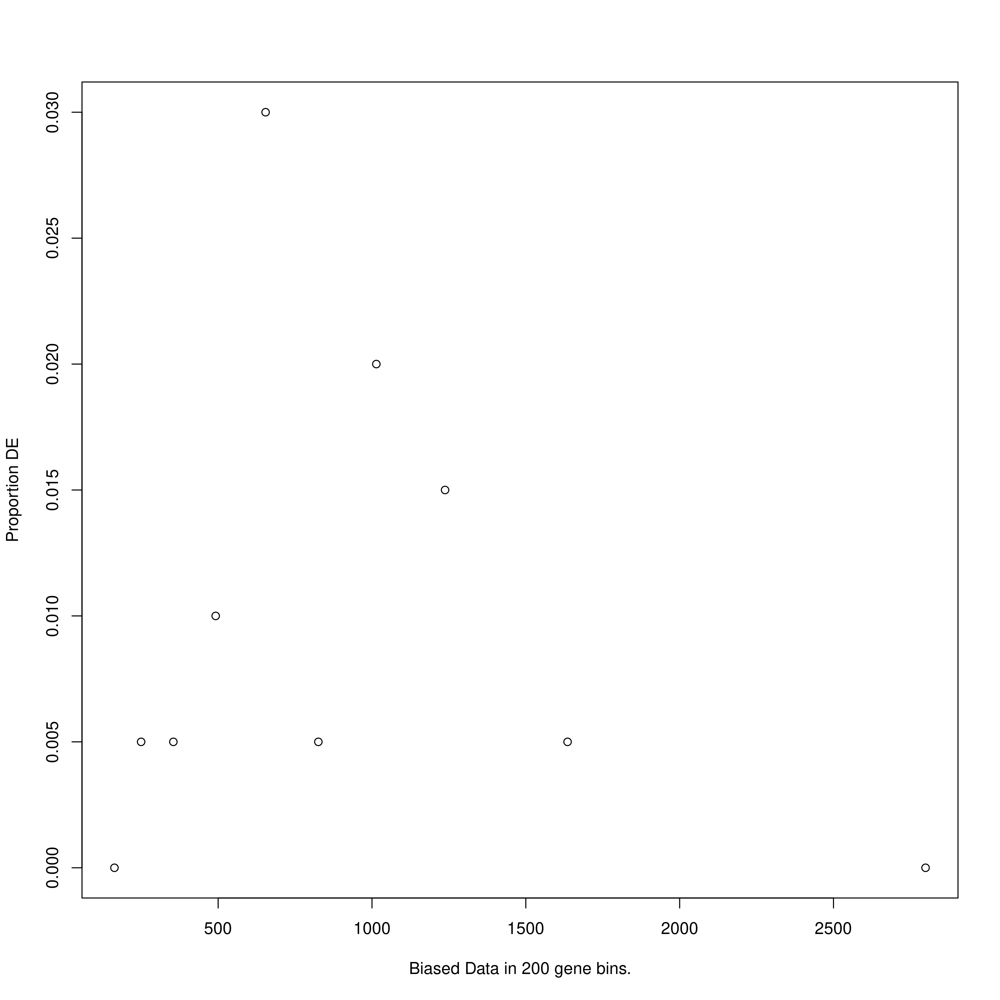

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


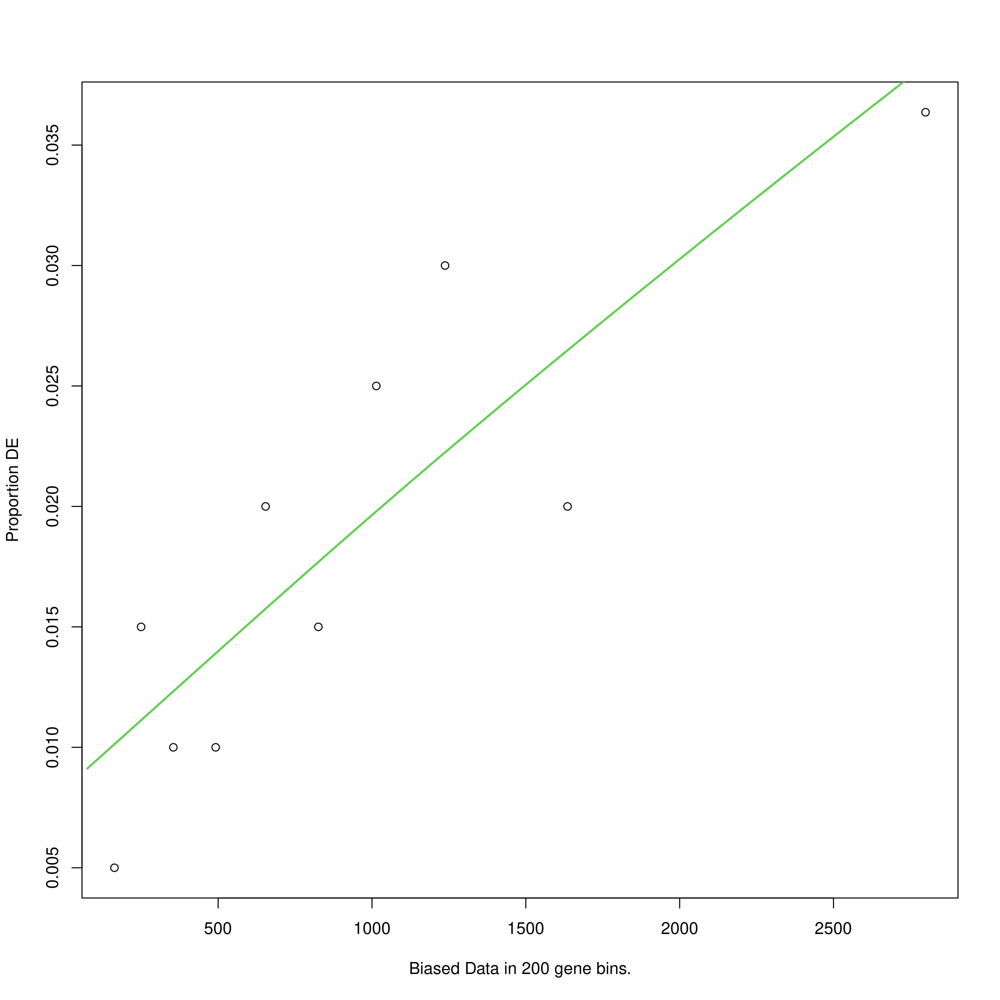

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


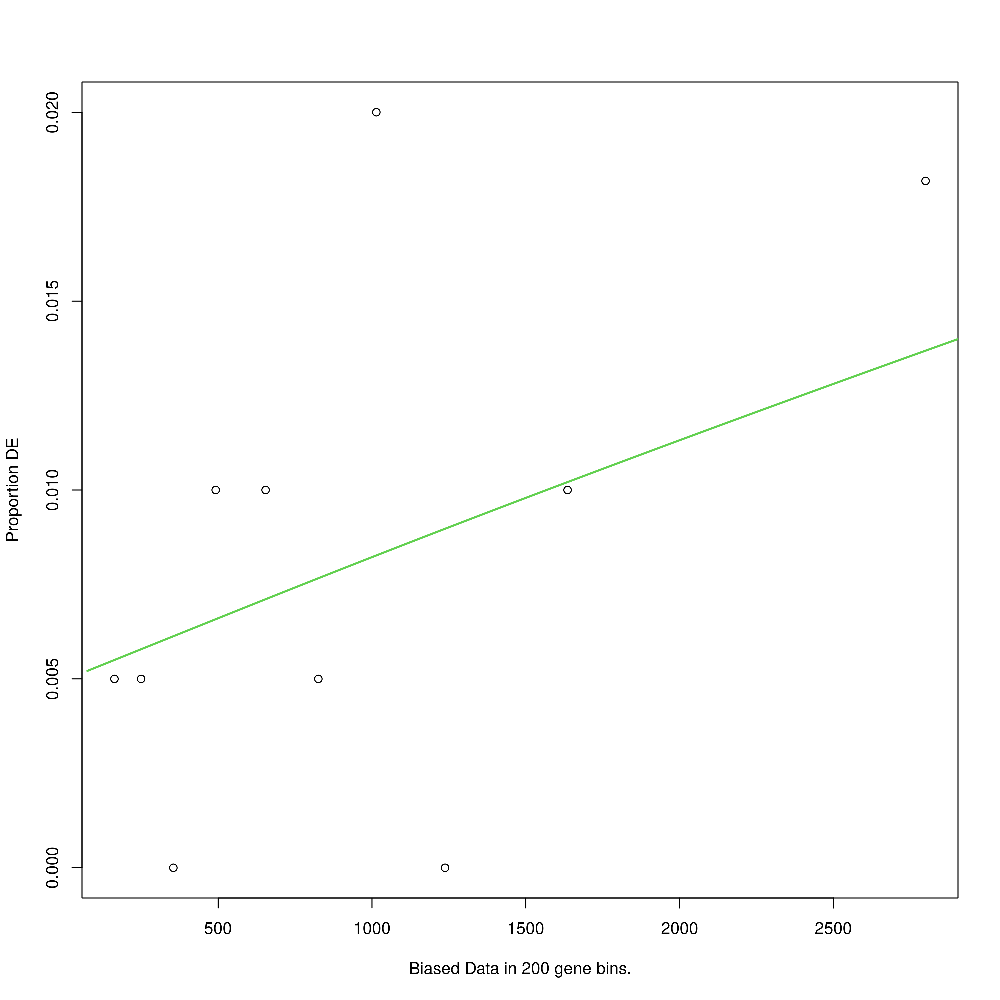

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


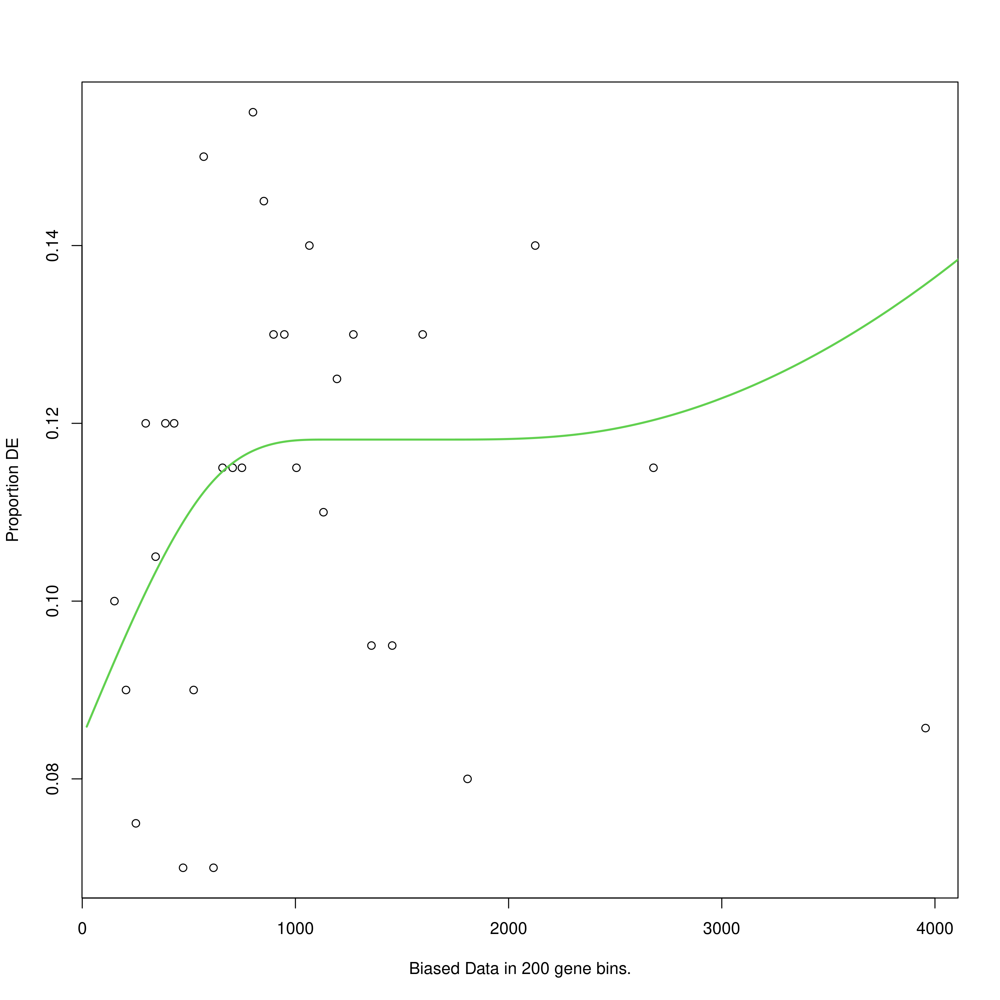

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


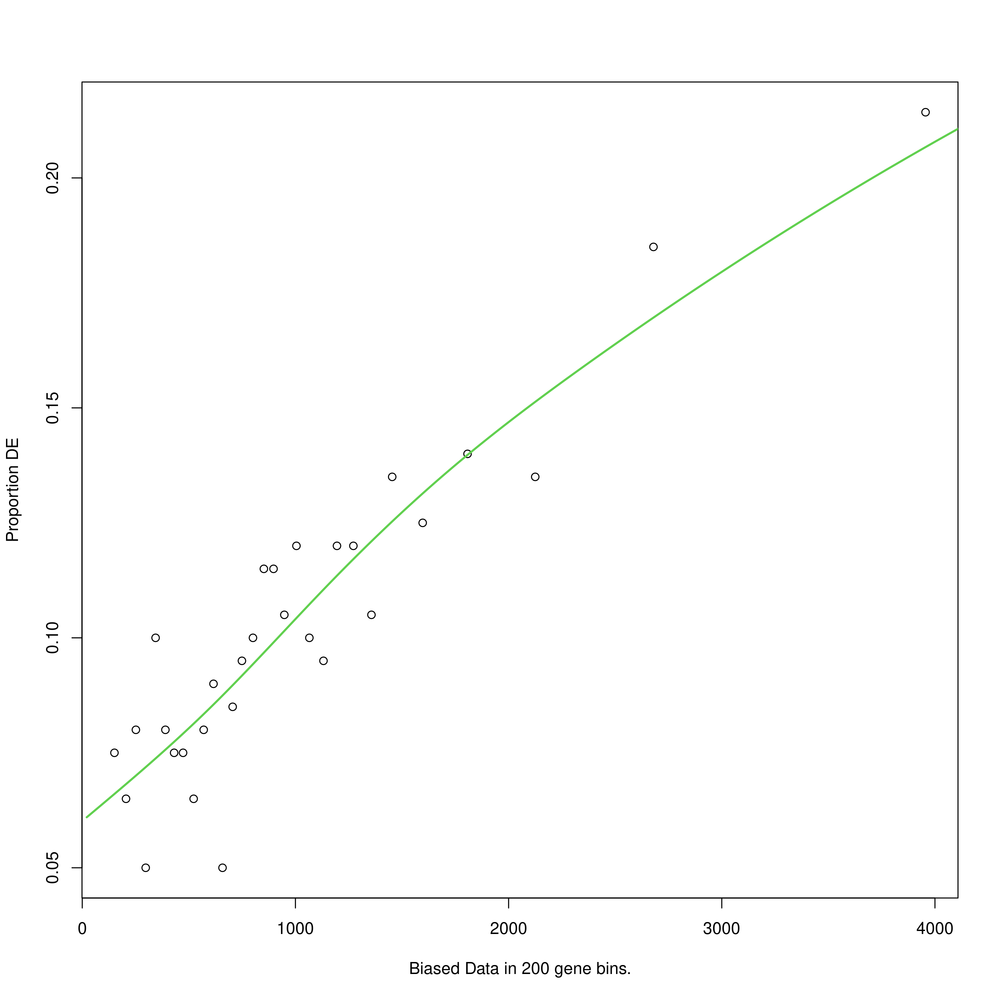

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


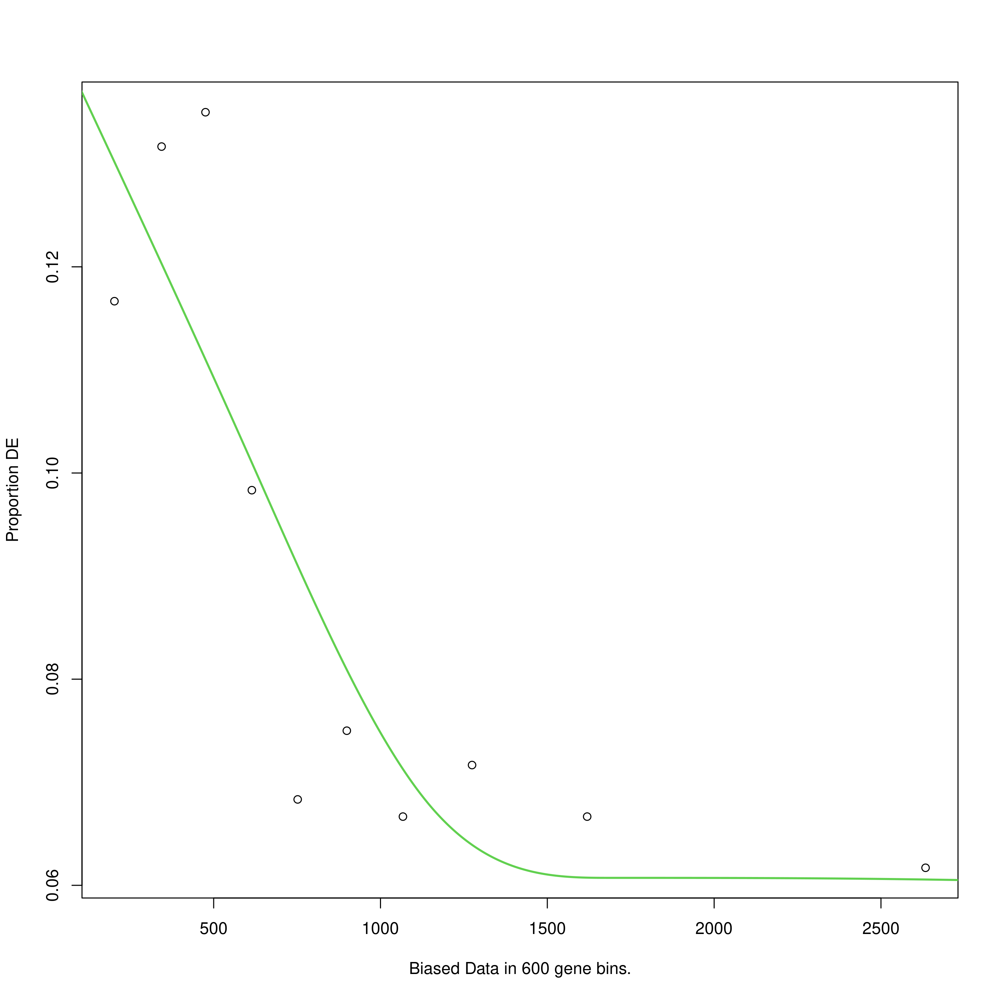

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


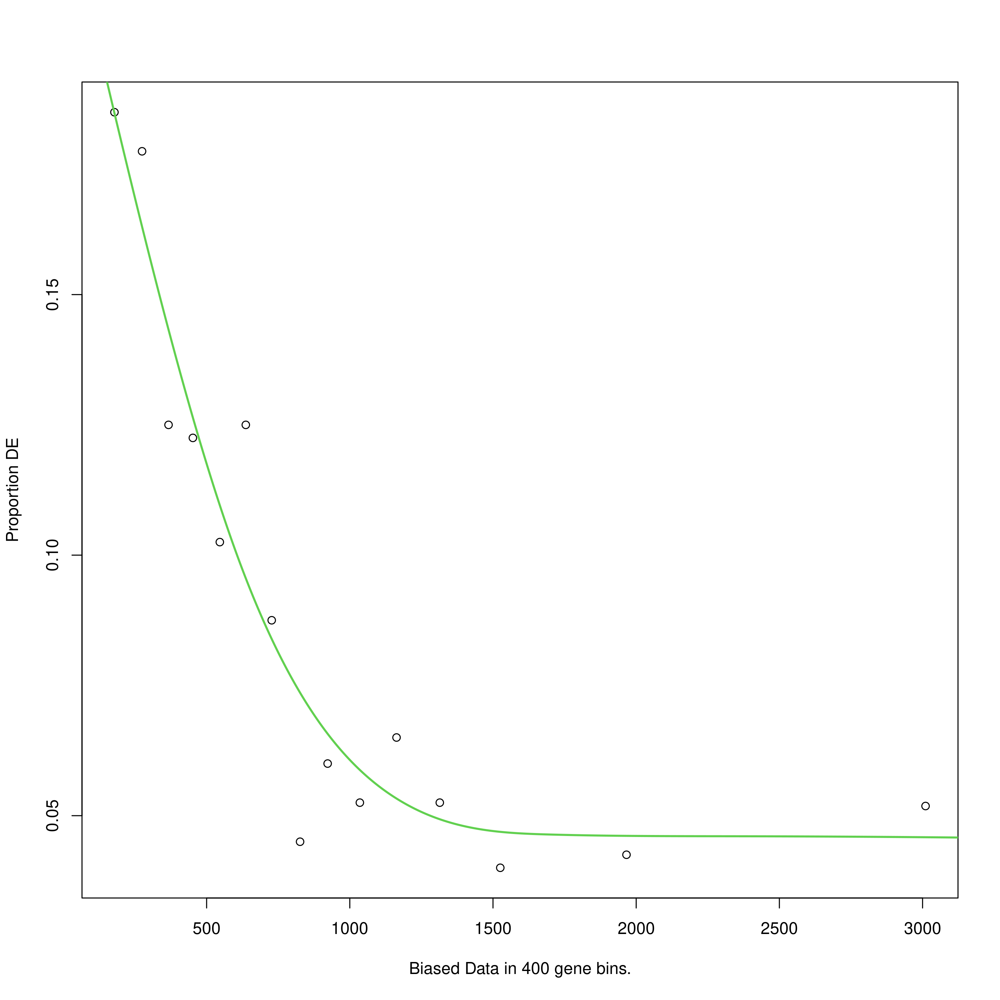

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


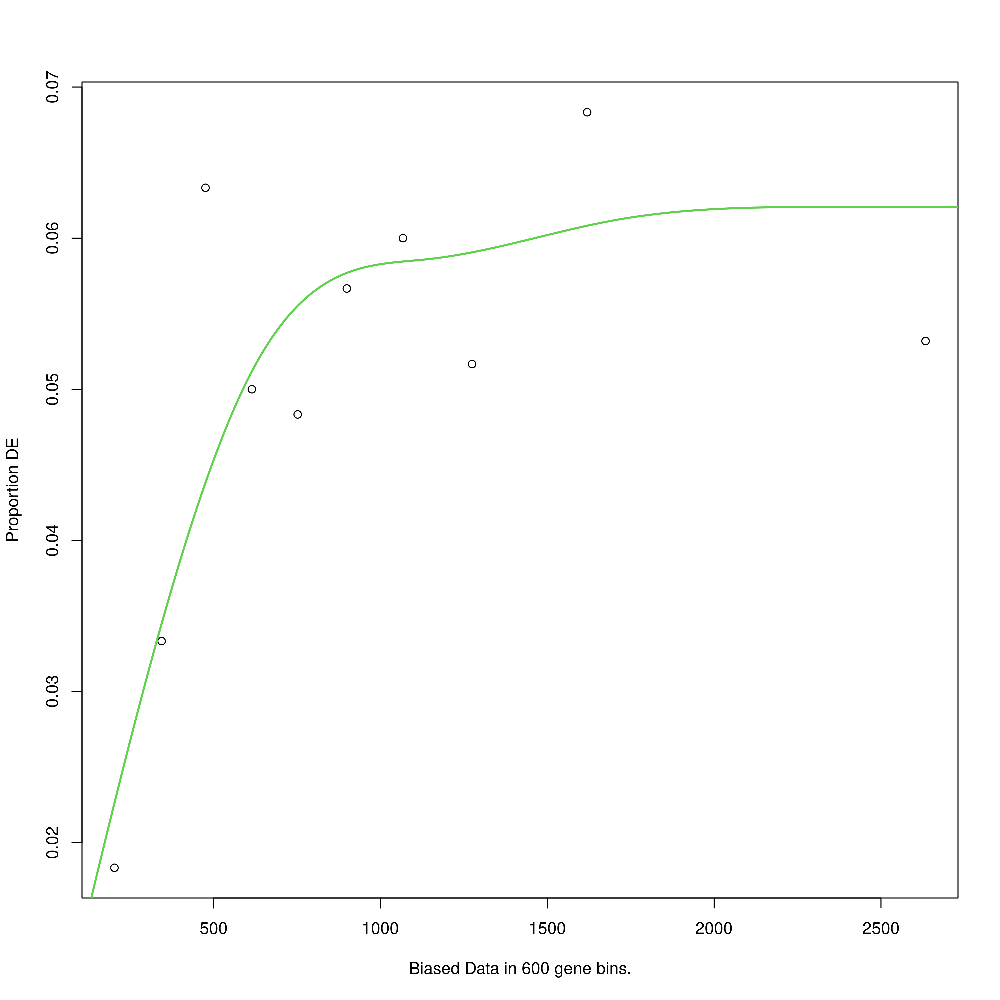

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


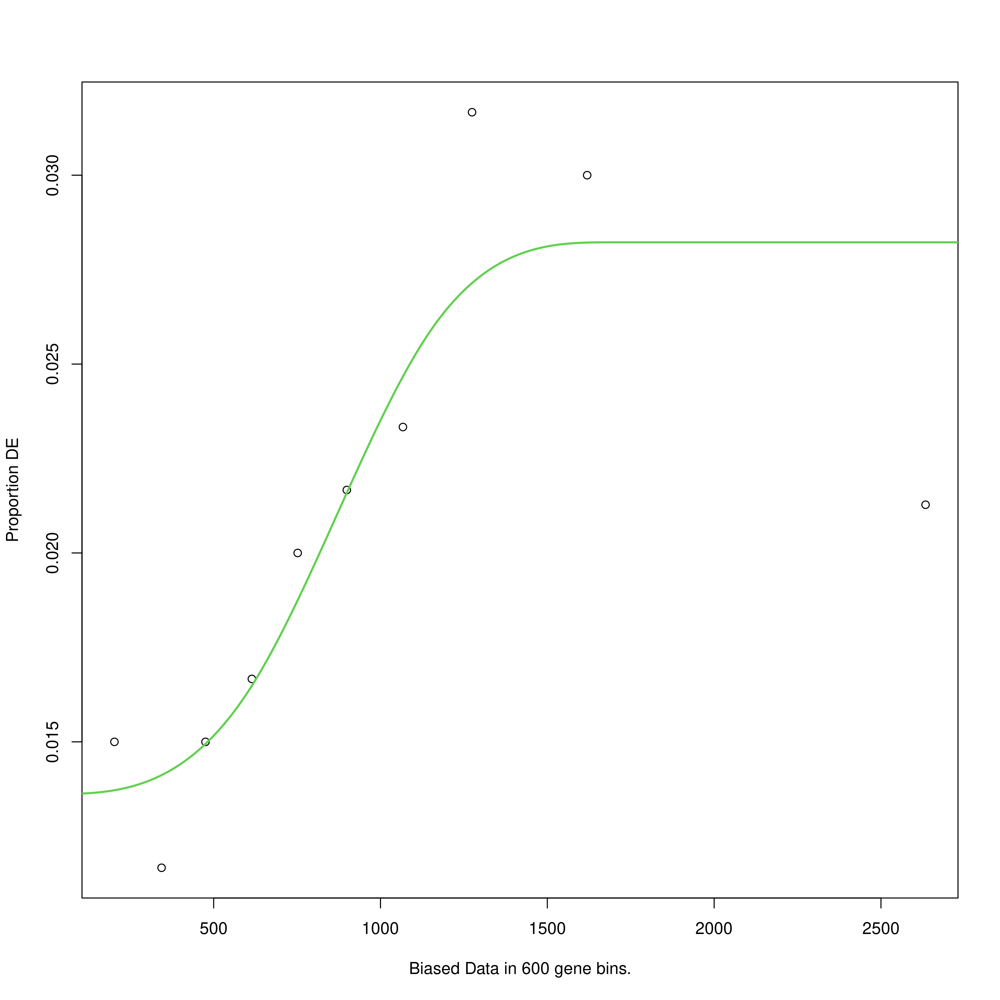

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


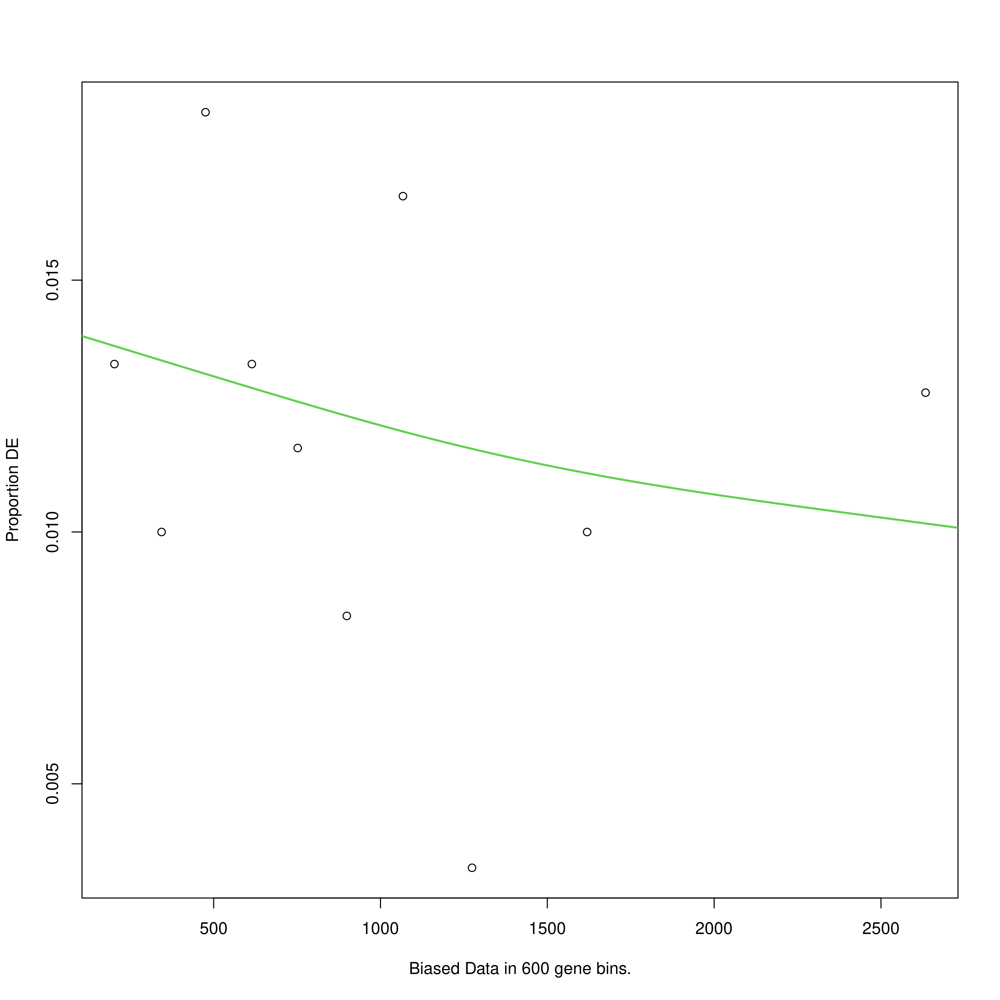

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


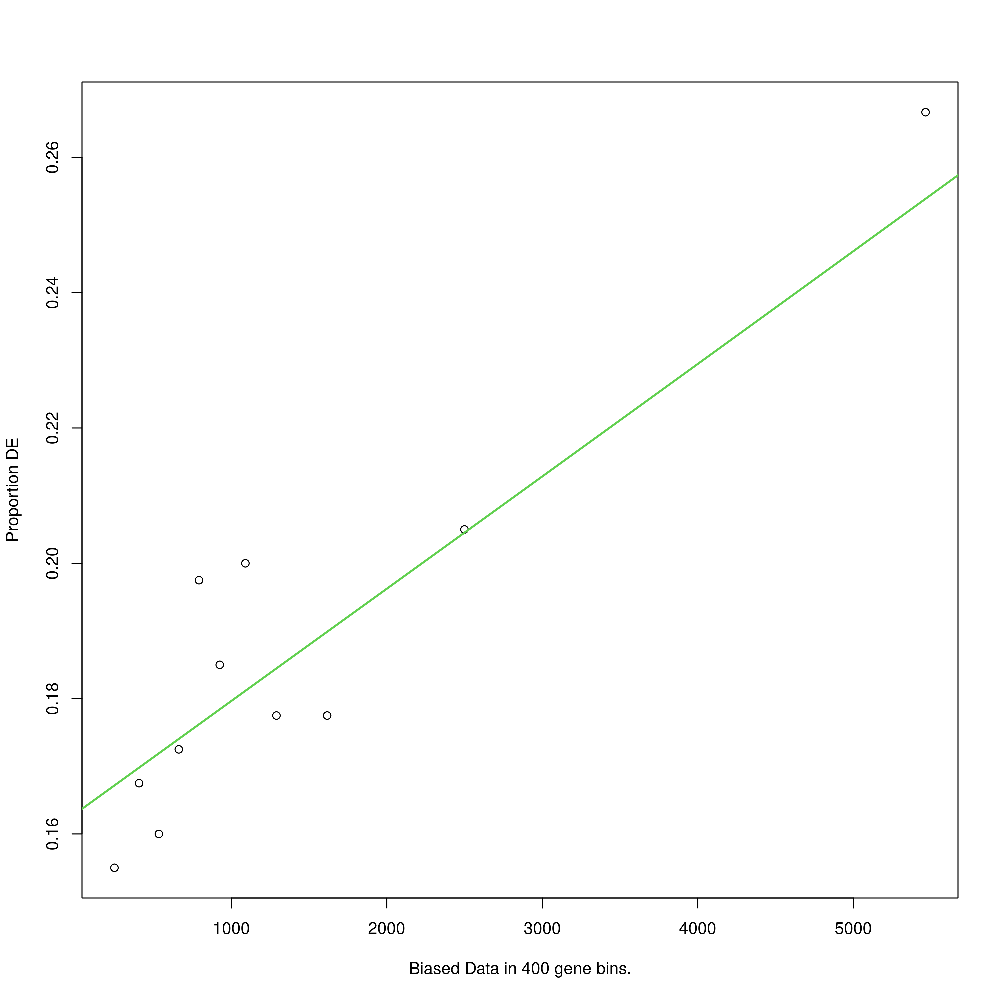

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


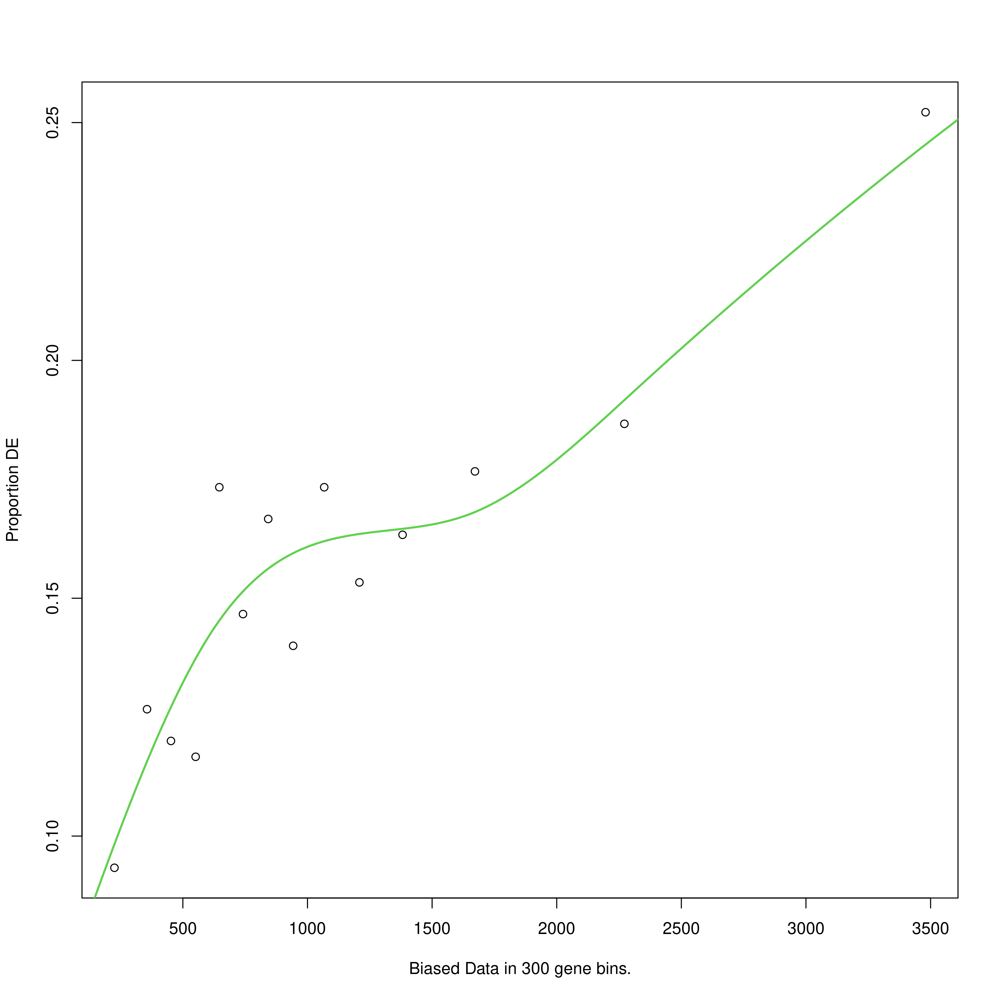

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


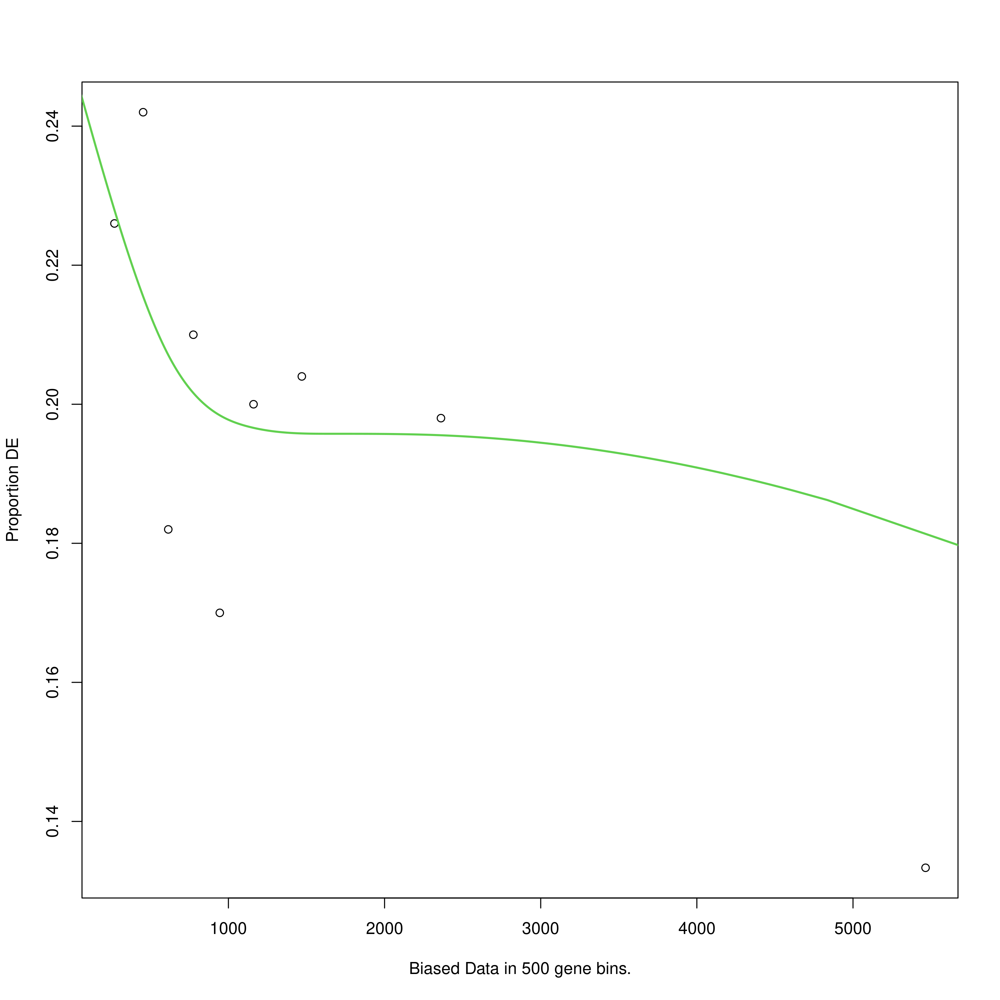

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


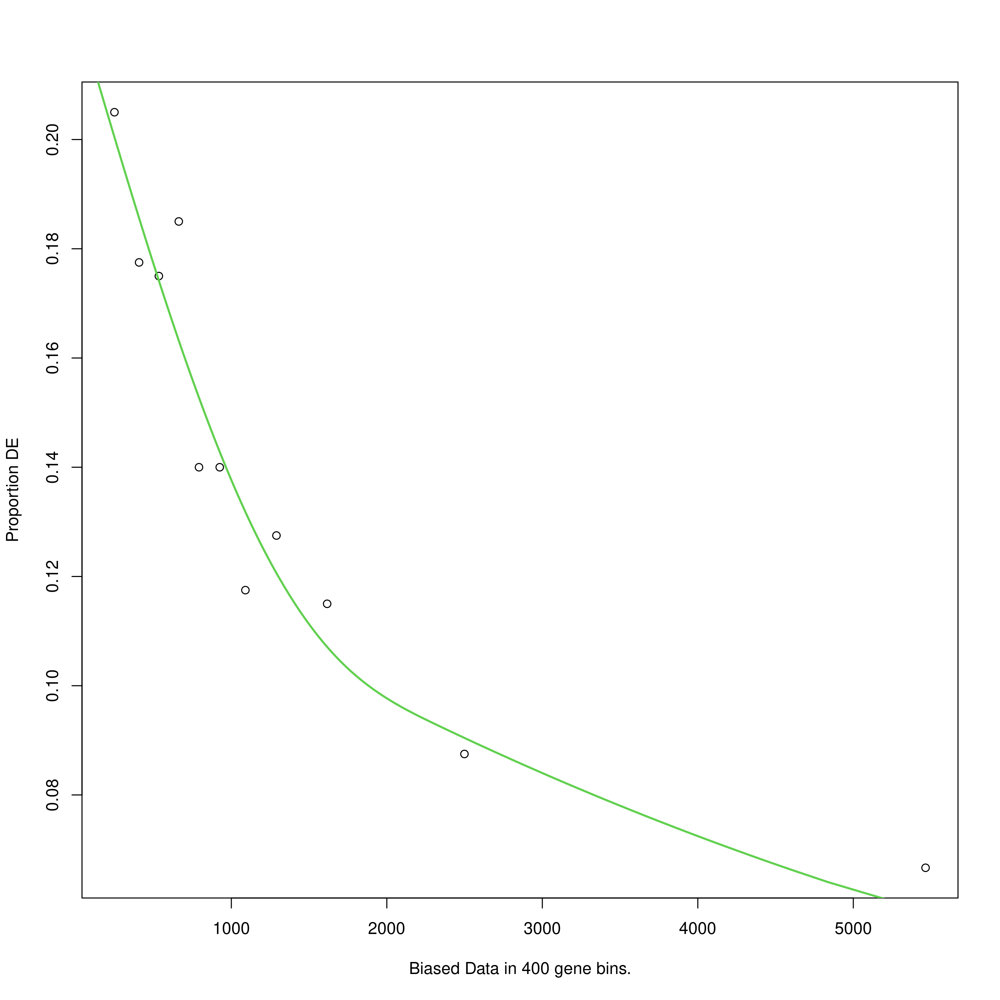

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


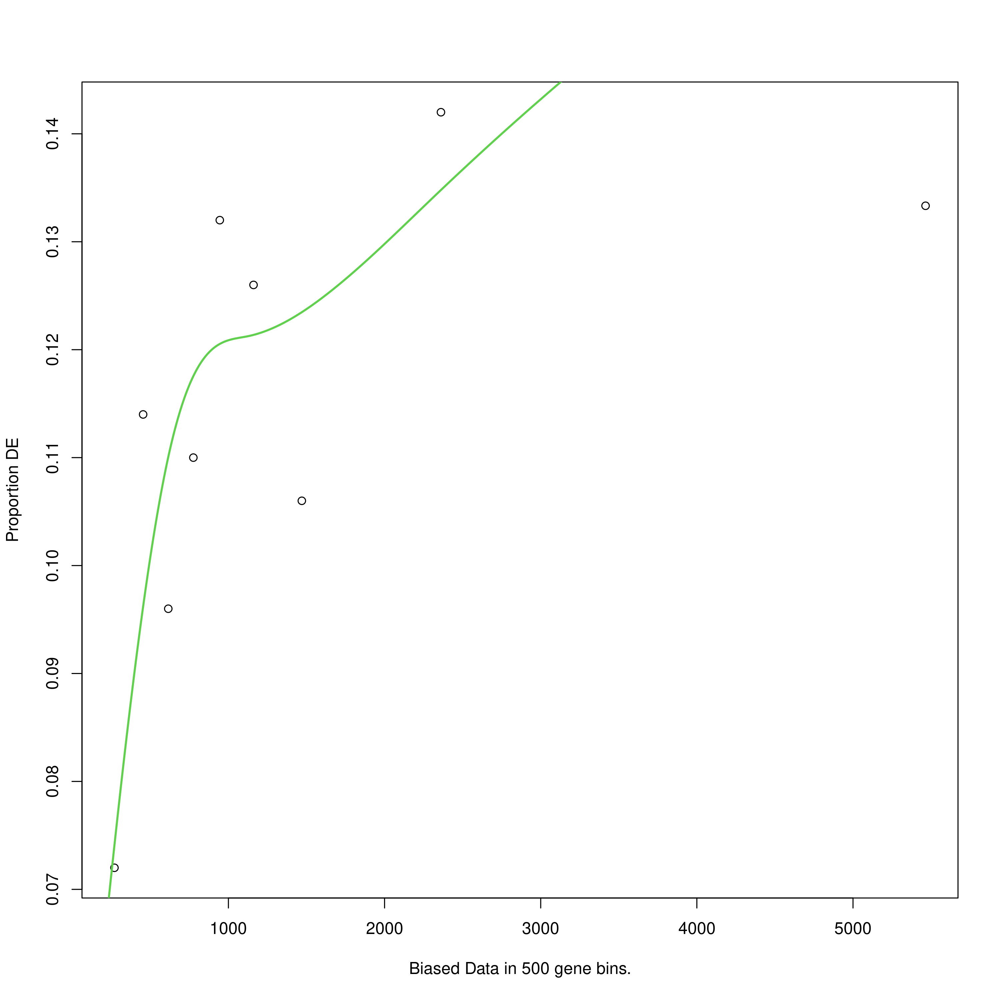

Using manually entered categories.

For 1813 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


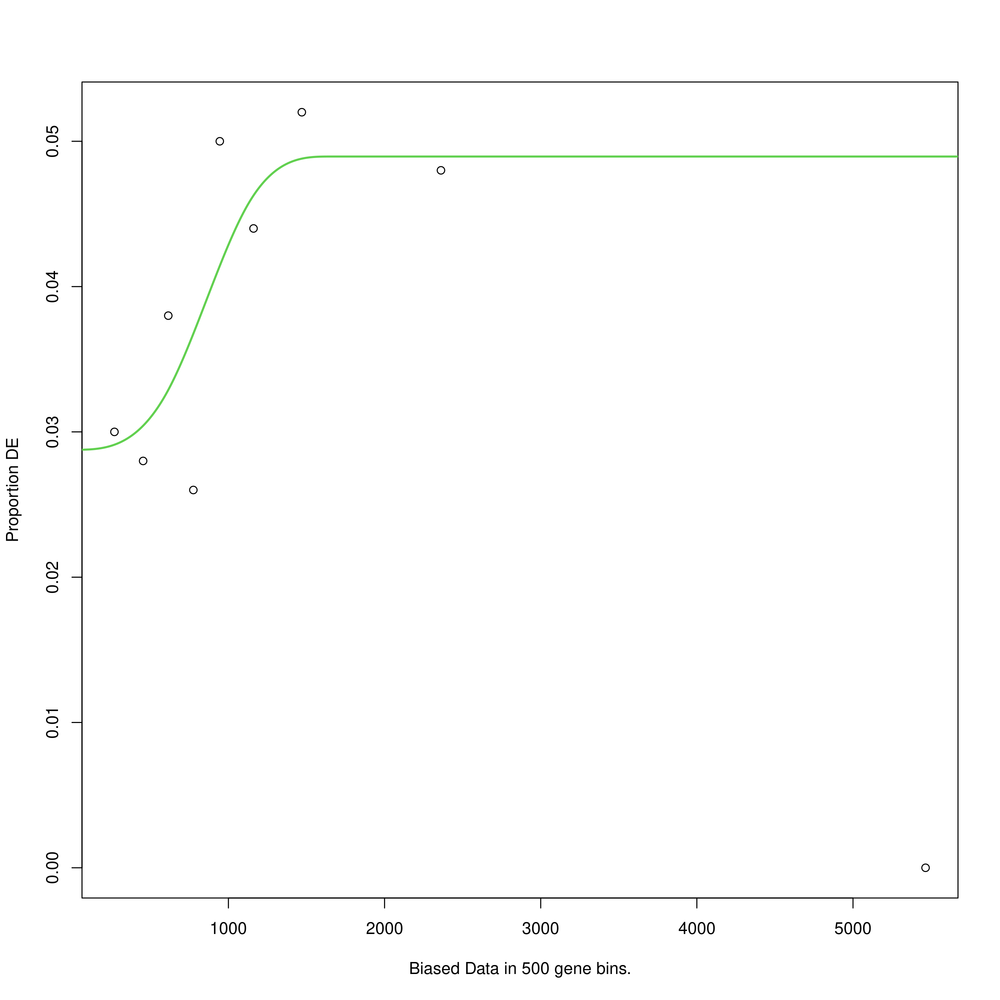

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


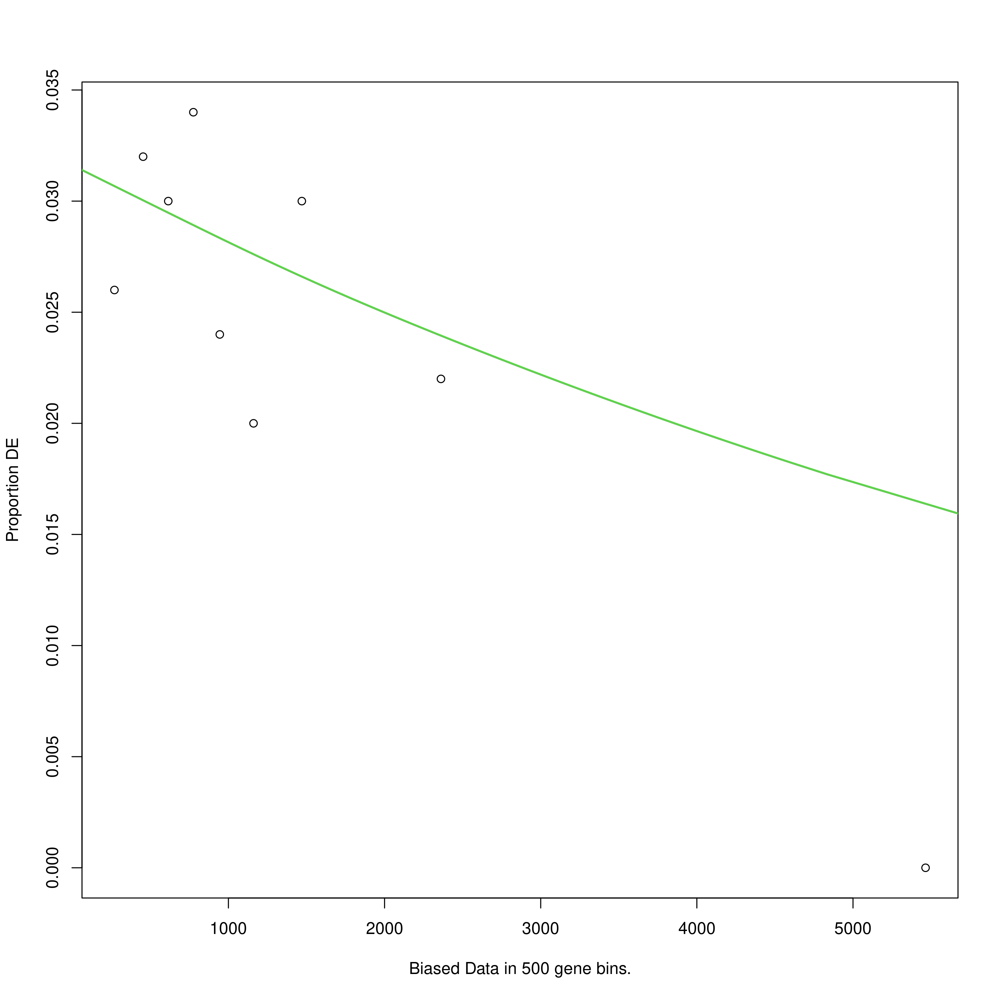

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


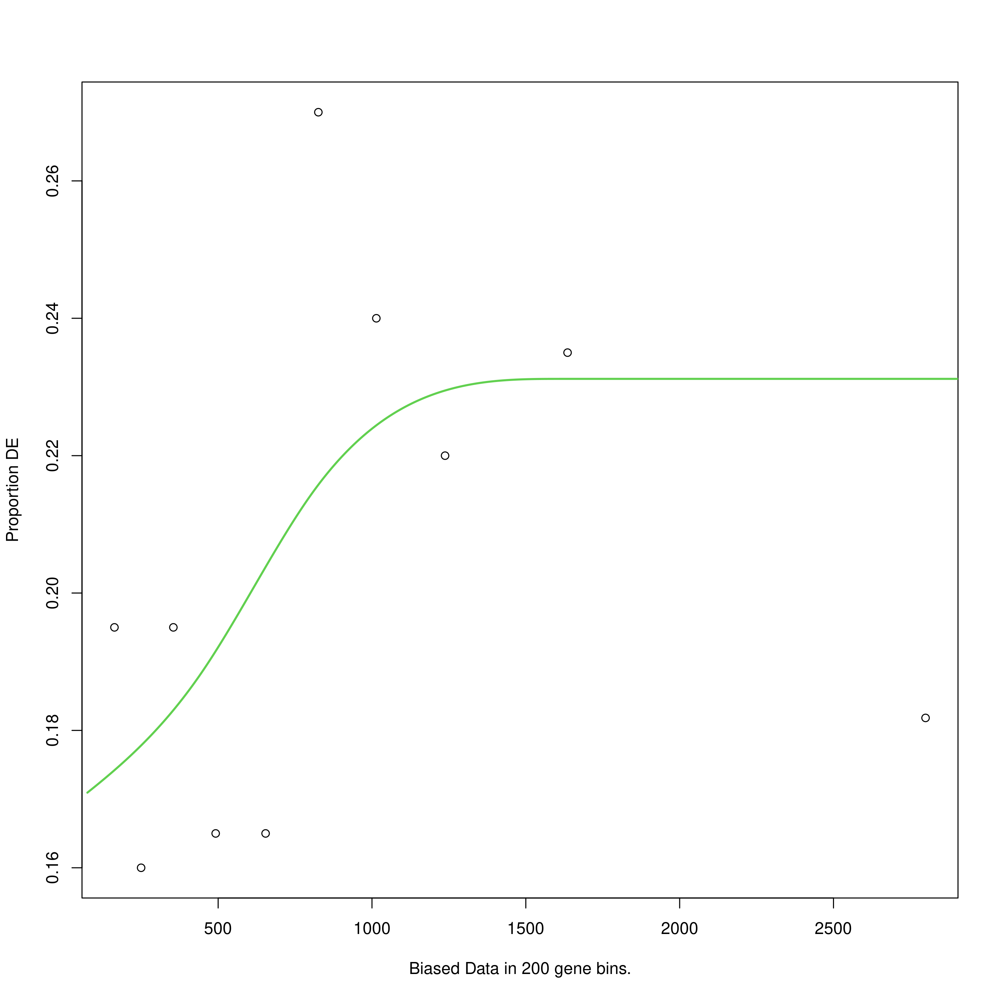

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


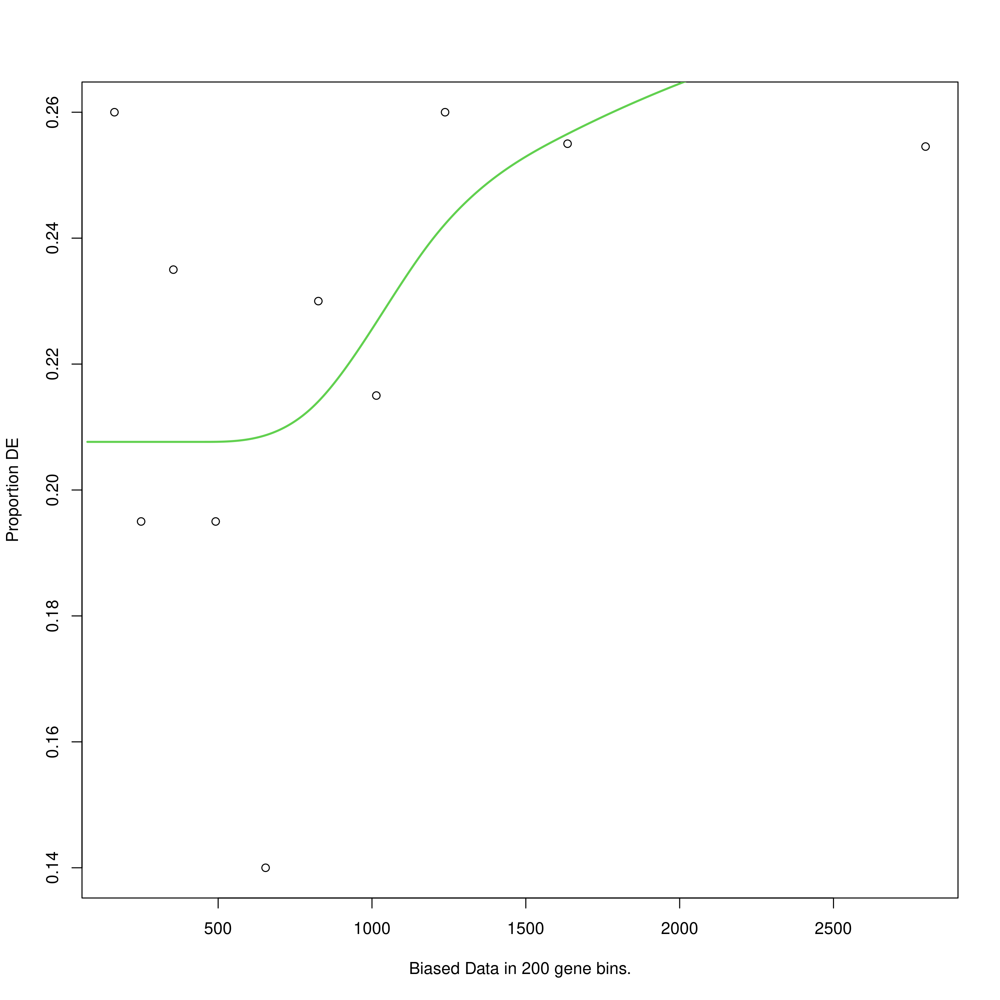

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


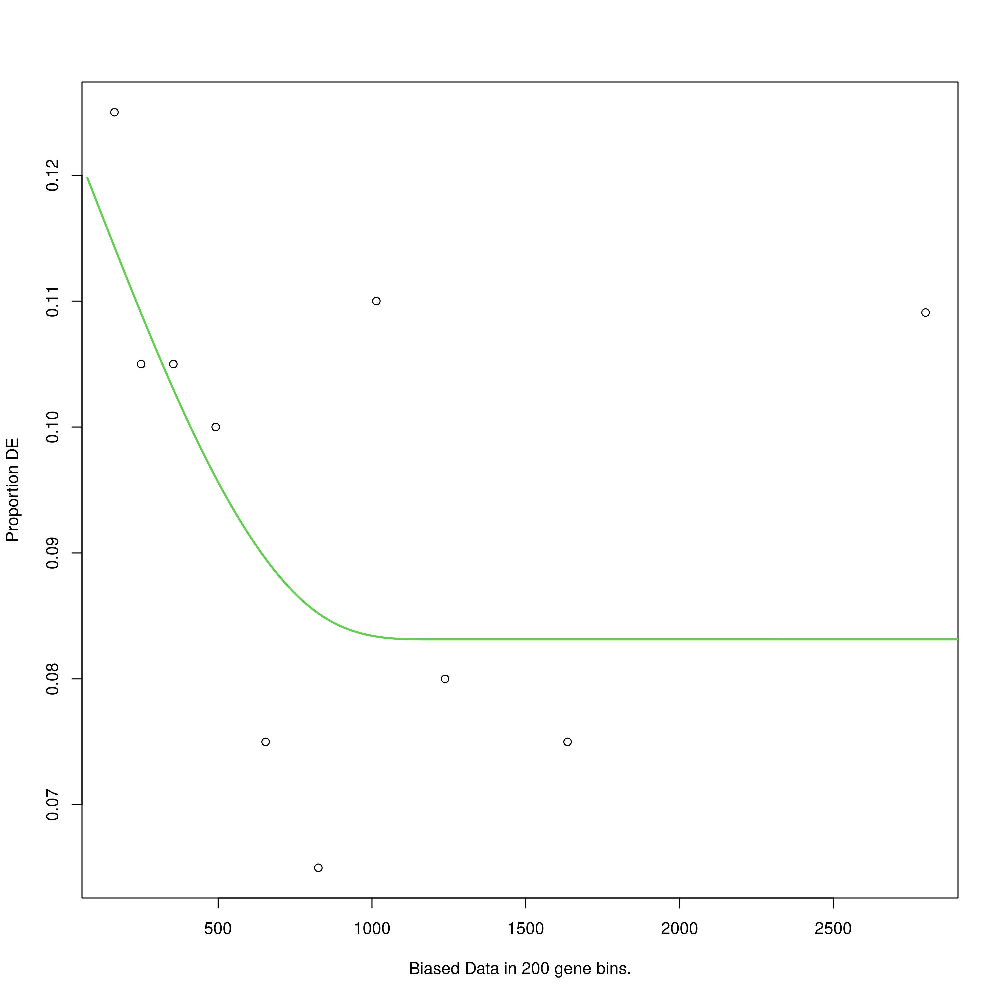

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


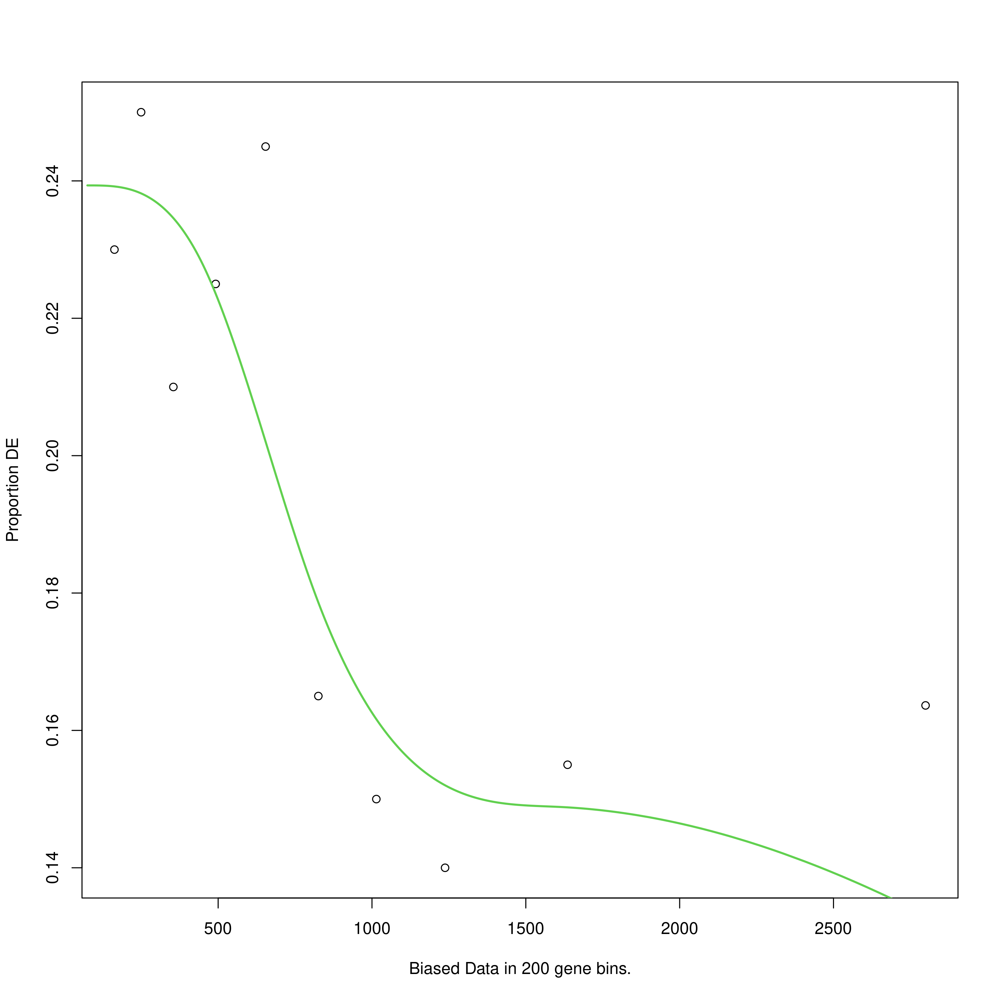

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


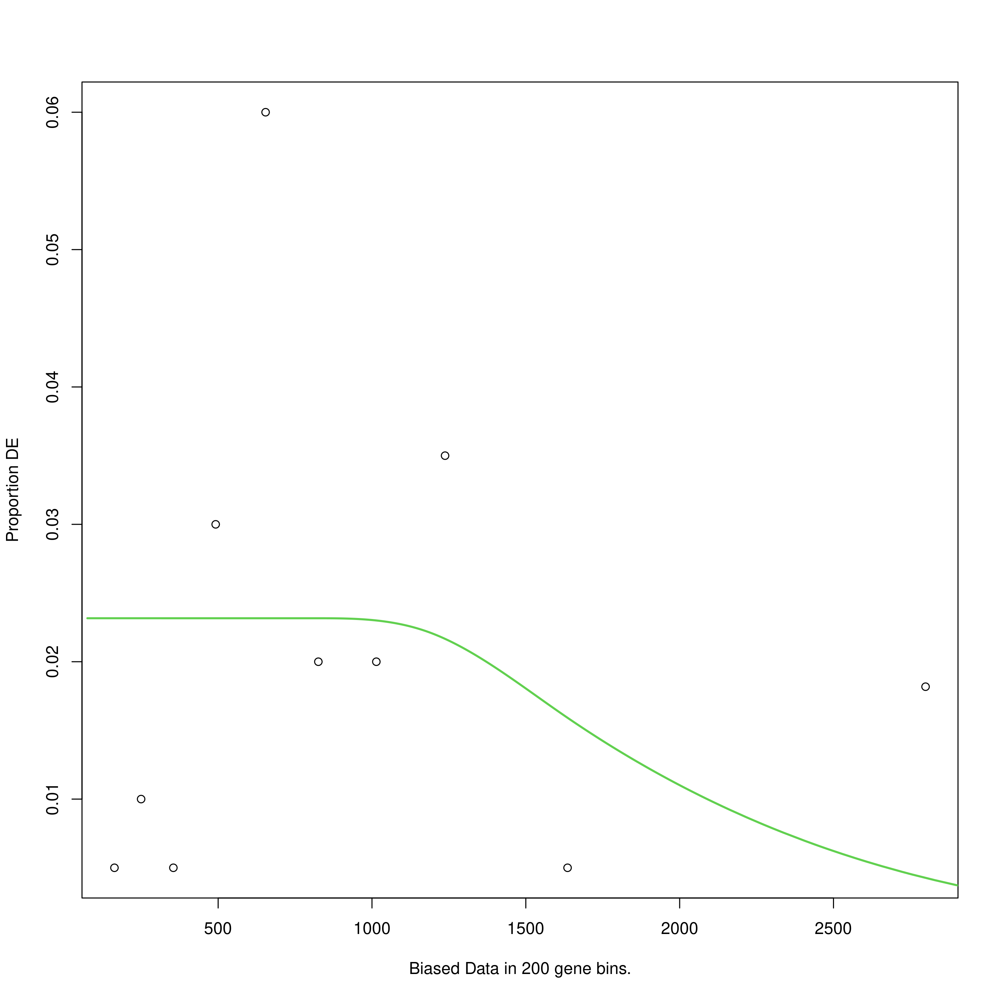

Using manually entered categories.

For 849 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


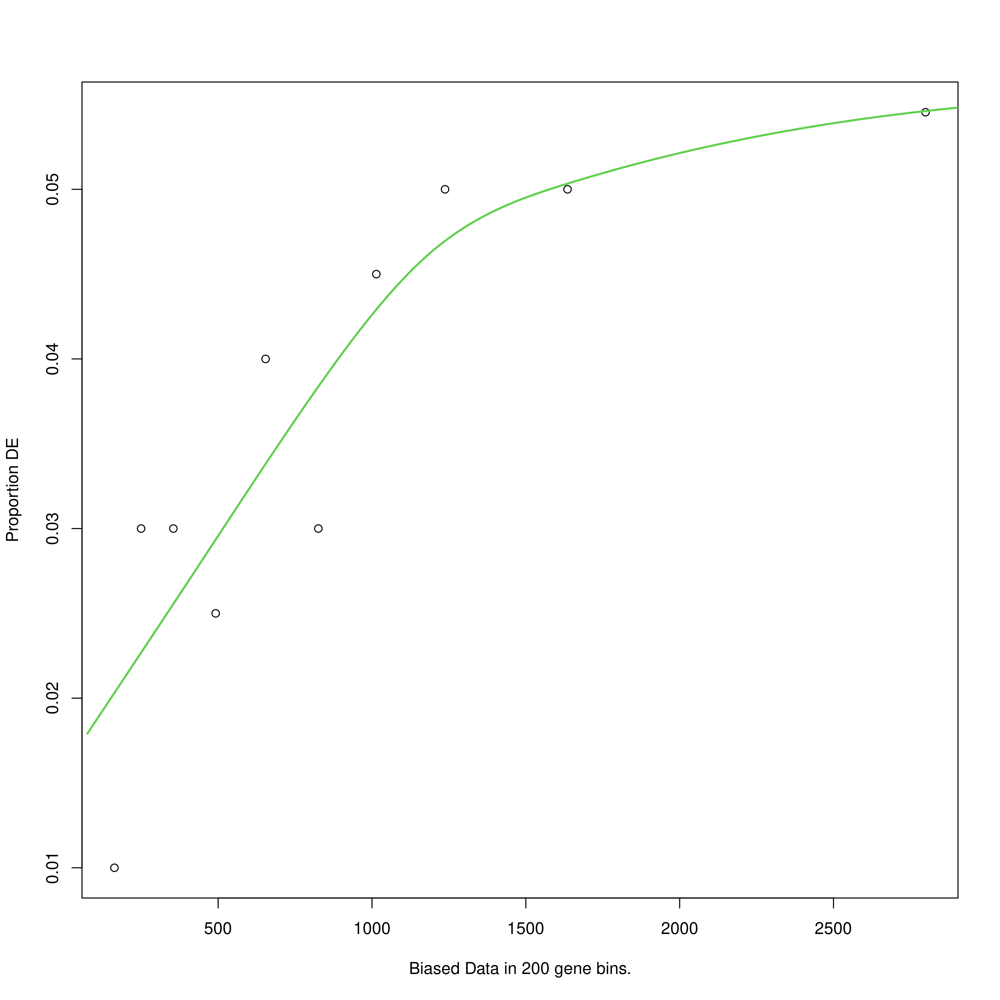

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


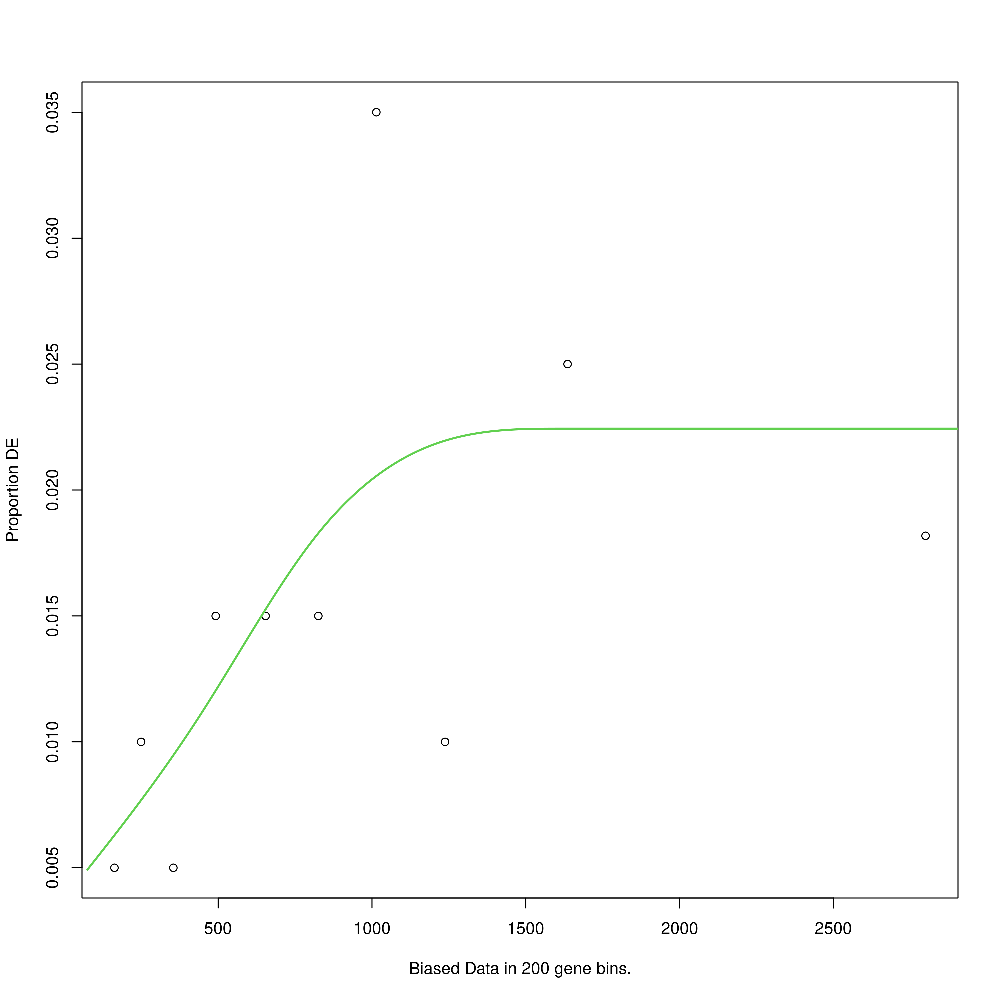

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


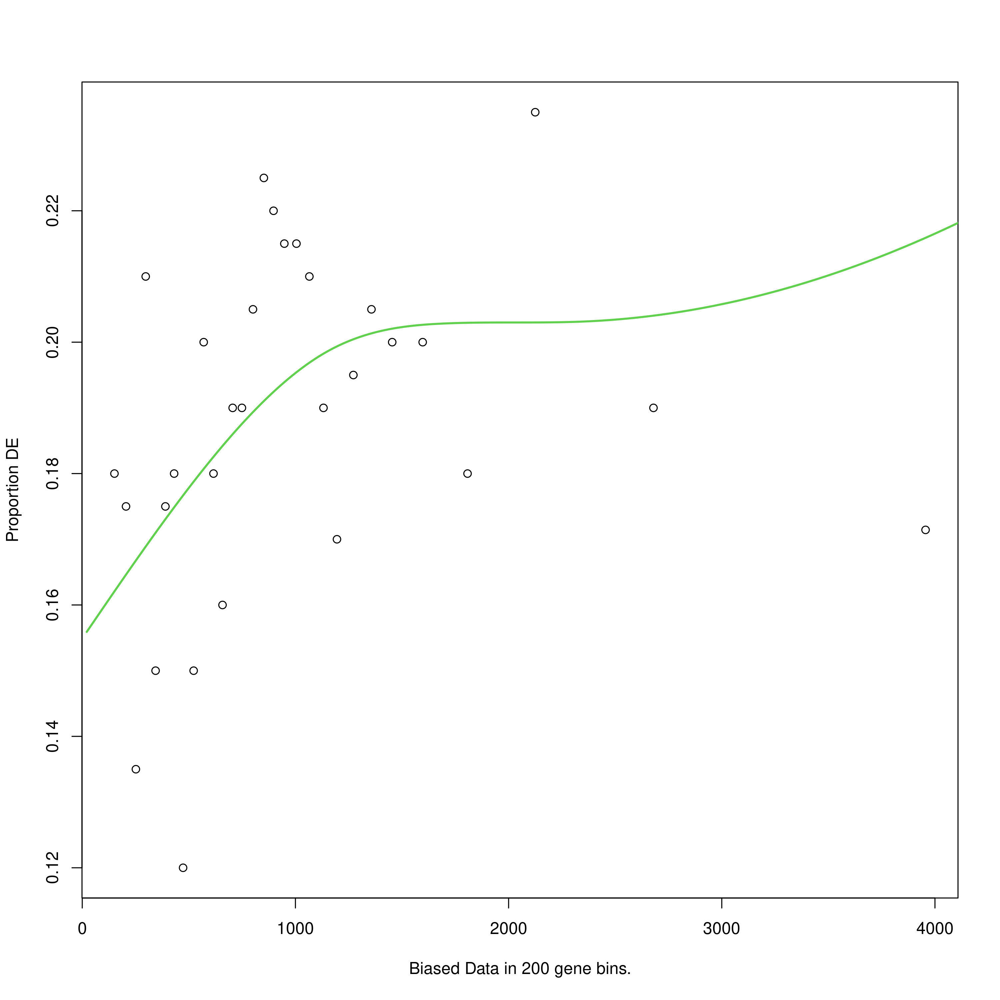

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


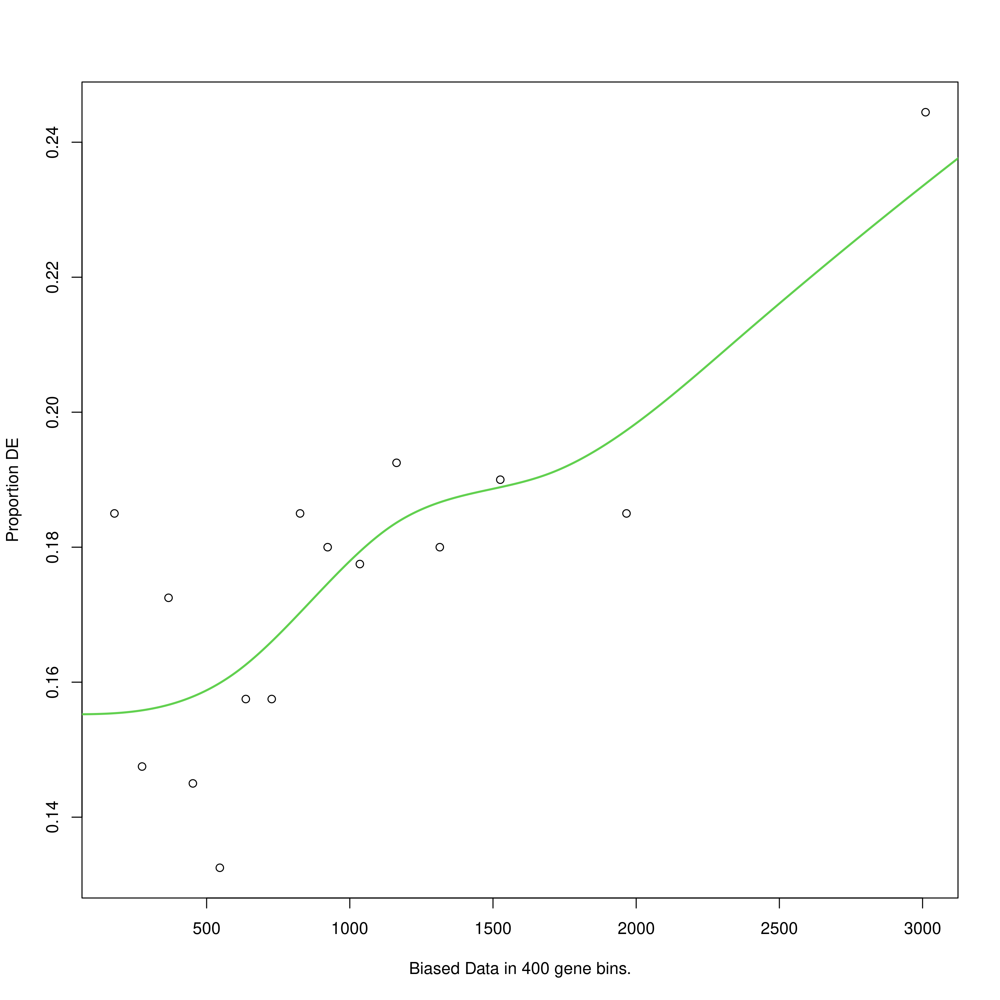

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


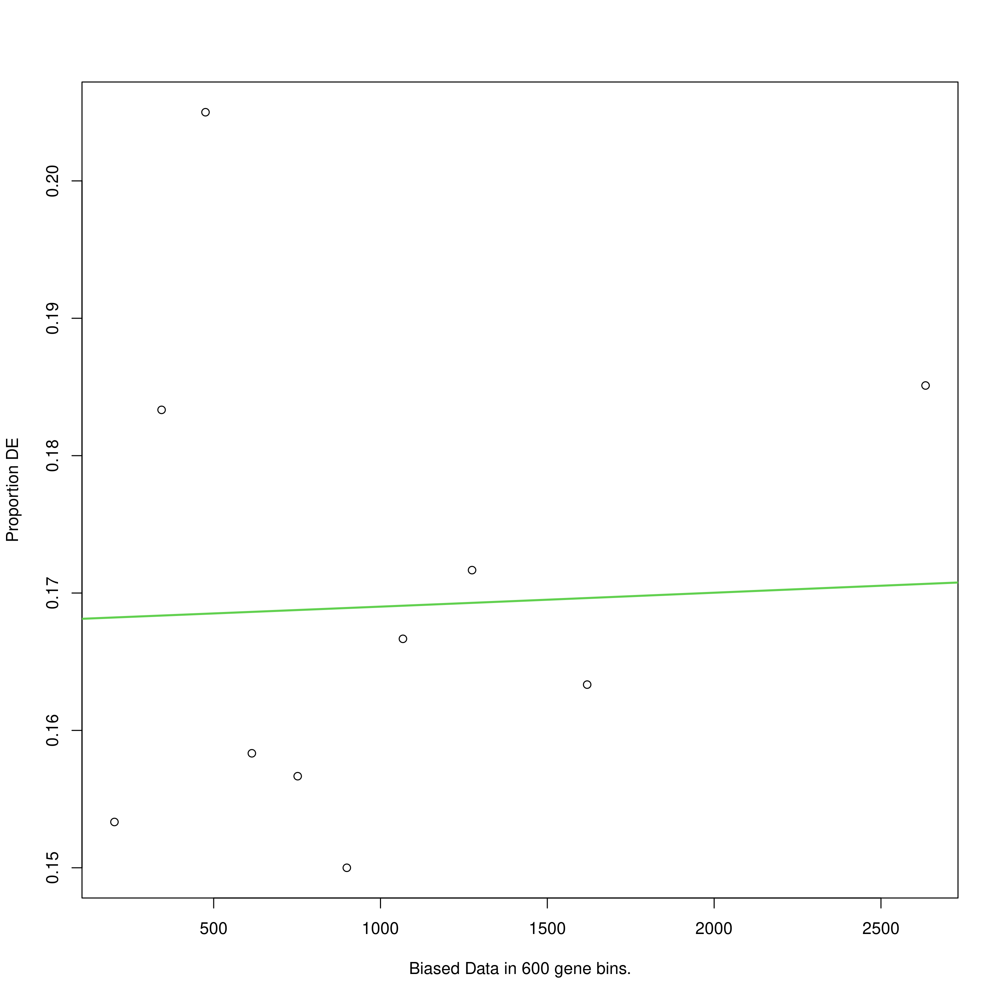

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"
Warning message in pcls(G):
“initial point very close to some inequality constraints”


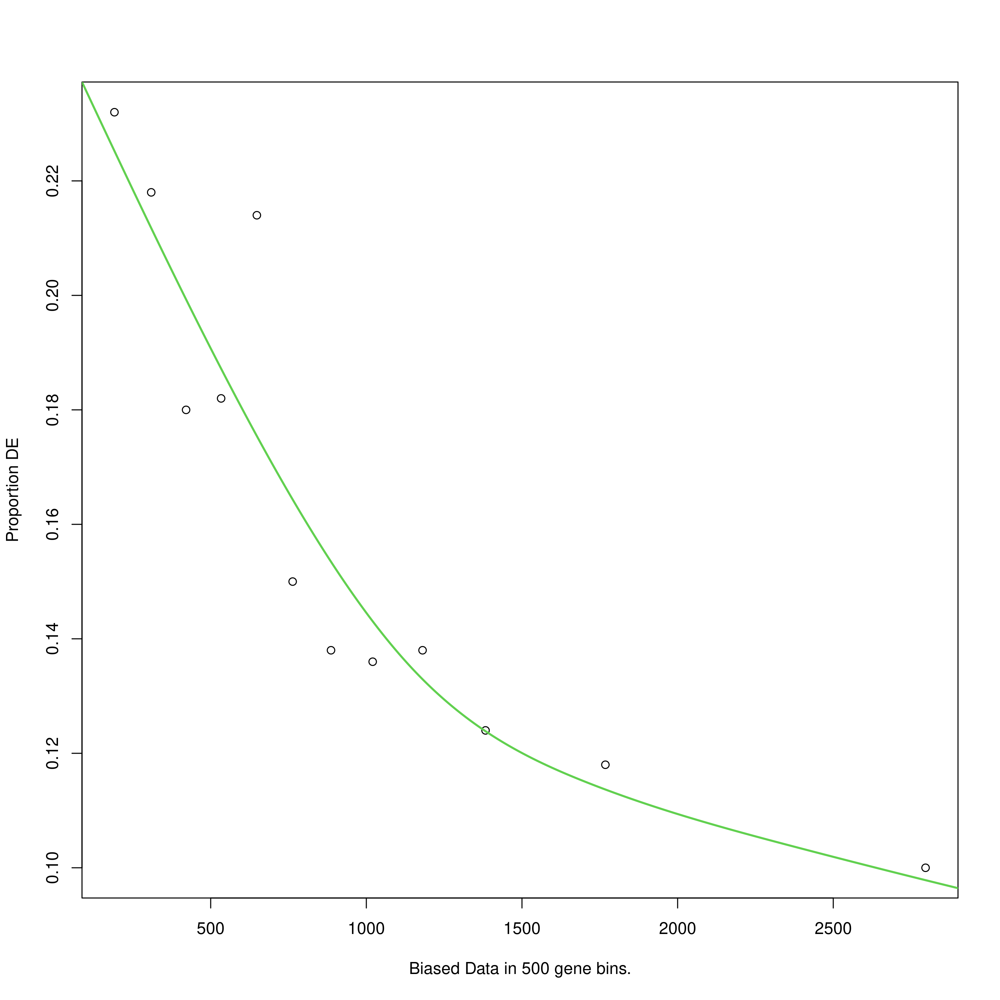

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


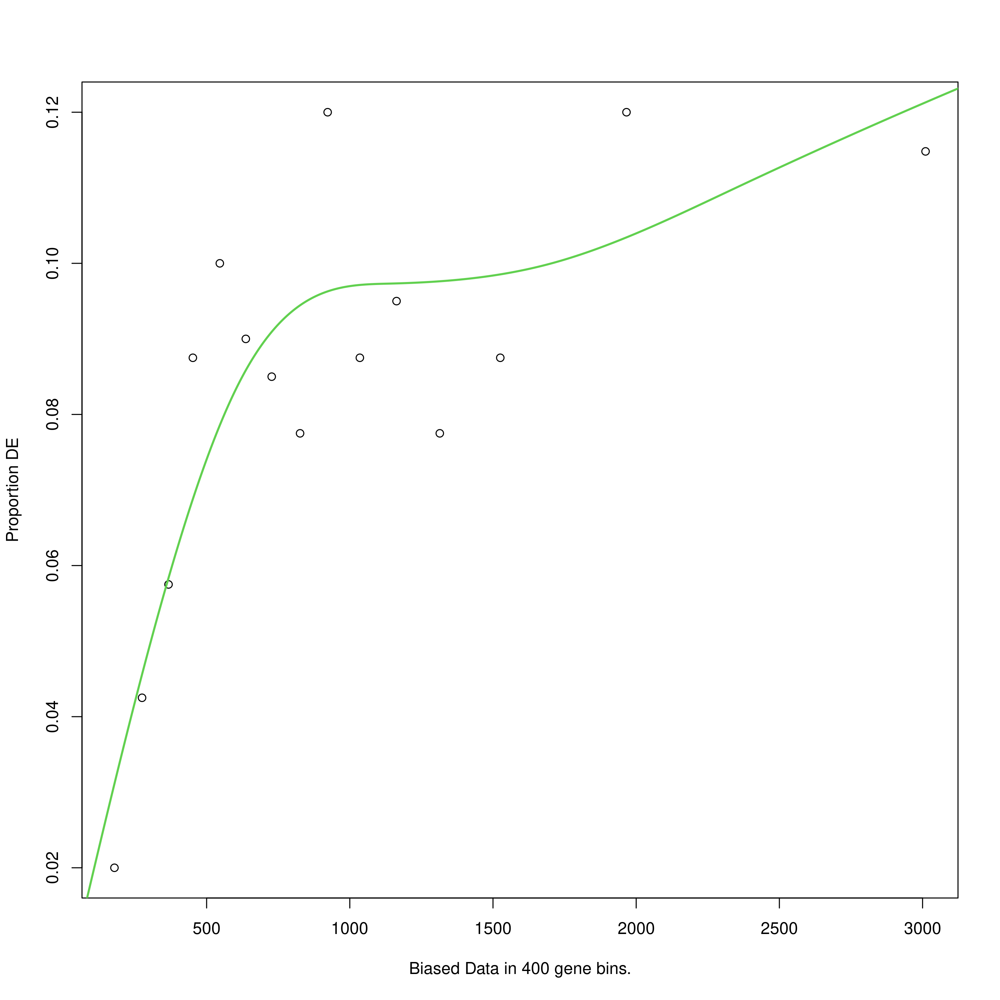

Using manually entered categories.

For 2662 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

Joining, by = "category"


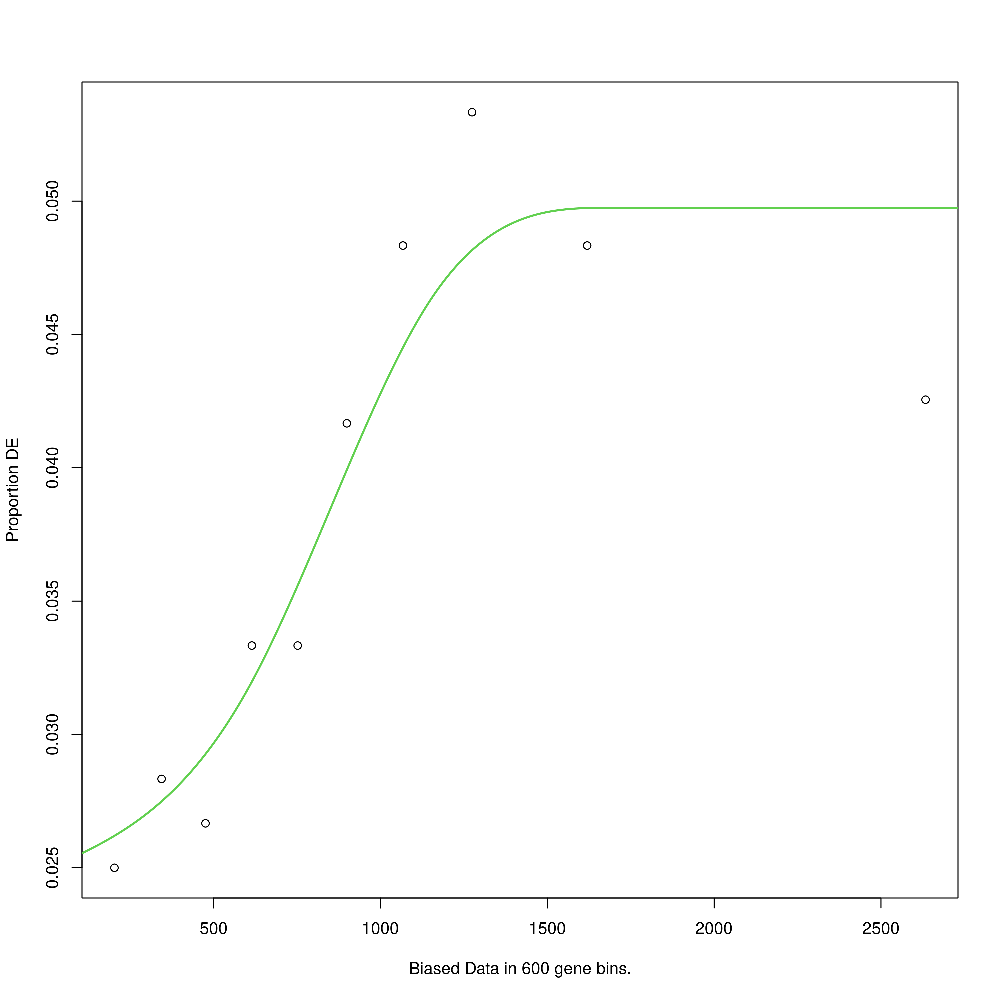

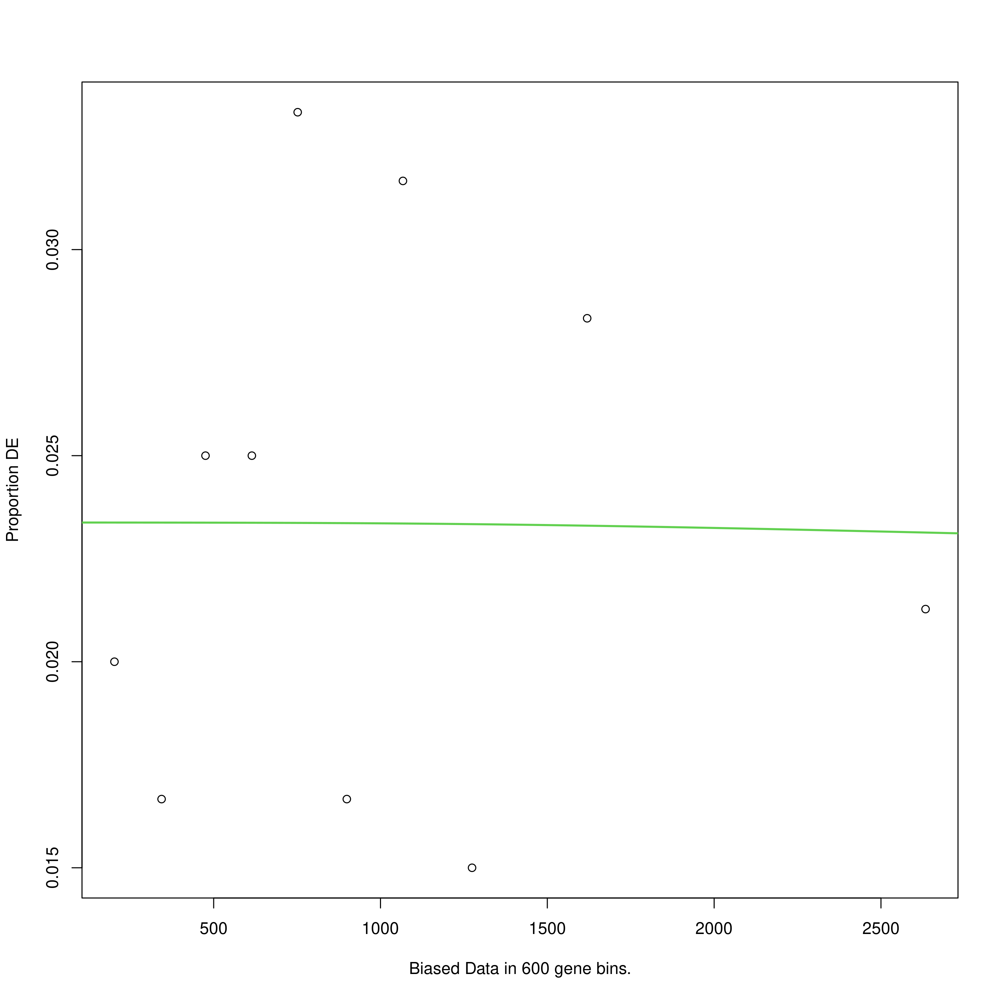

In [336]:
max_cluster  = max(cluster_df$cluster_id)
dlist = list()
for (col in c('sub' ,'path')) 
    {
    for (mmtype in c('Anticorrelated', 'Correlated', 'All' )) 
        {
        for (group in c('A', 'P', 'All' )) 
            {
            for (cluster_id in c(1:max_cluster)) 
                {
                  dlist[[length(dlist) + 1]] <- run_enrichment(col, mmtype, group, cluster_id)
                }
            }
        }
    }
    


goseq_res = bind_rows(dlist)


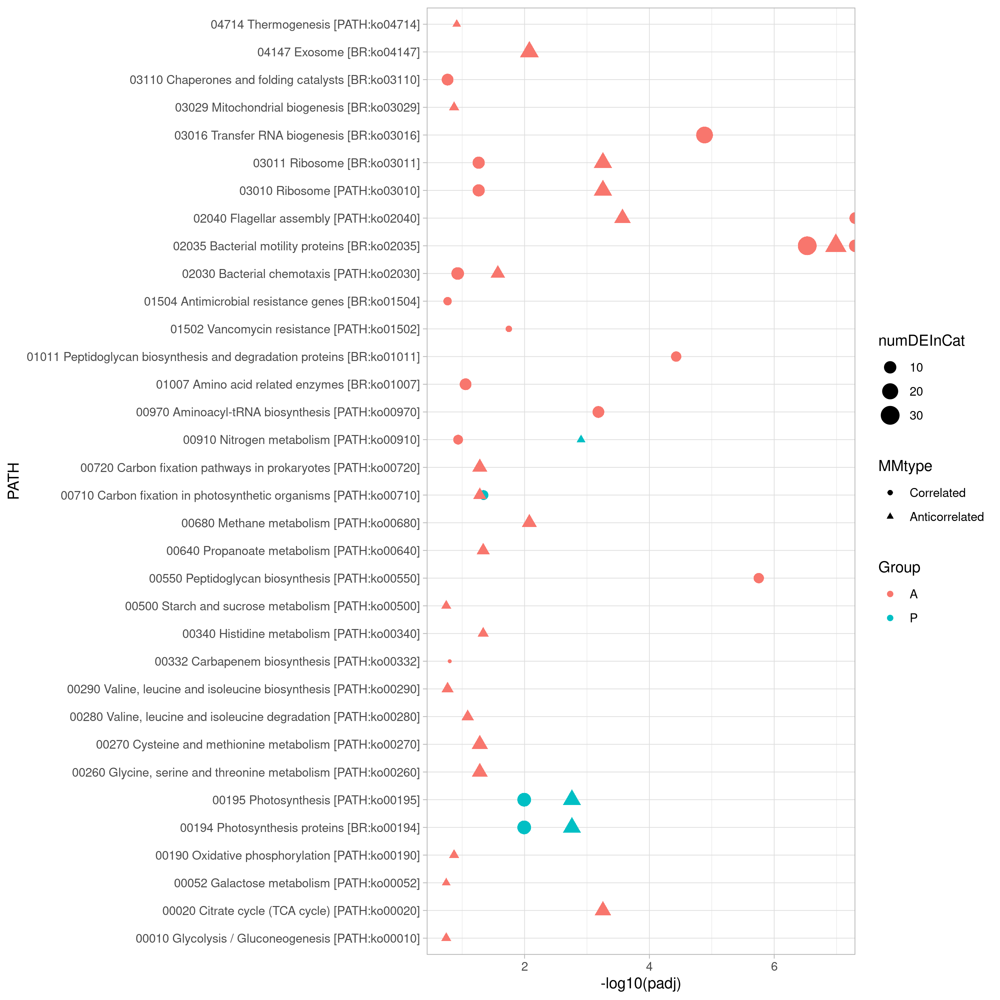

In [431]:
goseq_res %>% 
  filter(enrich == 'path', MMtype != 'All', Group != 'All') %>%
  arrange(padj) %>% 
  group_by(cluster_id) %>% slice(1:10) %>%
  filter(padj < 0.2) %>%
ggplot(aes(x=-log10(padj), y=PATH, size=numDEInCat, color=Group, shape=MMtype)) +
  geom_point() + 
  #facet_wrap(~cluster_id,  scales="free_y", ncol=1) +
theme_light()

In [337]:
goseq_res = goseq_res %>%
  mutate(Group = factor(Group, levels=c('A', 'P', 'All'))) %>%
  mutate(MMtype = factor(MMtype, levels=c('Correlated', 'Anticorrelated', 'All' ))) 


In [300]:
goseq_res %>%filter(over_represented_pvalue < 0.05)

category,PATH,over_represented_pvalue,padj,under_represented_pvalue,numDEInCat,numInCat,cluster_id,enrich,Group,MMtype
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<chr>,<chr>,<chr>
09131,09131 Membrane transport,2.481034e-02,7.269397e-01,0.9904665,10,81,1,sub,A,Anticorrelated
09142,09142 Cell motility,2.714619e-09,1.330164e-07,1.0000000,20,91,2,sub,A,Anticorrelated
09183,09183 Protein families: signaling and cellular processes,3.316826e-05,8.126225e-04,0.9999864,47,593,2,sub,A,Anticorrelated
09132,09132 Signal transduction,2.350132e-02,3.838549e-01,0.9897939,13,151,2,sub,A,Anticorrelated
09105,09105 Amino acid metabolism,7.192038e-05,3.482087e-03,0.9999675,46,193,3,sub,A,Anticorrelated
09102,09102 Energy metabolism,1.421260e-04,3.482087e-03,0.9999448,30,117,3,sub,A,Anticorrelated
09122,09122 Translation,3.129169e-04,4.736045e-03,0.9998989,19,79,3,sub,A,Anticorrelated
09101,09101 Carbohydrate metabolism,3.866159e-04,4.736045e-03,0.9998104,45,199,3,sub,A,Anticorrelated
09104,09104 Nucleotide metabolism,9.186425e-03,9.002697e-02,0.9958880,19,86,3,sub,A,Anticorrelated


In [301]:
goseq_res %>%filter(padj < 0.1) %>% 
  filter(enrich == 'path')

category,PATH,over_represented_pvalue,padj,under_represented_pvalue,numDEInCat,numInCat,cluster_id,enrich,Group,MMtype
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<chr>,<chr>,<chr>
02035,02035 Bacterial motility proteins [BR:ko02035],3.382466e-10,1.028270e-07,1.0000000,23,109,2,path,A,Anticorrelated
02040,02040 Flagellar assembly [PATH:ko02040],1.775453e-06,2.698688e-04,0.9999998,12,49,2,path,A,Anticorrelated
02030,02030 Bacterial chemotaxis [PATH:ko02030],2.645930e-04,2.681209e-02,0.9999544,9,47,2,path,A,Anticorrelated
03010,03010 Ribosome [PATH:ko03010],3.745020e-06,5.552805e-04,0.9999993,16,54,3,path,A,Anticorrelated
03011,03011 Ribosome [BR:ko03011],3.745020e-06,5.552805e-04,0.9999993,16,54,3,path,A,Anticorrelated
00020,00020 Citrate cycle (TCA cycle) [PATH:ko00020],5.479742e-06,5.552805e-04,0.9999994,12,21,3,path,A,Anticorrelated
04147,04147 Exosome [BR:ko04147],1.376741e-04,8.381336e-03,0.9999641,17,48,3,path,A,Anticorrelated
00680,00680 Methane metabolism [PATH:ko00680],1.378509e-04,8.381336e-03,0.9999805,10,20,3,path,A,Anticorrelated
00710,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],1.170795e-03,5.217370e-02,0.9998476,7,14,3,path,A,Anticorrelated


In [441]:
library(ggbeeswarm)

In [482]:
library(forcats)

In [462]:
left_join(goseq_res, kegg_path_df, by = c(PATH='path'), suffix = c('', '_for_path'))

category,PATH,over_represented_pvalue,padj,under_represented_pvalue,numDEInCat,numInCat,cluster_id,enrich,Group,MMtype,X,protein_id,path_id,main,sub,ecpath
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<chr>,<fct>,<fct>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>
09131,09131 Membrane transport,0.02481034,0.7269397,0.9904665,10,81,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09125,09125 Information processing in viruses,0.05769062,0.7269397,1.0000000,1,1,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09110,09110 Biosynthesis of other secondary metabolites,0.06928983,0.7269397,0.9754643,6,47,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09107,09107 Glycan biosynthesis and metabolism,0.07745396,0.7269397,0.9690981,7,60,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09194,09194 Poorly characterized,0.08959511,0.7269397,0.9519497,13,147,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09193,09193 Unclassified: signaling and cellular processes,0.09167436,0.7269397,0.9618456,7,63,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09176,09176 Drug resistance: antineoplastic,0.11655235,0.7269397,0.9816099,2,10,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09109,09109 Metabolism of terpenoids and polyketides,0.13078112,0.7269397,0.9565845,4,32,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA
09174,09174 Infectious disease: parasitic,0.13351953,0.7269397,0.9952531,1,2,1,sub,A,Anticorrelated,NA,NA,NA,NA,NA,NA


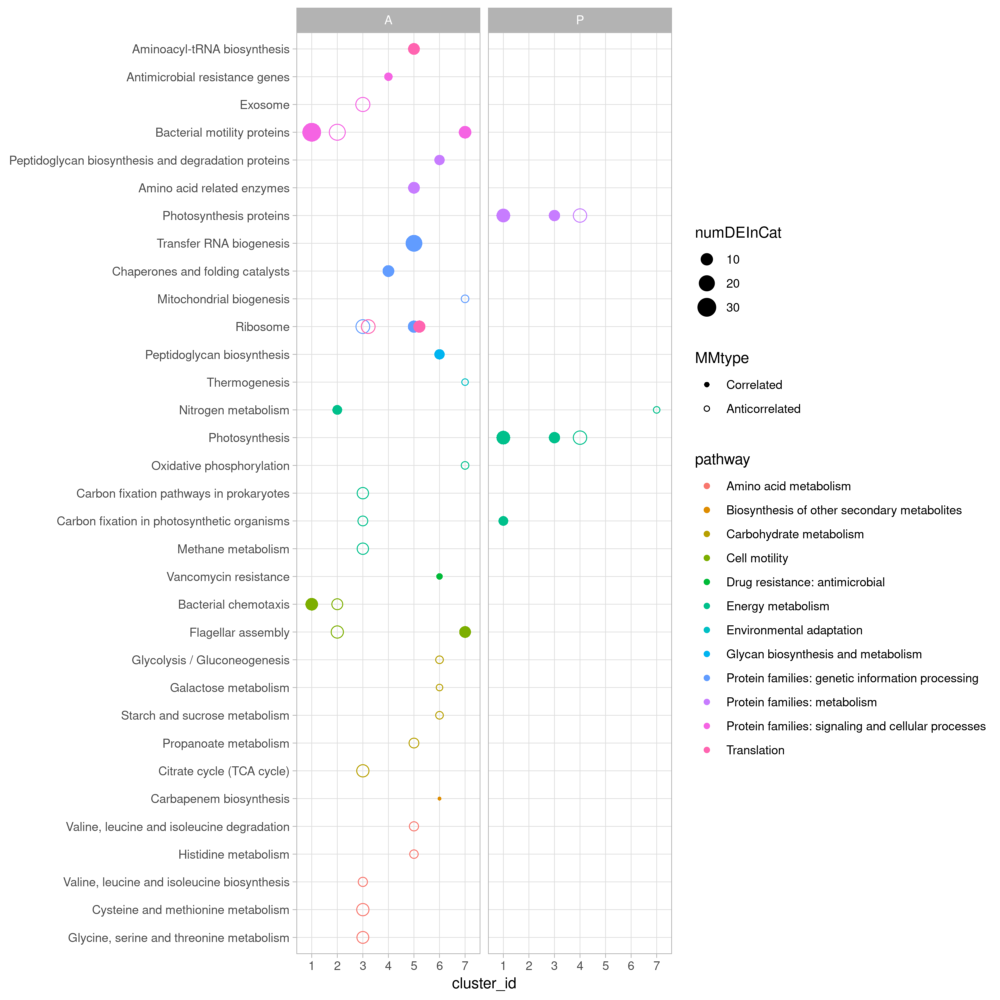

In [505]:
goseq_res %>%
  filter(padj < 0.2) %>% 
  filter(enrich == 'path', MMtype != 'All', Group != 'All') %>%
  left_join(distinct(kegg_path_df, path,sub, .keep_all= TRUE), by = c(PATH='path')) %>%
  mutate(PATH = gsub('^\\d+ (.*) \\[.*', '\\1', PATH)) %>%
  mutate(pathway = gsub('^\\d+ (.*)', '\\1', sub)) %>%
  #mutate(pathway = replace('^\\d+ (.*)', '\\1', sub)) %>%
  mutate(cluster_id = factor(cluster_id)) %>% 
  arrange(pathway) %>% 
#goseq_res %>%filter(over_represented_pvalue < 0.05) %>%
#  filter(enrich == 'sub') %>%
ggplot(aes(y=fct_inorder(PATH), colour=pathway, x=cluster_id, shape=MMtype, size=numDEInCat)) +
  geom_beeswarm(groupOnX=TRUE, cex=3) +
  #scale_color_manual(values=ann_colors$Group) +
  scale_shape_manual(values=c(16, 1)) + labs(xlab='cluster_id') +
facet_wrap(~Group)+
  labs(y=NULL) +
  theme_light() #base_size = 10) 


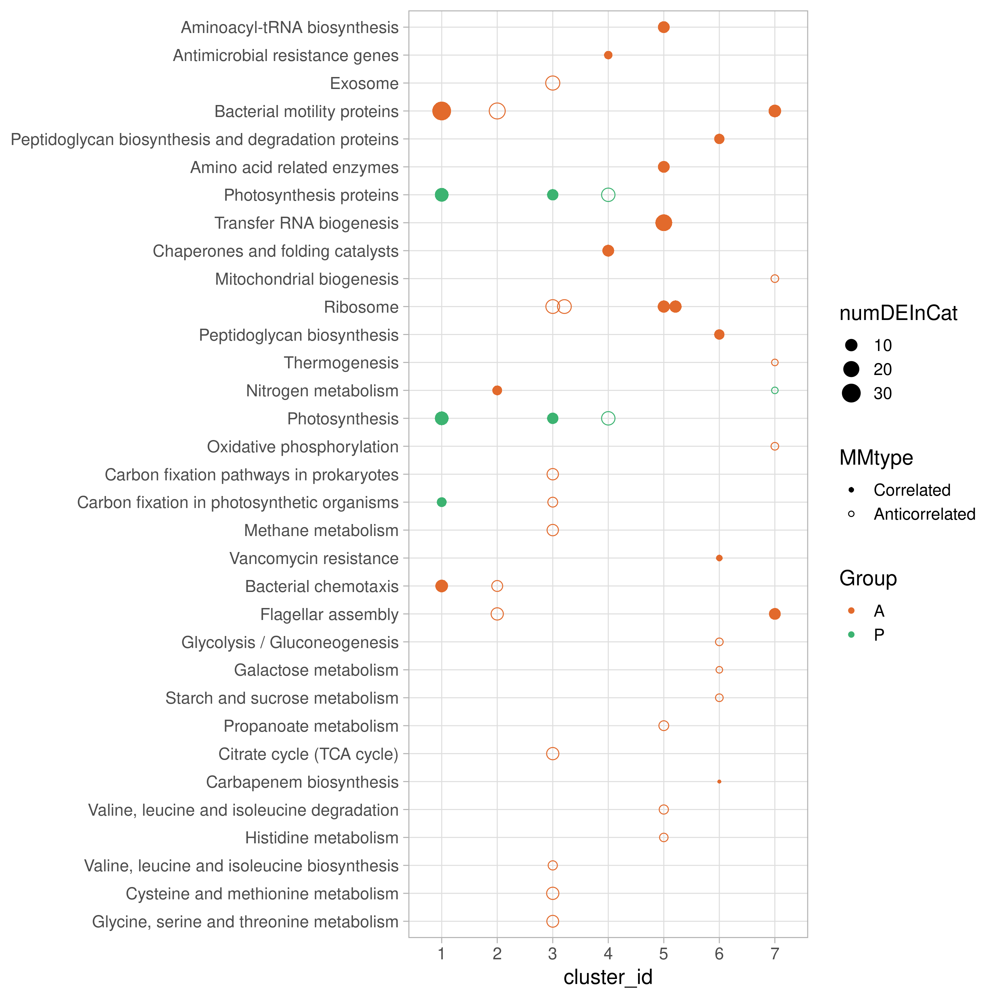

In [508]:
goseq_res %>%
  filter(padj < 0.2) %>% 
  filter(enrich == 'path', MMtype != 'All', Group != 'All') %>%
  left_join(distinct(kegg_path_df, path,sub, .keep_all= TRUE), by = c(PATH='path')) %>%
  mutate(PATH = gsub('^\\d+ (.*) \\[.*', '\\1', PATH)) %>%
  mutate(pathway = gsub('^\\d+ (.*)', '\\1', sub)) %>%
  #mutate(pathway = replace('^\\d+ (.*)', '\\1', sub)) %>%
  mutate(cluster_id = factor(cluster_id)) %>% 
  arrange(pathway) %>% 
#goseq_res %>%filter(over_represented_pvalue < 0.05) %>%
#  filter(enrich == 'sub') %>%
ggplot(aes(y=fct_inorder(PATH), colour=Group, x=cluster_id, shape=MMtype, size=numDEInCat)) +
  geom_beeswarm(groupOnX=TRUE, cex=3) +
  scale_color_manual(values=ann_colors$Group) +
  scale_shape_manual(values=c(16, 1)) + labs(xlab='cluster_id') +
#facet_wrap(~Group)+
  labs(y=NULL) +
  theme_light(base_size = 15) 


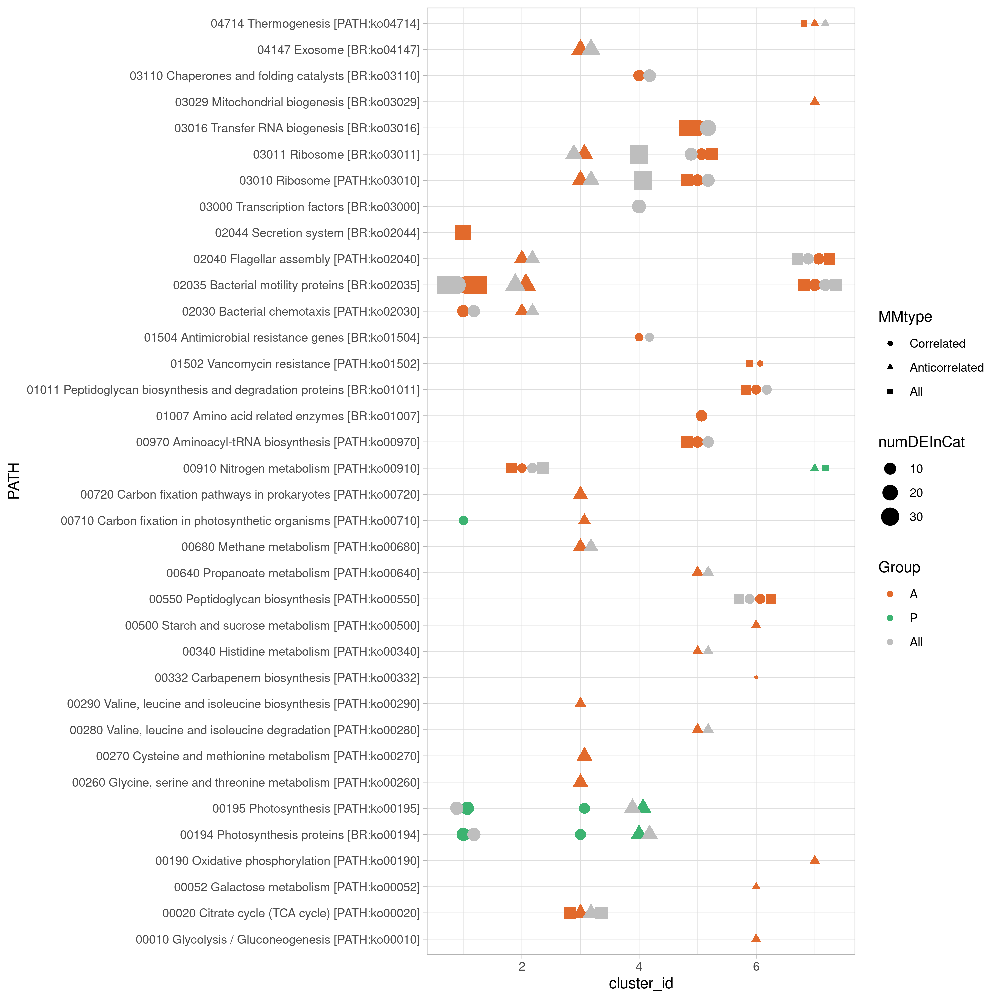

In [438]:
cols = c(
    ann_colors$Group['A'],
    ann_colors$Group['P'],
    All = 'grey')
names(cols) = levels(goseq_res$Group)
goseq_res %>%filter(padj < 0.2) %>% 
#goseq_res %>%filter(over_represented_pvalue < 0.05) %>%
  filter(enrich == 'path') %>%
ggplot(aes(y=PATH, colour=Group, x=cluster_id, shape=MMtype, size=numDEInCat)) +
  geom_beeswarm(groupOnX=TRUE, cex=3) +
#geom_dotplot(binwidth = 0.5, 
    #fill = "white", #stroke = 2,
#             binaxis = "y", stackdir = "center", stackgroups=TRUE, binpositions='all') + 
scale_color_manual(values=cols) +
            #position=position_dodge(0.5)) + 
#  scale_shape_identity() + 
#facet_wrap(~cluster_id, scales="free_y", ncol=1)+
theme_light()

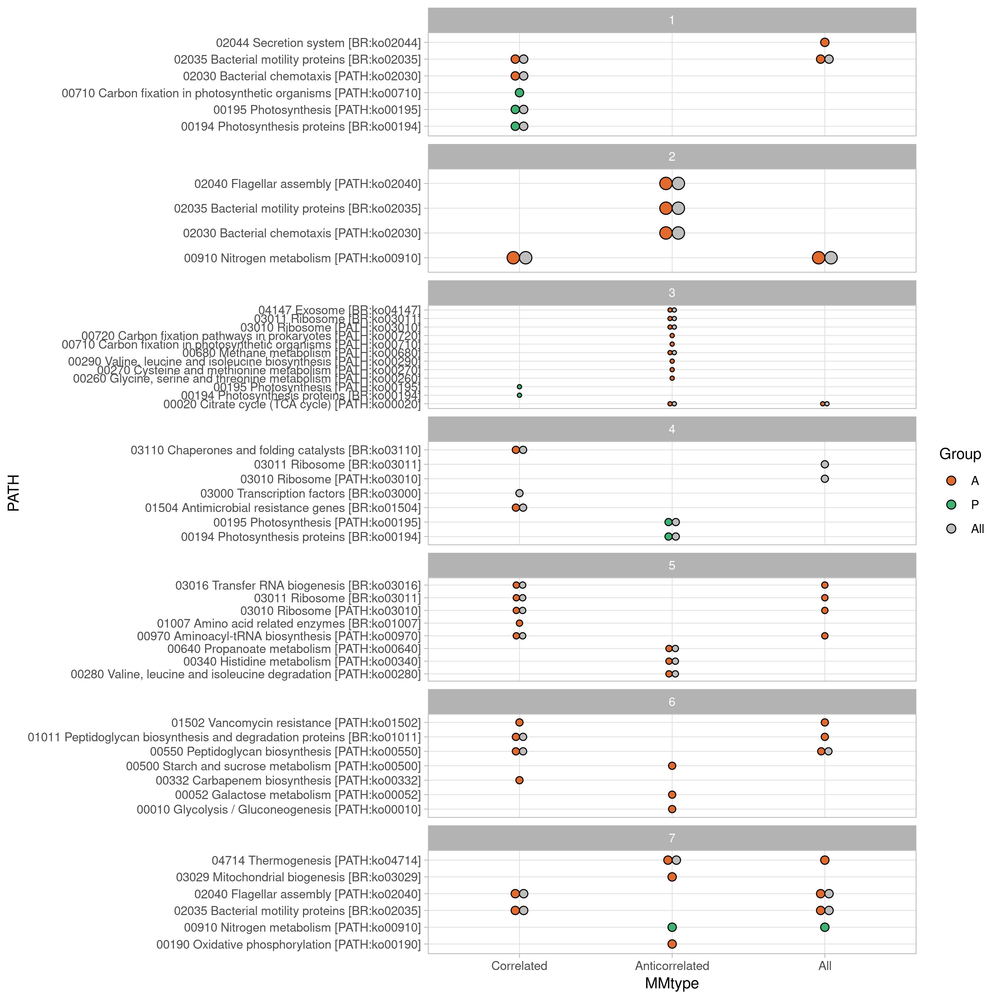

In [363]:
cols = c(
    ann_colors$Group['A'],
    ann_colors$Group['P'],
    All = 'grey')
names(cols) = levels(goseq_res$Group)
goseq_res %>%filter(padj < 0.2) %>% 
#goseq_res %>%filter(over_represented_pvalue < 0.05) %>%
filter(enrich == 'path') %>%
ggplot(aes(y=PATH, fill=Group, x=MMtype)) +
geom_dotplot(binwidth = 0.5, 
    #fill = "white", #stroke = 2,
             binaxis = "y", stackdir = "center", stackgroups=TRUE, binpositions='all') + 
scale_fill_manual(values=cols) +
            #position=position_dodge(0.5)) + 
facet_wrap(~cluster_id, scales="free_y", ncol=1) +
theme_light()

In [290]:
table(goseq_res$MMtype)


Anticorrelated     Correlated 
         96096          96096 

In [414]:
head(path_df %>% filter(substr(path, 1,5) == '00710'))

,cluster_id,gene_id,Group,gene,product,protein_id,path_id,main,sub,path,ecpath
,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,3,ACZ81_RS00890,A,,class 1 fructose-bisphosphatase,WP_014947860.1,K03841,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K03841 FBP, fbp; fructose-1,6-bisphosphatase I [EC:3.1.3.11]"
2,3,ACZ81_RS01925,A,rpe,ribulose-phosphate 3-epimerase,WP_014978117.1,K01783,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K01783 rpe, RPE; ribulose-phosphate 3-epimerase [EC:5.1.3.1]"
3,3,ACZ81_RS03935,A,tkt,transketolase,WP_061484788.1,K00615,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K00615 E2.2.1.1, tktA, tktB; transketolase [EC:2.2.1.1]"
4,3,ACZ81_RS03945,A,,phosphoglycerate kinase,WP_061484790.1,K00927,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K00927 PGK, pgk; phosphoglycerate kinase [EC:2.7.2.3]"
5,2,ACZ81_RS03955,A,,fructose bisphosphate aldolase,WP_014948386.1,K01623,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K01623 ALDO; fructose-bisphosphate aldolase, class I [EC:4.1.2.13]"
6,4,ACZ81_RS09395,A,tpiA,triose-phosphate isomerase,WP_039229431.1,K01803,09100 Metabolism,09102 Energy metabolism,00710 Carbon fixation in photosynthetic organisms [PATH:ko00710],"K01803 TPI, tpiA; triosephosphate isomerase (TIM) [EC:5.3.1.1]"
